<a href="https://colab.research.google.com/github/mehrotrasan16/time-series-anomaly-detection-methods/blob/add_holtwinters/Holt_Winters.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mount Drive and Imports

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
import shutil
if not os.path.exists('./data'):
    shutil.copytree('/content/drive/My Drive/Colab Notebooks/tImeSeries-files/data/yahoo','./data')
else:
    pass

In [3]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
from math import sqrt
from sklearn.metrics import mean_squared_error
import os
from statsmodels.tsa.seasonal import seasonal_decompose
import glob
from datetime import datetime
from statsmodels.tsa.statespace import sarimax
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from math import sqrt
from statsmodels.tsa.holtwinters import ExponentialSmoothing,SimpleExpSmoothing,Holt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Read Time Series files, formatting timestamp setting frequency

In [6]:
start_time = datetime.now()
all_csv = glob.glob(f'/content/drive/My Drive/Colab Notebooks/tImeSeries-files/data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A2Benchmark/**/*.csv', recursive=True)
end_time = datetime.now()
print(f'Loaded the paths of {len(all_csv)} files from disk. Took {end_time-start_time}')

Loaded the paths of 100 files from disk. Took 0:00:00.007170


In [7]:
df = pd.read_csv(all_csv[0])
df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')#format='%f' if formatting required upto nanoseconds
df_indexed = df.set_index('timestamp')

In [11]:
# prepare data for standardization
values = df_indexed.copy()
values = values.drop(columns=['is_anomaly'],axis=1)
#values = values.reshape((len(values), 1))
# train the standardization
scaler2 = StandardScaler()
scaler2 = scaler2.fit(values)
print(f'Mean:{scaler2.mean_}')
#print(f'StandardDeviation: {sqrt(scaler2.var_)}')
# standardize the dataset
standardaized = scaler2.transform(values)

df['std_value'] = standardaized
df_indexed['std_value'] = standardaized

# prepare data for normalization
# values = df_indexed.copy()
# values = values.drop(columns=['value','is_anomaly'],axis=1)
values = np.array(df['std_value'])
values = values.reshape((len(values), 1))
# train the normalization
scaler = MinMaxScaler(feature_range=(0, 1))
scaler = scaler.fit(values)
print('Min: %f, Max: %f' % (scaler.data_min_, scaler.data_max_))
# normalize the dataset and print the first 5 rows
normalized = scaler.transform(values)

df['norm_value'] = normalized
df_indexed['norm_value'] = normalized


Mean:[15071.24355365]
Min: -1.729460, Max: 5.490352


In [12]:
df

,timestamp,value,is_anomaly,std_value,norm_value
0,2014-11-23 07:00:00,640.999679,0,-1.603594,0.017433
1,2014-11-23 08:00:00,-90.528068,0,-1.684886,0.006174
2,2014-11-23 09:00:00,771.336286,0,-1.589110,0.019440
3,2014-11-23 10:00:00,791.897883,0,-1.586825,0.019756
4,2014-11-23 11:00:00,419.421134,0,-1.628217,0.014023
...,...,...,...,...,...
1416,2015-01-21 07:00:00,29925.519117,0,1.650715,0.468180
1417,2015-01-21 08:00:00,28345.333133,0,1.475113,0.443858
1418,2015-01-21 09:00:00,29767.656950,0,1.633172,0.465751
1419,2015-01-21 10:00:00,30499.610657,0,1.714512,0.477017


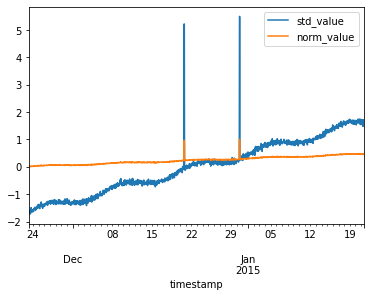

In [13]:
df.plot.line(x='timestamp',y=['std_value','norm_value'])

In [14]:
df.index.freq = 'MS'
# split dataset
X = df.norm_value
size = int(len(X)*0.5)
train, test = X[0:size], X[0:len(X)]

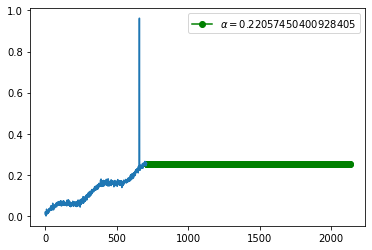

In [15]:
fit3 = SimpleExpSmoothing(train).fit()
fcast3 = fit3.forecast(len(test)).rename(r'$\alpha=%s$'%fit3.model.params['smoothing_level'])
# plot
fcast3.plot(marker='o', color='green', legend=True)
#fit3.fittedvalues.plot(marker='o', color='green')
train.plot.line()

In [16]:
#model = ExponentialSmoothing(train, seasonal='add', seasonal_periods=7).fit()
#model = ExponentialSmoothing(train, trend='add', seasonal='mul', seasonal_periods=12, damped=True)
model = ExponentialSmoothing(train, trend='add',seasonal_periods=195,seasonal='add')
hw_model = model.fit(optimized=True, use_boxcox=False, remove_bias=False)
pred = hw_model.predict(start=test.index[0], end=test.index[-1])

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)


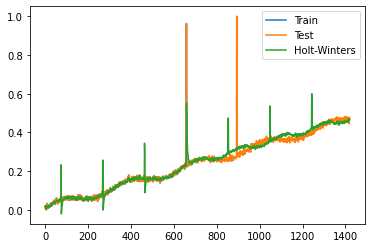

In [17]:
plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(pred.index, pred, label='Holt-Winters')
plt.legend(loc='best')

In [18]:
# rmse = np.sqrt(mean_squared_error(test,pred))
# print(rmse)
# if rmse < best_RMSE:
#     best_RMSE = rmse
#     best_periods = s

## Scipy Frequency Estimation functions

In [19]:
import scipy
def freq_peaks(sig):
    """
    Frequency estimation from find peaks method
    sig - input signal

    return: 
    dominant period
    """
    # Find the indices where there's a crossing
    #indices = find((sig[1:] >= 0) & (sig[:-1] < 0))
    #crossings=np.where(np.diff(np.sign(sig)))[0]
    positive = sig > 0
    peaks=scipy.signal.find_peaks(sig)[0]

    # Let's calculate the real crossings by interpolate
    #crossings = [i - sig[i] / (sig[i+1] - sig[i]) for i in indices]

    # Let's get the time between each crossing
    # the diff function will get how many samples between each crossing
    # we divide the sampling rate to get the time between them

    delta_t = np.diff(peaks)

    # Get the mean value for the period
    period = int(np.max(delta_t))

    return period

def freq_zero_crossing(sig, fs=1):
    """
    Frequency estimation from zero crossing method
    sig - input signal
    fs - sampling rate

    return: 
    dominant period
    """
    # Find the indices where there's a crossing
    positive = sig > 0
    crossings=np.where(np.bitwise_xor(positive[1:], positive[:-1]))[0]

    # Let's get the time between each crossing
    # the diff function will get how many samples between each crossing
    # we divide the sampling rate to get the time between them
    delta_t = np.diff(crossings) / fs

    # Get the mean value for the period
    period =int(np.max(delta_t))*2

    return period

In [20]:
freq_peaks(pred)
#freq_zero_crossing(X)

11

In [21]:
from tqdm import tqdm

  0%|          | 0/292 [00:00<?, ?it/s]

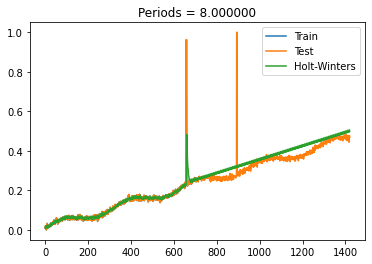

  1%|          | 2/292 [00:00<01:05,  4.46it/s]

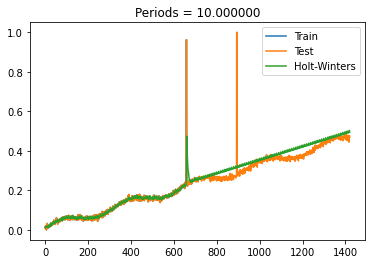

  5%|▌         | 16/292 [00:02<00:46,  5.91it/s]

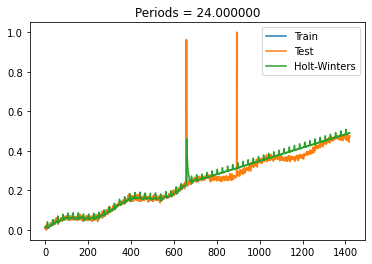

  6%|▌         | 17/292 [00:02<00:57,  4.81it/s]

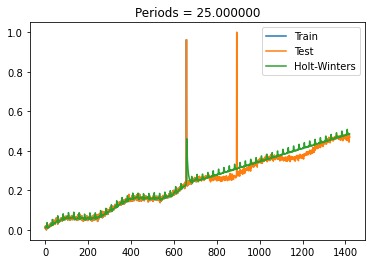

 12%|█▏        | 36/292 [00:06<00:59,  4.32it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 13%|█▎        | 37/292 [00:07<01:02,  4.06it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 13%|█▎        | 38/292 [00:07<01:05,  3.88it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 13%|█▎        | 39/292 [00:07<01:07,  3.77it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 14%|█▎        | 40/292 [00:07<01:08,  3.68it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: Convergen

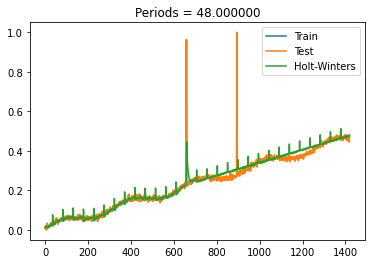

 14%|█▍        | 42/292 [00:08<01:05,  3.82it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)


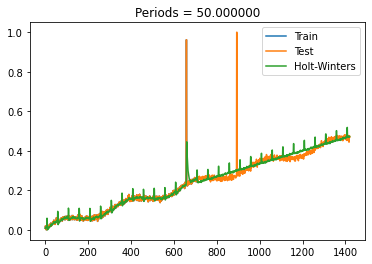

 15%|█▍        | 43/292 [00:08<01:18,  3.18it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 15%|█▌        | 44/292 [00:09<01:15,  3.28it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 15%|█▌        | 45/292 [00:09<01:14,  3.33it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 16%|█▌        | 46/292 [00:09<01:12,  3.38it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 16%|█▌        | 47/292 [00:10<01:12,  3.39it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: Convergen

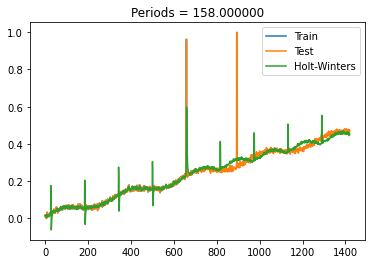

 52%|█████▏    | 151/292 [00:38<00:43,  3.24it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 52%|█████▏    | 152/292 [00:38<00:43,  3.25it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 52%|█████▏    | 153/292 [00:39<00:42,  3.27it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 53%|█████▎    | 155/292 [00:39<00:36,  3.76it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 53%|█████▎    | 156/292 [00:39<00:33,  4.02it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: Conv

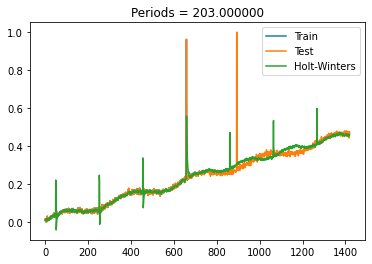

 67%|██████▋   | 196/292 [00:51<00:31,  3.06it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 67%|██████▋   | 197/292 [00:51<00:30,  3.16it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 68%|██████▊   | 198/292 [00:51<00:29,  3.21it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 68%|██████▊   | 199/292 [00:52<00:28,  3.28it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 68%|██████▊   | 200/292 [00:52<00:27,  3.29it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: Conv

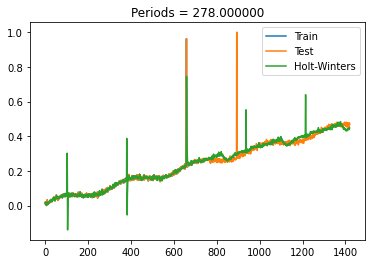

 93%|█████████▎| 271/292 [01:12<00:07,  2.95it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 93%|█████████▎| 272/292 [01:13<00:06,  3.05it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 93%|█████████▎| 273/292 [01:13<00:06,  3.15it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 94%|█████████▍| 274/292 [01:13<00:05,  3.22it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)
 94%|█████████▍| 275/292 [01:14<00:05,  3.29it/s]/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: Conv

In [22]:
best_RMSE=1
best_hw = None
best_pred= []
for s in tqdm(range(8,300)):
    model = ExponentialSmoothing(train, trend='add',seasonal_periods=s,seasonal='add')
    hw_model = model.fit(optimized=True, use_boxcox=False, remove_bias=True)
    pred = hw_model.predict(start=test.index[0], end=test.index[-1])
    rmse = np.sqrt(mean_squared_error(test,pred))
    # print(f'periods {s} rmse {rmse}')
    if rmse < best_RMSE:
        
        best_RMSE = rmse
        best_periods = s
        best_pred=pred
        best_hw=hw_model

        plt.plot(train.index, train, label='Train')
        plt.plot(test.index, test, label='Test')
        plt.plot(pred.index, pred, label='Holt-Winters')
        plt.legend(loc='best')
        plt.title("Periods = %f" % s)
        plt.show()

In [23]:
best_periods,best_RMSE,best_hw

(278,
 0.03942460162876693,
 <statsmodels.tsa.holtwinters.HoltWintersResultsWrapper at 0x7efd8dfeccf8>)

In [24]:
pred

0       0.017011
1       0.007790
2       0.007124
3       0.016158
4       0.016637
          ...   
1416    0.473293
1417    0.462478
1418    0.466362
1419    0.468935
1420    0.475468
Length: 1421, dtype: float64

In [25]:
df.loc[:,['timestamp']]

,timestamp
0,2014-11-23 07:00:00
1,2014-11-23 08:00:00
2,2014-11-23 09:00:00
3,2014-11-23 10:00:00
4,2014-11-23 11:00:00
...,...
1416,2015-01-21 07:00:00
1417,2015-01-21 08:00:00
1418,2015-01-21 09:00:00
1419,2015-01-21 10:00:00


In [26]:
zipdf = pd.concat([df['timestamp'],pred],axis=1)
zipdf.columns = ['timestamp','hw_pred']
zipdf

,timestamp,hw_pred
0,2014-11-23 07:00:00,0.017011
1,2014-11-23 08:00:00,0.007790
2,2014-11-23 09:00:00,0.007124
3,2014-11-23 10:00:00,0.016158
4,2014-11-23 11:00:00,0.016637
...,...,...
1416,2015-01-21 07:00:00,0.473293
1417,2015-01-21 08:00:00,0.462478
1418,2015-01-21 09:00:00,0.466362
1419,2015-01-21 10:00:00,0.468935


In [27]:
df['hw_pred'] = pred
df

,timestamp,value,is_anomaly,std_value,norm_value,hw_pred
0,2014-11-23 07:00:00,640.999679,0,-1.603594,0.017433,0.017011
1,2014-11-23 08:00:00,-90.528068,0,-1.684886,0.006174,0.007790
2,2014-11-23 09:00:00,771.336286,0,-1.589110,0.019440,0.007124
3,2014-11-23 10:00:00,791.897883,0,-1.586825,0.019756,0.016158
4,2014-11-23 11:00:00,419.421134,0,-1.628217,0.014023,0.016637
...,...,...,...,...,...,...
1416,2015-01-21 07:00:00,29925.519117,0,1.650715,0.468180,0.473293
1417,2015-01-21 08:00:00,28345.333133,0,1.475113,0.443858,0.462478
1418,2015-01-21 09:00:00,29767.656950,0,1.633172,0.465751,0.466362
1419,2015-01-21 10:00:00,30499.610657,0,1.714512,0.477017,0.468935


### Trying Simple Exp Smoothing API 

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)


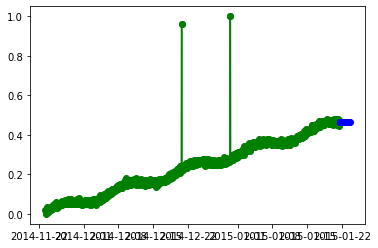

In [28]:
fit3 = SimpleExpSmoothing(df_indexed.copy().drop(columns=['is_anomaly','std_value','value'],axis=1)).fit()
fcast3 = fit3.forecast(50).rename(r'$\alpha=%s$'%fit3.model.params['smoothing_level'])
plt.plot(df_indexed['norm_value'], marker='o', color='green')
plt.plot(fcast3, marker='o', color='blue')

### Metric Calculation Functions

In [29]:
def model_eval(y, predictions):

    # Import library for metrics
    from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

    # Mean absolute error (MAE)
    mae = mean_absolute_error(y, predictions)

    # Mean squared error (MSE)
    mse = mean_squared_error(y, predictions)


    # SMAPE is an alternative for MAPE when there are zeros in the testing data. It
    # scales the absolute percentage by the sum of forecast and observed values
    SMAPE = np.mean(np.abs((y - predictions) / ((y + predictions)/2))) * 100


    # Calculate the Root Mean Squared Error
    rmse = np.sqrt(mean_squared_error(y, predictions))

    # Calculate the Mean Absolute Percentage Error
    # y, predictions = check_array(y, predictions)
    MAPE = np.mean(np.abs((y - predictions) / y)) * 100

    # mean_forecast_error
    mfe = np.mean(y - predictions)

    # NMSE normalizes the obtained MSE after dividing it by the test variance. It
    # is a balanced error measure and is very effective in judging forecast
    # accuracy of a model.

    # normalised_mean_squared_error
    NMSE = mse / (np.sum((y - np.mean(y)) ** 2)/(len(y)-1))


    # theil_u_statistic
    # It is a normalized measure of total forecast error.
    error = y - predictions
    mfe = np.sqrt(np.mean(predictions**2))
    mse = np.sqrt(np.mean(y**2))
    rmse = np.sqrt(np.mean(error**2))
    theil_u_statistic =  rmse / (mfe*mse)
    
    # Print metrics
    print("\n\n\nErrors:\n")
    print('Mean Absolute Error:', round(mae, 3))
    print('Mean Squared Error:', round(mse, 3))
    print('Root Mean Squared Error:', round(rmse, 3))
    print('Mean absolute percentage error:', round(MAPE, 3))
    print('Scaled Mean absolute percentage error:', round(SMAPE, 3))
    print('Mean forecast error:', round(mfe, 3))
    print('Normalised mean squared error:', round(NMSE, 3))
    print('Theil_u_statistic:', round(theil_u_statistic, 3))
    print("\n\n\n END Errors\n")

In [30]:
model_eval(X,pred)




Errors:

Mean Absolute Error: 0.015
Mean Squared Error: 0.277
Root Mean Squared Error: 0.041
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.851
Mean forecast error: 0.279
Normalised mean squared error: 0.086
Theil_u_statistic: 0.526



 END Errors



In [31]:
def calc_stats(truepositives, falsepositives,truenegatives,falsenegatives):
    stats = []
    if(len(truepositives) + len(falsepositives) > 0):
        precision = len(truepositives)/(len(truepositives) + len(falsepositives))
        #print("Precision: ", precision)
    else:
        #print("truepositives + falsepositives = 0")
        precision = 0
    stats.append(precision)
        
    if(len(truepositives) + len(falsenegatives) > 0):
        recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
        #print("Recall:", recall)
    else:
        #print("truepositives + falsenegatives = 0")
        recall = 0
    stats.append(recall)
           
    
    if(precision + recall > 0):
        f1 = 2*(precision * recall)/(precision + recall)
        #print("F1:",f1)
    else:
        #print("precision + recall = 0")
        f1= 0
    stats.append(f1)
        
    return stats

# In a for loop

In [32]:
start_time = datetime.now()
all_csv = glob.glob(f'/content/data/dataset/ydata-labeled-time-series-anomalies-v1_0/A2Benchmark/**/*.csv', recursive=True)
end_time = datetime.now()
print(f'Loaded the paths of {len(all_csv)} files from disk. Took {end_time-start_time}')

Loaded the paths of 100 files from disk. Took 0:00:00.001327


In [33]:
import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)

  0%|          | 0/100 [00:00<?, ?it/s]

synthetic_10
Mean:[100.51008157]
StandardDeviation: 994.1972524670381
Min: -1.659742, Max: 2.403750
                          value  is_anomaly  std_value  norm_value
timestamp                                                         
2014-11-23 07:00:00  127.699238           0   0.027348    0.415182
2014-11-23 08:00:00   23.069614           0  -0.077892    0.389283
2014-11-23 09:00:00  246.118857           0   0.146459    0.444495
2014-11-23 10:00:00  295.937818           0   0.196568    0.456826
2014-11-23 11:00:00  264.649986           0   0.165098    0.449082
...                         ...         ...        ...         ...
2015-01-21 07:00:00   21.595423           0  -0.079375    0.388918
2015-01-21 08:00:00 -246.681048           0  -0.349218    0.322512
2015-01-21 09:00:00  102.938096           0   0.002442    0.409053
2015-01-21 10:00:00  310.727447           0   0.211444    0.460487
2015-01-21 11:00:00  251.369372           0   0.151740    0.445794

[1421 rows x 4 columns]


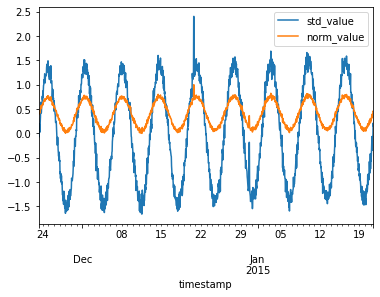


 19%|█▉        | 38/198 [00:03<00:18,  8.53it/s]

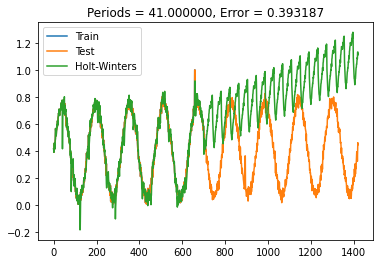


 75%|███████▌  | 149/198 [00:28<00:15,  3.15it/s]

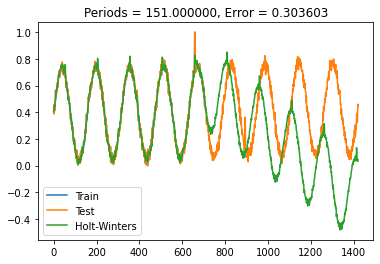


 76%|███████▌  | 150/198 [00:28<00:16,  2.91it/s]

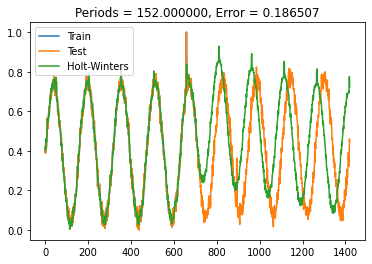


 78%|███████▊  | 155/198 [00:30<00:10,  4.17it/s]

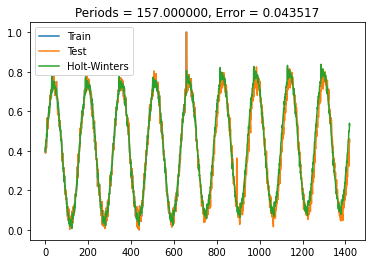


 79%|███████▉  | 156/198 [00:30<00:12,  3.31it/s]

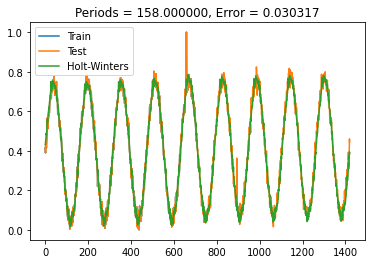


100%|██████████| 198/198 [00:44<00:00,  4.43it/s]


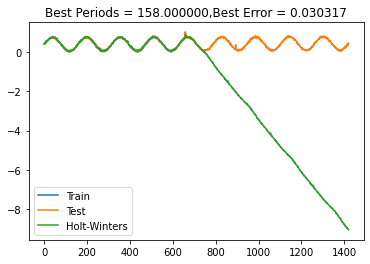

  1%|          | 1/100 [00:45<1:14:36, 45.22s/it]




Errors:

Mean Absolute Error: 0.022
Mean Squared Error: 0.477
Root Mean Squared Error: 0.03
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.428
Mean forecast error: 0.474
Normalised mean squared error: 0.015
Theil_u_statistic: 0.134



 END Errors

              timestamp      value  is_anomaly  std_value  norm_value  hw_pred
894 2014-12-30 13:00:00 -83.613394           1  -0.185198    0.362876  0.09855
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:3 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 0.25, F1: 0.4
synthetic_14
Mean:[4873.41721813]
StandardDeviation: 2960.351285938915
Min: -1.701976, Max: 2.722561
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   184.728233           0  -1.583829    0.0

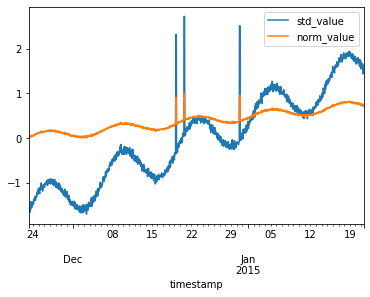


  0%|          | 0/198 [00:00<?, ?it/s]

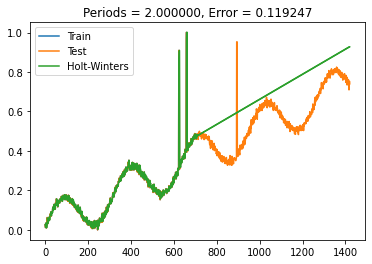


  2%|▏         | 3/198 [00:00<00:33,  5.76it/s]

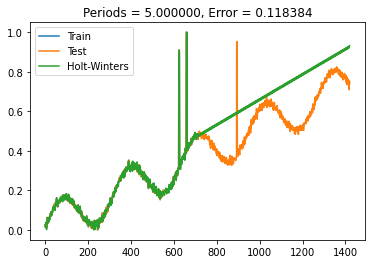


  3%|▎         | 5/198 [00:00<00:33,  5.77it/s]

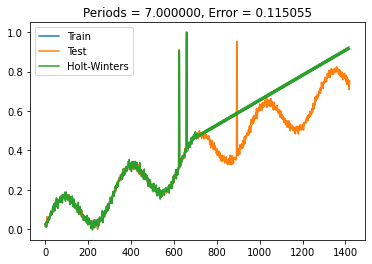


  6%|▌         | 12/198 [00:01<00:23,  7.88it/s]

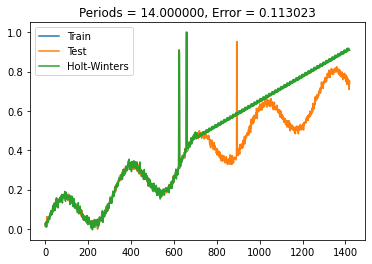


  8%|▊         | 15/198 [00:02<00:26,  7.01it/s]

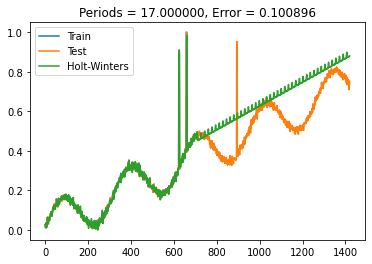


 30%|███       | 60/198 [00:08<00:18,  7.59it/s]

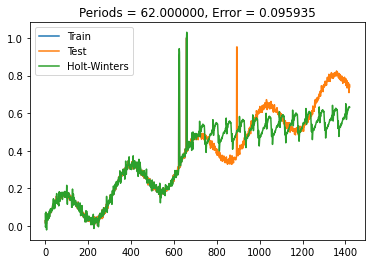


 39%|███▉      | 77/198 [00:10<00:17,  6.82it/s]

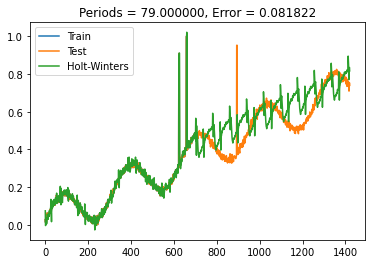


100%|██████████| 198/198 [00:26<00:00,  7.44it/s]


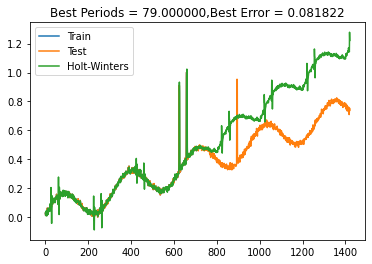

  2%|▏         | 2/100 [01:12<1:05:01, 39.81s/it]




Errors:

Mean Absolute Error: 0.051
Mean Squared Error: 0.446
Root Mean Squared Error: 0.082
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 17.121
Mean forecast error: 0.471
Normalised mean squared error: 0.131
Theil_u_statistic: 0.389



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  11741.659149  ...    0.909034  0.329616
658 2014-12-20 17:00:00  12933.153180  ...    1.000000  0.435304
893 2014-12-30 12:00:00  12313.689897  ...    0.952706  0.494495
894 2014-12-30 13:00:00  12313.689897  ...    0.952706  0.494820
895 2014-12-30 14:00:00  12313.689897  ...    0.952706  0.583832

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_20
Me

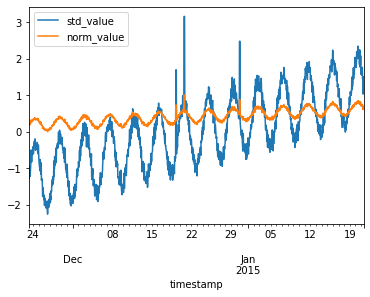


  0%|          | 0/198 [00:00<?, ?it/s]

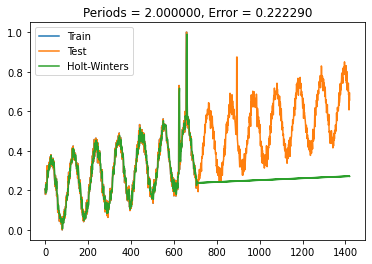


  1%|          | 2/198 [00:00<00:42,  4.64it/s]

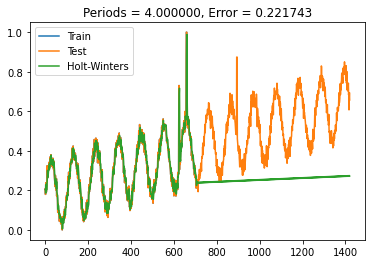


  4%|▎         | 7/198 [00:01<00:27,  7.05it/s]

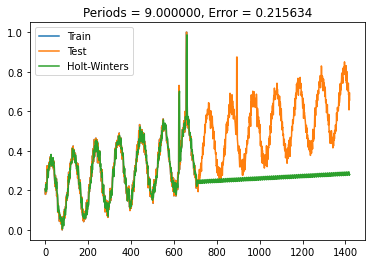


  6%|▌         | 11/198 [00:01<00:27,  6.83it/s]

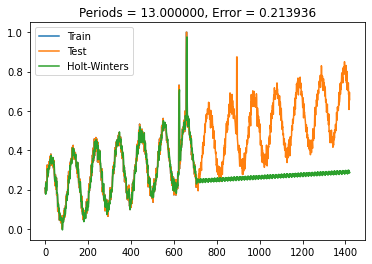


 12%|█▏        | 24/198 [00:03<00:24,  7.13it/s]

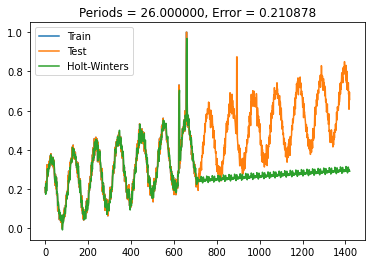


 14%|█▍        | 28/198 [00:04<00:28,  5.87it/s]

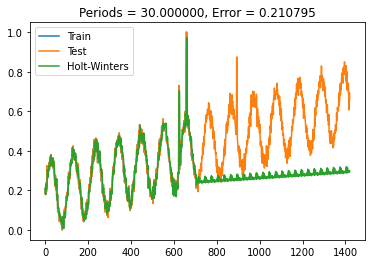


 19%|█▊        | 37/198 [00:06<00:28,  5.73it/s]

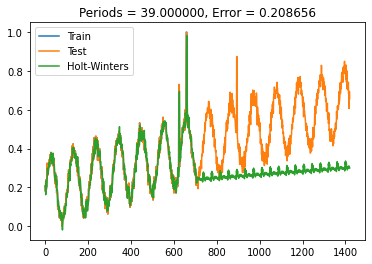


 21%|██        | 42/198 [00:07<00:34,  4.53it/s]

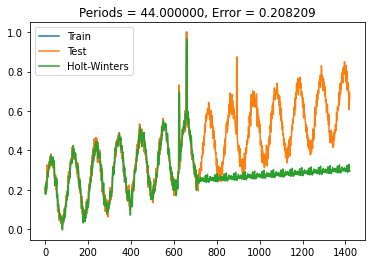


 27%|██▋       | 53/198 [00:09<00:28,  5.07it/s]

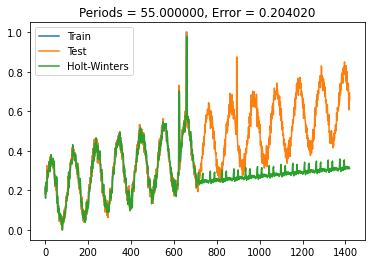


 38%|███▊      | 76/198 [00:16<00:35,  3.41it/s]

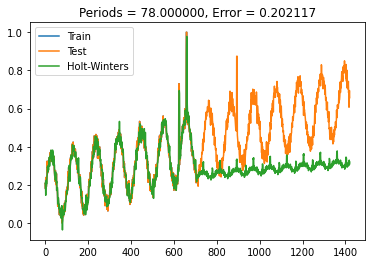


 44%|████▍     | 87/198 [00:19<00:31,  3.48it/s]

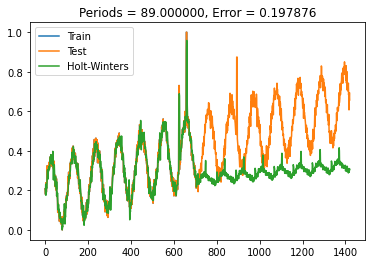


 44%|████▍     | 88/198 [00:20<00:36,  2.99it/s]

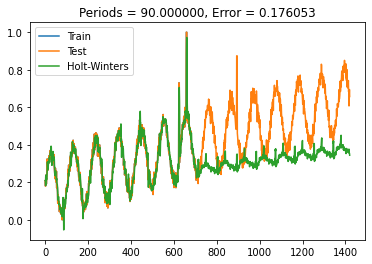


 51%|█████     | 100/198 [00:23<00:27,  3.60it/s]

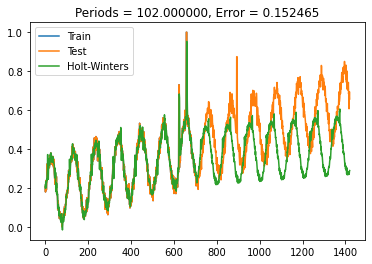


 52%|█████▏    | 102/198 [00:24<00:26,  3.64it/s]

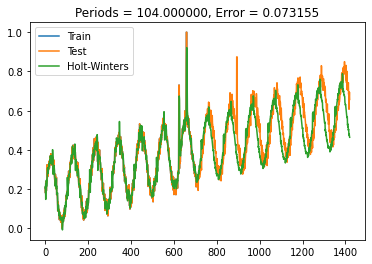


 52%|█████▏    | 103/198 [00:24<00:30,  3.07it/s]

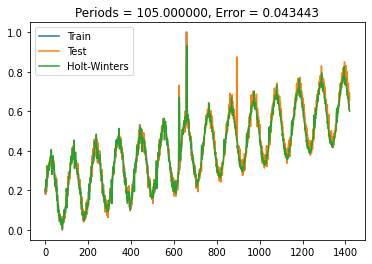


100%|██████████| 198/198 [00:50<00:00,  3.95it/s]


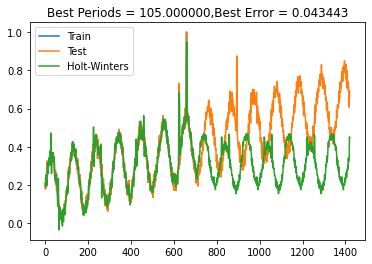

  3%|▎         | 3/100 [02:03<1:09:38, 43.08s/it]




Errors:

Mean Absolute Error: 0.028
Mean Squared Error: 0.456
Root Mean Squared Error: 0.043
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.305
Mean forecast error: 0.444
Normalised mean squared error: 0.055
Theil_u_statistic: 0.214



 END Errors

              timestamp        value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  4595.357487  ...    0.730017  0.350128
658 2014-12-20 17:00:00  6838.500015  ...    1.000000  0.620464
893 2014-12-30 12:00:00  5794.273164  ...    0.874318  0.453578
894 2014-12-30 13:00:00  5794.273164  ...    0.874318  0.451074
895 2014-12-30 14:00:00  5794.273164  ...    0.874318  0.446346

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_28
Mean:[920

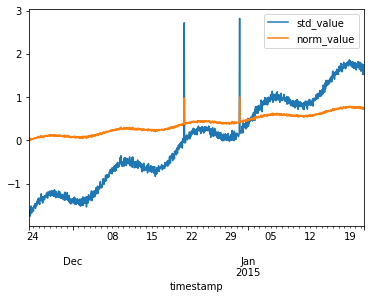


  0%|          | 0/198 [00:00<?, ?it/s]

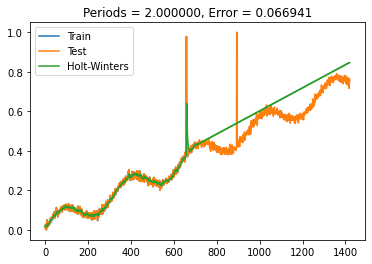


  1%|          | 1/198 [00:00<00:48,  4.07it/s]

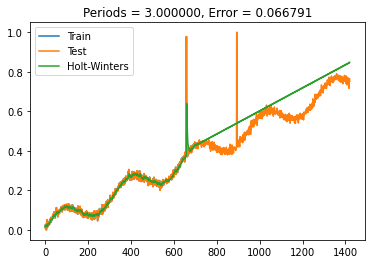


  1%|          | 2/198 [00:00<00:49,  3.98it/s]

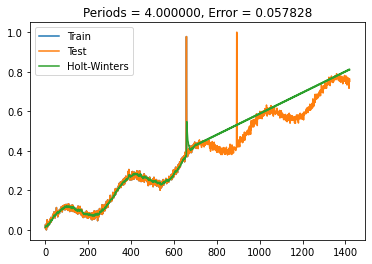


 24%|██▎       | 47/198 [00:09<00:41,  3.60it/s]

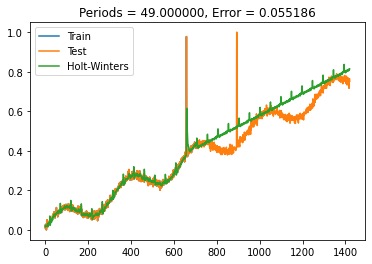


 24%|██▍       | 48/198 [00:09<00:48,  3.07it/s]

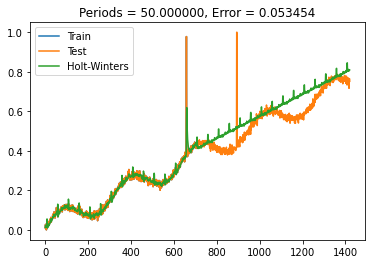


 44%|████▍     | 87/198 [00:20<00:32,  3.41it/s]

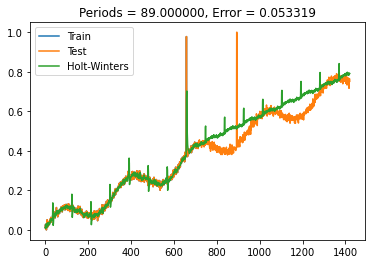


 51%|█████     | 101/198 [00:25<00:26,  3.61it/s]

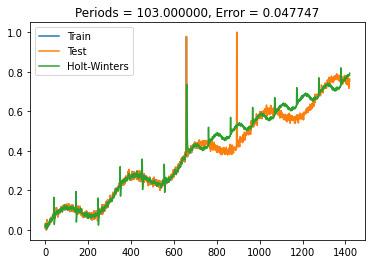


 62%|██████▏   | 122/198 [00:31<00:21,  3.47it/s]

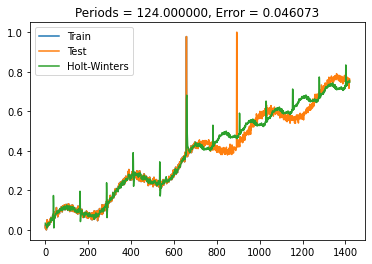


 98%|█████████▊| 195/198 [00:52<00:00,  3.36it/s]

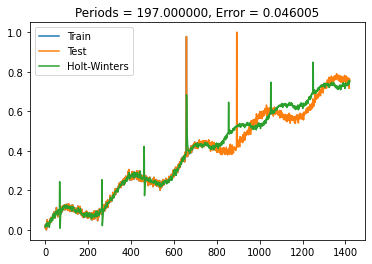


100%|██████████| 198/198 [00:53<00:00,  3.70it/s]


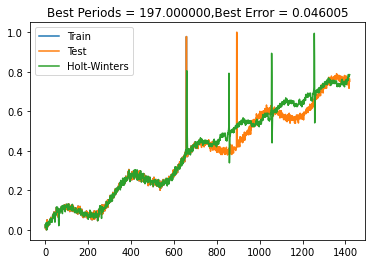

  4%|▍         | 4/100 [02:57<1:14:12, 46.38s/it]




Errors:

Mean Absolute Error: 0.028
Mean Squared Error: 0.441
Root Mean Squared Error: 0.046
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.237
Mean forecast error: 0.452
Normalised mean squared error: 0.044
Theil_u_statistic: 0.231



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  23827.991635  ...    0.977858  0.532576
659 2014-12-20 18:00:00  23827.991635  ...    0.977858  0.682961
893 2014-12-30 12:00:00  24372.452465  ...    1.000000  0.524281
894 2014-12-30 13:00:00  24372.452465  ...    1.000000  0.529464

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_56
Mean:[16835.83815589]
StandardDeviation: 9846.453856230068
Min: -1.769230, Max: 2.897896
         

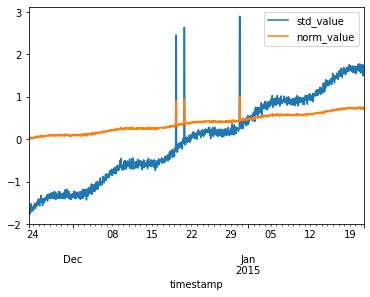


  0%|          | 0/198 [00:00<?, ?it/s]

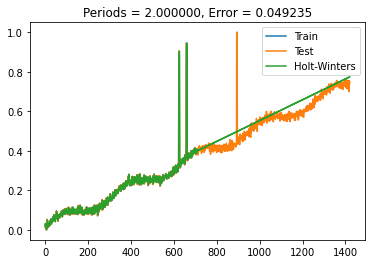


  1%|          | 1/198 [00:00<00:49,  3.95it/s]

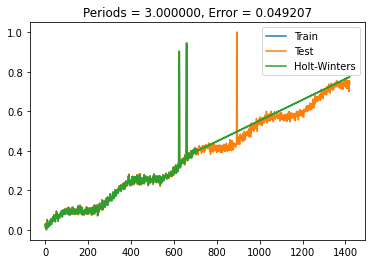


  2%|▏         | 3/198 [00:00<00:40,  4.78it/s]

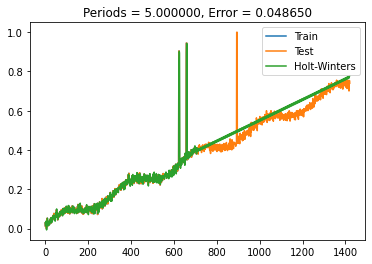


  5%|▌         | 10/198 [00:01<00:24,  7.83it/s]

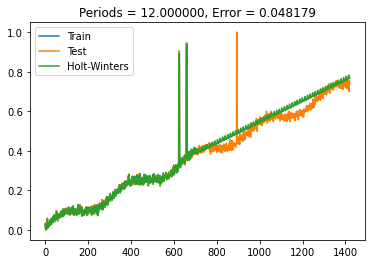


  6%|▌         | 12/198 [00:01<00:29,  6.39it/s]

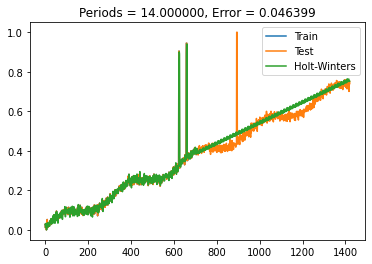


  8%|▊         | 15/198 [00:02<00:28,  6.31it/s]

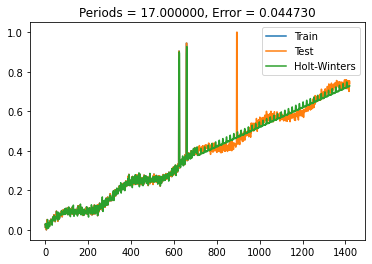


100%|██████████| 198/198 [00:37<00:00,  5.30it/s]


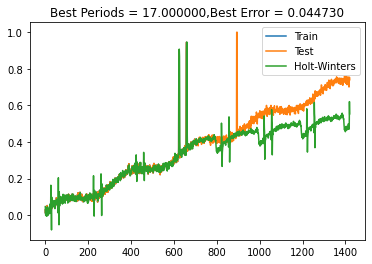

  5%|▌         | 5/100 [03:35<1:09:26, 43.86s/it]




Errors:

Mean Absolute Error: 0.021
Mean Squared Error: 0.435
Root Mean Squared Error: 0.045
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.045
Mean forecast error: 0.433
Normalised mean squared error: 0.044
Theil_u_statistic: 0.237



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  40955.420912  ...    0.903940  0.334076
658 2014-12-20 17:00:00  42818.472509  ...    0.944481  0.379993
893 2014-12-30 12:00:00  45369.834825  ...    1.000000  0.467473
894 2014-12-30 13:00:00  45369.834825  ...    1.000000  0.465728
895 2014-12-30 14:00:00  45369.834825  ...    1.000000  0.482400

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_5
Mean

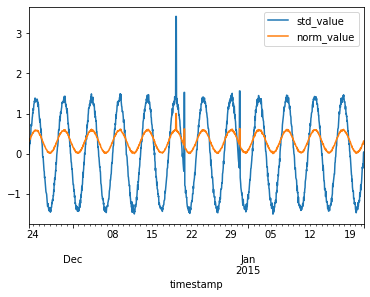


 15%|█▍        | 29/198 [00:03<00:18,  9.14it/s]

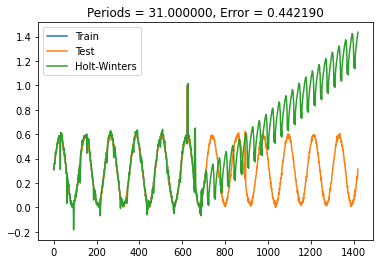


 20%|██        | 40/198 [00:04<00:16,  9.73it/s]

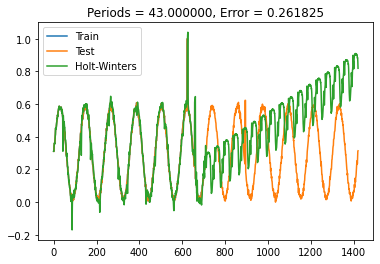


 34%|███▍      | 67/198 [00:07<00:22,  5.95it/s]

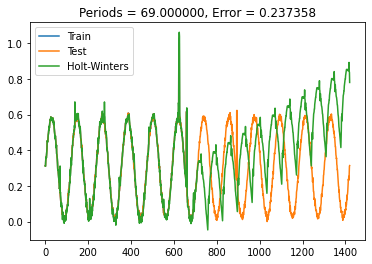


 34%|███▍      | 68/198 [00:07<00:32,  4.06it/s]

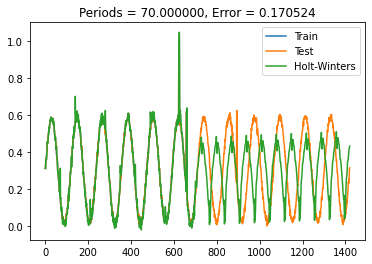


100%|██████████| 198/198 [00:33<00:00,  5.91it/s]


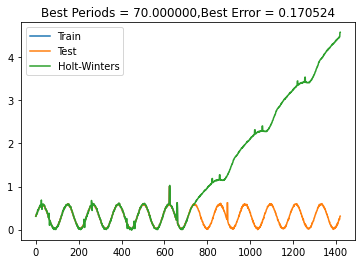

  6%|▌         | 6/100 [04:09<1:04:05, 40.91s/it]




Errors:

Mean Absolute Error: 0.108
Mean Squared Error: 0.367
Root Mean Squared Error: 0.171
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 48.684
Mean forecast error: 0.355
Normalised mean squared error: 0.707
Theil_u_statistic: 1.307



 END Errors

               timestamp        value  ...  norm_value   hw_pred
623  2014-12-19 06:00:00  3476.324022  ...    1.000000  0.580574
658  2014-12-20 17:00:00  1571.378918  ...    0.615672  0.183738
749  2014-12-24 12:00:00  1315.657419  ...    0.564080  0.308668
751  2014-12-24 14:00:00  1235.790755  ...    0.547967  0.285272
752  2014-12-24 15:00:00  1137.802588  ...    0.528197  0.275231
...                  ...          ...  ...         ...       ...
1335 2015-01-17 22:00:00  1509.196525  ...    0.603127  0.252062
1336 2015-01-17 23:00:00  1455.098244  ...    0.592213  0.258774
1337 2015-01-18 00:00:00  1389.982907  ...    0.579075  0.276279
1338 2015-01-18 01:00:00  1325.749437  ...    0.566116  0.290106
13

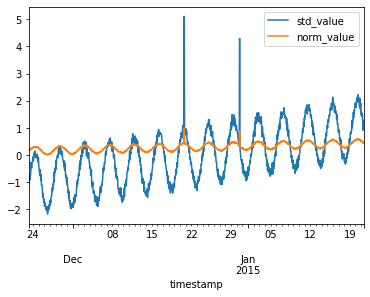


  0%|          | 0/198 [00:00<?, ?it/s]

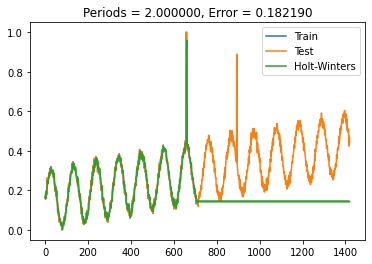


  1%|          | 2/198 [00:00<00:40,  4.83it/s]

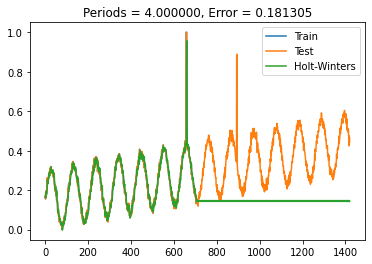


  4%|▎         | 7/198 [00:01<00:26,  7.34it/s]

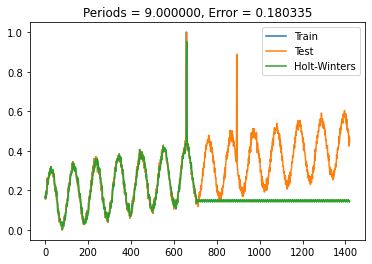


  6%|▌         | 11/198 [00:01<00:25,  7.40it/s]

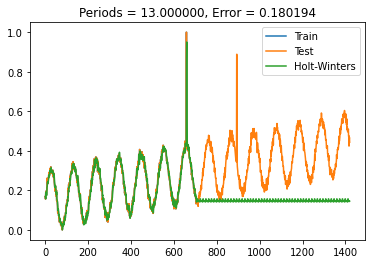


  9%|▊         | 17/198 [00:02<00:25,  7.23it/s]

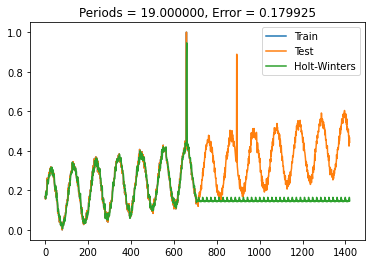


 12%|█▏        | 24/198 [00:03<00:25,  6.70it/s]

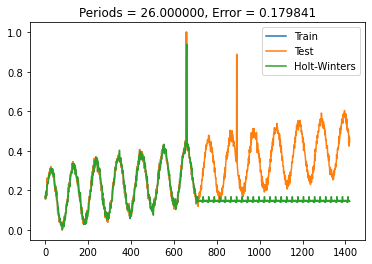


 14%|█▍        | 28/198 [00:04<00:28,  6.00it/s]

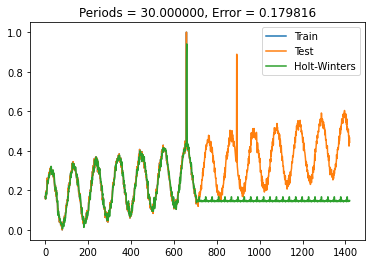


 15%|█▍        | 29/198 [00:04<00:35,  4.74it/s]

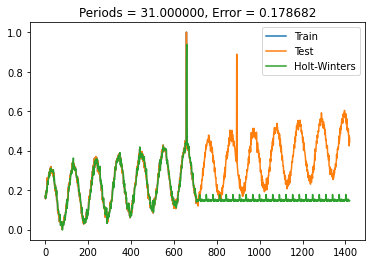


 21%|██        | 42/198 [00:07<00:27,  5.66it/s]

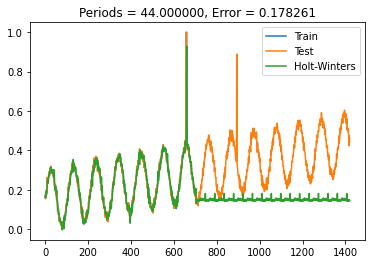


 23%|██▎       | 45/198 [00:07<00:31,  4.79it/s]

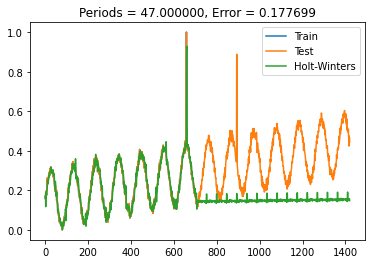


 29%|██▉       | 57/198 [00:10<00:31,  4.49it/s]

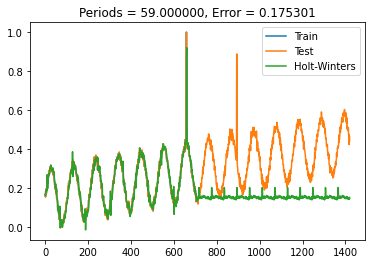


 39%|███▉      | 77/198 [00:14<00:23,  5.16it/s]

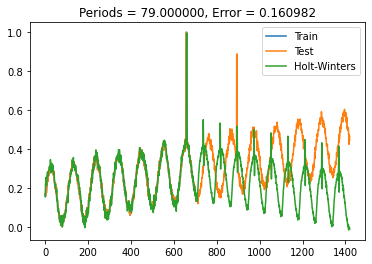


 50%|█████     | 99/198 [00:19<00:26,  3.68it/s]

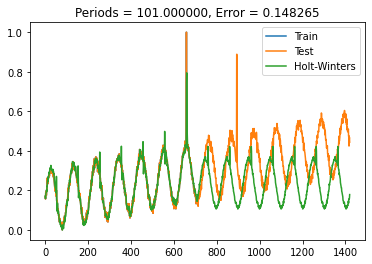


 51%|█████     | 100/198 [00:19<00:28,  3.41it/s]

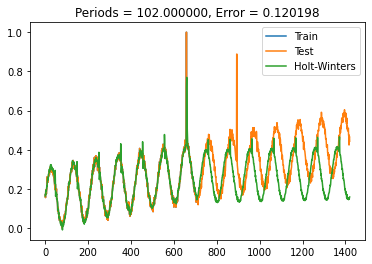


 51%|█████     | 101/198 [00:19<00:33,  2.90it/s]

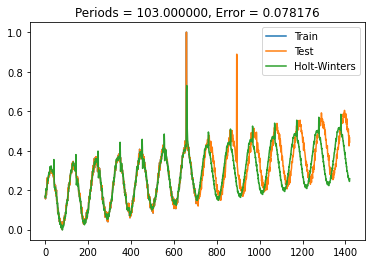


 52%|█████▏    | 102/198 [00:20<00:36,  2.66it/s]

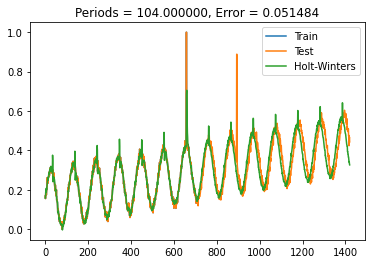


 52%|█████▏    | 103/198 [00:20<00:38,  2.49it/s]

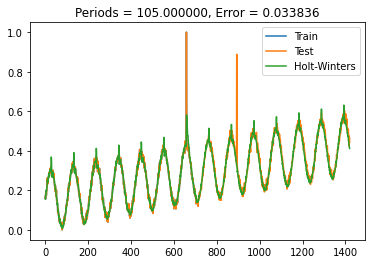


100%|██████████| 198/198 [00:45<00:00,  4.36it/s]


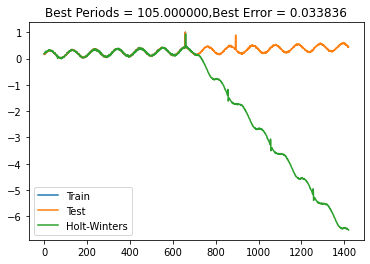

  7%|▋         | 7/100 [04:55<1:05:44, 42.41s/it]




Errors:

Mean Absolute Error: 0.016
Mean Squared Error: 0.329
Root Mean Squared Error: 0.034
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 6.398
Mean forecast error: 0.323
Normalised mean squared error: 0.061
Theil_u_statistic: 0.318



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  8056.267028  ...    1.000000  0.493108
659 2014-12-20 18:00:00  8056.267028  ...    1.000000  0.581473
893 2014-12-30 12:00:00  6995.828286  ...    0.888282  0.324549
894 2014-12-30 13:00:00  6995.828286  ...    0.888282  0.319718

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_65
Mean:[13721.57806564]
StandardDeviation: 8515.53098151755
Min: -1.603435, Max: 5.261480
               

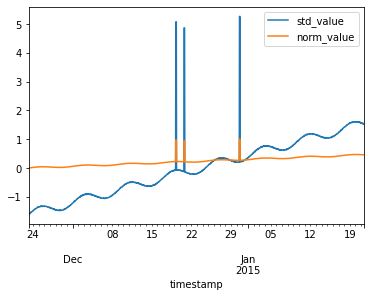


  0%|          | 0/198 [00:00<?, ?it/s]

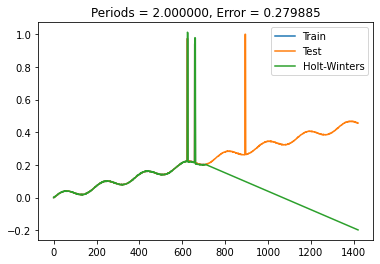


  1%|          | 1/198 [00:00<00:49,  4.01it/s]

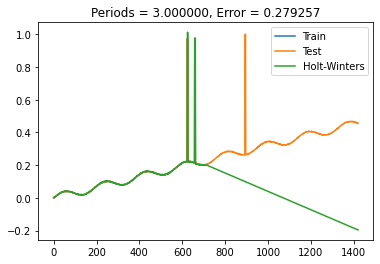


  1%|          | 2/198 [00:00<00:48,  4.02it/s]

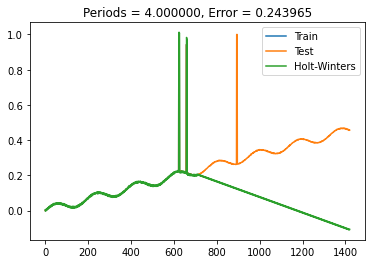


  3%|▎         | 6/198 [00:01<00:32,  5.82it/s]

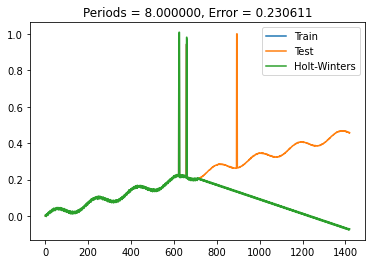


  5%|▌         | 10/198 [00:01<00:27,  6.87it/s]

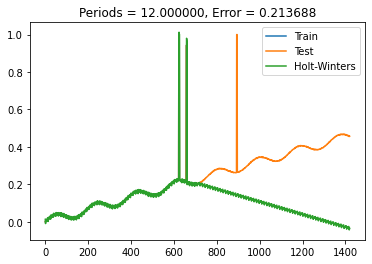


  7%|▋         | 13/198 [00:02<00:25,  7.15it/s]

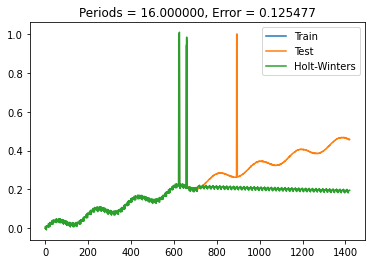


 12%|█▏        | 24/198 [00:03<00:18,  9.24it/s]

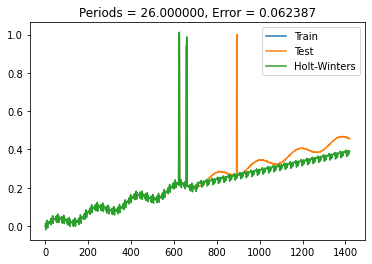


 26%|██▋       | 52/198 [00:06<00:18,  7.92it/s]

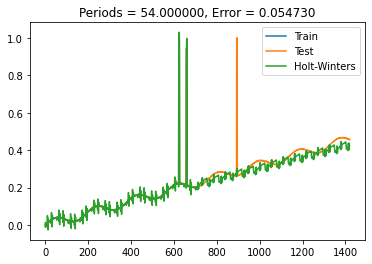


 38%|███▊      | 75/198 [00:11<00:33,  3.67it/s]

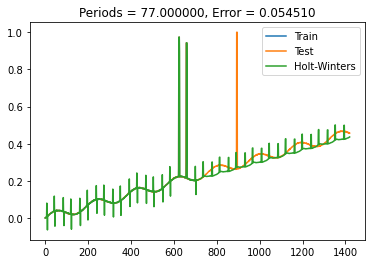


 38%|███▊      | 76/198 [00:11<00:39,  3.10it/s]

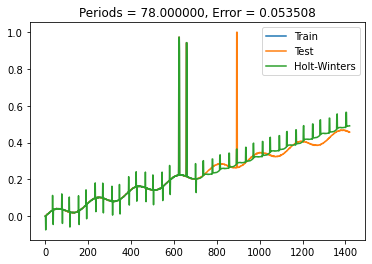


100%|██████████| 198/198 [00:36<00:00,  5.38it/s]


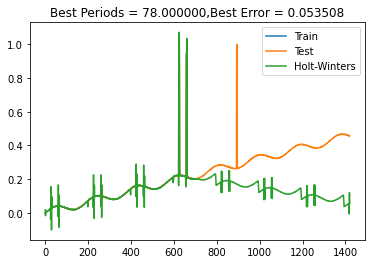

  8%|▊         | 8/100 [05:32<1:02:43, 40.91s/it]




Errors:

Mean Absolute Error: 0.018
Mean Squared Error: 0.275
Root Mean Squared Error: 0.054
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 11.413
Mean forecast error: 0.282
Normalised mean squared error: 0.135
Theil_u_statistic: 0.689



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  56936.569705  ...    0.972813  0.305435
658 2014-12-20 17:00:00  55144.032583  ...    0.942150  0.297600
893 2014-12-30 12:00:00  58525.873102  ...    1.000000  0.363436
894 2014-12-30 13:00:00  58525.873102  ...    1.000000  0.365078
895 2014-12-30 14:00:00  58525.873102  ...    1.000000  0.285426

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_4
Mea

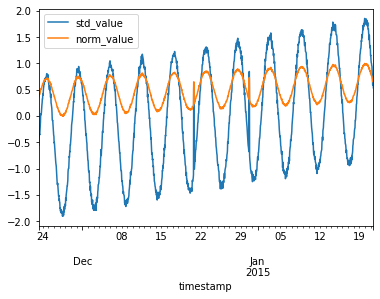


 19%|█▉        | 38/198 [00:03<00:16,  9.82it/s]

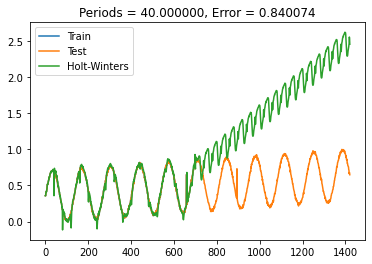


 25%|██▌       | 50/198 [00:05<00:14, 10.28it/s]

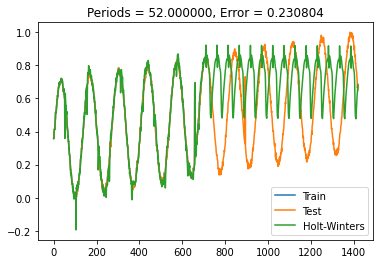


 37%|███▋      | 73/198 [00:08<00:20,  6.18it/s]

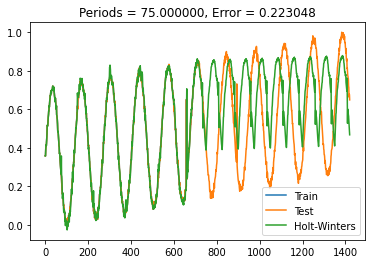


 65%|██████▌   | 129/198 [00:17<00:18,  3.80it/s]

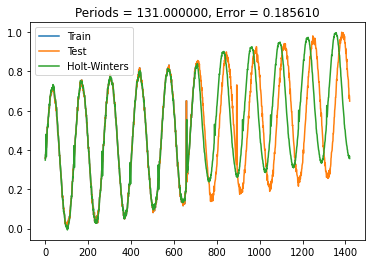


 66%|██████▌   | 130/198 [00:18<00:21,  3.10it/s]

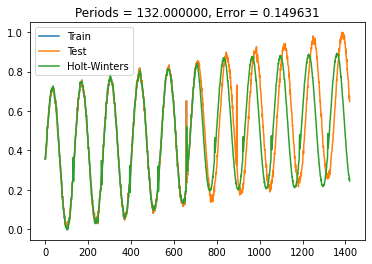


 66%|██████▌   | 131/198 [00:18<00:24,  2.70it/s]

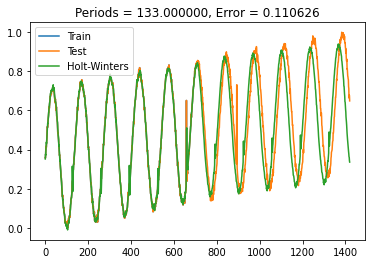


 67%|██████▋   | 132/198 [00:19<00:26,  2.53it/s]

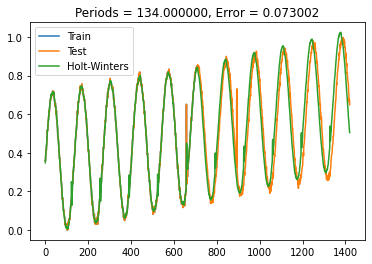


 67%|██████▋   | 133/198 [00:19<00:26,  2.41it/s]

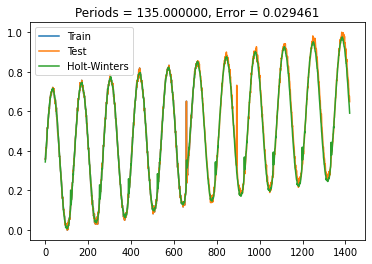


100%|██████████| 198/198 [00:32<00:00,  6.13it/s]


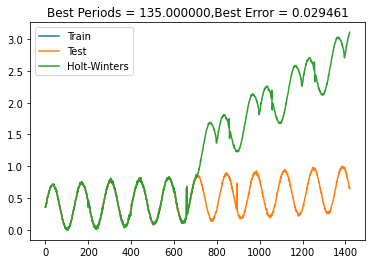

  9%|▉         | 9/100 [06:05<58:25, 38.52s/it]  




Errors:

Mean Absolute Error: 0.016
Mean Squared Error: 0.572
Root Mean Squared Error: 0.029
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 5.245
Mean forecast error: 0.564
Normalised mean squared error: 0.012
Theil_u_statistic: 0.091



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  1200.882156  ...    0.650823  0.312737
659 2014-12-20 18:00:00  1200.882156  ...    0.650823  0.353452
893 2014-12-30 12:00:00  1516.702355  ...    0.731410  0.291872
894 2014-12-30 13:00:00  1516.702355  ...    0.731410  0.282184

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_37
Mean:[6556.23277297]
StandardDeviation: 4013.701671974491
Min: -1.779668, Max: 5.148342
               

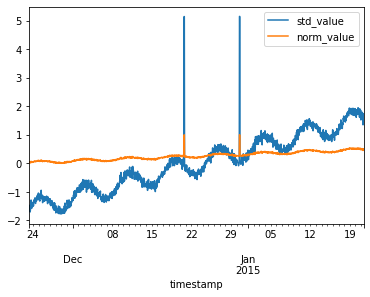


  0%|          | 0/198 [00:00<?, ?it/s]

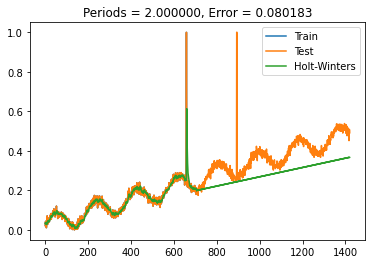


  1%|          | 2/198 [00:00<00:41,  4.75it/s]

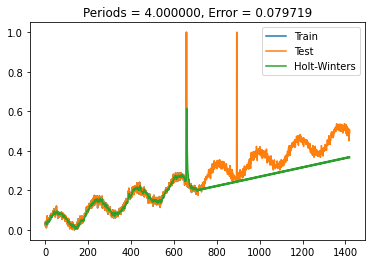


  5%|▍         | 9/198 [00:01<00:24,  7.61it/s]

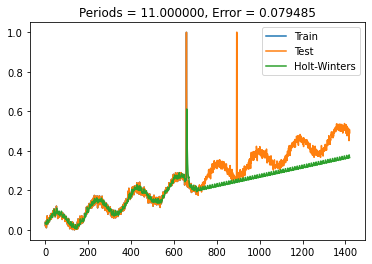


  5%|▌         | 10/198 [00:01<00:33,  5.57it/s]

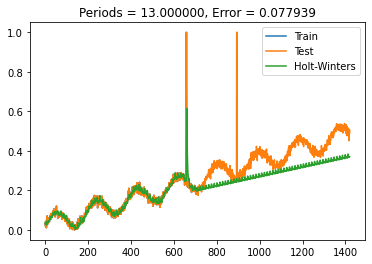


 12%|█▏        | 24/198 [00:03<00:28,  6.11it/s]

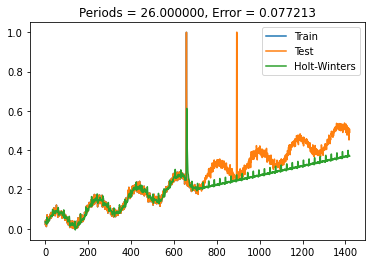


 13%|█▎        | 25/198 [00:04<00:38,  4.53it/s]

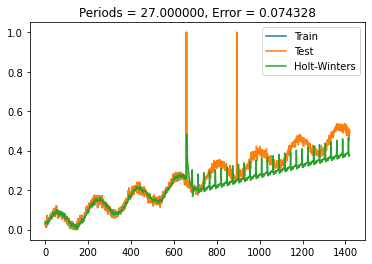


 35%|███▌      | 70/198 [00:15<00:36,  3.48it/s]

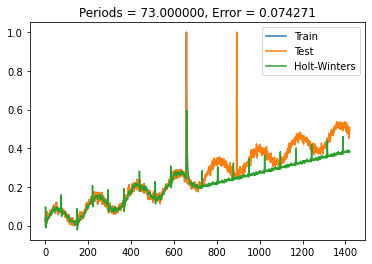


 40%|████      | 80/198 [00:18<00:30,  3.89it/s]

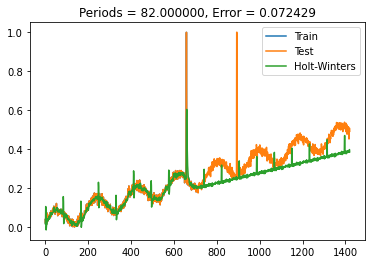


 46%|████▋     | 92/198 [00:22<00:30,  3.45it/s]

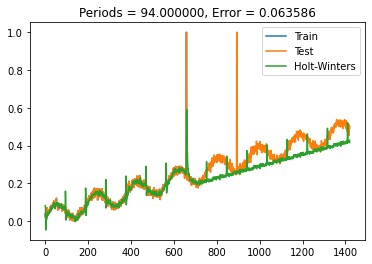


 71%|███████   | 141/198 [00:36<00:16,  3.41it/s]

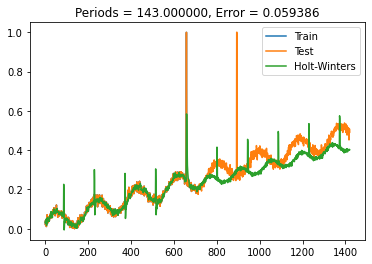


 84%|████████▍ | 167/198 [00:44<00:09,  3.35it/s]

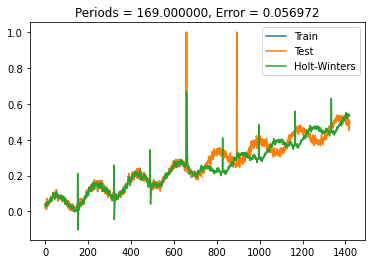


 88%|████████▊ | 175/198 [00:46<00:06,  3.32it/s]

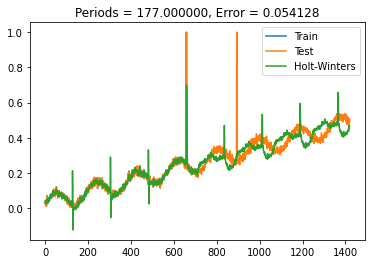


 92%|█████████▏| 182/198 [00:48<00:04,  3.50it/s]

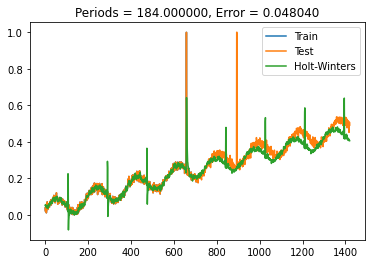


 93%|█████████▎| 184/198 [00:49<00:04,  3.07it/s]

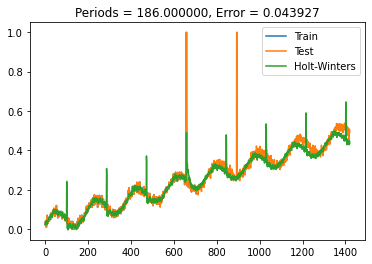


 93%|█████████▎| 185/198 [00:50<00:04,  2.76it/s]

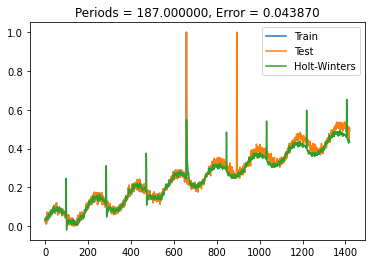


 95%|█████████▌| 189/198 [00:51<00:02,  3.06it/s]

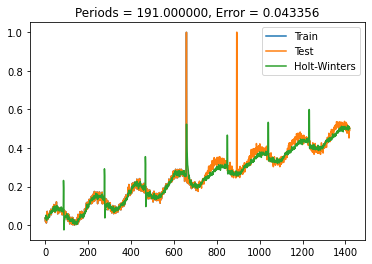


100%|██████████| 198/198 [00:54<00:00,  3.66it/s]


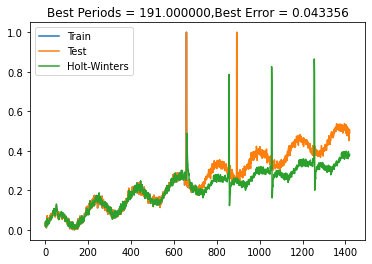

 10%|█         | 10/100 [07:00<1:04:59, 43.33s/it]




Errors:

Mean Absolute Error: 0.019
Mean Squared Error: 0.295
Root Mean Squared Error: 0.043
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.747
Mean forecast error: 0.285
Normalised mean squared error: 0.09
Theil_u_statistic: 0.517



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  27200.959593  ...     0.99931  0.413644
659 2014-12-20 18:00:00  27200.959593  ...     0.99931  0.523470
893 2014-12-30 12:00:00  27220.140302  ...     1.00000  0.268100
894 2014-12-30 13:00:00  27220.140302  ...     1.00000  0.274699

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_89
Mean:[2615.63968374]
StandardDeviation: 1883.715524737801
Min: -2.103062, Max: 5.262630
          

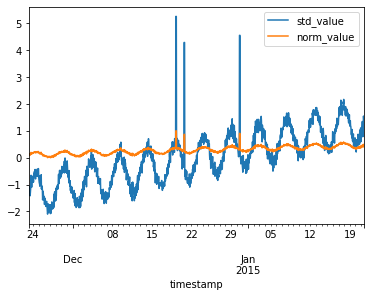


  0%|          | 0/198 [00:00<?, ?it/s]

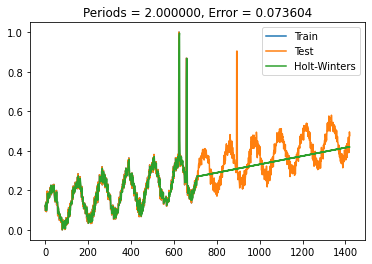


  1%|          | 1/198 [00:00<00:48,  4.05it/s]

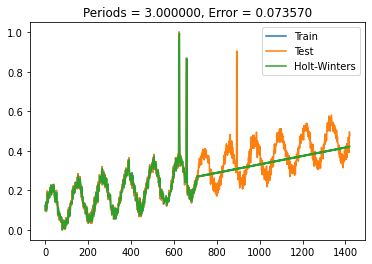


  1%|          | 2/198 [00:00<00:49,  4.00it/s]

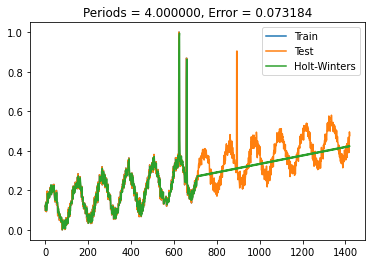


  3%|▎         | 6/198 [00:01<00:30,  6.35it/s]

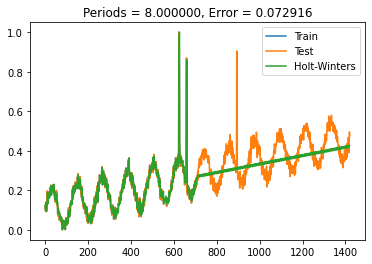


  4%|▎         | 7/198 [00:01<00:35,  5.31it/s]

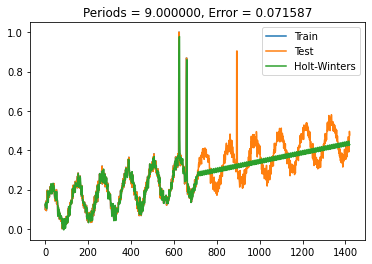


  6%|▌         | 11/198 [00:01<00:28,  6.62it/s]

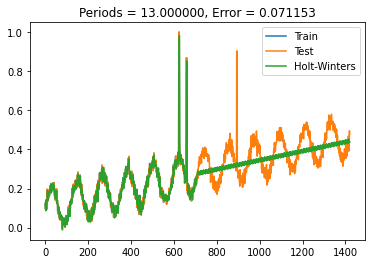


  7%|▋         | 13/198 [00:02<00:31,  5.87it/s]

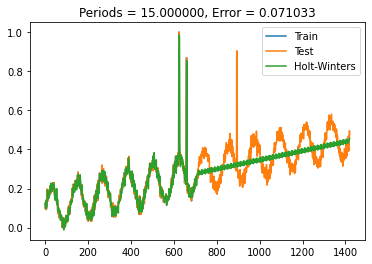


 12%|█▏        | 24/198 [00:04<00:26,  6.48it/s]

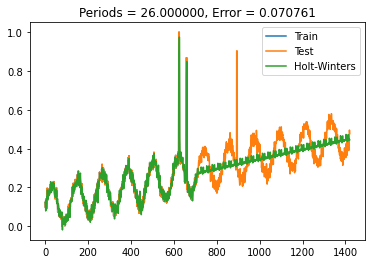


 14%|█▍        | 28/198 [00:04<00:30,  5.60it/s]

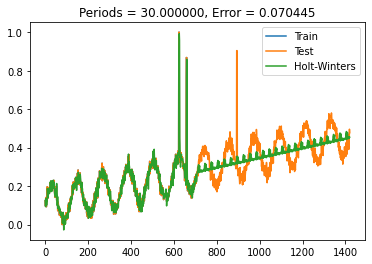


 39%|███▉      | 77/198 [00:17<00:34,  3.53it/s]

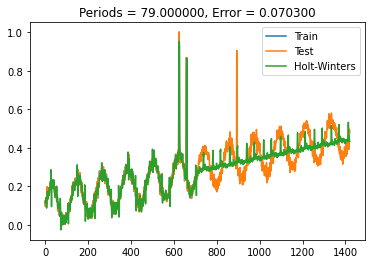


 59%|█████▊    | 116/198 [00:26<00:18,  4.33it/s]

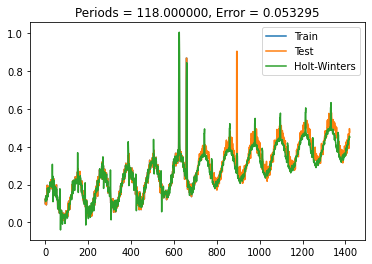


100%|██████████| 198/198 [00:45<00:00,  4.35it/s]


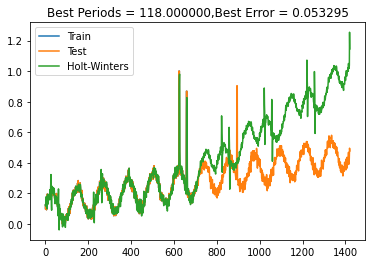

 11%|█         | 11/100 [07:46<1:05:29, 44.15s/it]




Errors:

Mean Absolute Error: 0.03
Mean Squared Error: 0.316
Root Mean Squared Error: 0.053
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.03
Mean forecast error: 0.301
Normalised mean squared error: 0.154
Theil_u_statistic: 0.56



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  12528.936742  ...    1.000000  0.462339
658 2014-12-20 17:00:00  10700.383682  ...    0.868211  0.345084
893 2014-12-30 12:00:00  11201.104157  ...    0.904299  0.261719
894 2014-12-30 13:00:00  11201.104157  ...    0.904299  0.364424
895 2014-12-30 14:00:00  11201.104157  ...    0.904299  0.352849

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_70
Mean:

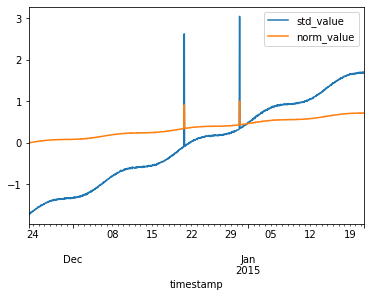


  0%|          | 0/198 [00:00<?, ?it/s]

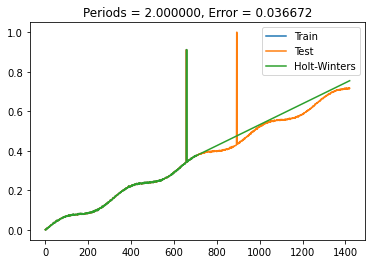


  1%|          | 1/198 [00:00<00:49,  3.98it/s]

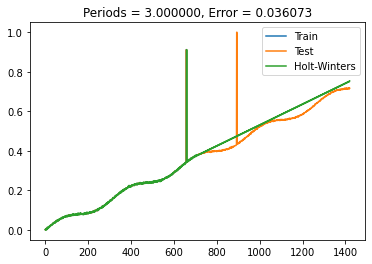


  2%|▏         | 3/198 [00:00<00:41,  4.69it/s]

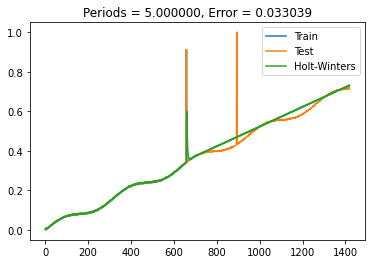


 12%|█▏        | 23/198 [00:03<00:24,  7.18it/s]

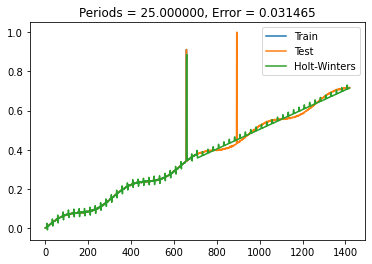


100%|██████████| 198/198 [00:36<00:00,  5.44it/s]


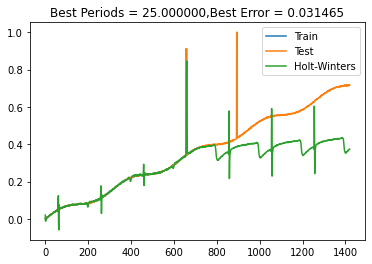

 12%|█▏        | 12/100 [08:23<1:01:34, 41.98s/it]




Errors:

Mean Absolute Error: 0.01
Mean Squared Error: 0.418
Root Mean Squared Error: 0.031
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 5.125
Mean forecast error: 0.416
Normalised mean squared error: 0.022
Theil_u_statistic: 0.181



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  60829.210260  ...    0.911686  0.362065
893 2014-12-30 12:00:00  66715.645056  ...    1.000000  0.450480
894 2014-12-30 13:00:00  66715.645056  ...    1.000000  0.451030

[3 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:3 | False Positive: 0
Neg:False Negative:1 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 0.75, F1: 0.8571428571428571
synthetic_33
Mean:[533.96746232]
StandardDeviation: 1069.8845215552883
Min: -2.420956, Max: 2.540857
                           value  is_anomaly  std_value  nor

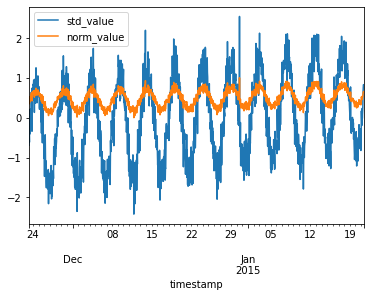


 49%|████▉     | 98/198 [00:15<00:24,  4.07it/s]

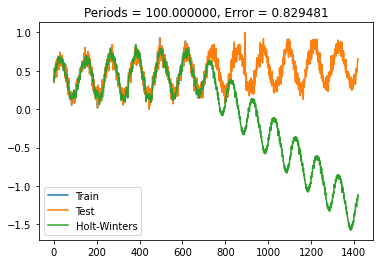


 58%|█████▊    | 114/198 [00:19<00:14,  5.79it/s]

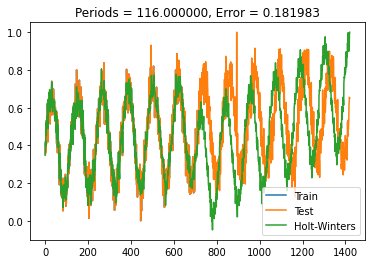


 59%|█████▉    | 117/198 [00:19<00:14,  5.58it/s]

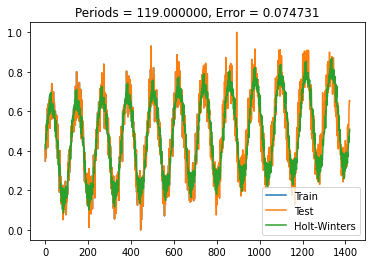


100%|██████████| 198/198 [00:41<00:00,  4.73it/s]


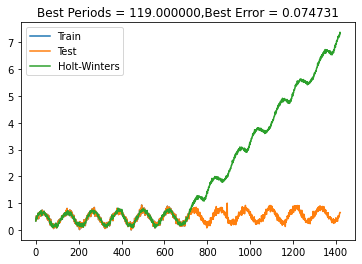

 13%|█▎        | 13/100 [09:05<1:01:04, 42.12s/it]




Errors:

Mean Absolute Error: 0.058
Mean Squared Error: 0.528
Root Mean Squared Error: 0.075
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 14.377
Mean forecast error: 0.519
Normalised mean squared error: 0.137
Theil_u_statistic: 0.273



 END Errors

               timestamp        value  ...  norm_value   hw_pred
494  2014-12-13 21:00:00  2880.566152  ...    0.929958  0.669902
893  2014-12-30 12:00:00  3252.390692  ...    1.000000  0.511914
1294 2015-01-16 05:00:00  1627.180150  ...    0.693851  0.392058

[3 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 2
Neg:False Negative:0 |True Negative: 1418
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 0.3333333333333333, Recall: 1.0, F1: 0.5
synthetic_47
Mean:[2231.12247092]
StandardDeviation: 1732.3768579769671
Min: -2.238422, Max: 5.157476
                           value  is_anomaly  std_value  n

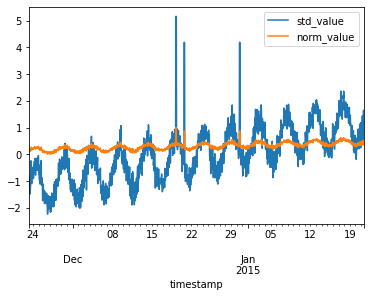


  0%|          | 0/198 [00:00<?, ?it/s]

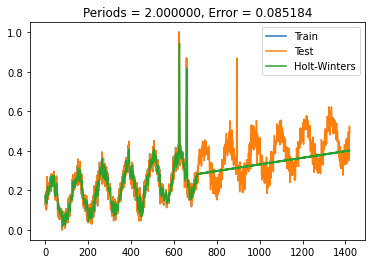


  1%|          | 1/198 [00:00<00:51,  3.81it/s]

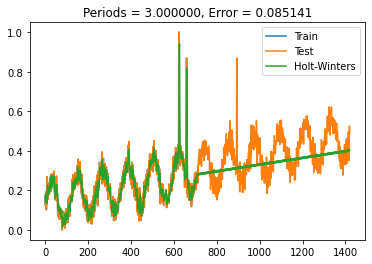


  1%|          | 2/198 [00:00<00:51,  3.82it/s]

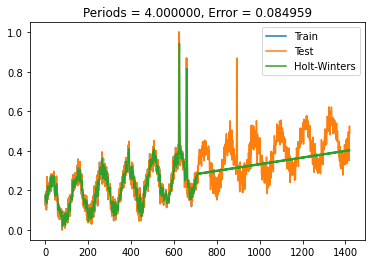


  2%|▏         | 3/198 [00:00<00:51,  3.82it/s]

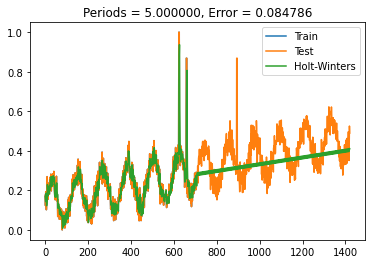


  4%|▎         | 7/198 [00:01<00:30,  6.18it/s]

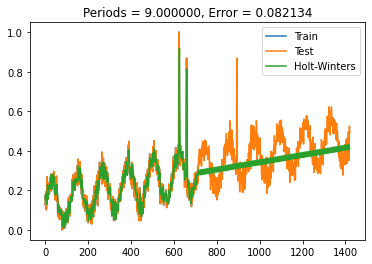


  6%|▌         | 11/198 [00:02<00:27,  6.87it/s]

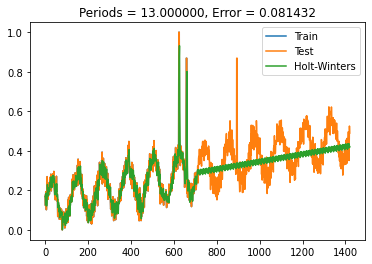


 12%|█▏        | 24/198 [00:03<00:24,  7.00it/s]

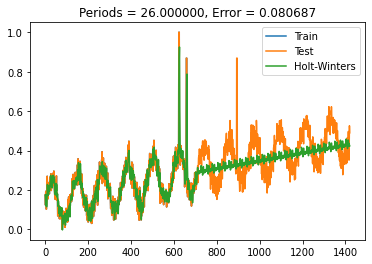


 14%|█▍        | 28/198 [00:04<00:32,  5.26it/s]

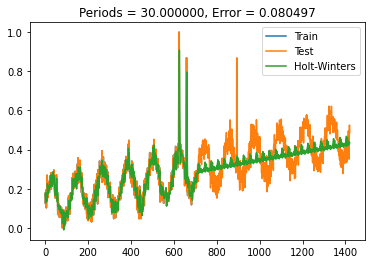


 19%|█▊        | 37/198 [00:06<00:31,  5.17it/s]

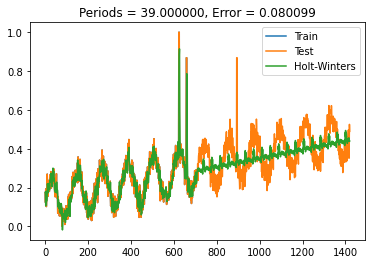


 38%|███▊      | 76/198 [00:16<00:34,  3.53it/s]

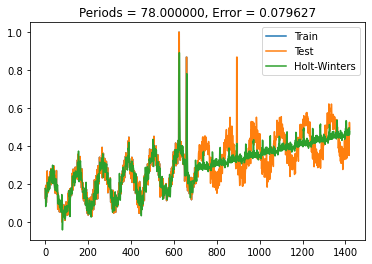


 58%|█████▊    | 115/198 [00:28<00:24,  3.46it/s]

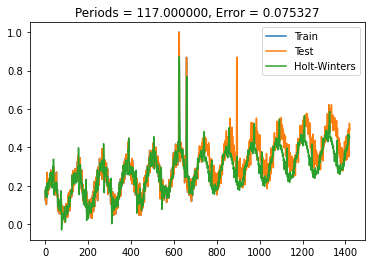


 59%|█████▊    | 116/198 [00:28<00:27,  2.99it/s]

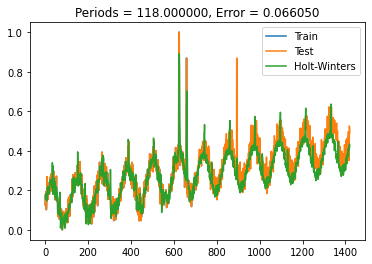


 59%|█████▉    | 117/198 [00:29<00:30,  2.68it/s]

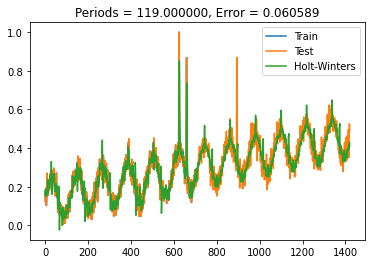


100%|██████████| 198/198 [00:52<00:00,  3.77it/s]


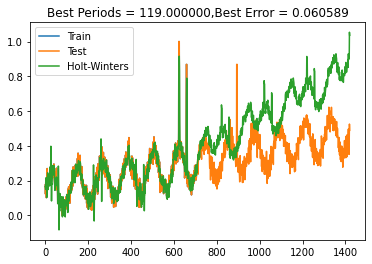

 14%|█▍        | 14/100 [09:58<1:05:04, 45.40s/it]




Errors:

Mean Absolute Error: 0.039
Mean Squared Error: 0.331
Root Mean Squared Error: 0.061
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.789
Mean forecast error: 0.327
Normalised mean squared error: 0.201
Theil_u_statistic: 0.56



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  11165.814595  ...    1.000000  0.466912
624 2014-12-19 07:00:00  11165.814595  ...    1.000000  0.741072
658 2014-12-20 17:00:00   9480.120535  ...    0.868433  0.353914
659 2014-12-20 18:00:00   9480.120535  ...    0.868433  0.593496
893 2014-12-30 12:00:00   9484.057504  ...    0.868741  0.309135
894 2014-12-30 13:00:00   9484.057504  ...    0.868741  0.319913
895 2014-12-30 14:00:00   9484.057504  ...    0.868741  0.317402

[7 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:7 | False Positive: 0
Neg:False Negative:2 |True Negative: 1412
Total Positives(Anomalies):9 | To

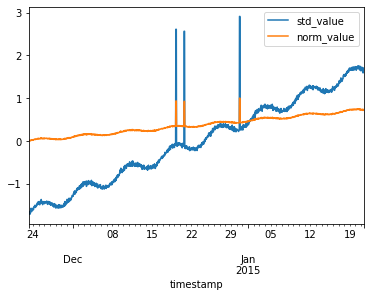


  0%|          | 0/198 [00:00<?, ?it/s]

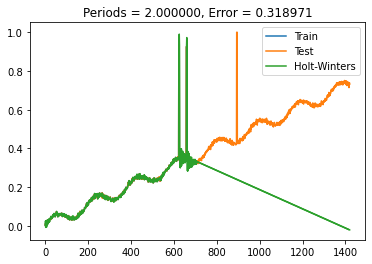


  1%|          | 1/198 [00:00<00:47,  4.14it/s]

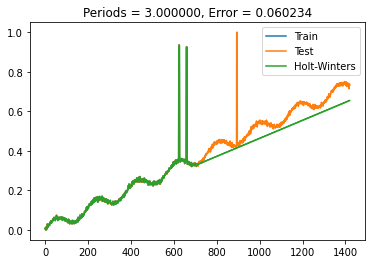


  1%|          | 2/198 [00:00<00:48,  4.05it/s]

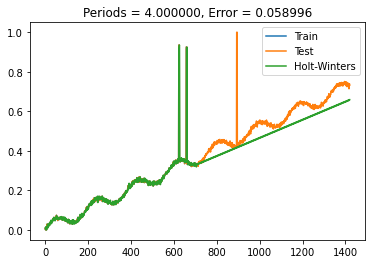


  3%|▎         | 6/198 [00:01<00:29,  6.47it/s]

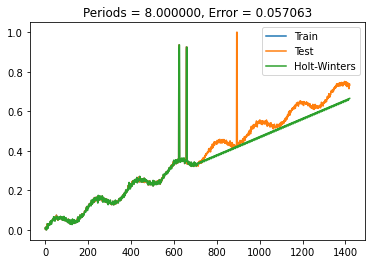


  4%|▎         | 7/198 [00:01<00:40,  4.70it/s]

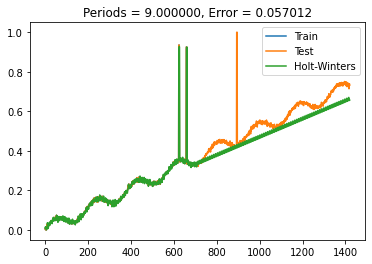


  5%|▌         | 10/198 [00:01<00:31,  6.02it/s]

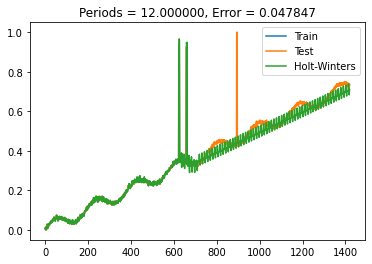


 13%|█▎        | 25/198 [00:03<00:19,  8.98it/s]

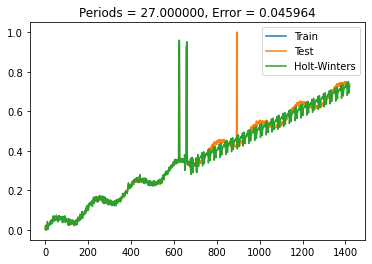


 15%|█▌        | 30/198 [00:04<00:20,  8.24it/s]

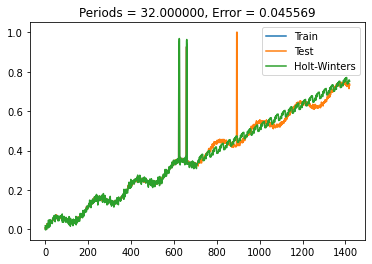


100%|██████████| 198/198 [00:34<00:00,  5.78it/s]


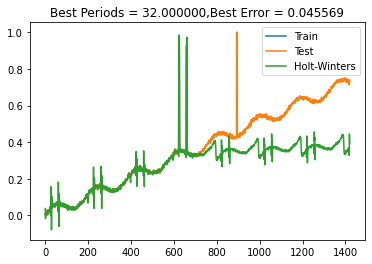

 15%|█▌        | 15/100 [10:33<59:48, 42.22s/it]  




Errors:

Mean Absolute Error: 0.019
Mean Squared Error: 0.429
Root Mean Squared Error: 0.046
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.409
Mean forecast error: 0.433
Normalised mean squared error: 0.044
Theil_u_statistic: 0.245



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  40839.190446  ...    0.935007  0.374884
658 2014-12-20 17:00:00  40401.500934  ...    0.924995  0.344879
893 2014-12-30 12:00:00  43680.480533  ...    1.000000  0.473446
894 2014-12-30 13:00:00  43680.480533  ...    1.000000  0.474280
895 2014-12-30 14:00:00  43680.480533  ...    1.000000  0.463939

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_22
Mea

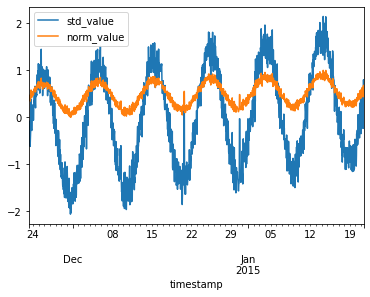


 67%|██████▋   | 132/198 [00:18<00:13,  4.91it/s]

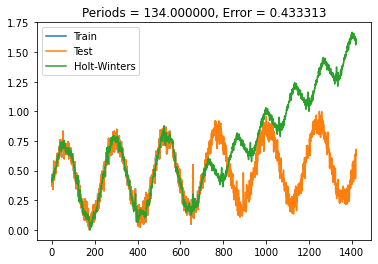


 86%|████████▋ | 171/198 [00:29<00:08,  3.18it/s]

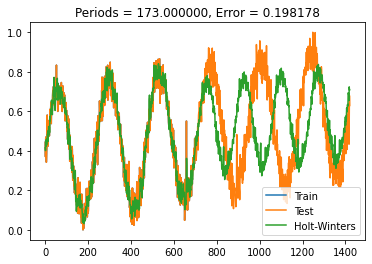


100%|██████████| 198/198 [00:38<00:00,  5.08it/s]


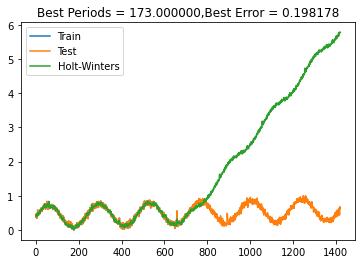

 16%|█▌        | 16/100 [11:12<57:57, 41.40s/it]




Errors:

Mean Absolute Error: 0.134
Mean Squared Error: 0.545
Root Mean Squared Error: 0.198
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 29.453
Mean forecast error: 0.533
Normalised mean squared error: 0.698
Theil_u_statistic: 0.682



 END Errors

               timestamp        value  ...  norm_value   hw_pred
658  2014-12-20 17:00:00   737.743951  ...    0.550373  0.261196
779  2014-12-25 18:00:00  2317.428655  ...    0.919813  0.664292
783  2014-12-25 22:00:00  2070.868927  ...    0.862150  0.596754
788  2014-12-26 03:00:00  2239.350501  ...    0.901553  0.605402
791  2014-12-26 06:00:00  2012.692635  ...    0.848544  0.590539
...                  ...          ...  ...         ...       ...
1238 2015-01-13 21:00:00  2244.557614  ...    0.902770  0.606886
1243 2015-01-14 02:00:00  2344.502876  ...    0.926144  0.660785
1244 2015-01-14 03:00:00  2287.902429  ...    0.912907  0.636104
1248 2015-01-14 07:00:00  2660.301496  ...    1.000000  0.704562
12

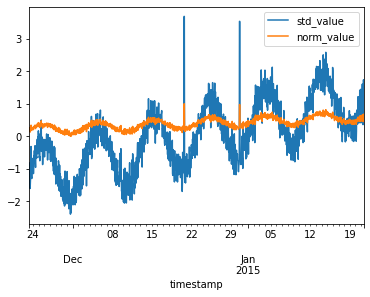


  0%|          | 0/198 [00:00<?, ?it/s]

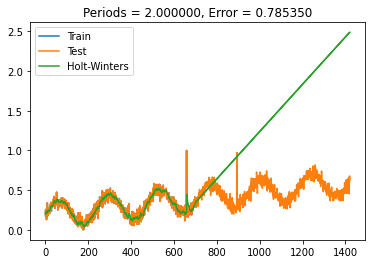


  1%|          | 1/198 [00:00<00:48,  4.05it/s]

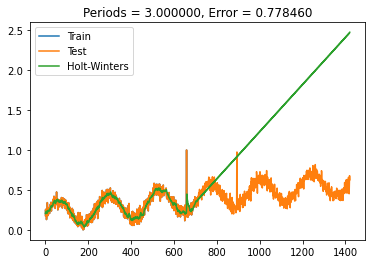


  2%|▏         | 4/198 [00:00<00:38,  4.99it/s]

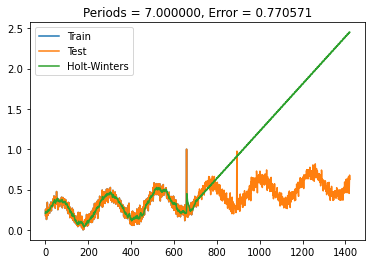


  3%|▎         | 6/198 [00:01<00:36,  5.23it/s]

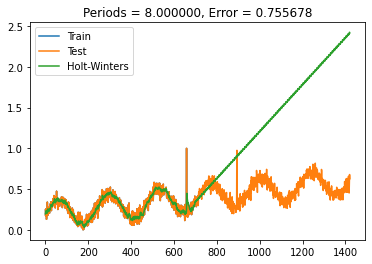


  7%|▋         | 13/198 [00:01<00:24,  7.50it/s]

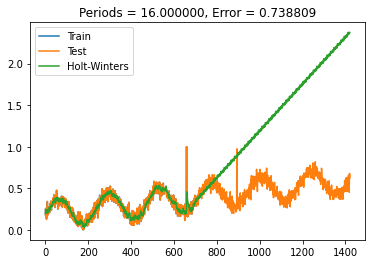


 11%|█         | 22/198 [00:02<00:19,  9.26it/s]

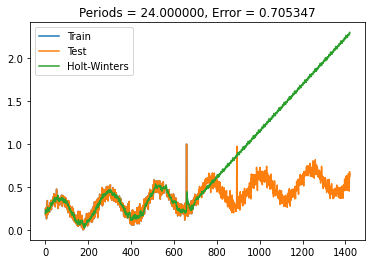


 15%|█▍        | 29/198 [00:03<00:18,  8.98it/s]

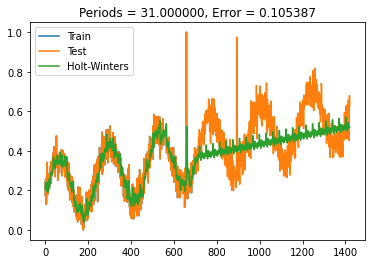


 32%|███▏      | 63/198 [00:09<00:27,  4.88it/s]

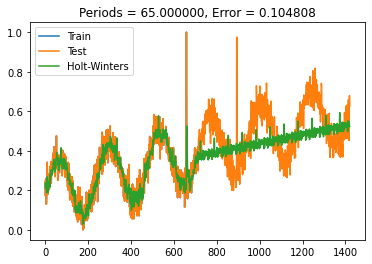


 42%|████▏     | 83/198 [00:14<00:26,  4.30it/s]

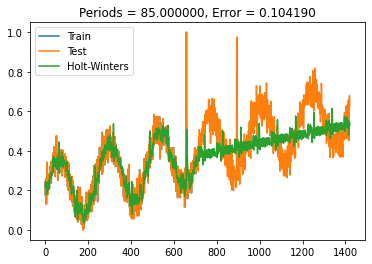


 58%|█████▊    | 114/198 [00:22<00:20,  4.02it/s]

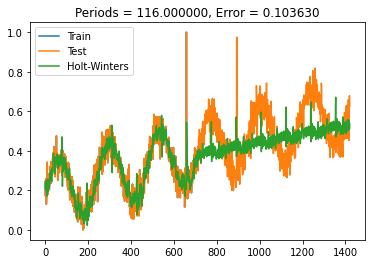


100%|██████████| 198/198 [00:47<00:00,  4.20it/s]


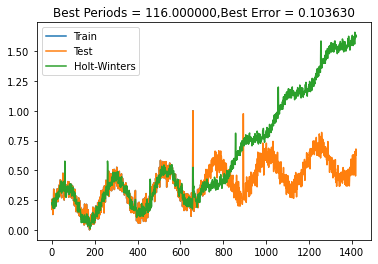

 17%|█▋        | 17/100 [12:00<59:53, 43.29s/it]




Errors:

Mean Absolute Error: 0.076
Mean Squared Error: 0.427
Root Mean Squared Error: 0.104
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 20.385
Mean forecast error: 0.393
Normalised mean squared error: 0.396
Theil_u_statistic: 0.618



 END Errors

               timestamp        value  ...  norm_value   hw_pred
658  2014-12-20 17:00:00  7147.294090  ...    1.000000  0.334171
659  2014-12-20 18:00:00  7147.294090  ...    1.000000  0.543020
762  2014-12-25 01:00:00  4187.375505  ...    0.661545  0.377185
779  2014-12-25 18:00:00  4218.831726  ...    0.665142  0.399662
893  2014-12-30 12:00:00  6928.658430  ...    0.975000  0.427843
894  2014-12-30 13:00:00  6928.658430  ...    0.975000  0.424013
985  2015-01-03 08:00:00  4780.786663  ...    0.729399  0.419950
986  2015-01-03 09:00:00  4399.663245  ...    0.685819  0.423493
1001 2015-01-04 00:00:00  4771.802764  ...    0.728372  0.438163
1032 2015-01-05 07:00:00  4902.302350  ...    0.743294  0.430726
12

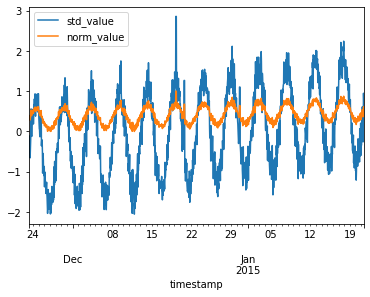


 15%|█▌        | 30/198 [00:02<00:16, 10.11it/s]

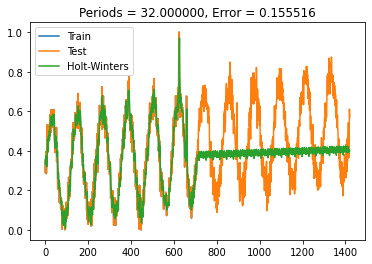


 18%|█▊        | 36/198 [00:03<00:18,  8.74it/s]

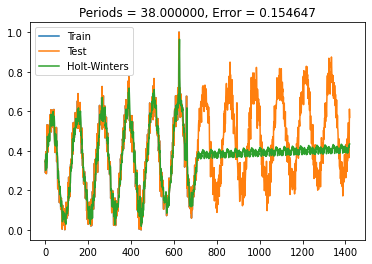


 20%|█▉        | 39/198 [00:04<00:22,  7.00it/s]

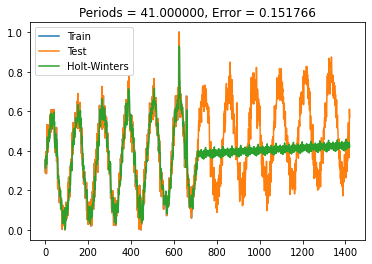


 58%|█████▊    | 115/198 [00:16<00:21,  3.81it/s]

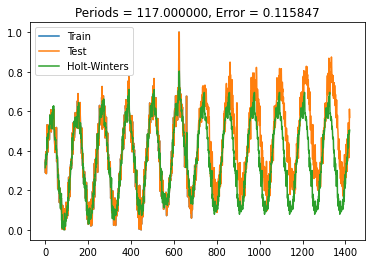


 59%|█████▊    | 116/198 [00:16<00:26,  3.10it/s]

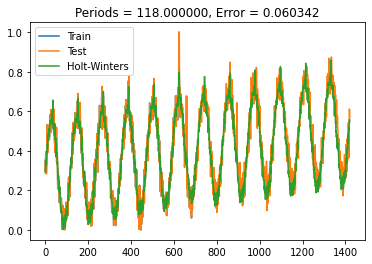


100%|██████████| 198/198 [00:43<00:00,  4.60it/s]


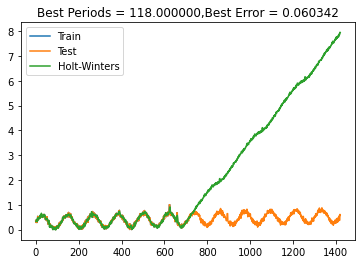

 18%|█▊        | 18/100 [12:44<59:18, 43.40s/it]




Errors:

Mean Absolute Error: 0.046
Mean Squared Error: 0.465
Root Mean Squared Error: 0.06
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.542
Mean forecast error: 0.452
Normalised mean squared error: 0.088
Theil_u_statistic: 0.287



 END Errors

              timestamp        value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  3755.844471  ...    1.000000  0.697014
624 2014-12-19 07:00:00  3755.844471  ...    1.000000  0.716961
658 2014-12-20 17:00:00  2041.956620  ...    0.676091  0.364853
659 2014-12-20 18:00:00  2041.956620  ...    0.676091  0.347964
660 2014-12-20 19:00:00  2041.956620  ...    0.676091  0.362548
893 2014-12-30 12:00:00  1865.879092  ...    0.642814  0.339546
894 2014-12-30 13:00:00  1865.879092  ...    0.642814  0.370101
895 2014-12-30 14:00:00  1865.879092  ...    0.642814  0.331055

[8 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:8 | False Positive: 0
Neg:False Negative:

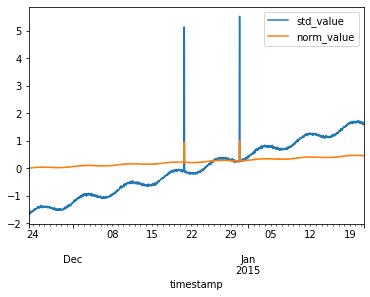


  0%|          | 0/198 [00:00<?, ?it/s]

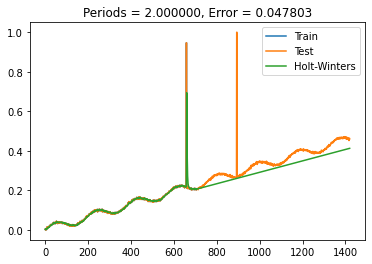


  1%|          | 2/198 [00:00<00:42,  4.57it/s]

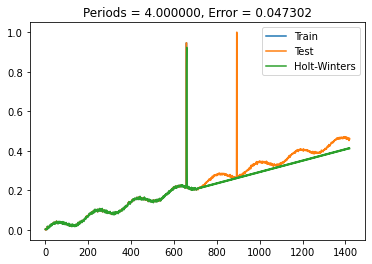


  4%|▎         | 7/198 [00:01<00:27,  6.93it/s]

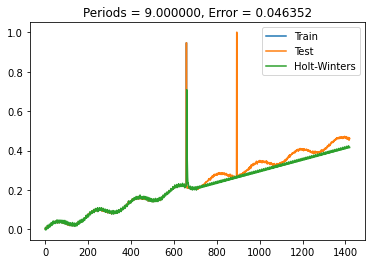


  6%|▌         | 12/198 [00:01<00:25,  7.18it/s]

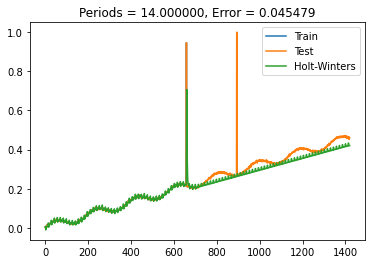


 18%|█▊        | 35/198 [00:06<00:30,  5.36it/s]

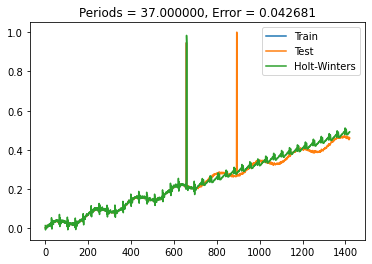


 21%|██        | 42/198 [00:07<00:28,  5.42it/s]

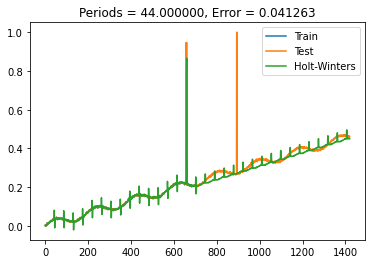


 48%|████▊     | 95/198 [00:17<00:20,  5.03it/s]

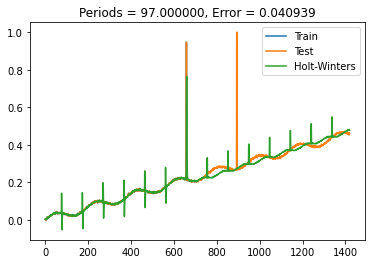


 58%|█████▊    | 115/198 [00:22<00:18,  4.61it/s]

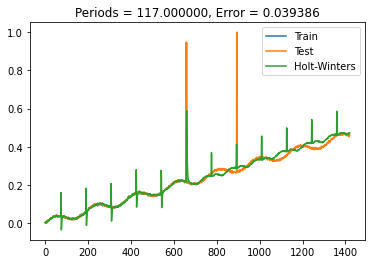


100%|██████████| 198/198 [00:42<00:00,  4.61it/s]


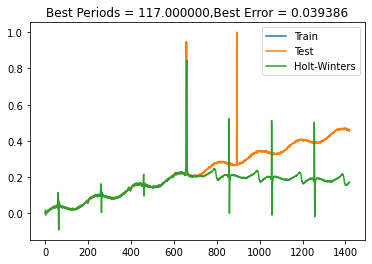

 19%|█▉        | 19/100 [13:27<58:37, 43.42s/it]




Errors:

Mean Absolute Error: 0.014
Mean Squared Error: 0.271
Root Mean Squared Error: 0.039
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.989
Mean forecast error: 0.275
Normalised mean squared error: 0.08
Theil_u_statistic: 0.529



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  62523.840007  ...    0.946406  0.340764
659 2014-12-20 18:00:00  62523.840007  ...    0.946406  0.565251
893 2014-12-30 12:00:00  66062.998024  ...    1.000000  0.410805
894 2014-12-30 13:00:00  66062.998024  ...    1.000000  0.291123

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_46
Mean:[4883.68918053]
StandardDeviation: 3002.178684244174
Min: -2.037034, Max: 2.547446
           

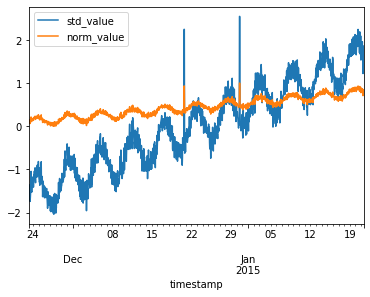


  0%|          | 0/198 [00:00<?, ?it/s]

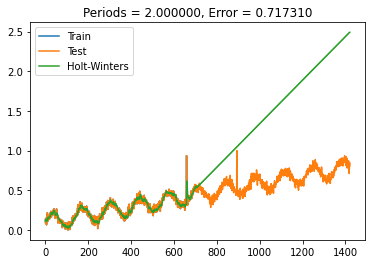


  1%|          | 1/198 [00:00<00:48,  4.06it/s]

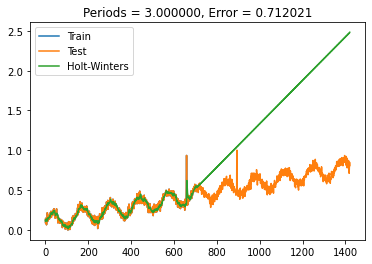


  3%|▎         | 5/198 [00:00<00:32,  5.94it/s]

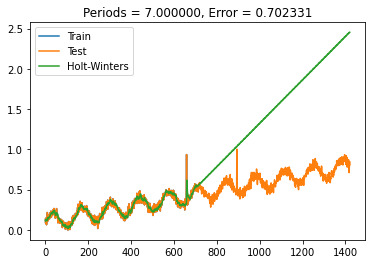


  3%|▎         | 6/198 [00:01<00:37,  5.08it/s]

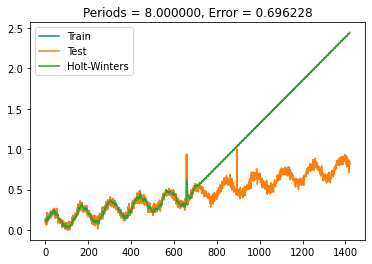


  7%|▋         | 14/198 [00:01<00:22,  8.34it/s]

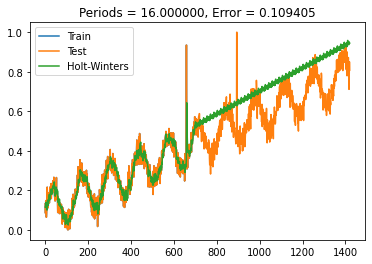


 15%|█▌        | 30/198 [00:03<00:17,  9.47it/s]

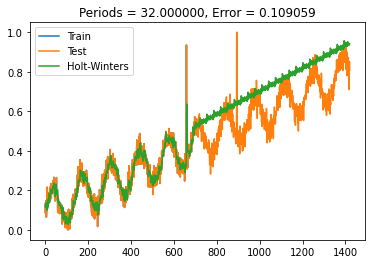


 20%|██        | 40/198 [00:05<00:32,  4.79it/s]

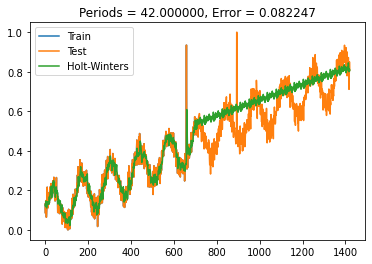


 55%|█████▌    | 109/198 [00:23<00:19,  4.67it/s]

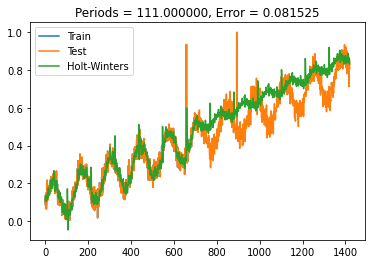


 65%|██████▍   | 128/198 [00:31<00:30,  2.32it/s]

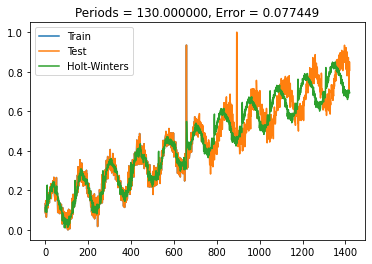


 65%|██████▌   | 129/198 [00:31<00:34,  1.97it/s]

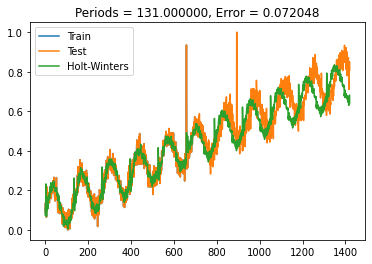


 66%|██████▌   | 130/198 [00:32<00:36,  1.87it/s]

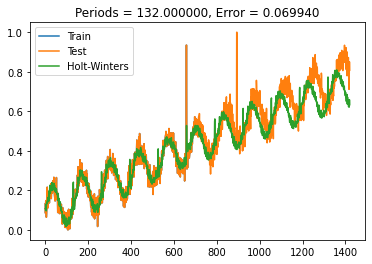


 66%|██████▌   | 131/198 [00:33<00:34,  1.95it/s]

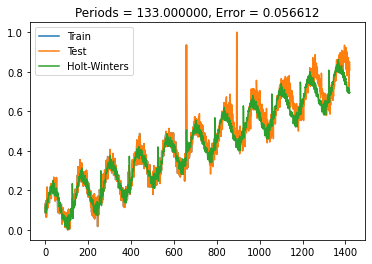


 67%|██████▋   | 133/198 [00:33<00:28,  2.29it/s]

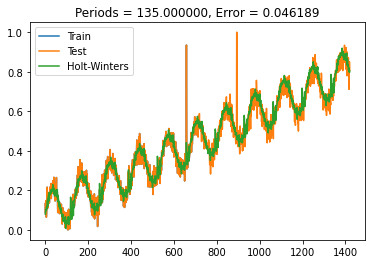


 68%|██████▊   | 134/198 [00:34<00:28,  2.25it/s]

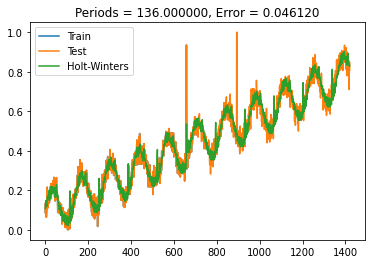


100%|██████████| 198/198 [00:53<00:00,  3.69it/s]


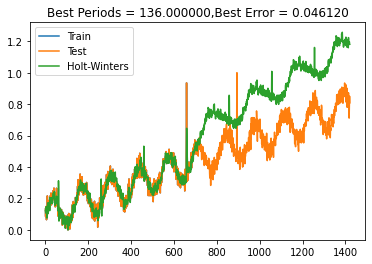

 20%|██        | 20/100 [14:21<1:02:10, 46.64s/it]




Errors:

Mean Absolute Error: 0.031
Mean Squared Error: 0.495
Root Mean Squared Error: 0.046
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 9.673
Mean forecast error: 0.494
Normalised mean squared error: 0.045
Theil_u_statistic: 0.189



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  11631.177393  ...     0.93458  0.443161
659 2014-12-20 18:00:00  11631.177393  ...     0.93458  0.536319
893 2014-12-30 12:00:00  12531.576868  ...     1.00000  0.473613
894 2014-12-30 13:00:00  12531.576868  ...     1.00000  0.474783

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_69
Mean:[7829.96880853]
StandardDeviation: 4650.424410039521
Min: -1.820052, Max: 5.763673
          

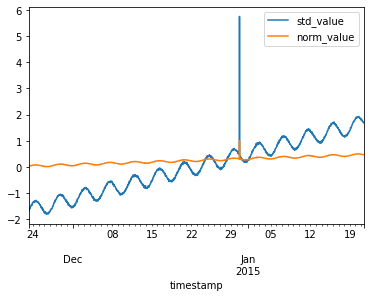


  0%|          | 0/198 [00:00<?, ?it/s]

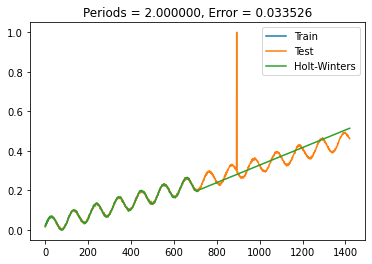


  7%|▋         | 13/198 [00:01<00:22,  8.31it/s]

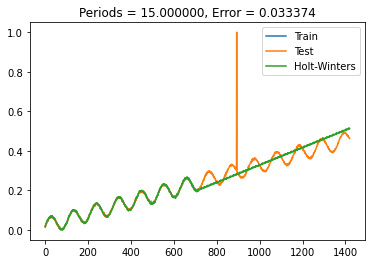


 23%|██▎       | 46/198 [00:05<00:13, 11.04it/s]

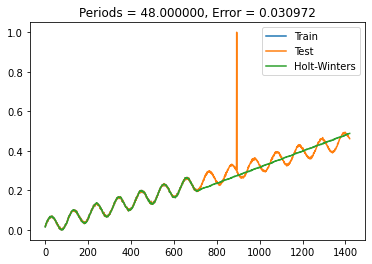


 25%|██▍       | 49/198 [00:06<00:26,  5.64it/s]

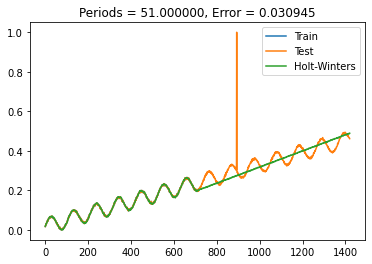


 52%|█████▏    | 102/198 [00:18<00:25,  3.73it/s]

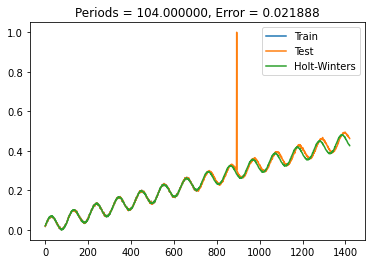


 52%|█████▏    | 103/198 [00:19<00:26,  3.59it/s]

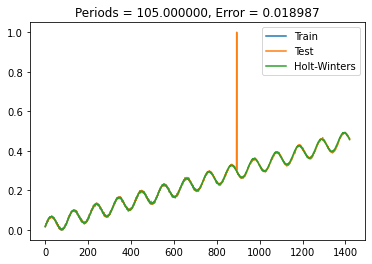


100%|██████████| 198/198 [00:43<00:00,  4.56it/s]


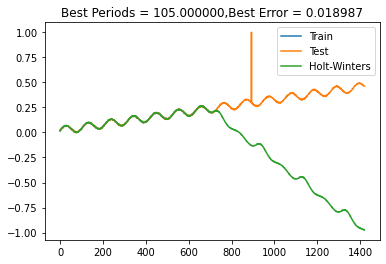

 21%|██        | 21/100 [15:05<1:00:21, 45.84s/it]




Errors:

Mean Absolute Error: 0.003
Mean Squared Error: 0.274
Root Mean Squared Error: 0.019
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 2.33
Mean forecast error: 0.274
Normalised mean squared error: 0.021
Theil_u_statistic: 0.253



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  34633.495867  ...         1.0  0.295266

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_44
Mean:[7485.04990255]
StandardDeviation: 4477.502832162114
Min: -1.782663, Max: 2.742542
                            value  is_anomaly  std_value  norm_value
timestamp                                                           
2014-11-23 07:00:00    567.318271           0  -1.544998    0.052520

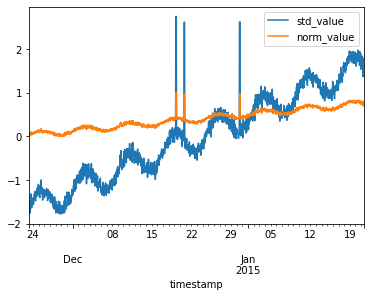


  0%|          | 0/198 [00:00<?, ?it/s]

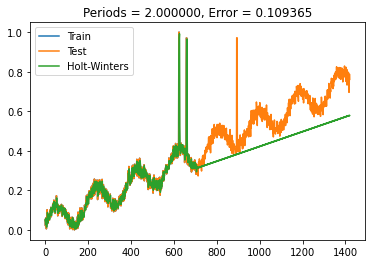


  1%|          | 1/198 [00:00<00:50,  3.87it/s]

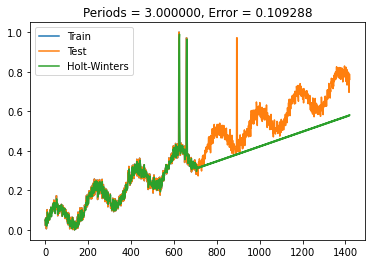


  1%|          | 2/198 [00:00<00:50,  3.89it/s]

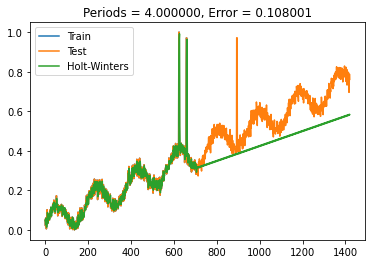


  3%|▎         | 6/198 [00:01<00:30,  6.29it/s]

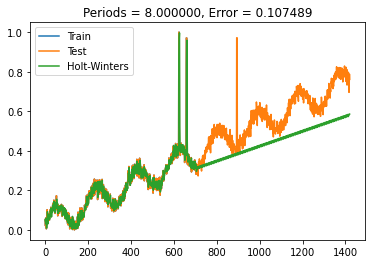


  4%|▎         | 7/198 [00:01<00:35,  5.34it/s]

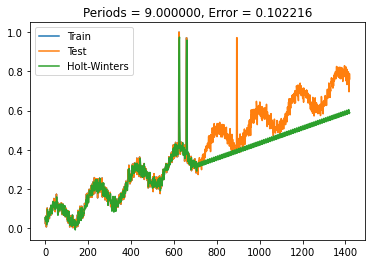


  6%|▌         | 11/198 [00:02<00:28,  6.51it/s]

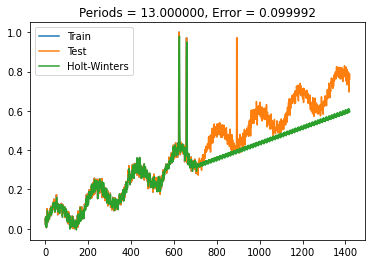


 10%|█         | 20/198 [00:03<00:23,  7.54it/s]

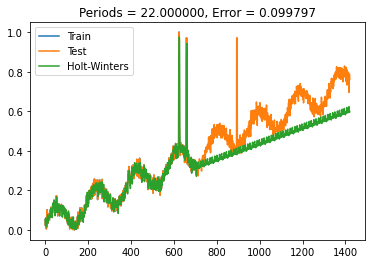


 12%|█▏        | 24/198 [00:04<00:28,  6.13it/s]

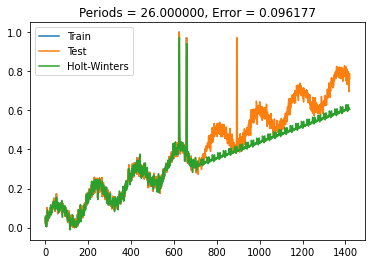


 14%|█▍        | 28/198 [00:04<00:31,  5.40it/s]

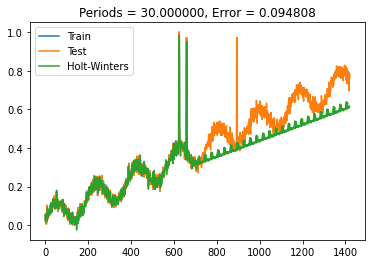


 19%|█▊        | 37/198 [00:06<00:31,  5.05it/s]

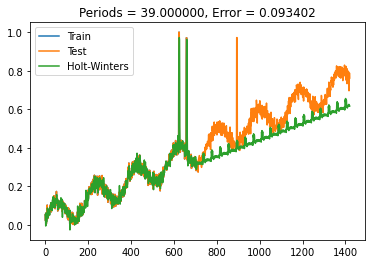


 21%|██        | 42/198 [00:07<00:34,  4.58it/s]

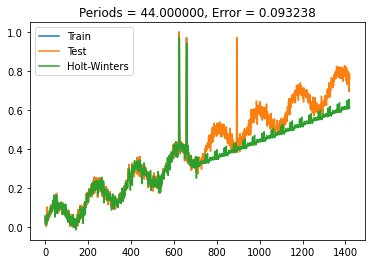


 25%|██▌       | 50/198 [00:10<00:38,  3.88it/s]

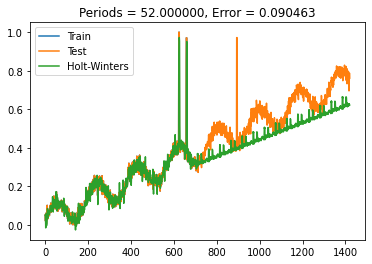


 27%|██▋       | 53/198 [00:11<00:39,  3.64it/s]

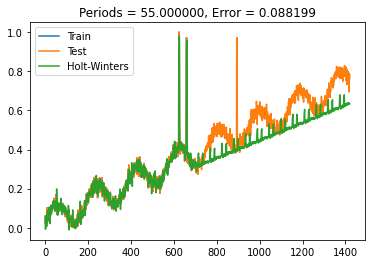


 43%|████▎     | 86/198 [00:20<00:31,  3.52it/s]

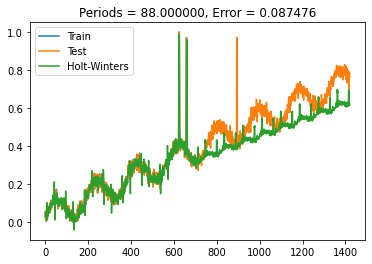


 44%|████▍     | 87/198 [00:21<00:36,  3.03it/s]

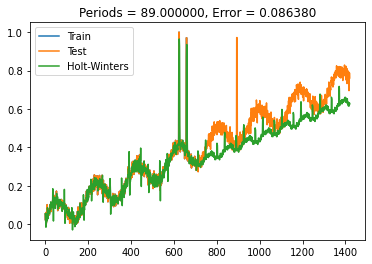


 48%|████▊     | 96/198 [00:23<00:28,  3.60it/s]

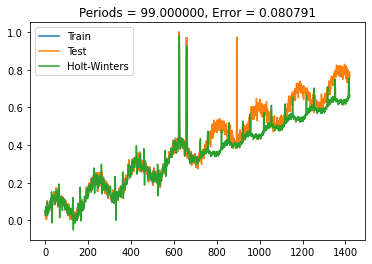


 49%|████▉     | 98/198 [00:24<00:27,  3.66it/s]

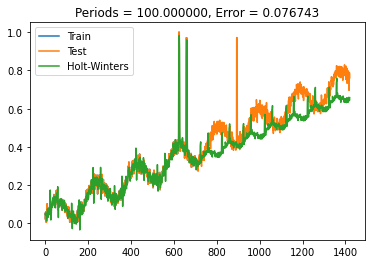


 57%|█████▋    | 112/198 [00:27<00:20,  4.21it/s]

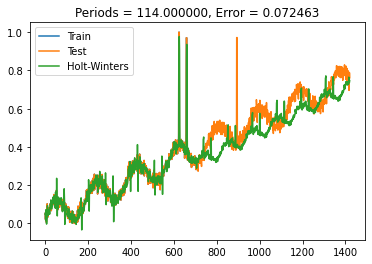


 71%|███████   | 141/198 [00:35<00:15,  3.63it/s]

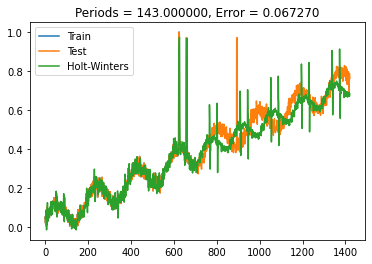


 94%|█████████▍| 186/198 [00:46<00:03,  3.78it/s]

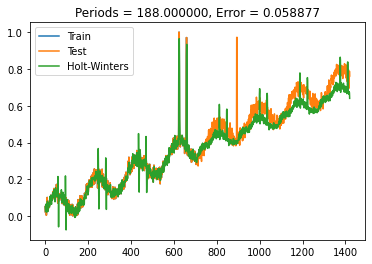


 95%|█████████▍| 188/198 [00:47<00:02,  3.45it/s]

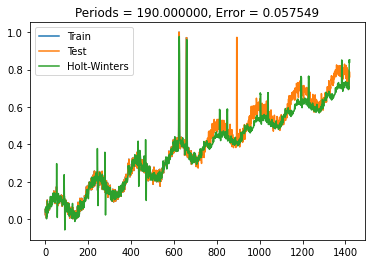


 97%|█████████▋| 193/198 [00:49<00:01,  3.65it/s]

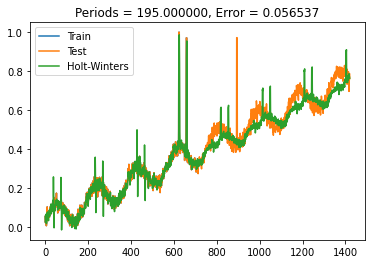


100%|██████████| 198/198 [00:50<00:00,  3.91it/s]


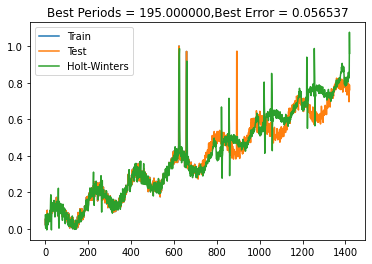

 22%|██▏       | 22/100 [15:56<1:01:38, 47.42s/it]




Errors:

Mean Absolute Error: 0.035
Mean Squared Error: 0.452
Root Mean Squared Error: 0.057
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.733
Mean forecast error: 0.438
Normalised mean squared error: 0.065
Theil_u_statistic: 0.286



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  19764.788448  ...    1.000000  0.551861
658 2014-12-20 17:00:00  19171.650587  ...    0.970726  0.534656
893 2014-12-30 12:00:00  19198.499714  ...    0.972051  0.421434
894 2014-12-30 13:00:00  19198.499714  ...    0.972051  0.430338
895 2014-12-30 14:00:00  19198.499714  ...    0.972051  0.436058

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_41
Me

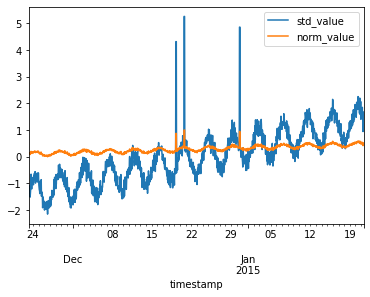


  0%|          | 0/198 [00:00<?, ?it/s]

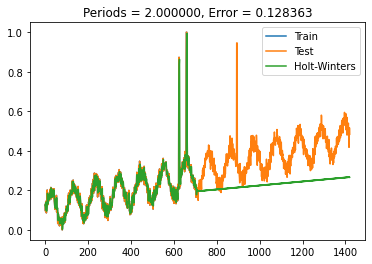


  1%|          | 1/198 [00:00<00:49,  3.97it/s]

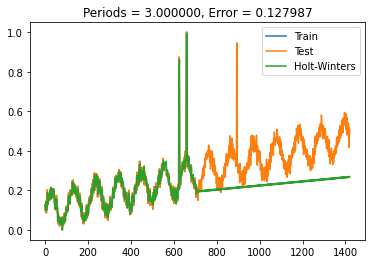


  1%|          | 2/198 [00:00<00:49,  3.94it/s]

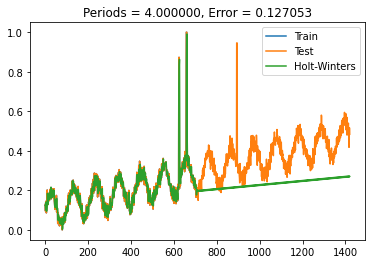


  3%|▎         | 6/198 [00:01<00:29,  6.47it/s]

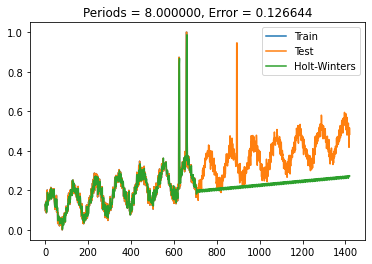


  4%|▎         | 7/198 [00:01<00:35,  5.40it/s]

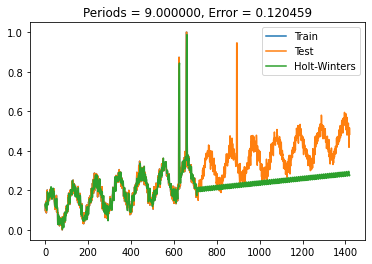


  6%|▌         | 11/198 [00:02<00:29,  6.37it/s]

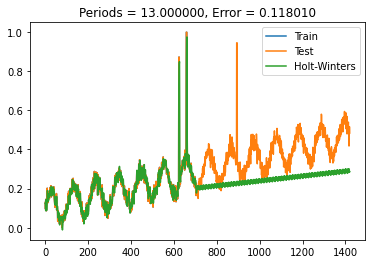


 10%|█         | 20/198 [00:03<00:24,  7.20it/s]

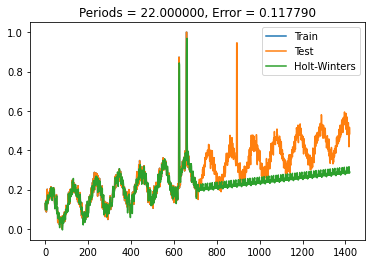


 12%|█▏        | 24/198 [00:04<00:30,  5.80it/s]

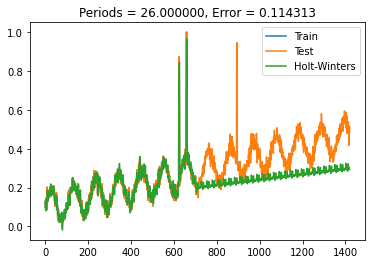


 14%|█▍        | 28/198 [00:04<00:30,  5.48it/s]

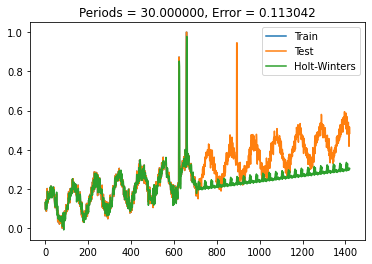


 19%|█▊        | 37/198 [00:06<00:30,  5.28it/s]

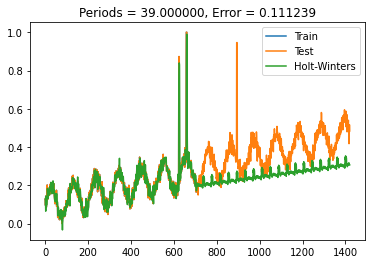


 21%|██        | 42/198 [00:07<00:31,  4.92it/s]

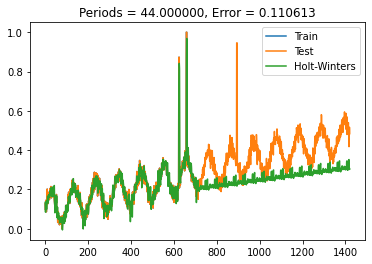


 25%|██▌       | 50/198 [00:09<00:33,  4.48it/s]

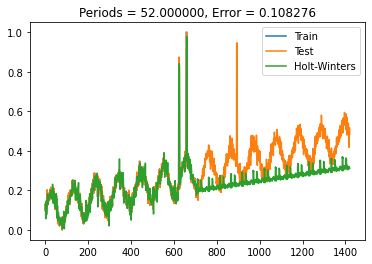


 27%|██▋       | 53/198 [00:10<00:38,  3.81it/s]

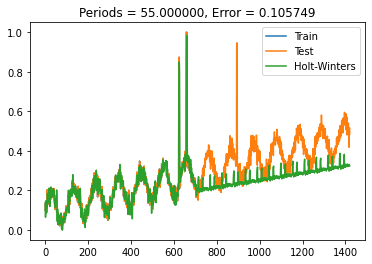


 38%|███▊      | 76/198 [00:17<00:34,  3.52it/s]

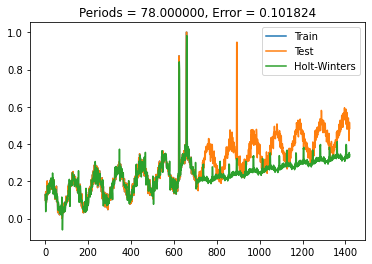


 39%|███▉      | 78/198 [00:17<00:38,  3.13it/s]

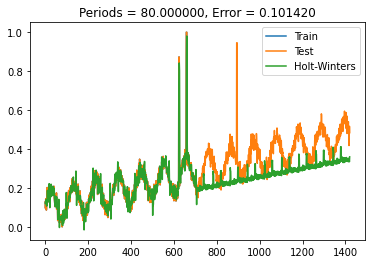


 51%|█████     | 100/198 [00:24<00:26,  3.73it/s]

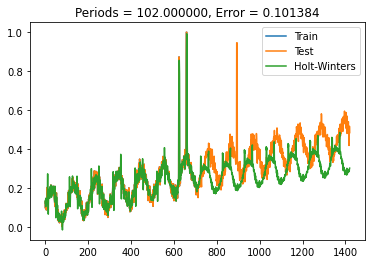


 51%|█████     | 101/198 [00:24<00:30,  3.15it/s]

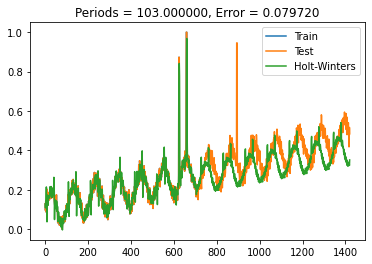


 52%|█████▏    | 102/198 [00:24<00:34,  2.80it/s]

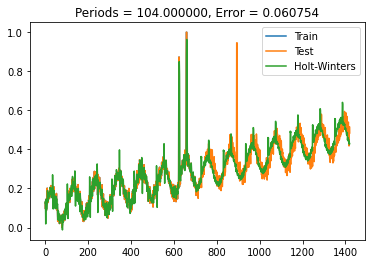


 52%|█████▏    | 103/198 [00:25<00:38,  2.47it/s]

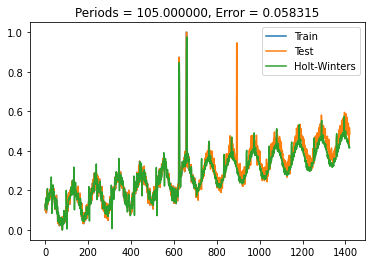


100%|██████████| 198/198 [00:49<00:00,  3.97it/s]


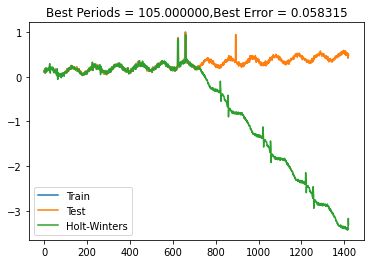

 23%|██▎       | 23/100 [16:47<1:01:59, 48.31s/it]




Errors:

Mean Absolute Error: 0.034
Mean Squared Error: 0.32
Root Mean Squared Error: 0.058
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 13.809
Mean forecast error: 0.299
Normalised mean squared error: 0.186
Theil_u_statistic: 0.609



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  12989.167526  ...    0.872496  0.297861
658 2014-12-20 17:00:00  15126.731611  ...    1.000000  0.448289
893 2014-12-30 12:00:00  14219.817937  ...    0.945903  0.308551
894 2014-12-30 13:00:00  14219.817937  ...    0.945903  0.311166
895 2014-12-30 14:00:00  14219.817937  ...    0.945903  0.311419

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_19
Mea

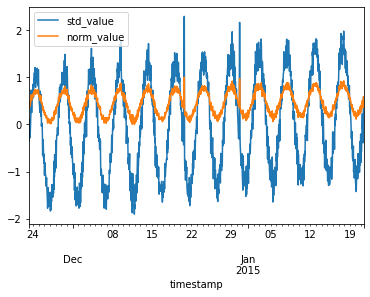


 15%|█▌        | 30/198 [00:02<00:16,  9.97it/s]

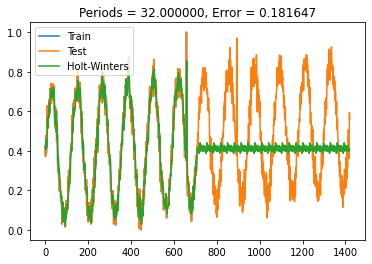


 17%|█▋        | 34/198 [00:03<00:20,  7.85it/s]

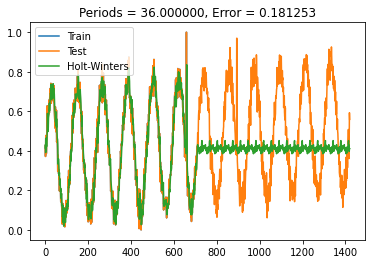


 19%|█▊        | 37/198 [00:04<00:24,  6.45it/s]

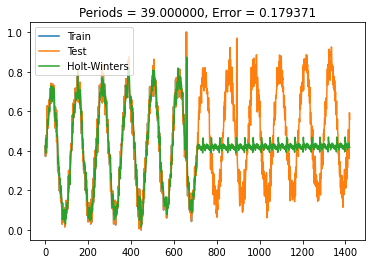


 58%|█████▊    | 114/198 [00:16<00:18,  4.53it/s]

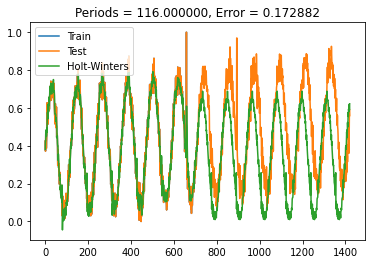


 58%|█████▊    | 115/198 [00:16<00:24,  3.38it/s]

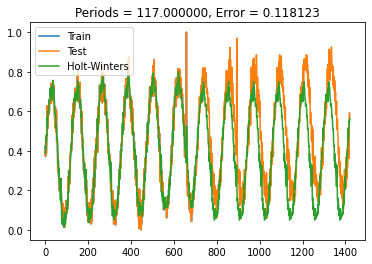


 59%|█████▊    | 116/198 [00:17<00:27,  2.94it/s]

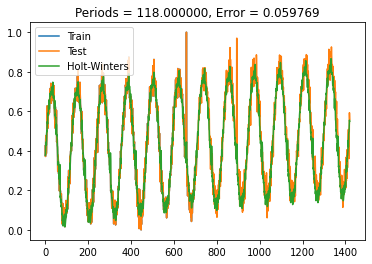


100%|██████████| 198/198 [00:43<00:00,  4.54it/s]


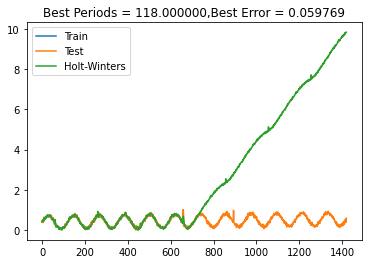

 24%|██▍       | 24/100 [17:31<59:36, 47.06s/it]  




Errors:

Mean Absolute Error: 0.042
Mean Squared Error: 0.512
Root Mean Squared Error: 0.06
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 14.024
Mean forecast error: 0.501
Normalised mean squared error: 0.063
Theil_u_statistic: 0.233



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  2701.113338  ...    1.000000  0.436644
659 2014-12-20 18:00:00  2701.113338  ...    1.000000  0.444809
893 2014-12-30 12:00:00  2570.985949  ...    0.969583  0.337424
894 2014-12-30 13:00:00  2570.985949  ...    0.969583  0.434044

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_91
Mean:[29558.60065081]
StandardDeviation: 17611.290615567028
Min: -1.683687, Max: 5.613527
             

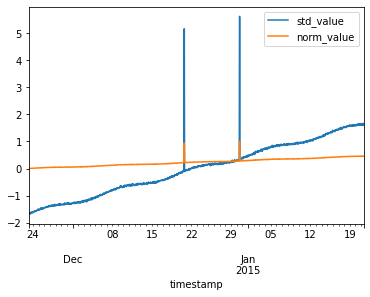


  0%|          | 0/198 [00:00<?, ?it/s]

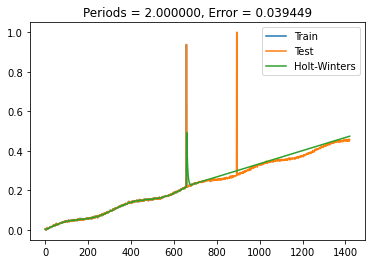


  1%|          | 1/198 [00:00<00:48,  4.03it/s]

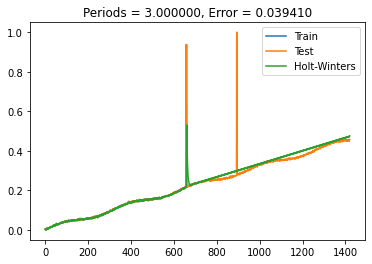


  2%|▏         | 3/198 [00:00<00:41,  4.68it/s]

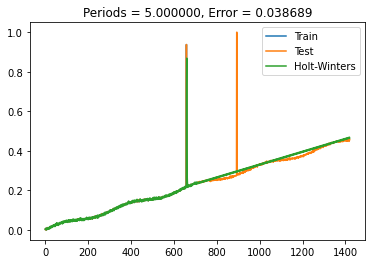


 11%|█         | 22/198 [00:03<00:26,  6.67it/s]

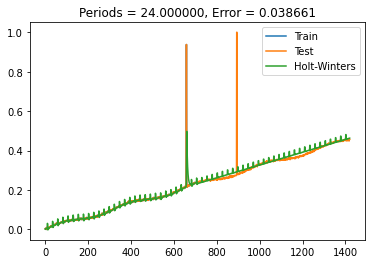


 12%|█▏        | 23/198 [00:03<00:33,  5.16it/s]

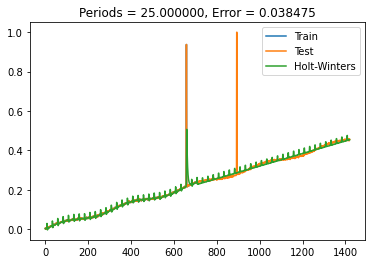


 77%|███████▋  | 153/198 [00:29<00:09,  4.94it/s]

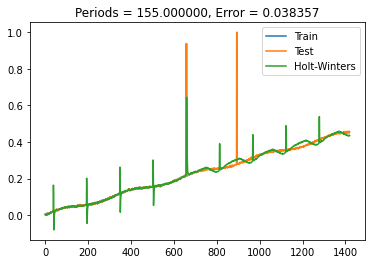


100%|██████████| 198/198 [00:40<00:00,  4.93it/s]


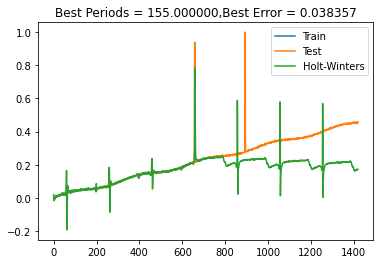

 25%|██▌       | 25/100 [18:12<56:28, 45.18s/it]




Errors:

Mean Absolute Error: 0.011
Mean Squared Error: 0.268
Root Mean Squared Error: 0.038
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.95
Mean forecast error: 0.267
Normalised mean squared error: 0.078
Theil_u_statistic: 0.534



 END Errors

              timestamp          value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  120384.144301  ...     0.93747  0.360525
659 2014-12-20 18:00:00  120384.144301  ...     0.93747  0.641248
893 2014-12-30 12:00:00  128420.057623  ...     1.00000  0.302610
894 2014-12-30 13:00:00  128420.057623  ...     1.00000  0.304679

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_82
Mean:[1800.06245903]
StandardDeviation: 1407.2502918555062
Min: -2.238807, Max: 2.370529
     

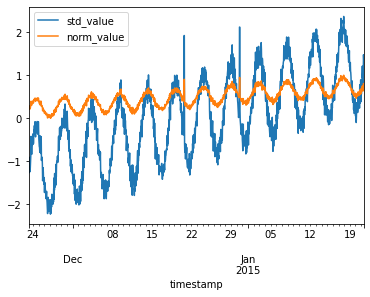


 15%|█▌        | 30/198 [00:02<00:17,  9.46it/s]

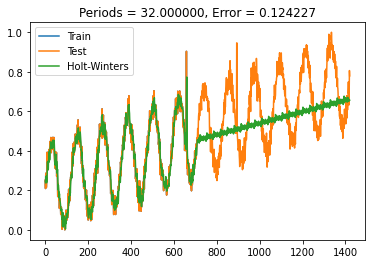


 17%|█▋        | 34/198 [00:03<00:22,  7.20it/s]

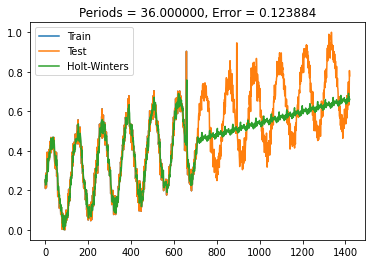


 58%|█████▊    | 115/198 [00:16<00:18,  4.42it/s]

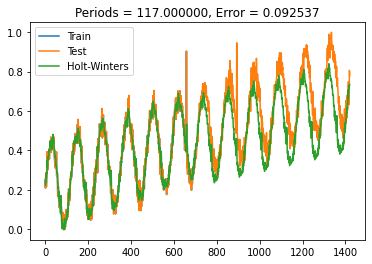


 59%|█████▊    | 116/198 [00:16<00:23,  3.45it/s]

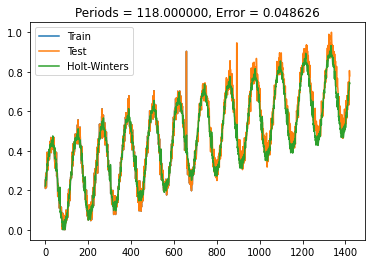


100%|██████████| 198/198 [00:43<00:00,  4.55it/s]


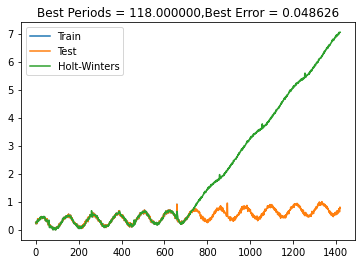

 26%|██▌       | 26/100 [18:56<55:18, 44.85s/it]




Errors:

Mean Absolute Error: 0.035
Mean Squared Error: 0.532
Root Mean Squared Error: 0.049
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 9.606
Mean forecast error: 0.514
Normalised mean squared error: 0.05
Theil_u_statistic: 0.178



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  4508.664700  ...    0.903287  0.470819
659 2014-12-20 18:00:00  4508.664700  ...    0.903287  0.479593
893 2014-12-30 12:00:00  4786.523684  ...    0.946124  0.453955
894 2014-12-30 13:00:00  4786.523684  ...    0.946124  0.533752

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_67
Mean:[9755.35834521]
StandardDeviation: 5869.980223077901
Min: -1.676154, Max: 5.508347
                

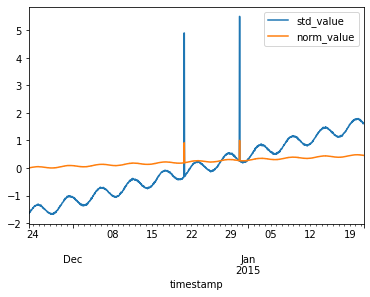


  0%|          | 0/198 [00:00<?, ?it/s]

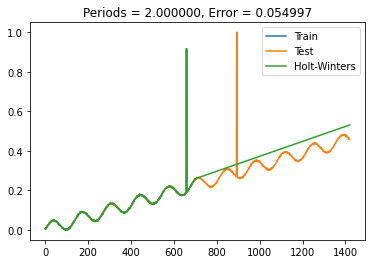


  1%|          | 1/198 [00:00<00:51,  3.86it/s]

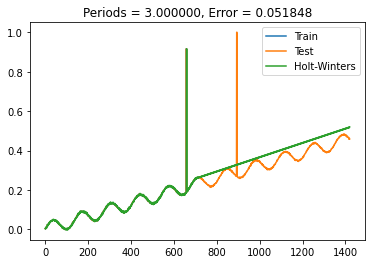


  1%|          | 2/198 [00:00<00:51,  3.81it/s]

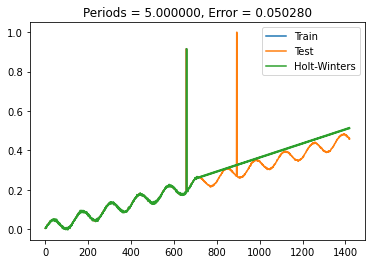


  4%|▍         | 8/198 [00:01<00:30,  6.18it/s]

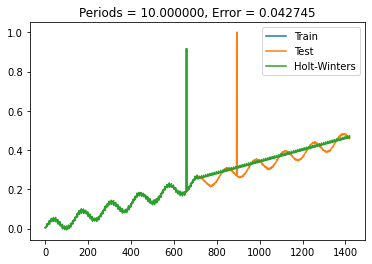


 12%|█▏        | 23/198 [00:03<00:30,  5.75it/s]

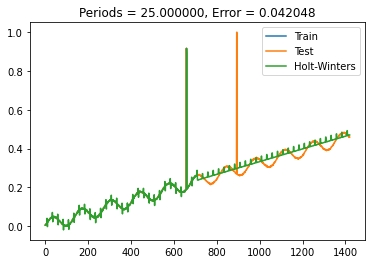


 66%|██████▌   | 130/198 [00:21<00:13,  5.03it/s]

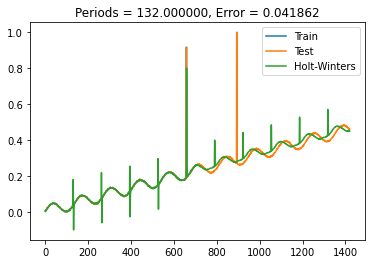


 66%|██████▌   | 131/198 [00:22<00:18,  3.69it/s]

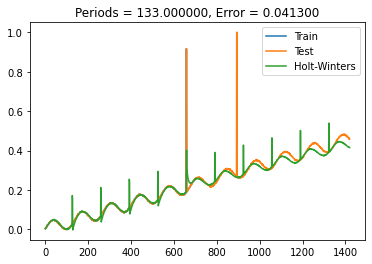


 67%|██████▋   | 133/198 [00:22<00:17,  3.80it/s]

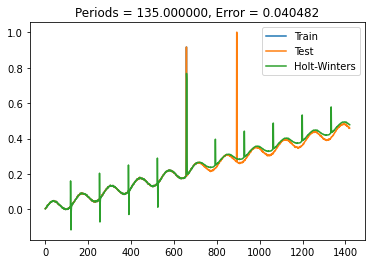


100%|██████████| 198/198 [00:37<00:00,  5.34it/s]


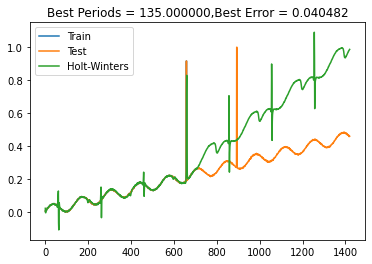

 27%|██▋       | 27/100 [19:33<51:54, 42.66s/it]




Errors:

Mean Absolute Error: 0.012
Mean Squared Error: 0.272
Root Mean Squared Error: 0.04
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.566
Mean forecast error: 0.28
Normalised mean squared error: 0.085
Theil_u_statistic: 0.533



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  38555.070565  ...    0.916198  0.333749
893 2014-12-30 12:00:00  42089.248005  ...    1.000000  0.285742
894 2014-12-30 13:00:00  42089.248005  ...    1.000000  0.285726

[3 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:3 | False Positive: 0
Neg:False Negative:1 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 0.75, F1: 0.8571428571428571
synthetic_1
Mean:[6.36834607]
StandardDeviation: 987.4205838674145
Min: -1.445592, Max: 1.428514
                          value  is_anomaly  std_value  norm_val

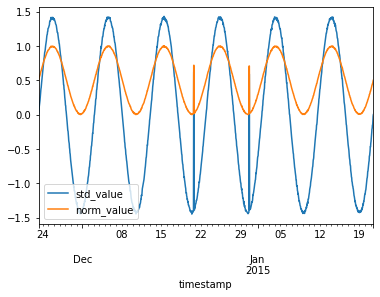


 25%|██▍       | 49/198 [00:05<00:18,  8.17it/s]

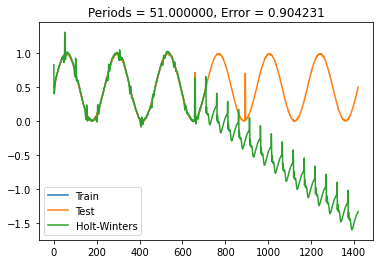


 55%|█████▍    | 108/198 [00:11<00:08, 10.26it/s]

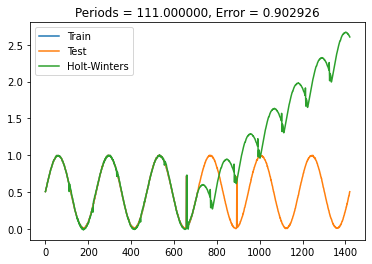


 56%|█████▌    | 110/198 [00:12<00:10,  8.04it/s]

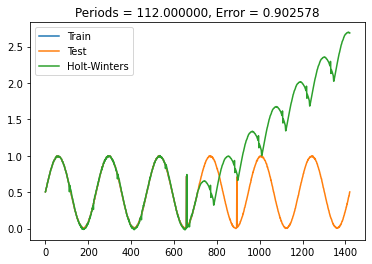


 66%|██████▌   | 130/198 [00:14<00:09,  7.32it/s]

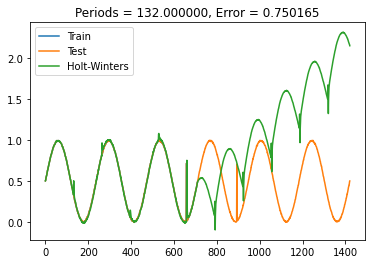


 66%|██████▌   | 131/198 [00:15<00:12,  5.54it/s]

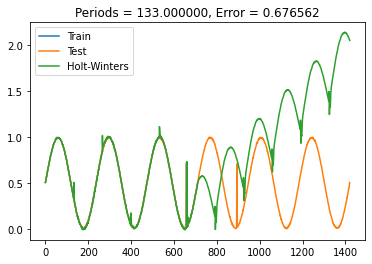


 67%|██████▋   | 132/198 [00:15<00:14,  4.68it/s]

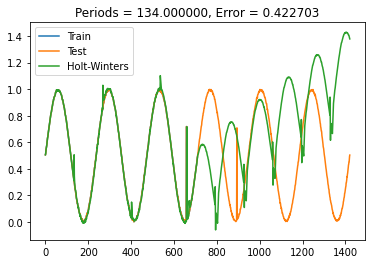


 67%|██████▋   | 133/198 [00:15<00:15,  4.11it/s]

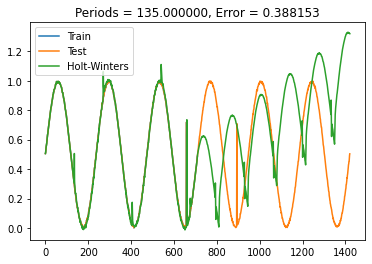


 68%|██████▊   | 134/198 [00:16<00:16,  3.81it/s]

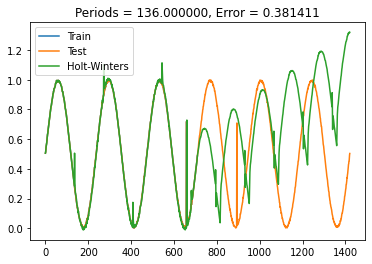


 68%|██████▊   | 135/198 [00:16<00:17,  3.62it/s]

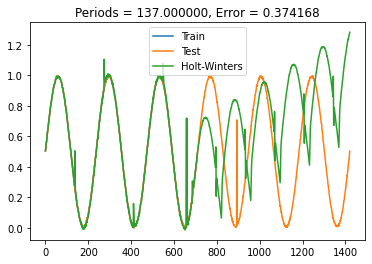


100%|██████████| 198/198 [00:28<00:00,  6.86it/s]


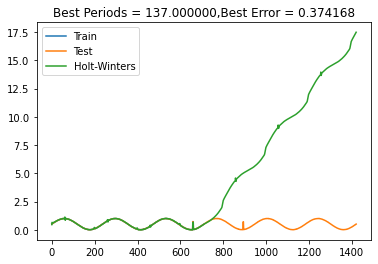

 28%|██▊       | 28/100 [20:03<46:24, 38.68s/it]




Errors:

Mean Absolute Error: 0.224
Mean Squared Error: 0.612
Root Mean Squared Error: 0.374
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 61.252
Mean forecast error: 0.714
Normalised mean squared error: 1.156
Theil_u_statistic: 0.857



 END Errors

               timestamp        value  ...  norm_value   hw_pred
658  2014-12-20 17:00:00   616.412915  ...    0.717930  0.004550
756  2014-12-24 19:00:00  1320.725369  ...    0.966107  0.712931
757  2014-12-24 20:00:00  1339.814179  ...    0.972833  0.707144
758  2014-12-24 21:00:00  1336.945972  ...    0.971822  0.704726
759  2014-12-24 22:00:00  1347.867458  ...    0.975671  0.700596
...                  ...          ...  ...         ...       ...
1237 2015-01-13 20:00:00  1368.972614  ...    0.983108  0.677543
1238 2015-01-13 21:00:00  1392.639458  ...    0.991447  0.693192
1239 2015-01-13 22:00:00  1387.296957  ...    0.989564  0.707042
1240 2015-01-13 23:00:00  1394.242230  ...    0.992012  0.719753
12

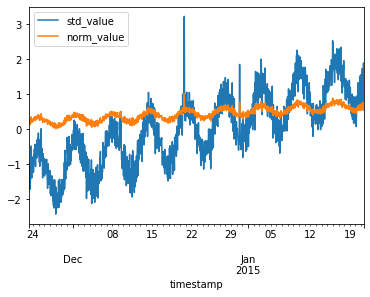


 20%|█▉        | 39/198 [00:03<00:19,  8.28it/s]

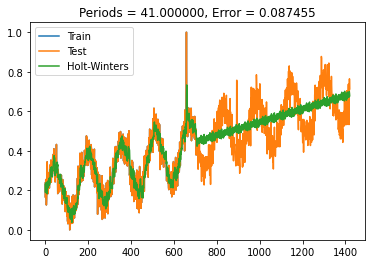


 22%|██▏       | 43/198 [00:04<00:20,  7.38it/s]

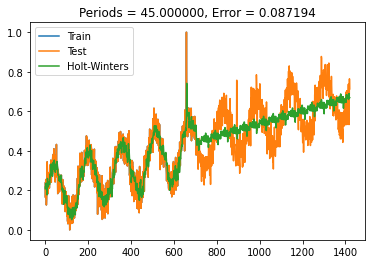


 23%|██▎       | 45/198 [00:05<00:33,  4.58it/s]

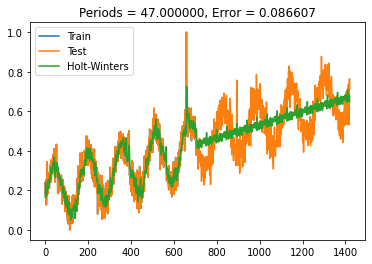


 77%|███████▋  | 152/198 [00:24<00:13,  3.41it/s]

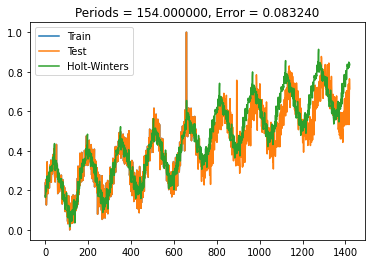


 77%|███████▋  | 153/198 [00:25<00:15,  2.95it/s]

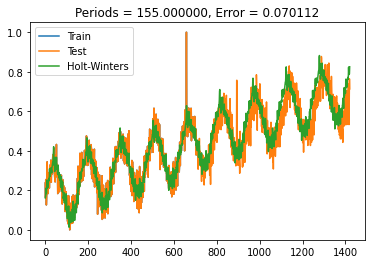


 78%|███████▊  | 154/198 [00:25<00:16,  2.67it/s]

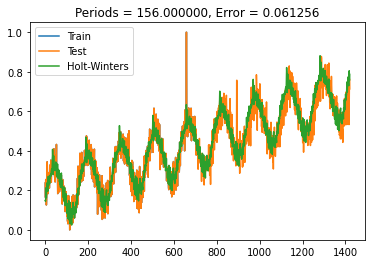


 79%|███████▉  | 156/198 [00:26<00:14,  2.88it/s]

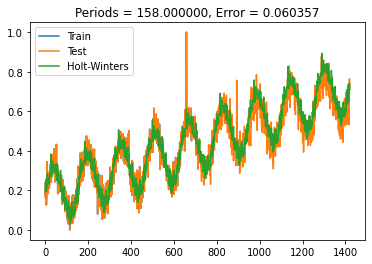


 79%|███████▉  | 157/198 [00:26<00:16,  2.51it/s]

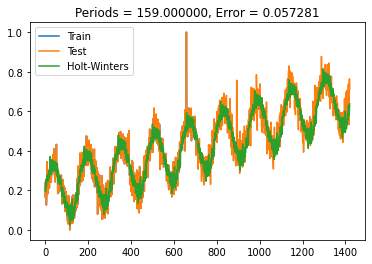


100%|██████████| 198/198 [00:40<00:00,  4.91it/s]


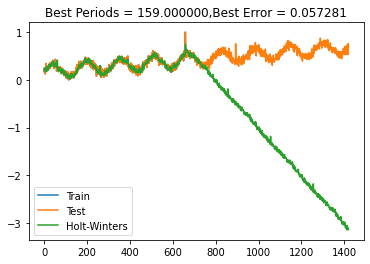

 29%|██▉       | 29/100 [20:44<46:33, 39.34s/it]




Errors:

Mean Absolute Error: 0.043
Mean Squared Error: 0.466
Root Mean Squared Error: 0.057
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 12.084
Mean forecast error: 0.459
Normalised mean squared error: 0.105
Theil_u_statistic: 0.268



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  8631.750691  ...     1.00000  0.578917
659 2014-12-20 18:00:00  8631.750691  ...     1.00000  0.593546
893 2014-12-30 12:00:00  6089.556807  ...     0.75677  0.410164
894 2014-12-30 13:00:00  6089.556807  ...     0.75677  0.392385

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_17
Mean:[299.9544481]
StandardDeviation: 1024.29447416376
Min: -1.874314, Max: 3.814266
                 

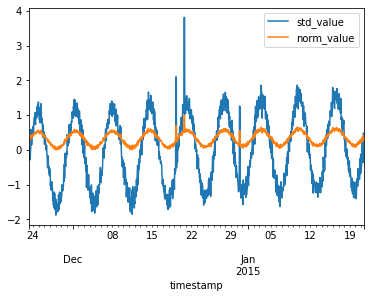


  0%|          | 0/198 [00:00<?, ?it/s]

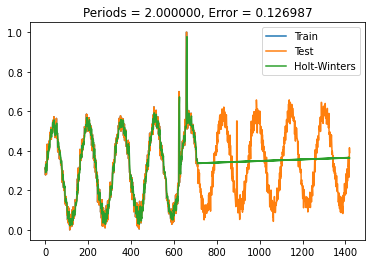


  1%|          | 1/198 [00:00<00:49,  3.97it/s]

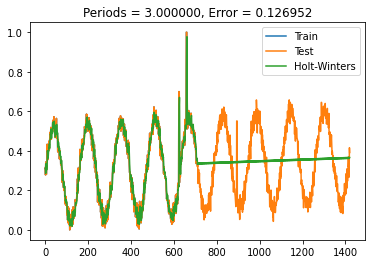


  2%|▏         | 4/198 [00:00<00:34,  5.63it/s]

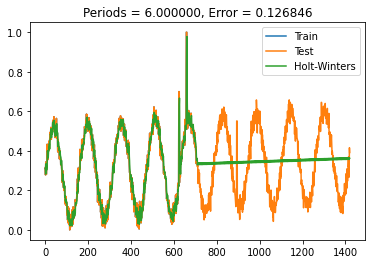


  3%|▎         | 5/198 [00:00<00:39,  4.90it/s]

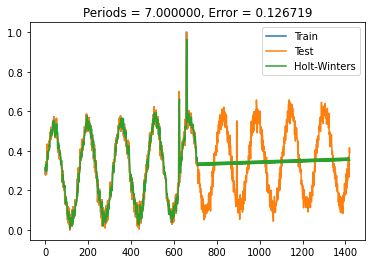


  5%|▌         | 10/198 [00:01<00:26,  7.12it/s]

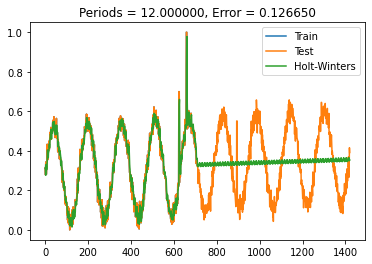


  6%|▌         | 12/198 [00:02<00:31,  5.87it/s]

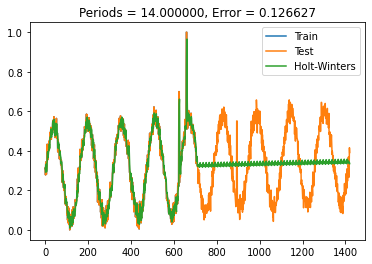


  8%|▊         | 15/198 [00:02<00:28,  6.36it/s]

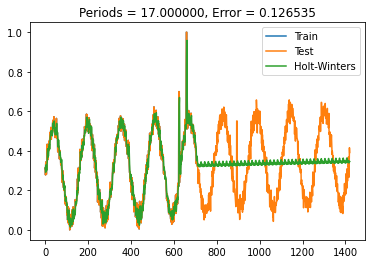


 12%|█▏        | 23/198 [00:03<00:24,  7.27it/s]

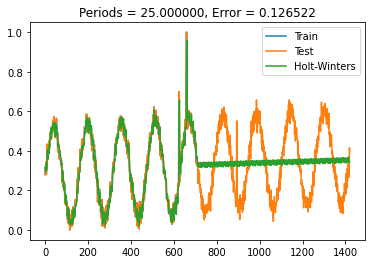


 25%|██▍       | 49/198 [00:08<00:29,  5.05it/s]

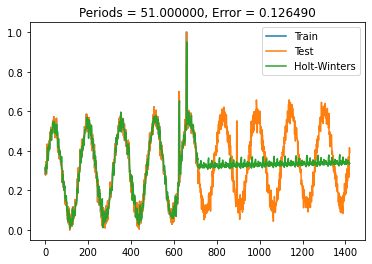


 78%|███████▊  | 154/198 [00:39<00:12,  3.40it/s]

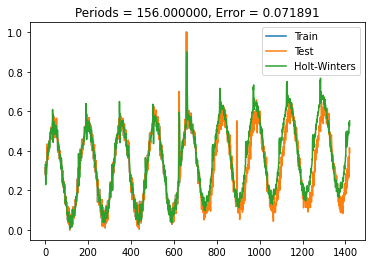


 79%|███████▉  | 156/198 [00:39<00:12,  3.46it/s]

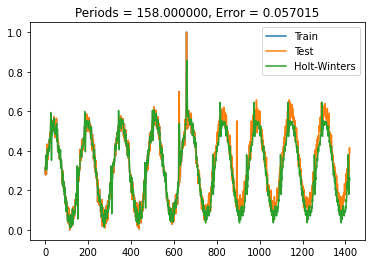


100%|██████████| 198/198 [00:52<00:00,  3.75it/s]


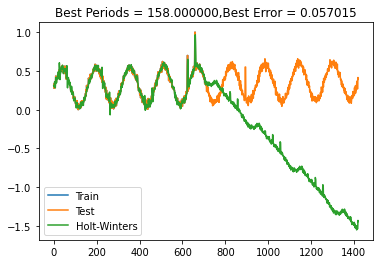

 30%|███       | 30/100 [21:37<50:46, 43.53s/it]




Errors:

Mean Absolute Error: 0.04
Mean Squared Error: 0.373
Root Mean Squared Error: 0.057
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 18.598
Mean forecast error: 0.355
Normalised mean squared error: 0.105
Theil_u_statistic: 0.43



 END Errors

              timestamp        value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  2455.065872  ...    0.699350  0.345750
658 2014-12-20 17:00:00  4206.886469  ...    1.000000  0.625525
893 2014-12-30 12:00:00  1591.137711  ...    0.551082  0.148670
894 2014-12-30 13:00:00  1591.137711  ...    0.551082  0.093714
895 2014-12-30 14:00:00  1591.137711  ...    0.551082  0.109797

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_29
Mean:[853.

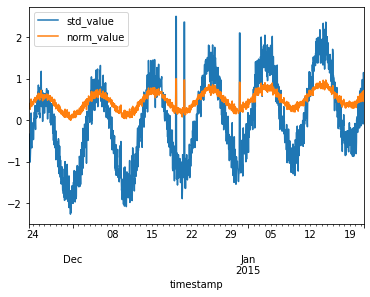


  0%|          | 0/198 [00:00<?, ?it/s]

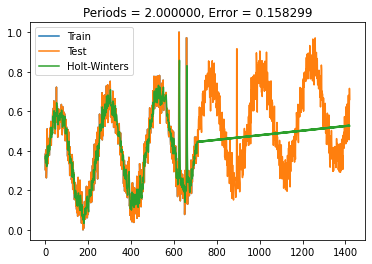


  1%|          | 1/198 [00:00<00:49,  4.00it/s]

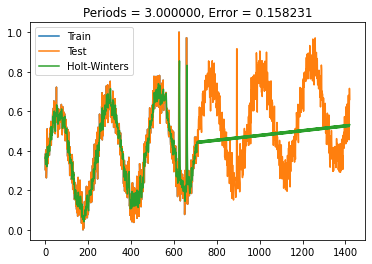


  1%|          | 2/198 [00:00<00:49,  3.93it/s]

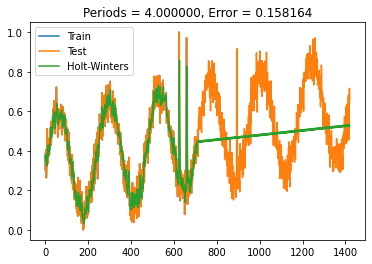


  2%|▏         | 3/198 [00:00<00:49,  3.93it/s]

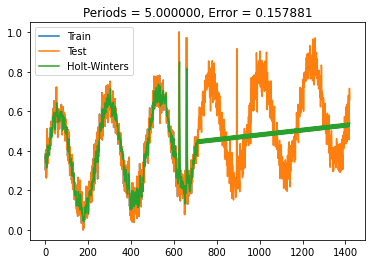


  4%|▎         | 7/198 [00:01<00:30,  6.19it/s]

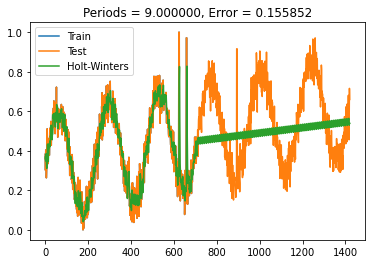


  6%|▌         | 11/198 [00:01<00:26,  6.95it/s]

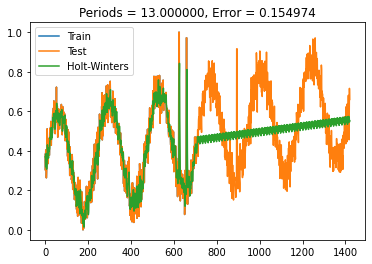


 12%|█▏        | 24/198 [00:03<00:25,  6.84it/s]

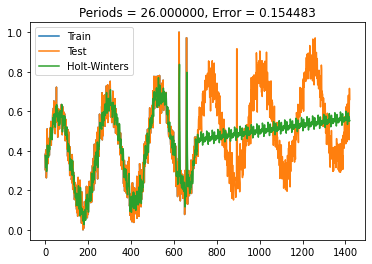


 14%|█▍        | 28/198 [00:04<00:31,  5.41it/s]

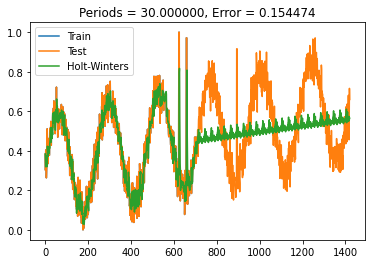


 19%|█▊        | 37/198 [00:06<00:30,  5.25it/s]

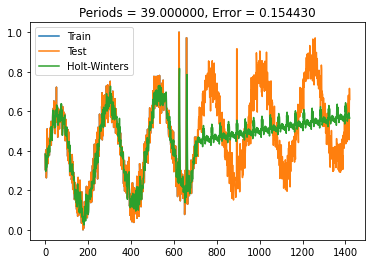


 25%|██▌       | 50/198 [00:09<00:35,  4.13it/s]

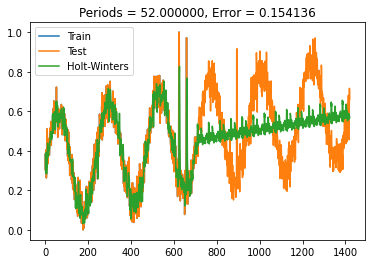


 58%|█████▊    | 115/198 [00:27<00:23,  3.51it/s]

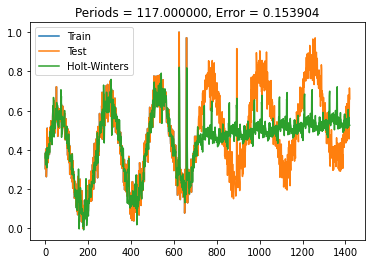


 59%|█████▊    | 116/198 [00:27<00:27,  3.00it/s]

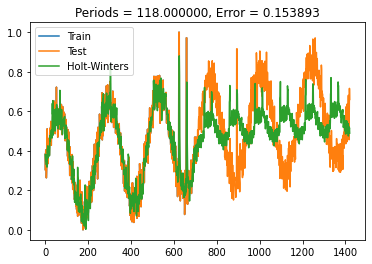


100%|██████████| 198/198 [00:51<00:00,  3.83it/s]


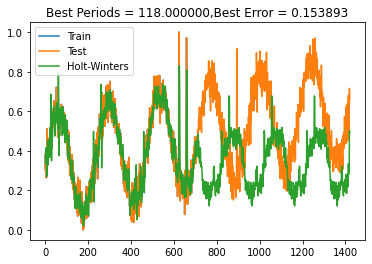

 31%|███       | 31/100 [22:29<53:02, 46.13s/it]




Errors:

Mean Absolute Error: 0.114
Mean Squared Error: 0.519
Root Mean Squared Error: 0.154
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 25.787
Mean forecast error: 0.494
Normalised mean squared error: 0.54
Theil_u_statistic: 0.599



 END Errors

               timestamp        value  ...  norm_value   hw_pred
623  2014-12-19 06:00:00  3599.566321  ...    1.000000  0.405770
624  2014-12-19 07:00:00  3599.566321  ...    1.000000  0.663752
658  2014-12-20 17:00:00  3449.742128  ...    0.971372  0.335332
659  2014-12-20 18:00:00  3449.742128  ...    0.971372  0.582349
751  2014-12-24 14:00:00  2459.114461  ...    0.782087  0.522402
...                  ...          ...  ...         ...       ...
1273 2015-01-15 08:00:00  2565.632978  ...    0.802440  0.508504
1278 2015-01-15 13:00:00  2526.021399  ...    0.794871  0.508791
1283 2015-01-15 18:00:00  2436.882303  ...    0.777839  0.475117
1288 2015-01-15 23:00:00  2730.302552  ...    0.833904  0.478120
128

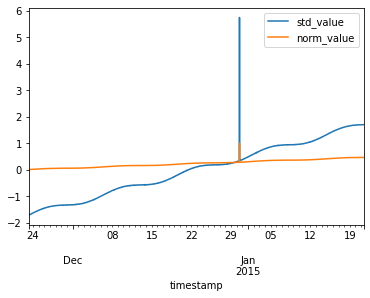


  0%|          | 0/198 [00:00<?, ?it/s]

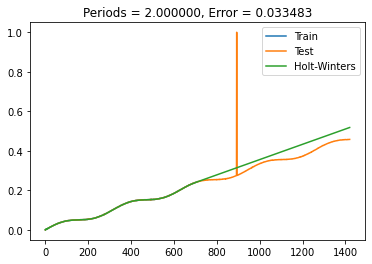


  2%|▏         | 3/198 [00:00<00:39,  4.98it/s]

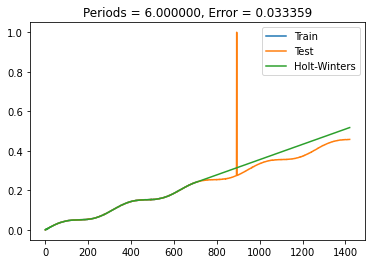


  3%|▎         | 5/198 [00:00<00:36,  5.32it/s]

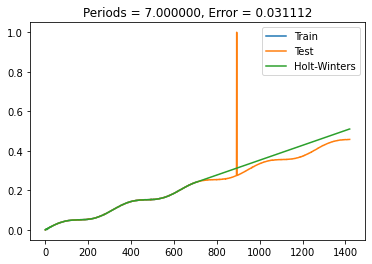


  9%|▊         | 17/198 [00:02<00:24,  7.30it/s]

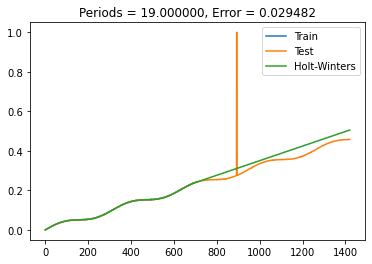


 12%|█▏        | 24/198 [00:03<00:21,  8.18it/s]

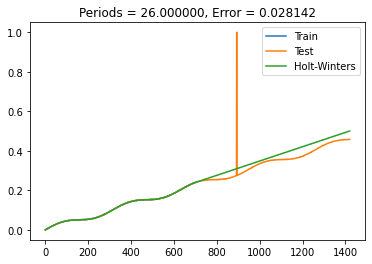


 17%|█▋        | 34/198 [00:04<00:20,  7.88it/s]

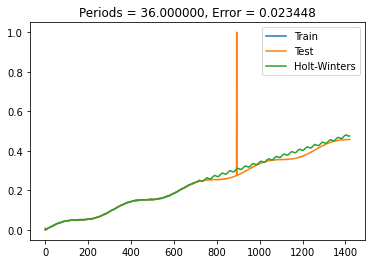


 39%|███▉      | 77/198 [00:10<00:17,  6.85it/s]

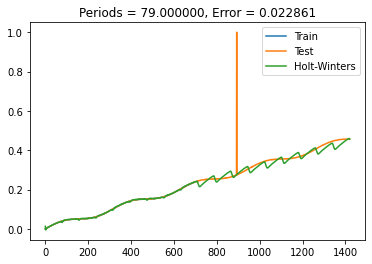


100%|██████████| 198/198 [00:33<00:00,  5.85it/s]


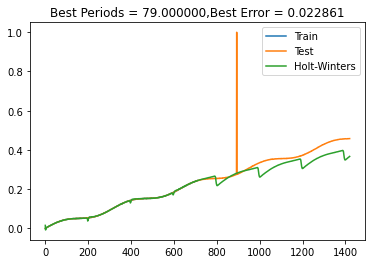

 32%|███▏      | 32/100 [23:03<48:16, 42.60s/it]




Errors:

Mean Absolute Error: 0.008
Mean Squared Error: 0.267
Root Mean Squared Error: 0.023
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 6.11
Mean forecast error: 0.261
Normalised mean squared error: 0.029
Theil_u_statistic: 0.329



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  96377.011822  ...         1.0  0.276799

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_73
Mean:[956.27053359]
StandardDeviation: 1118.566135541517
Min: -2.147579, Max: 4.770269
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   166.780675           0  -0.705805    0.208414
201

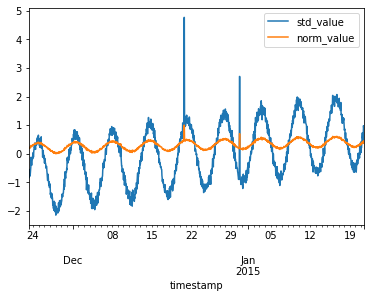


 13%|█▎        | 26/198 [00:02<00:18,  9.48it/s]

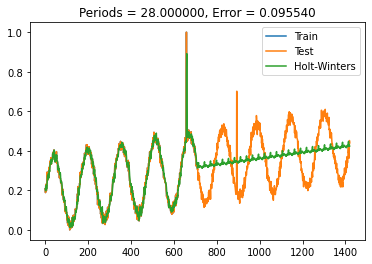


 14%|█▎        | 27/198 [00:02<00:29,  5.73it/s]

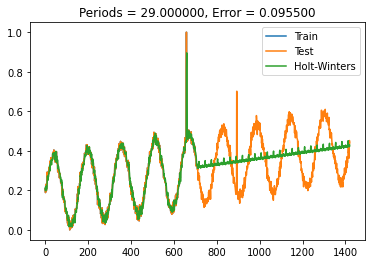


 23%|██▎       | 46/198 [00:07<00:32,  4.67it/s]

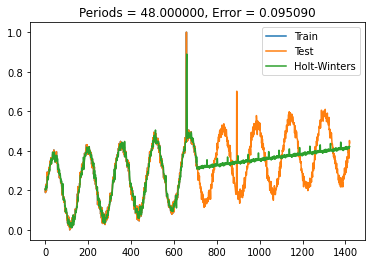


 24%|██▎       | 47/198 [00:07<00:41,  3.61it/s]

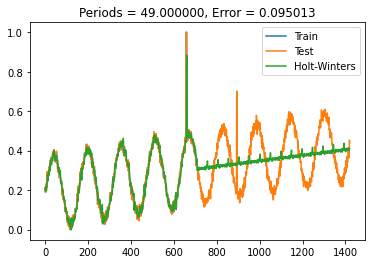


 77%|███████▋  | 153/198 [00:33<00:13,  3.35it/s]

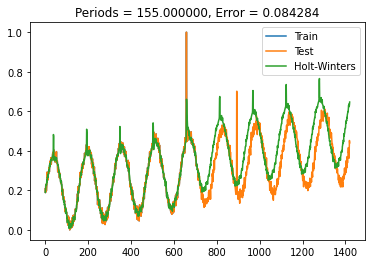


 78%|███████▊  | 154/198 [00:33<00:15,  2.88it/s]

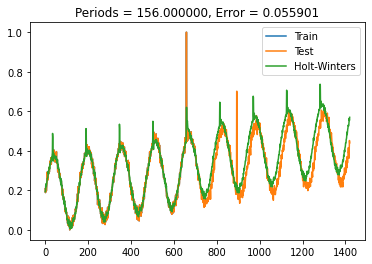


 78%|███████▊  | 155/198 [00:34<00:16,  2.61it/s]

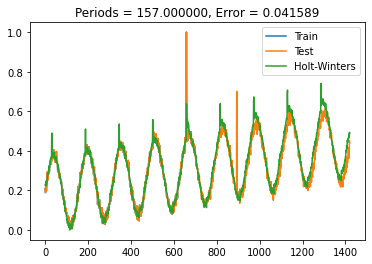


 79%|███████▉  | 156/198 [00:34<00:18,  2.31it/s]

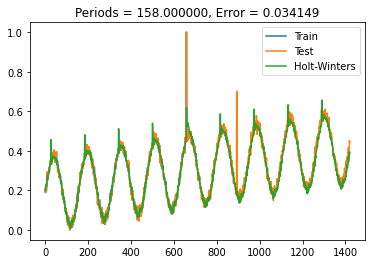


100%|██████████| 198/198 [00:47<00:00,  4.13it/s]


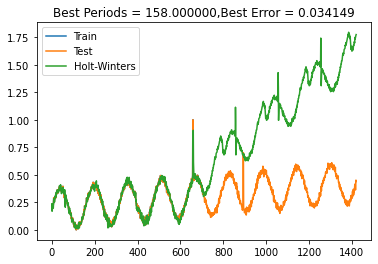

 33%|███▎      | 33/100 [23:52<49:32, 44.37s/it]




Errors:

Mean Absolute Error: 0.019
Mean Squared Error: 0.342
Root Mean Squared Error: 0.034
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.603
Mean forecast error: 0.335
Normalised mean squared error: 0.056
Theil_u_statistic: 0.298



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  6292.132401  ...    1.000000  0.571838
659 2014-12-20 18:00:00  6292.132401  ...    1.000000  0.618724
893 2014-12-30 12:00:00  3980.446956  ...    0.701258  0.199103
894 2014-12-30 13:00:00  3980.446956  ...    0.701258  0.171299

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_61
Mean:[72.28522788]
StandardDeviation: 991.3877493910065
Min: -1.476015, Max: 1.727900
                 

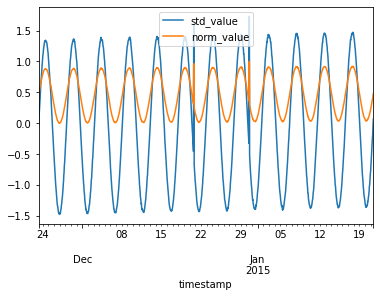


 15%|█▍        | 29/198 [00:03<00:18,  8.96it/s]

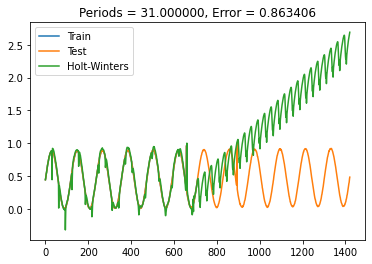


 30%|███       | 60/198 [00:06<00:13, 10.20it/s]

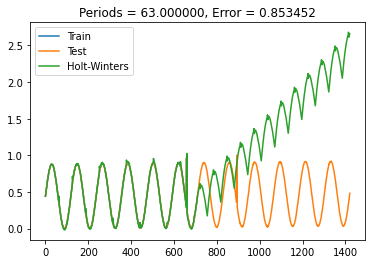


 34%|███▍      | 67/198 [00:07<00:14,  8.79it/s]

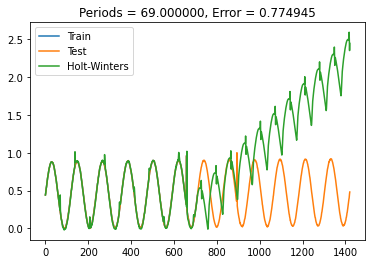


 38%|███▊      | 75/198 [00:08<00:14,  8.36it/s]

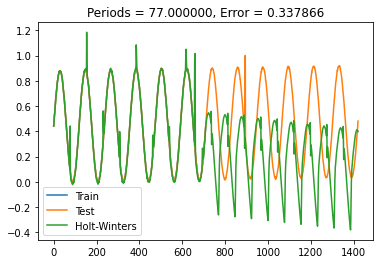


 58%|█████▊    | 115/198 [00:17<00:19,  4.23it/s]

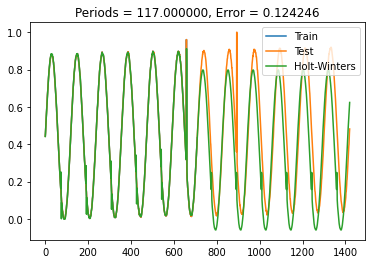


 59%|█████▉    | 117/198 [00:18<00:21,  3.71it/s]

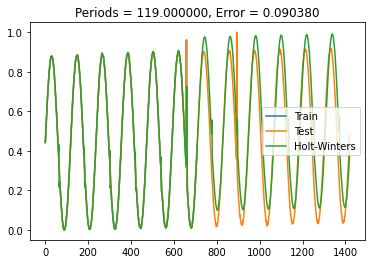


100%|██████████| 198/198 [00:35<00:00,  5.65it/s]


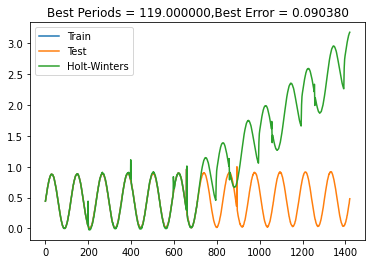

 34%|███▍      | 34/100 [24:27<45:53, 41.72s/it]




Errors:

Mean Absolute Error: 0.053
Mean Squared Error: 0.556
Root Mean Squared Error: 0.09
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 20.209
Mean forecast error: 0.589
Normalised mean squared error: 0.084
Theil_u_statistic: 0.276



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  1659.143701  ...    0.960281  0.357233
659 2014-12-20 18:00:00  1659.143701  ...    0.960281  0.647591
893 2014-12-30 12:00:00  1785.304499  ...    1.000000  0.515841
894 2014-12-30 13:00:00  1785.304499  ...    1.000000  0.501758

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_38
Mean:[1442.27810513]
StandardDeviation: 1306.6836925391071
Min: -2.471475, Max: 3.160169
              

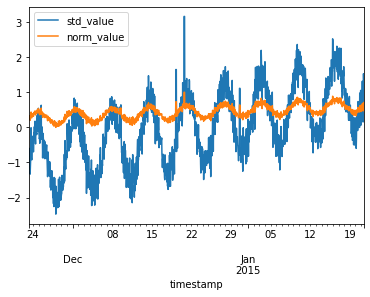


 14%|█▎        | 27/198 [00:02<00:16, 10.41it/s]

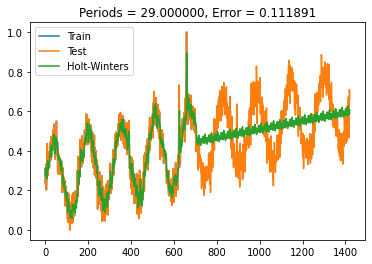


 15%|█▌        | 30/198 [00:03<00:21,  7.84it/s]

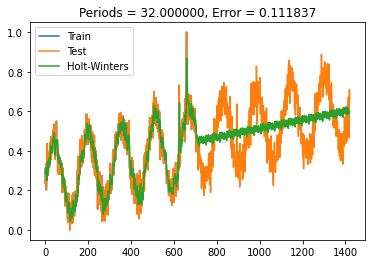


 19%|█▉        | 38/198 [00:04<00:24,  6.41it/s]

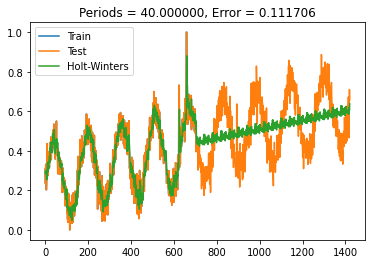


 77%|███████▋  | 153/198 [00:29<00:13,  3.46it/s]

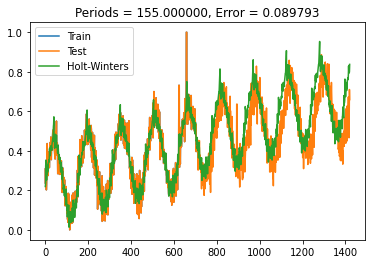


 78%|███████▊  | 154/198 [00:29<00:14,  2.96it/s]

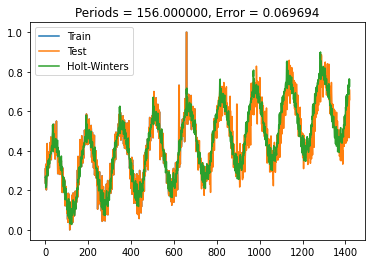


 79%|███████▉  | 157/198 [00:30<00:09,  4.10it/s]

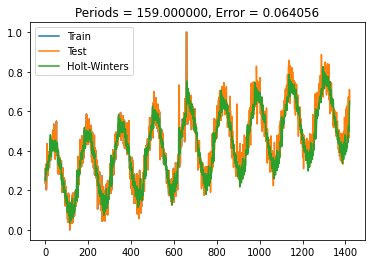


100%|██████████| 198/198 [00:43<00:00,  4.53it/s]


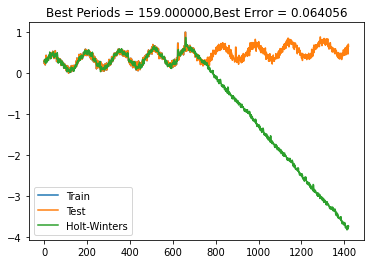

 35%|███▌      | 35/100 [25:12<46:01, 42.49s/it]




Errors:

Mean Absolute Error: 0.049
Mean Squared Error: 0.473
Root Mean Squared Error: 0.064
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 13.303
Mean forecast error: 0.459
Normalised mean squared error: 0.13
Theil_u_statistic: 0.295



 END Errors

              timestamp        value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  3594.659515  ...    0.731347  0.401596
624 2014-12-19 07:00:00  3594.659515  ...    0.731347  0.453599
658 2014-12-20 17:00:00  5571.619038  ...    1.000000  0.676484
659 2014-12-20 18:00:00  5571.619038  ...    1.000000  0.719575
893 2014-12-30 12:00:00  2894.765088  ...    0.636237  0.338370
894 2014-12-30 13:00:00  2894.765088  ...    0.636237  0.314347
895 2014-12-30 14:00:00  2894.765088  ...    0.636237  0.345755

[7 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:7 | False Positive: 0
Neg:False Negative:2 |True Negative: 1412
Total Positives(Anomalies):9 | Total Nega

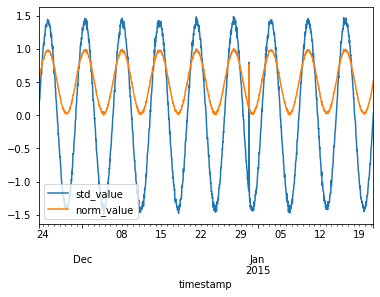


 20%|█▉        | 39/198 [00:04<00:17,  9.10it/s]

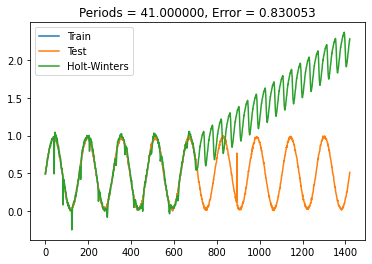


 21%|██        | 42/198 [00:04<00:20,  7.63it/s]

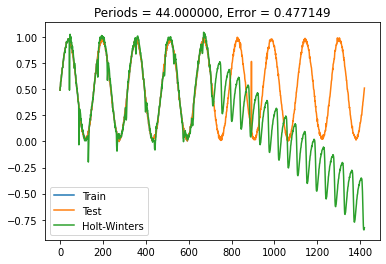


 28%|██▊       | 56/198 [00:06<00:14, 10.00it/s]

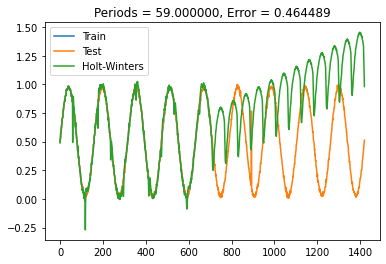


 60%|██████    | 119/198 [00:15<00:15,  4.99it/s]

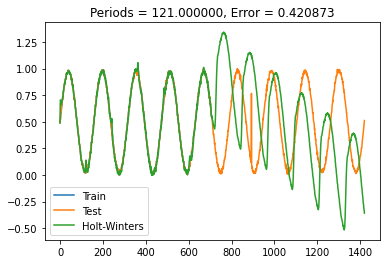


 64%|██████▎   | 126/198 [00:17<00:14,  4.81it/s]

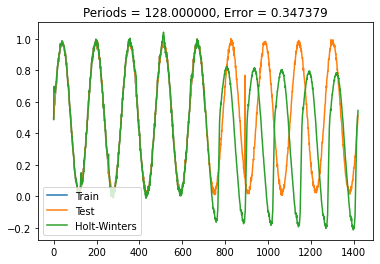


 79%|███████▉  | 156/198 [00:24<00:13,  3.19it/s]

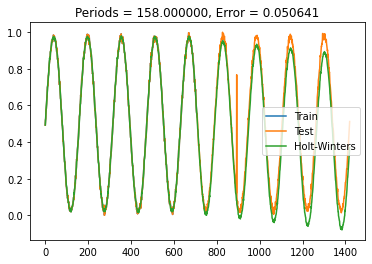


100%|██████████| 198/198 [00:35<00:00,  5.65it/s]


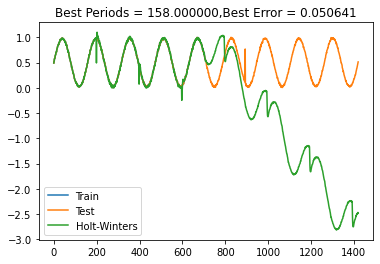

 36%|███▌      | 36/100 [25:47<43:06, 40.42s/it]




Errors:

Mean Absolute Error: 0.033
Mean Squared Error: 0.603
Root Mean Squared Error: 0.051
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 175.936
Mean forecast error: 0.582
Normalised mean squared error: 0.023
Theil_u_statistic: 0.144



 END Errors

              timestamp       value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  791.823067  ...    0.767649  0.080133

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_16
Mean:[3191.40869118]
StandardDeviation: 2074.503331227593
Min: -2.005573, Max: 2.544810
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   207.726035           0  -1.438264    0.124673
201

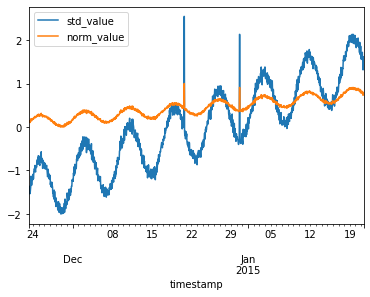


  0%|          | 0/198 [00:00<?, ?it/s]

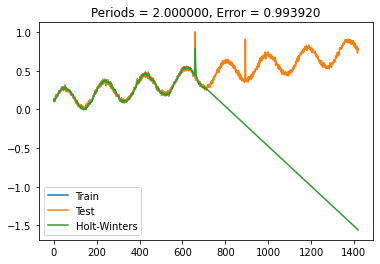


  1%|          | 2/198 [00:00<00:39,  4.99it/s]

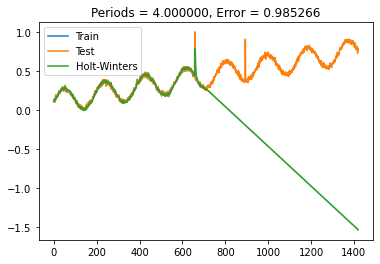


  4%|▎         | 7/198 [00:00<00:28,  6.60it/s]

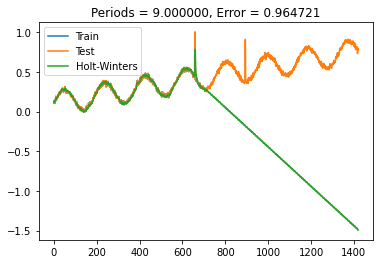


  6%|▌         | 11/198 [00:01<00:25,  7.21it/s]

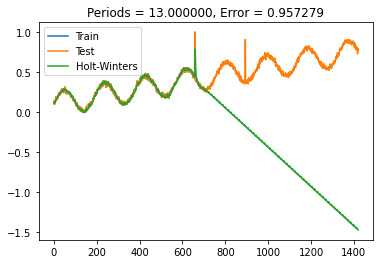


  9%|▊         | 17/198 [00:02<00:21,  8.39it/s]

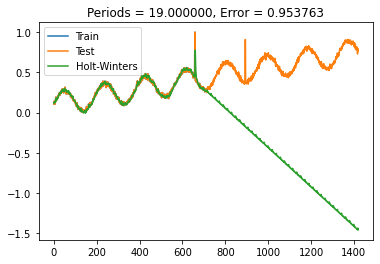


 14%|█▎        | 27/198 [00:03<00:18,  9.19it/s]

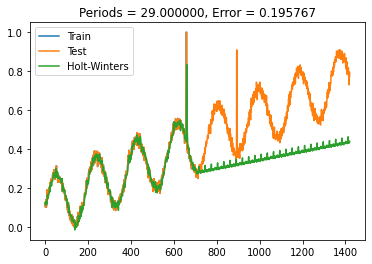


 14%|█▍        | 28/198 [00:03<00:32,  5.18it/s]

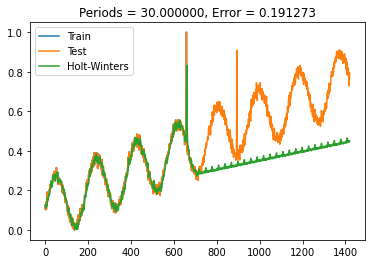


 17%|█▋        | 33/198 [00:04<00:32,  5.04it/s]

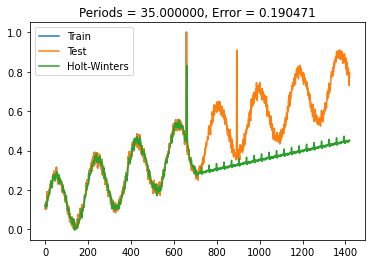


 19%|█▊        | 37/198 [00:05<00:35,  4.47it/s]

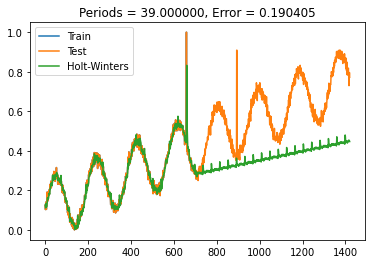


 20%|█▉        | 39/198 [00:06<00:43,  3.65it/s]

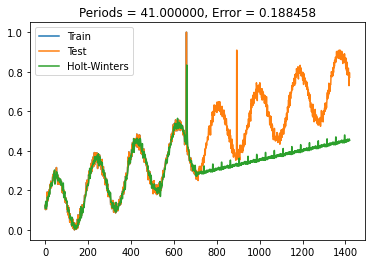


 23%|██▎       | 45/198 [00:08<00:38,  3.96it/s]

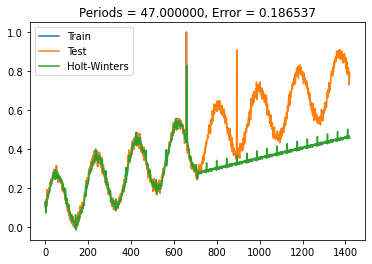


 27%|██▋       | 54/198 [00:10<00:37,  3.87it/s]

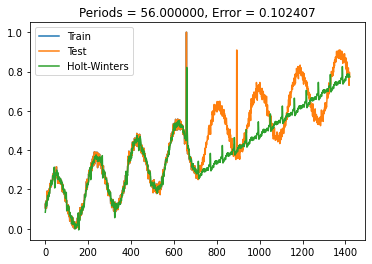


 91%|█████████▏| 181/198 [00:46<00:04,  3.41it/s]

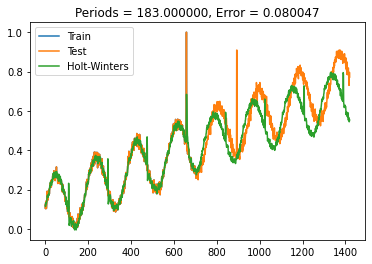


 92%|█████████▏| 182/198 [00:46<00:05,  2.95it/s]

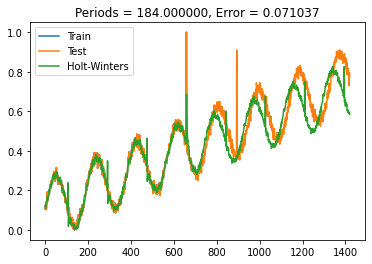


 92%|█████████▏| 183/198 [00:46<00:05,  2.68it/s]

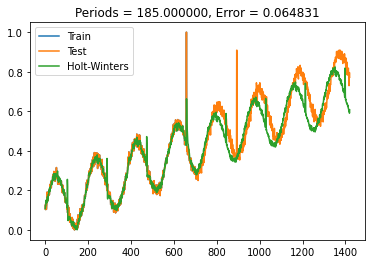


 93%|█████████▎| 184/198 [00:47<00:05,  2.54it/s]

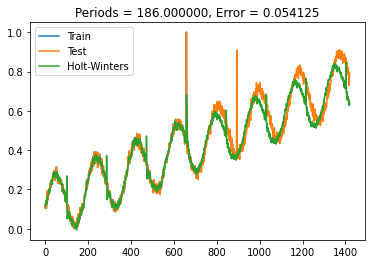


 93%|█████████▎| 185/198 [00:47<00:05,  2.44it/s]

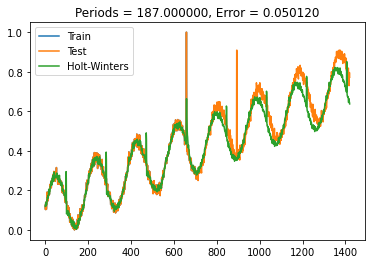


 94%|█████████▍| 186/198 [00:48<00:05,  2.36it/s]

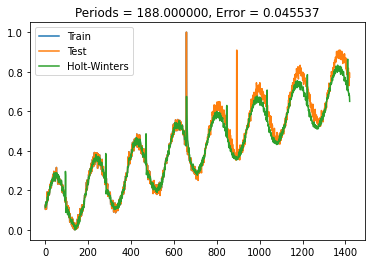


100%|██████████| 198/198 [00:52<00:00,  3.81it/s]


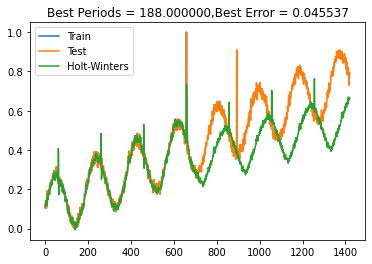

 37%|███▋      | 37/100 [26:40<46:17, 44.08s/it]




Errors:

Mean Absolute Error: 0.028
Mean Squared Error: 0.492
Root Mean Squared Error: 0.046
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.824
Mean forecast error: 0.468
Normalised mean squared error: 0.043
Theil_u_statistic: 0.197



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  8470.624612  ...    1.000000  0.579406
659 2014-12-20 18:00:00  8470.624612  ...    1.000000  0.674996
893 2014-12-30 12:00:00  7612.932509  ...    0.909141  0.368270
894 2014-12-30 13:00:00  7612.932509  ...    0.909141  0.362287

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_95
Mean:[11272.00157543]
StandardDeviation: 6995.5432472063
Min: -1.634254, Max: 5.256701
                

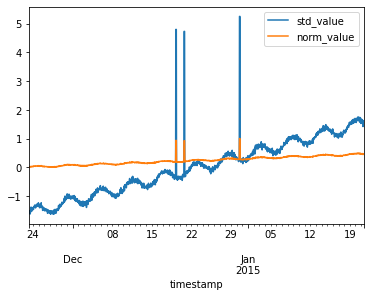


  0%|          | 0/198 [00:00<?, ?it/s]

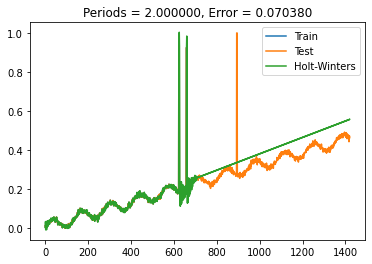


  1%|          | 1/198 [00:00<00:50,  3.93it/s]

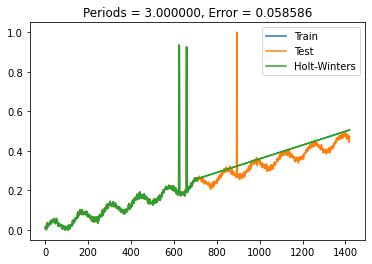


  2%|▏         | 3/198 [00:00<00:42,  4.55it/s]

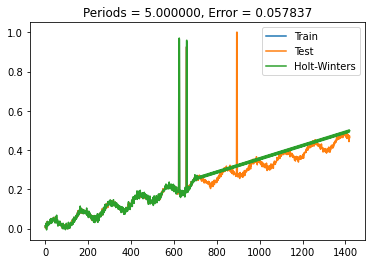


 10%|▉         | 19/198 [00:02<00:19,  9.12it/s]

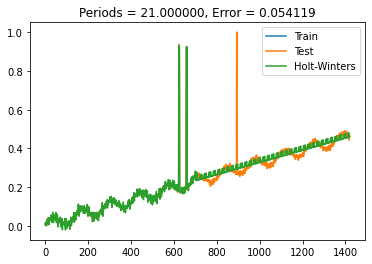


100%|██████████| 198/198 [00:34<00:00,  5.77it/s]


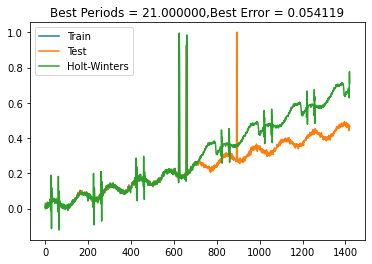

 38%|███▊      | 38/100 [27:15<42:40, 41.30s/it]




Errors:

Mean Absolute Error: 0.019
Mean Squared Error: 0.278
Root Mean Squared Error: 0.054
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 14.062
Mean forecast error: 0.279
Normalised mean squared error: 0.139
Theil_u_statistic: 0.698



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  44876.111260  ...    0.934254  0.203732
658 2014-12-20 17:00:00  44396.821024  ...    0.924311  0.216849
893 2014-12-30 12:00:00  48045.479149  ...    1.000000  0.292710
894 2014-12-30 13:00:00  48045.479149  ...    1.000000  0.294363
895 2014-12-30 14:00:00  48045.479149  ...    1.000000  0.295016

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_87
Me

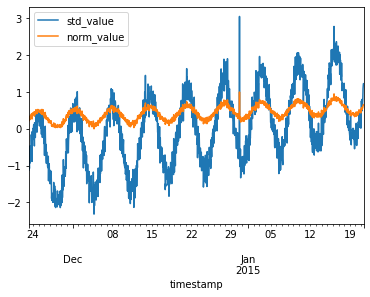


 31%|███▏      | 62/198 [00:08<00:29,  4.62it/s]

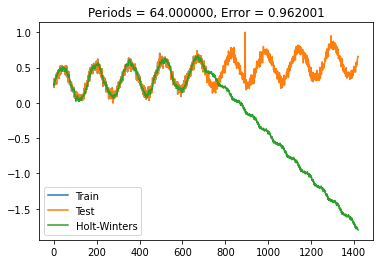


 34%|███▍      | 68/198 [00:09<00:26,  4.90it/s]

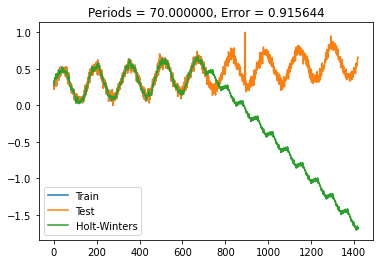


 35%|███▍      | 69/198 [00:10<00:34,  3.69it/s]

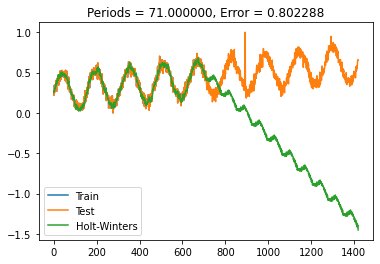


 35%|███▌      | 70/198 [00:10<00:37,  3.43it/s]

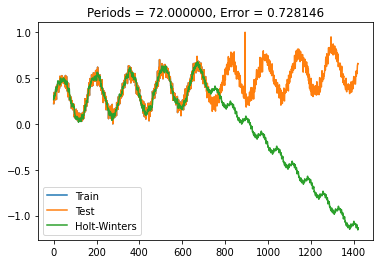


 36%|███▌      | 71/198 [00:11<00:39,  3.21it/s]

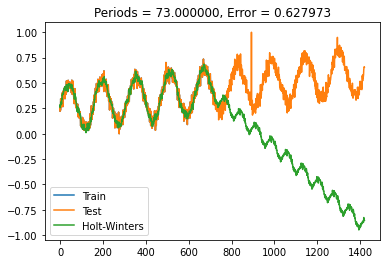


 39%|███▉      | 77/198 [00:12<00:28,  4.31it/s]

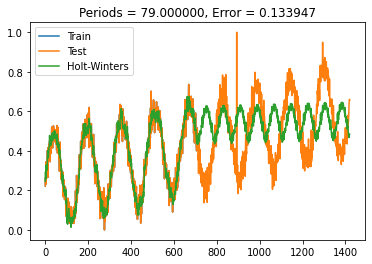


 78%|███████▊  | 155/198 [00:31<00:10,  4.11it/s]

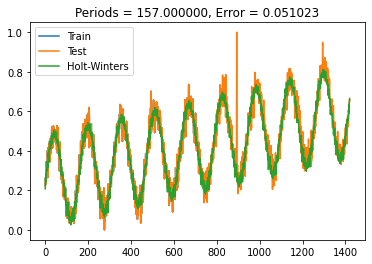


100%|██████████| 198/198 [00:44<00:00,  4.43it/s]


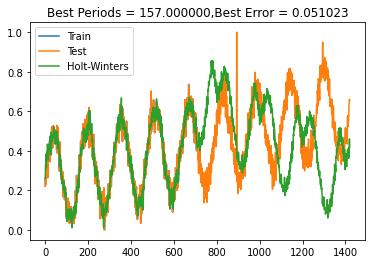

 39%|███▉      | 39/100 [28:00<43:11, 42.48s/it]




Errors:

Mean Absolute Error: 0.038
Mean Squared Error: 0.47
Root Mean Squared Error: 0.051
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 11.203
Mean forecast error: 0.463
Normalised mean squared error: 0.075
Theil_u_statistic: 0.235



 END Errors

              timestamp        value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  4749.512233  ...         1.0  0.265374

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_98
Mean:[31170.98049691]
StandardDeviation: 18199.27445284604
Min: -1.723083, Max: 3.006316
                            value  is_anomaly  std_value  norm_value
timestamp                                                           
2014-11-23 07:00:00    524.467220           0  -1.683941    0.008276

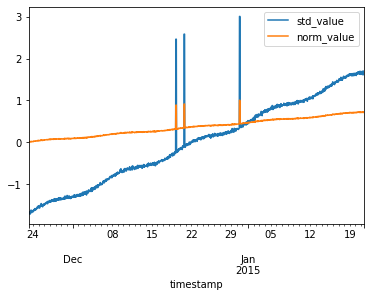


  0%|          | 0/198 [00:00<?, ?it/s]

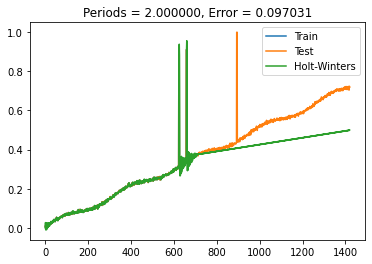


  1%|          | 1/198 [00:00<00:48,  4.07it/s]

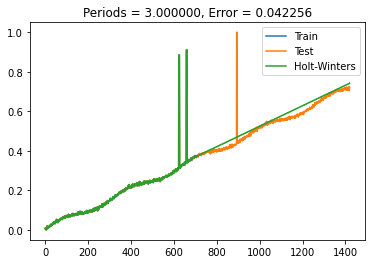


  4%|▍         | 8/198 [00:01<00:25,  7.47it/s]

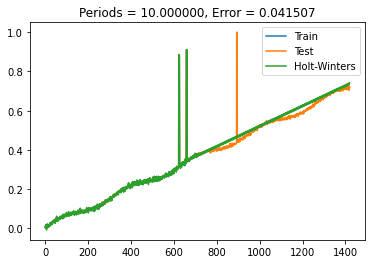


 12%|█▏        | 23/198 [00:02<00:18,  9.47it/s]

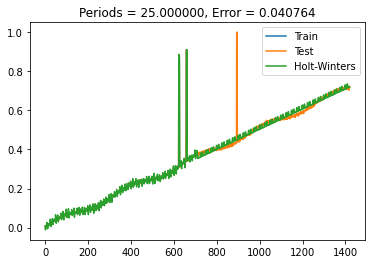


100%|██████████| 198/198 [00:33<00:00,  5.99it/s]


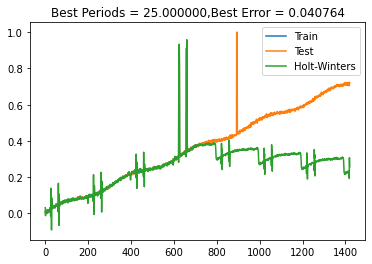

 40%|████      | 40/100 [28:34<39:48, 39.81s/it]




Errors:

Mean Absolute Error: 0.012
Mean Squared Error: 0.421
Root Mean Squared Error: 0.041
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 6.087
Mean forecast error: 0.421
Normalised mean squared error: 0.037
Theil_u_statistic: 0.23



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  75978.316449  ...    0.884916  0.331978
658 2014-12-20 17:00:00  78179.272273  ...    0.910488  0.362361
893 2014-12-30 12:00:00  85883.748857  ...    1.000000  0.447607
894 2014-12-30 13:00:00  85883.748857  ...    1.000000  0.448161
895 2014-12-30 14:00:00  85883.748857  ...    1.000000  0.449079

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_83
Mean

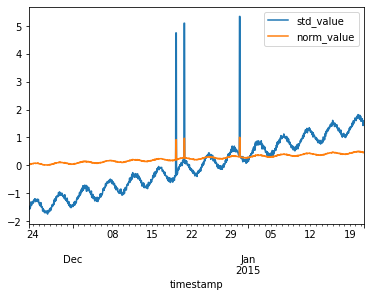


  0%|          | 0/198 [00:00<?, ?it/s]

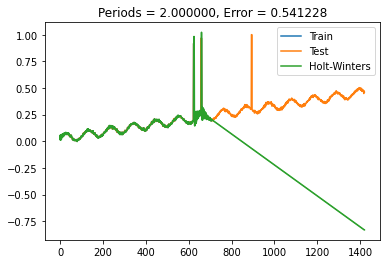


  1%|          | 1/198 [00:00<00:48,  4.04it/s]

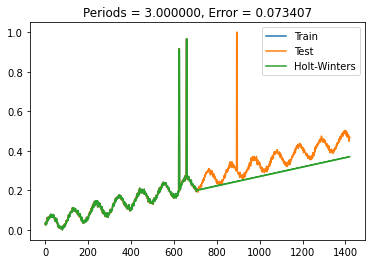


  7%|▋         | 13/198 [00:01<00:20,  9.15it/s]

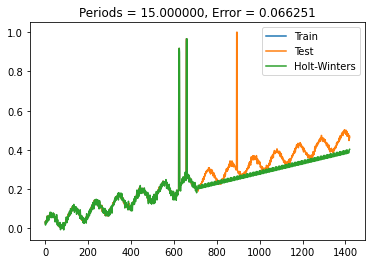


 10%|█         | 20/198 [00:02<00:20,  8.70it/s]

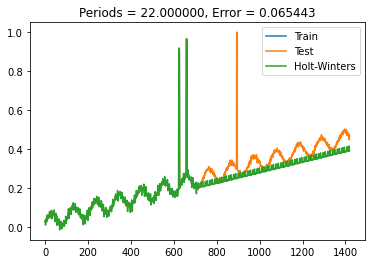


 21%|██        | 42/198 [00:05<00:22,  6.92it/s]

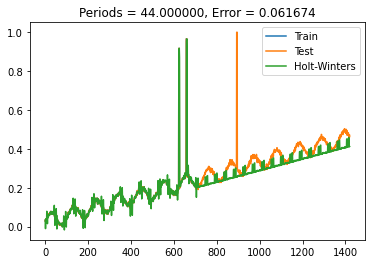


 22%|██▏       | 44/198 [00:05<00:33,  4.62it/s]

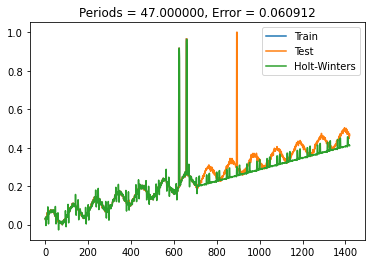


 26%|██▋       | 52/198 [00:07<00:23,  6.31it/s]

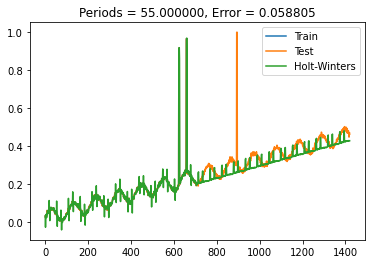


 29%|██▉       | 58/198 [00:08<00:34,  4.01it/s]

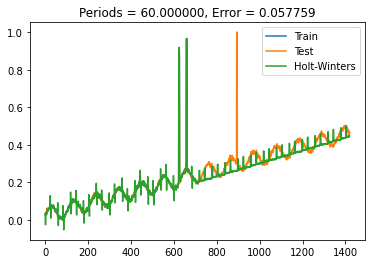


100%|██████████| 198/198 [00:35<00:00,  5.57it/s]


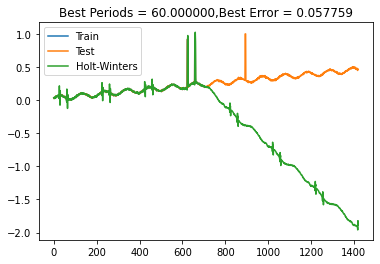

 41%|████      | 41/100 [29:10<38:02, 38.69s/it]




Errors:

Mean Absolute Error: 0.025
Mean Squared Error: 0.285
Root Mean Squared Error: 0.058
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 18.541
Mean forecast error: 0.267
Normalised mean squared error: 0.168
Theil_u_statistic: 0.759



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  32038.128350  ...    0.916757  0.251052
658 2014-12-20 17:00:00  33799.505156  ...    0.965854  0.328479
893 2014-12-30 12:00:00  35024.510337  ...    1.000000  0.260068
894 2014-12-30 13:00:00  35024.510337  ...    1.000000  0.259431
895 2014-12-30 14:00:00  35024.510337  ...    1.000000  0.263746

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_50
Me

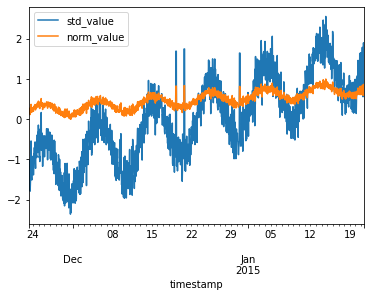


  0%|          | 0/198 [00:00<?, ?it/s]

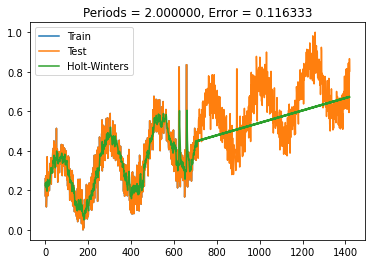


  1%|          | 2/198 [00:00<00:41,  4.72it/s]

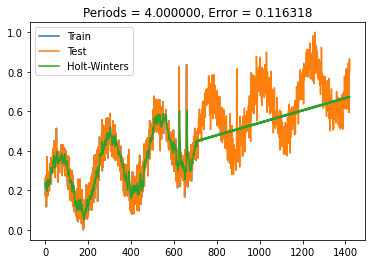


  2%|▏         | 3/198 [00:00<00:45,  4.33it/s]

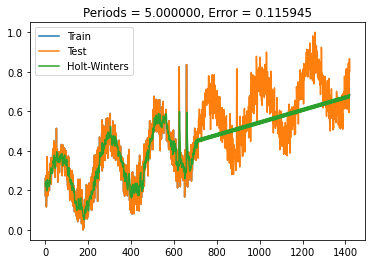


  4%|▎         | 7/198 [00:01<00:29,  6.55it/s]

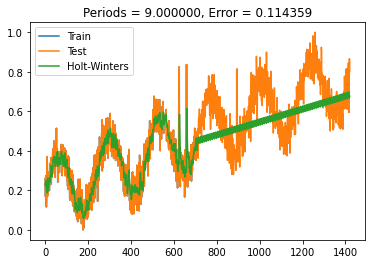


  6%|▌         | 11/198 [00:01<00:26,  7.14it/s]

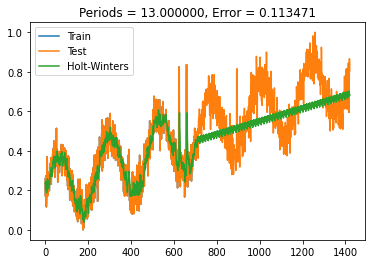


 12%|█▏        | 24/198 [00:03<00:26,  6.67it/s]

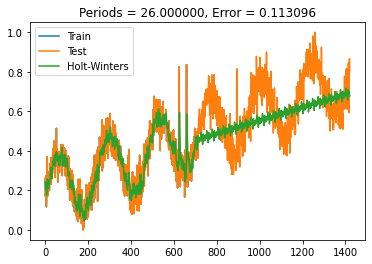


 14%|█▍        | 28/198 [00:04<00:30,  5.55it/s]

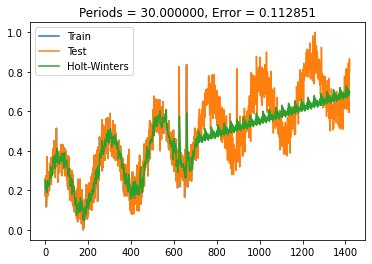


 15%|█▍        | 29/198 [00:04<00:38,  4.34it/s]

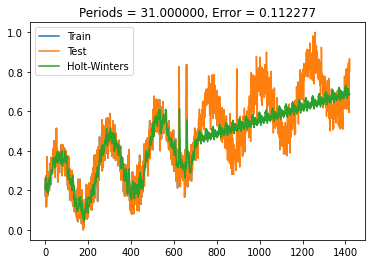


 25%|██▌       | 50/198 [00:09<00:37,  3.99it/s]

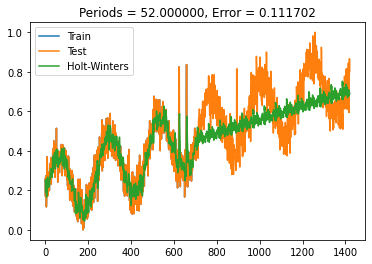


 56%|█████▌    | 111/198 [00:26<00:24,  3.49it/s]

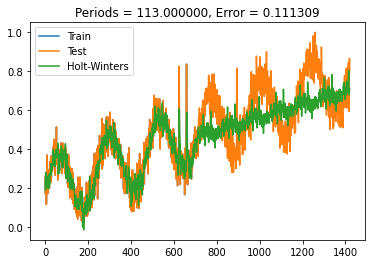


 57%|█████▋    | 112/198 [00:27<00:28,  2.99it/s]

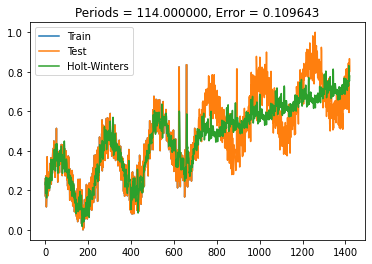


100%|██████████| 198/198 [00:52<00:00,  3.78it/s]


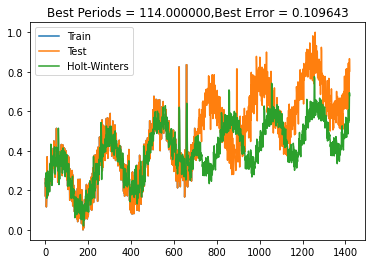

 42%|████▏     | 42/100 [30:03<41:33, 42.99s/it]




Errors:

Mean Absolute Error: 0.084
Mean Squared Error: 0.521
Root Mean Squared Error: 0.11
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 19.153
Mean forecast error: 0.504
Normalised mean squared error: 0.29
Theil_u_statistic: 0.418



 END Errors

               timestamp        value  ...  norm_value   hw_pred
623  2014-12-19 06:00:00  5392.806050  ...    0.824091  0.358753
624  2014-12-19 07:00:00  5392.806050  ...    0.824091  0.491145
658  2014-12-20 17:00:00  5489.383786  ...    0.835565  0.392658
659  2014-12-20 18:00:00  5489.383786  ...    0.835565  0.515701
762  2014-12-25 01:00:00  5017.359623  ...    0.779487  0.499259
763  2014-12-25 02:00:00  4533.499379  ...    0.722004  0.471319
764  2014-12-25 03:00:00  4579.612517  ...    0.727482  0.450974
765  2014-12-25 04:00:00  4953.663981  ...    0.771920  0.511593
779  2014-12-25 18:00:00  5065.840386  ...    0.785247  0.478155
788  2014-12-26 03:00:00  5063.484305  ...    0.784967  0.476777
893 

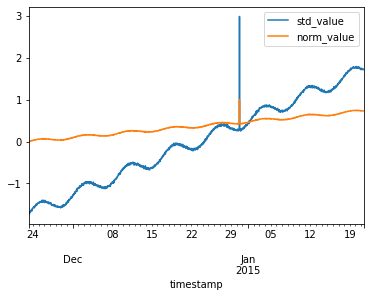


  0%|          | 0/198 [00:00<?, ?it/s]

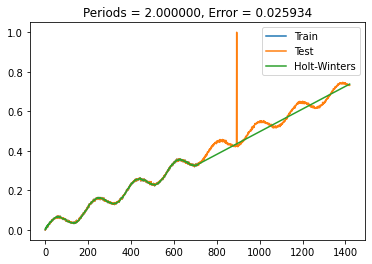


 63%|██████▎   | 124/198 [00:20<00:22,  3.22it/s]

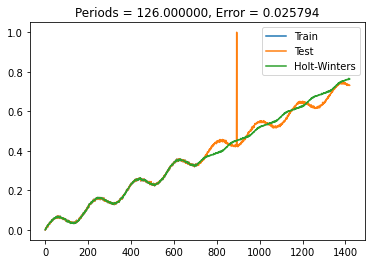


 75%|███████▍  | 148/198 [00:28<00:17,  2.89it/s]

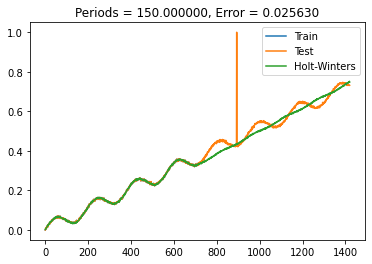


100%|██████████| 198/198 [00:41<00:00,  4.78it/s]


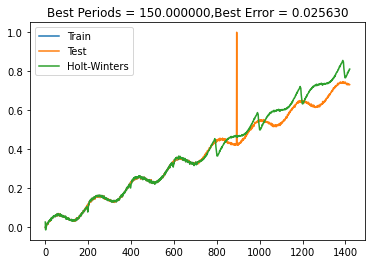

 43%|████▎     | 43/100 [30:45<40:33, 42.69s/it]




Errors:

Mean Absolute Error: 0.014
Mean Squared Error: 0.424
Root Mean Squared Error: 0.026
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 3.808
Mean forecast error: 0.418
Normalised mean squared error: 0.015
Theil_u_statistic: 0.145



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  40527.023374  ...         1.0  0.432956

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_39
Mean:[5179.09662997]
StandardDeviation: 3173.156284291212
Min: -1.996127, Max: 5.291048
                            value  is_anomaly  std_value  norm_value
timestamp                                                           
2014-11-23 07:00:00   -237.727692           0  -1.707078    0.03966

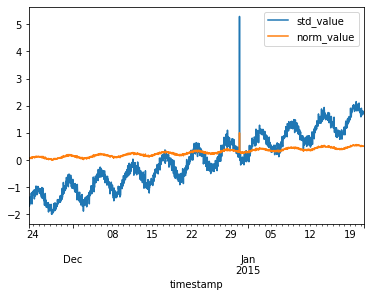


  0%|          | 0/198 [00:00<?, ?it/s]

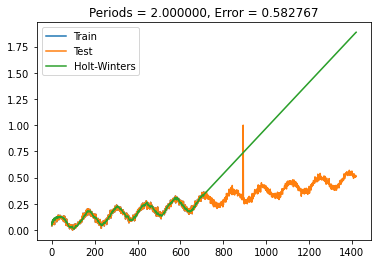


  1%|          | 1/198 [00:00<00:47,  4.12it/s]

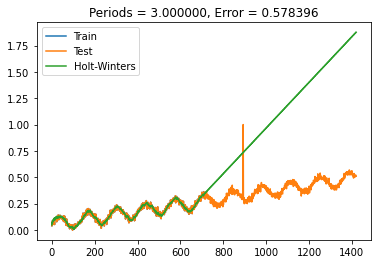


  1%|          | 2/198 [00:00<00:48,  4.05it/s]

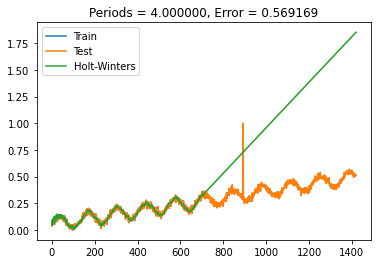


  2%|▏         | 3/198 [00:00<00:53,  3.67it/s]

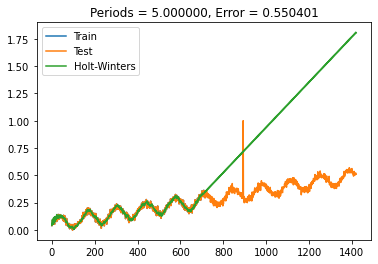


  2%|▏         | 4/198 [00:01<00:51,  3.75it/s]

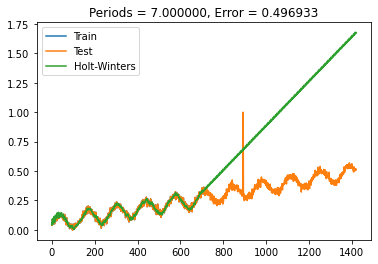


  9%|▊         | 17/198 [00:02<00:19,  9.40it/s]

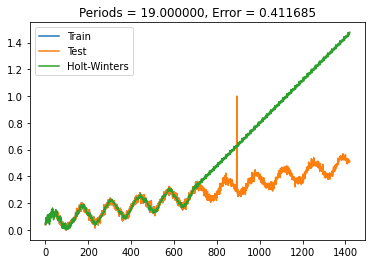

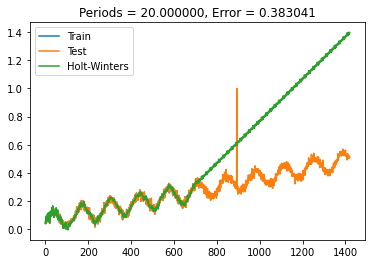


 29%|██▉       | 57/198 [00:08<00:24,  5.65it/s]

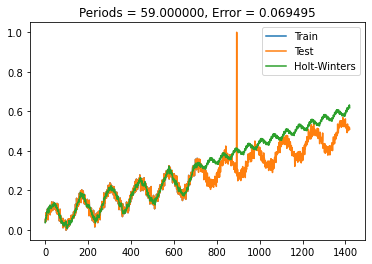


 49%|████▉     | 98/198 [00:17<00:16,  6.00it/s]

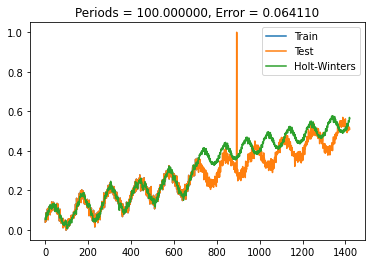


 59%|█████▊    | 116/198 [00:22<00:21,  3.82it/s]

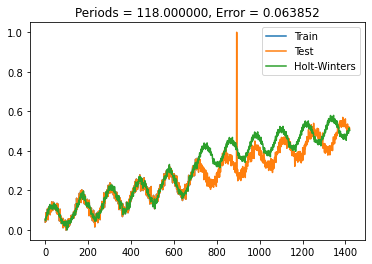


 67%|██████▋   | 132/198 [00:25<00:16,  4.11it/s]

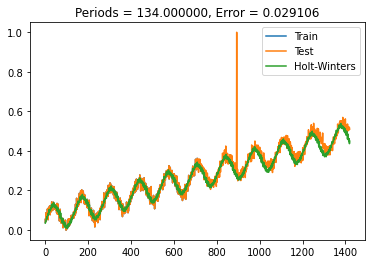


 67%|██████▋   | 133/198 [00:26<00:20,  3.25it/s]

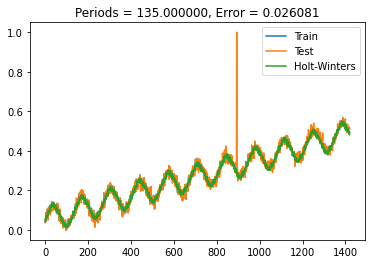


100%|██████████| 198/198 [00:46<00:00,  4.30it/s]


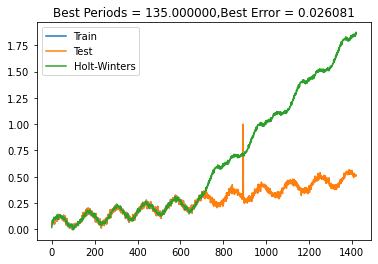

 44%|████▍     | 44/100 [31:31<40:56, 43.86s/it]




Errors:

Mean Absolute Error: 0.015
Mean Squared Error: 0.306
Root Mean Squared Error: 0.026
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.687
Mean forecast error: 0.302
Normalised mean squared error: 0.036
Theil_u_statistic: 0.282



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  21968.419359  ...         1.0  0.283636

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_2
Mean:[486.38455762]
StandardDeviation: 1024.391457075709
Min: -1.780355, Max: 2.673989
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00    27.109888           0  -0.448339    0.299037
201

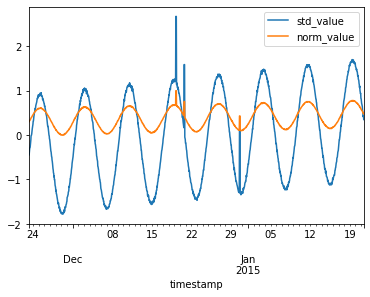


 11%|█         | 22/198 [00:02<00:18,  9.55it/s]

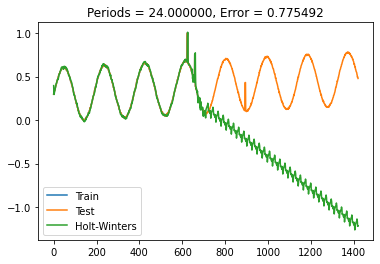


 17%|█▋        | 33/198 [00:03<00:18,  9.00it/s]

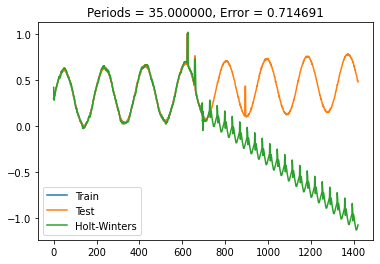


 19%|█▊        | 37/198 [00:04<00:21,  7.52it/s]

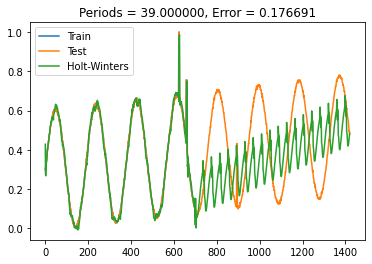


 94%|█████████▍| 186/198 [00:26<00:02,  4.51it/s]

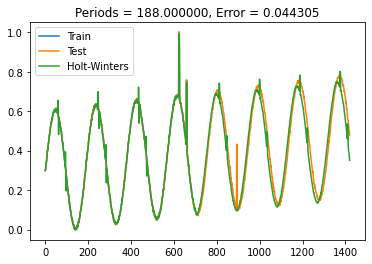


 95%|█████████▍| 188/198 [00:27<00:02,  3.69it/s]

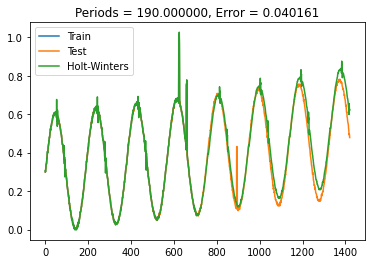


100%|██████████| 198/198 [00:29<00:00,  6.63it/s]


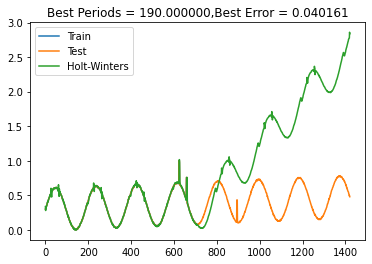

 45%|████▌     | 45/100 [32:02<36:31, 39.84s/it]




Errors:

Mean Absolute Error: 0.023
Mean Squared Error: 0.458
Root Mean Squared Error: 0.04
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.663
Mean forecast error: 0.473
Normalised mean squared error: 0.032
Theil_u_statistic: 0.185



 END Errors

              timestamp        value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  3225.596069  ...    1.000000  0.718332
658 2014-12-20 17:00:00  2114.071753  ...    0.756404  0.479402
893 2014-12-30 12:00:00   631.206140  ...    0.431428  0.133826
894 2014-12-30 13:00:00   631.206140  ...    0.431428  0.128337
895 2014-12-30 14:00:00   631.206140  ...    0.431428  0.127397

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_66
Mean:[197.

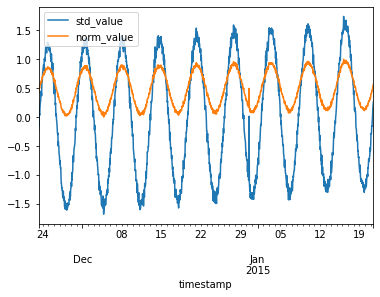


 17%|█▋        | 33/198 [00:03<00:18,  8.76it/s]

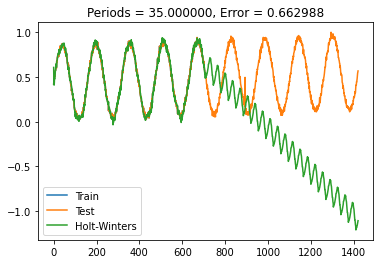


 21%|██        | 41/198 [00:04<00:18,  8.63it/s]

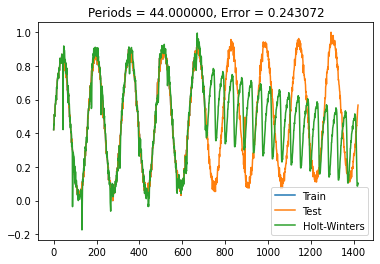


 46%|████▌     | 91/198 [00:12<00:27,  3.94it/s]

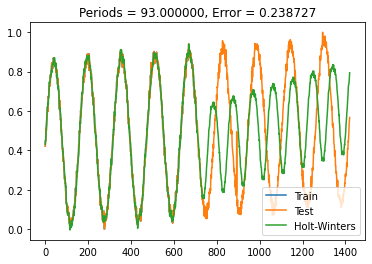


 79%|███████▉  | 156/198 [00:26<00:08,  4.83it/s]

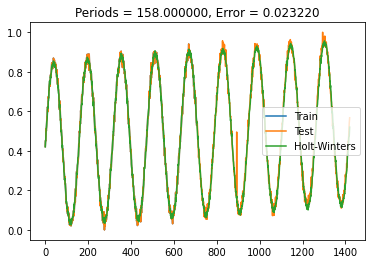


100%|██████████| 198/198 [00:38<00:00,  5.11it/s]


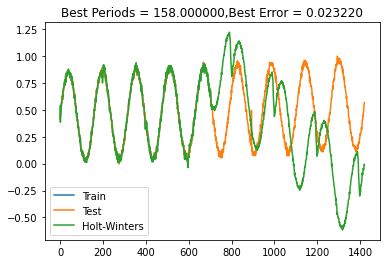

 46%|████▌     | 46/100 [32:41<35:43, 39.70s/it]




Errors:

Mean Absolute Error: 0.017
Mean Squared Error: 0.571
Root Mean Squared Error: 0.023
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 6.797
Mean forecast error: 0.569
Normalised mean squared error: 0.006
Theil_u_statistic: 0.071



 END Errors

              timestamp       value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  211.466202  ...    0.495304  0.171281

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_64
Mean:[262.57105279]
StandardDeviation: 979.725798864144
Min: -1.693491, Max: 1.693387
                          value  is_anomaly  std_value  norm_value
timestamp                                                         
2014-11-23 07:00:00   52.147071           0  -0.214778    0.436600
2014-11-23

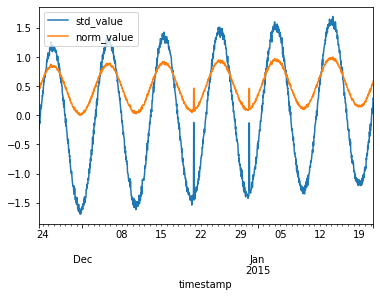


 20%|██        | 40/198 [00:04<00:18,  8.55it/s]

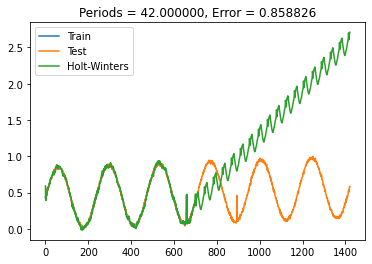


 25%|██▍       | 49/198 [00:05<00:18,  8.01it/s]

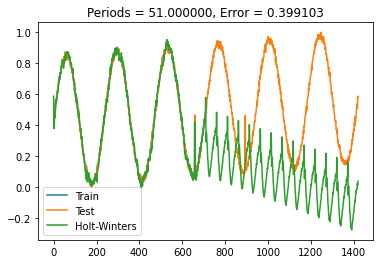


 68%|██████▊   | 135/198 [00:18<00:17,  3.53it/s]

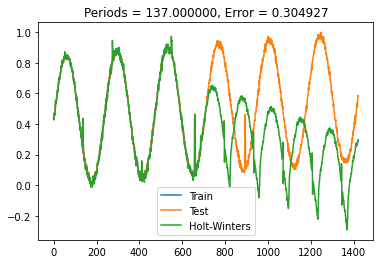


100%|██████████| 198/198 [00:30<00:00,  6.45it/s]


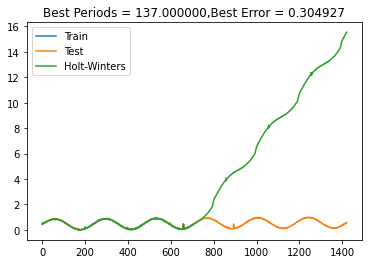

 47%|████▋     | 47/100 [33:12<32:49, 37.16s/it]




Errors:

Mean Absolute Error: 0.189
Mean Squared Error: 0.581
Root Mean Squared Error: 0.305
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 105.624
Mean forecast error: 0.46
Normalised mean squared error: 1.066
Theil_u_statistic: 1.141



 END Errors

               timestamp        value  ...  norm_value   hw_pred
658  2014-12-20 17:00:00   140.244145  ...    0.463150  0.082138
751  2014-12-24 14:00:00  1562.519745  ...    0.891777  0.634434
752  2014-12-24 15:00:00  1536.218272  ...    0.883851  0.631234
753  2014-12-24 16:00:00  1536.843881  ...    0.884039  0.626263
754  2014-12-24 17:00:00  1585.327658  ...    0.898651  0.614010
...                  ...          ...  ...         ...       ...
1415 2015-01-21 06:00:00   316.673624  ...    0.516320  0.260589
1416 2015-01-21 07:00:00   388.040815  ...    0.537828  0.263873
1418 2015-01-21 09:00:00   450.840912  ...    0.556754  0.289477
1419 2015-01-21 10:00:00   550.047164  ...    0.586651  0.283512
14

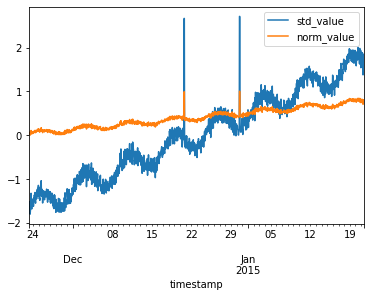


  0%|          | 0/198 [00:00<?, ?it/s]

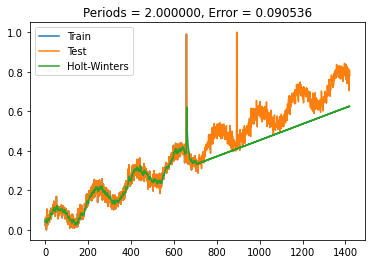


  1%|          | 1/198 [00:00<00:51,  3.85it/s]

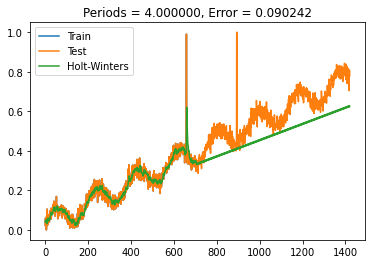


  4%|▎         | 7/198 [00:01<00:27,  6.86it/s]

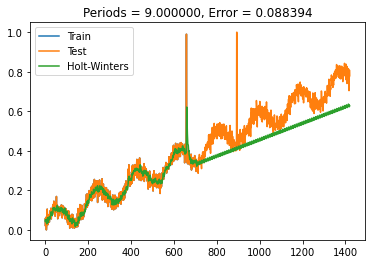


  6%|▌         | 11/198 [00:01<00:26,  6.97it/s]

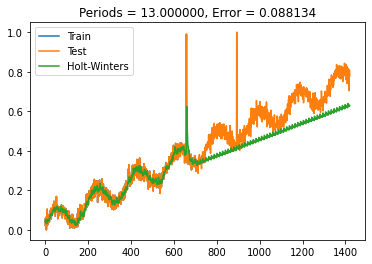


 12%|█▏        | 24/198 [00:04<00:31,  5.49it/s]

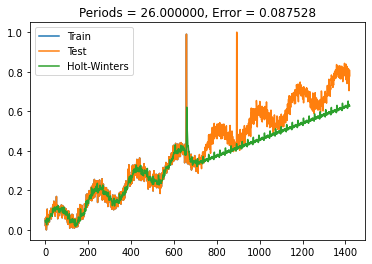


 15%|█▍        | 29/198 [00:05<00:37,  4.51it/s]

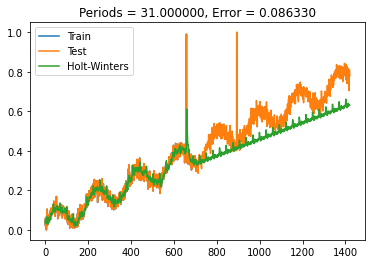


 31%|███       | 61/198 [00:13<00:38,  3.58it/s]

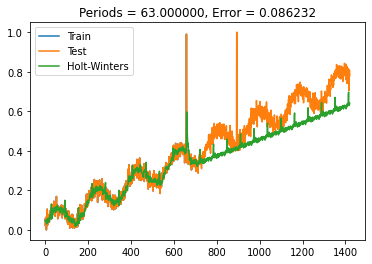


 34%|███▍      | 68/198 [00:15<00:35,  3.62it/s]

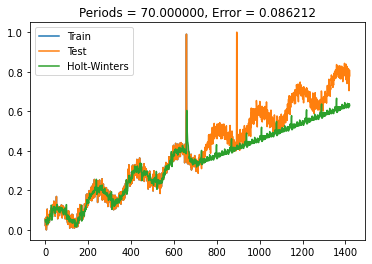


 42%|████▏     | 83/198 [00:19<00:31,  3.68it/s]

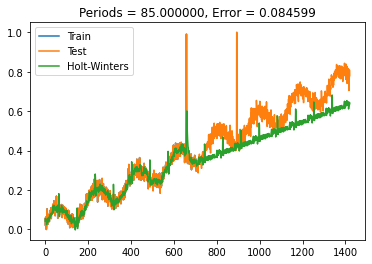


 43%|████▎     | 85/198 [00:20<00:35,  3.18it/s]

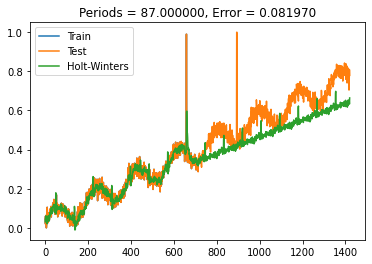


 46%|████▋     | 92/198 [00:22<00:31,  3.39it/s]

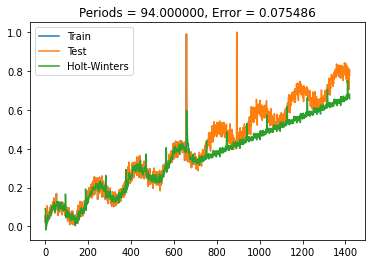


 90%|█████████ | 179/198 [00:47<00:05,  3.54it/s]

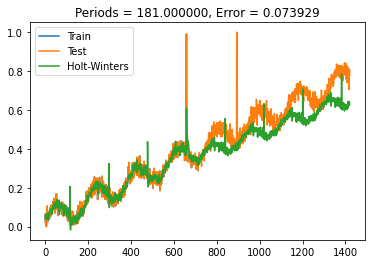


 91%|█████████ | 180/198 [00:48<00:06,  2.99it/s]

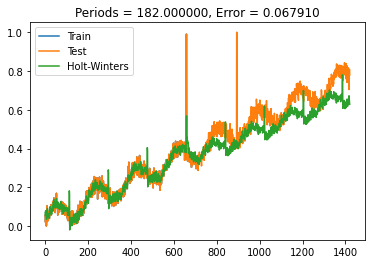


 92%|█████████▏| 183/198 [00:49<00:04,  3.25it/s]

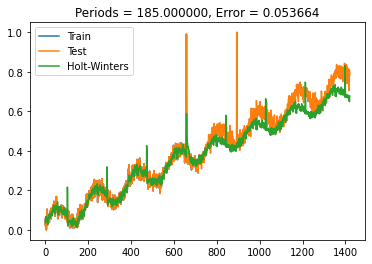


 93%|█████████▎| 184/198 [00:49<00:04,  2.87it/s]

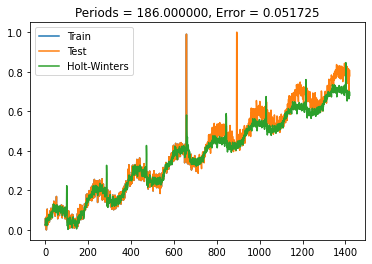


 93%|█████████▎| 185/198 [00:49<00:04,  2.61it/s]

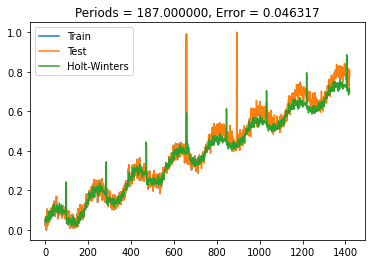


100%|██████████| 198/198 [00:53<00:00,  3.67it/s]


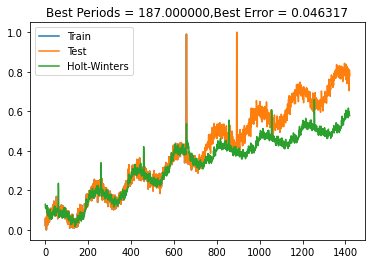

 48%|████▊     | 48/100 [34:07<36:42, 42.36s/it]




Errors:

Mean Absolute Error: 0.03
Mean Squared Error: 0.457
Root Mean Squared Error: 0.046
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.54
Mean forecast error: 0.435
Normalised mean squared error: 0.044
Theil_u_statistic: 0.233



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  23114.958768  ...    0.989807  0.550051
659 2014-12-20 18:00:00  23114.958768  ...    0.989807  0.591736
893 2014-12-30 12:00:00  23359.052184  ...    1.000000  0.425595
894 2014-12-30 13:00:00  23359.052184  ...    1.000000  0.419626

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_45
Mean:[993.25904263]
StandardDeviation: 1187.711161968377
Min: -2.557390, Max: 3.198009
            

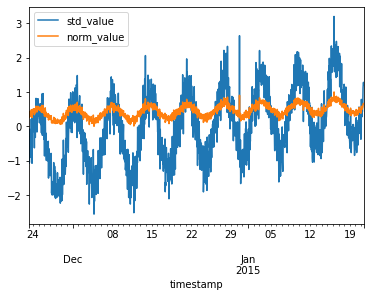


 31%|███▏      | 62/198 [00:11<00:41,  3.31it/s]

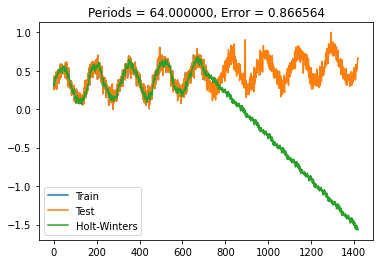


 36%|███▌      | 71/198 [00:13<00:27,  4.66it/s]

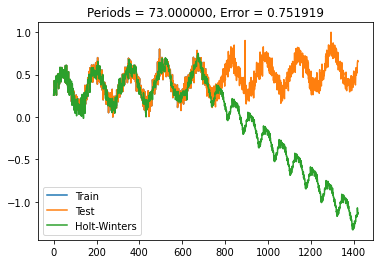


 38%|███▊      | 76/198 [00:14<00:24,  4.95it/s]

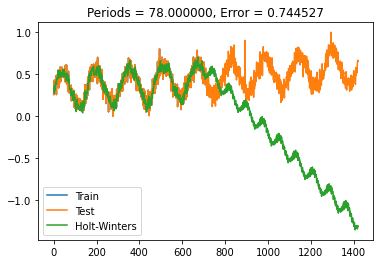


 39%|███▉      | 77/198 [00:15<00:30,  3.98it/s]

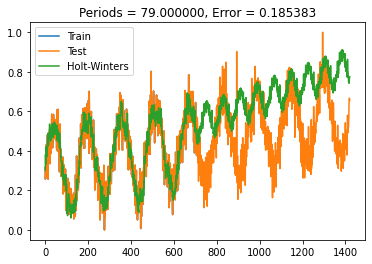


 39%|███▉      | 78/198 [00:15<00:34,  3.46it/s]

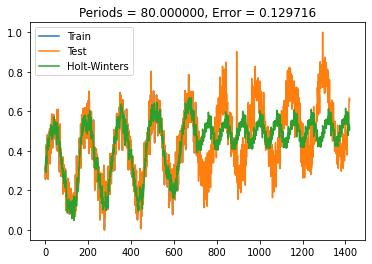


 77%|███████▋  | 153/198 [00:34<00:11,  3.81it/s]

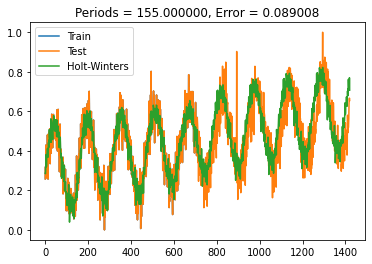


 78%|███████▊  | 154/198 [00:35<00:14,  3.08it/s]

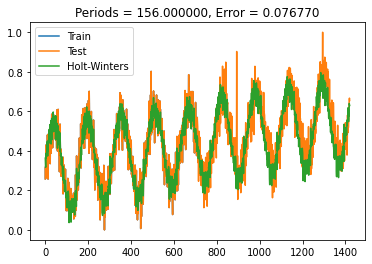


 79%|███████▉  | 157/198 [00:35<00:09,  4.19it/s]

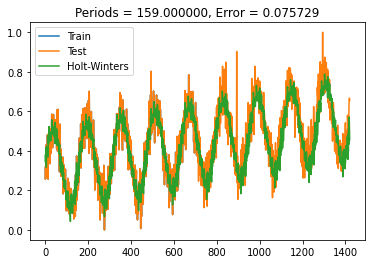


100%|██████████| 198/198 [00:48<00:00,  4.09it/s]


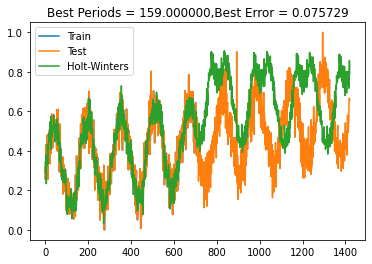

 49%|████▉     | 49/100 [34:56<37:41, 44.35s/it]




Errors:

Mean Absolute Error: 0.058
Mean Squared Error: 0.477
Root Mean Squared Error: 0.076
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.458
Mean forecast error: 0.463
Normalised mean squared error: 0.19
Theil_u_statistic: 0.343



 END Errors

               timestamp        value  ...  norm_value   hw_pred
893  2014-12-30 12:00:00  4126.027412  ...    0.902638  0.337119
935  2015-01-01 06:00:00  1662.727457  ...    0.542283  0.271152
1252 2015-01-14 11:00:00  2221.063133  ...    0.623961  0.363936
1294 2015-01-16 05:00:00  4791.570541  ...    1.000000  0.701993

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 3
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 0.25, Recall: 1.0, F1: 0.4
synthetic_71
Mean:[801.57354077]
StandardDeviation: 1050.638599061139
Min: -2.070213, Max: 2.417565
          

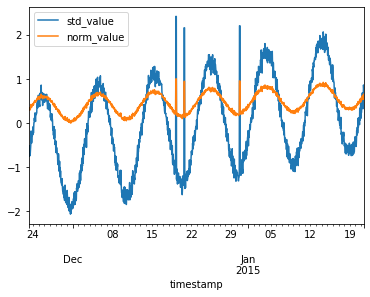


  0%|          | 0/198 [00:00<?, ?it/s]

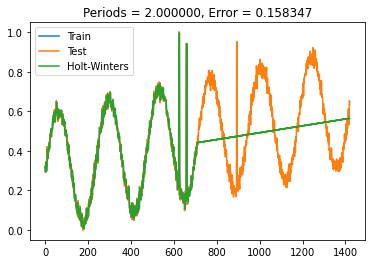


  1%|          | 2/198 [00:00<00:44,  4.43it/s]

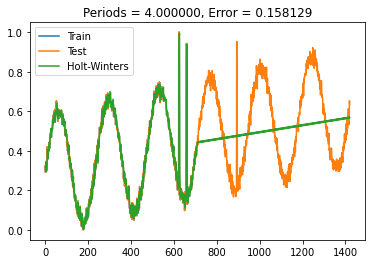


  3%|▎         | 6/198 [00:00<00:30,  6.32it/s]

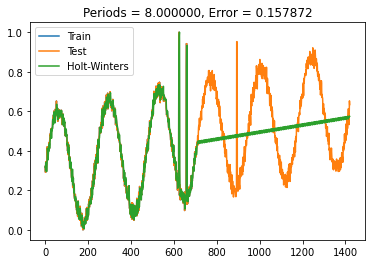


  4%|▎         | 7/198 [00:01<00:36,  5.21it/s]

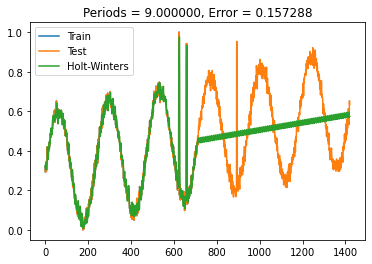


  7%|▋         | 13/198 [00:02<00:25,  7.38it/s]

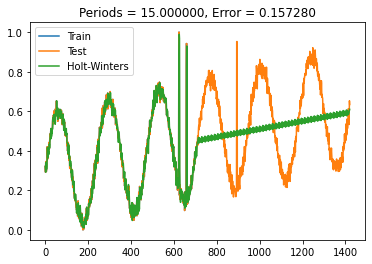


  8%|▊         | 16/198 [00:02<00:27,  6.63it/s]

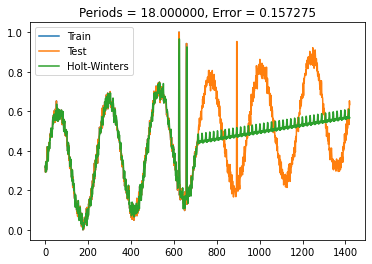


 22%|██▏       | 43/198 [00:06<00:21,  7.30it/s]

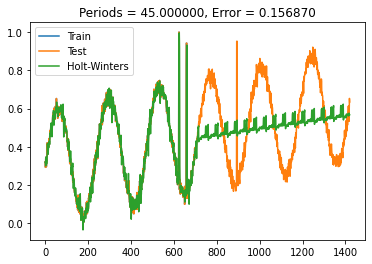


100%|██████████| 198/198 [00:32<00:00,  6.02it/s]


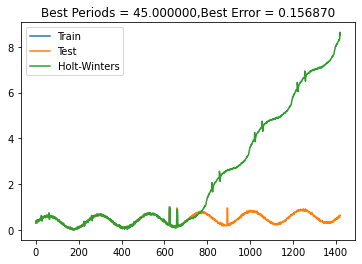

 50%|█████     | 50/100 [35:29<34:14, 41.08s/it]




Errors:

Mean Absolute Error: 0.11
Mean Squared Error: 0.512
Root Mean Squared Error: 0.157
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 24.867
Mean forecast error: 0.476
Normalised mean squared error: 0.495
Theil_u_statistic: 0.644



 END Errors

               timestamp        value  ...  norm_value   hw_pred
623  2014-12-19 06:00:00  3341.560730  ...    1.000000  0.261873
658  2014-12-20 17:00:00  3070.390078  ...    0.942488  0.203335
744  2014-12-24 07:00:00  1979.689520  ...    0.711164  0.451345
745  2014-12-24 08:00:00  2066.102752  ...    0.729491  0.452813
747  2014-12-24 10:00:00  2022.893605  ...    0.720327  0.463056
...                  ...          ...  ...         ...       ...
1267 2015-01-15 02:00:00  2420.123161  ...    0.804575  0.539637
1268 2015-01-15 03:00:00  2607.667261  ...    0.844350  0.530175
1269 2015-01-15 04:00:00  2578.919807  ...    0.838253  0.545254
1272 2015-01-15 07:00:00  2376.243924  ...    0.795268  0.540403
127

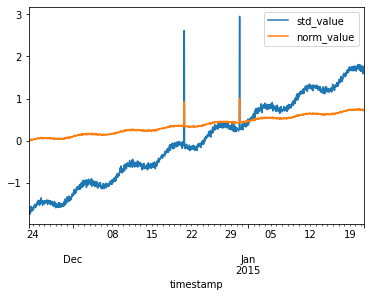


  0%|          | 0/198 [00:00<?, ?it/s]

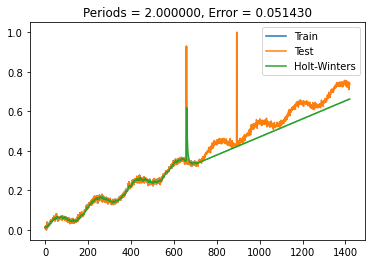


  1%|          | 2/198 [00:00<00:43,  4.50it/s]

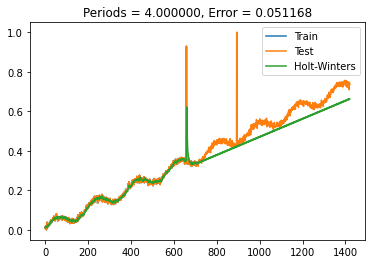


  4%|▎         | 7/198 [00:01<00:27,  6.94it/s]

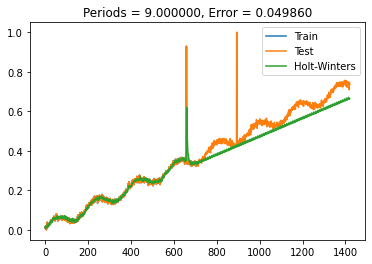


 12%|█▏        | 24/198 [00:03<00:26,  6.54it/s]

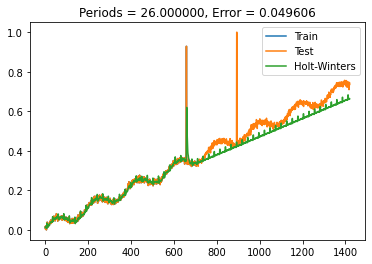


 15%|█▍        | 29/198 [00:05<00:37,  4.54it/s]

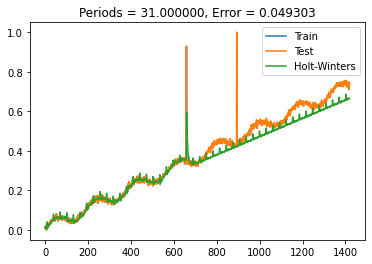


 20%|█▉        | 39/198 [00:07<00:30,  5.25it/s]

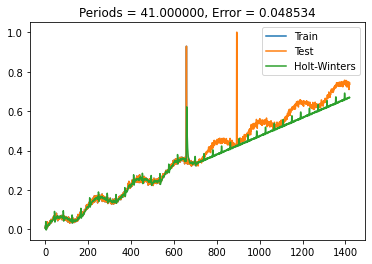


 26%|██▌       | 51/198 [00:10<00:42,  3.49it/s]

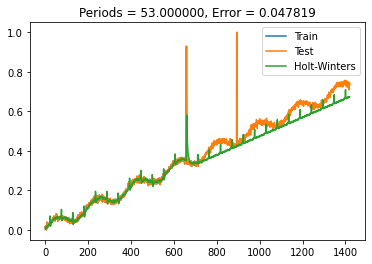


 28%|██▊       | 56/198 [00:12<00:38,  3.65it/s]

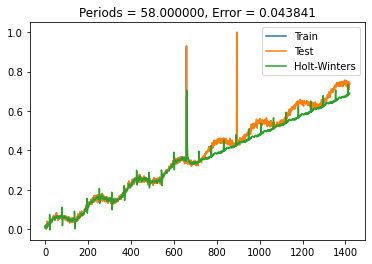


 36%|███▌      | 71/198 [00:16<00:35,  3.53it/s]

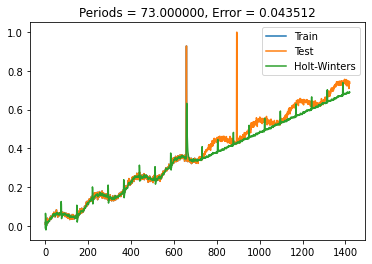


 39%|███▉      | 77/198 [00:18<00:32,  3.73it/s]

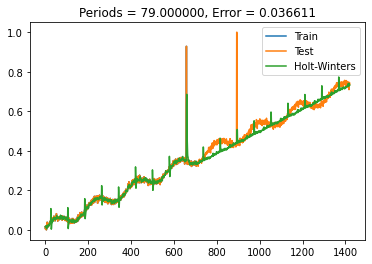


 40%|███▉      | 79/198 [00:19<00:36,  3.22it/s]

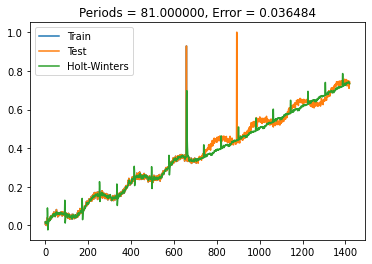


 93%|█████████▎| 185/198 [00:49<00:03,  3.49it/s]

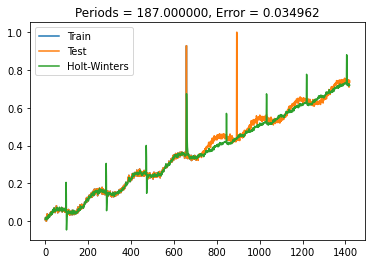


100%|██████████| 198/198 [00:53<00:00,  3.72it/s]


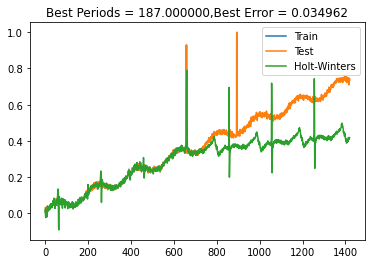

 51%|█████     | 51/100 [36:23<36:38, 44.87s/it]




Errors:

Mean Absolute Error: 0.017
Mean Squared Error: 0.428
Root Mean Squared Error: 0.035
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.315
Mean forecast error: 0.42
Normalised mean squared error: 0.027
Theil_u_statistic: 0.195



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  43520.564531  ...    0.928624  0.501392
659 2014-12-20 18:00:00  43520.564531  ...    0.928624  0.674619
893 2014-12-30 12:00:00  46884.241246  ...    1.000000  0.438231
894 2014-12-30 13:00:00  46884.241246  ...    1.000000  0.436818

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_88
Mean:[10896.8921992]
StandardDeviation: 6380.266953556927
Min: -1.725443, Max: 2.935572
           

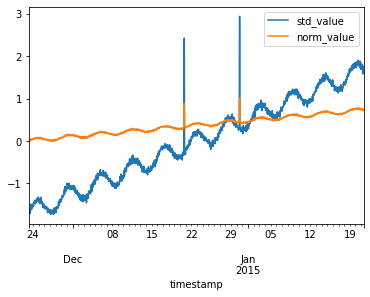


  0%|          | 0/198 [00:00<?, ?it/s]

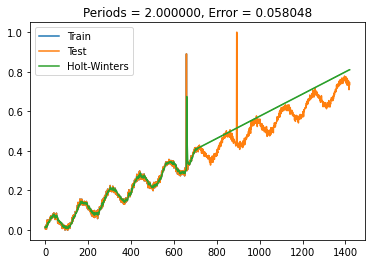


  1%|          | 1/198 [00:00<00:51,  3.85it/s]

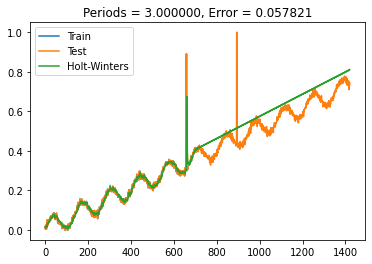


  2%|▏         | 3/198 [00:00<00:42,  4.60it/s]

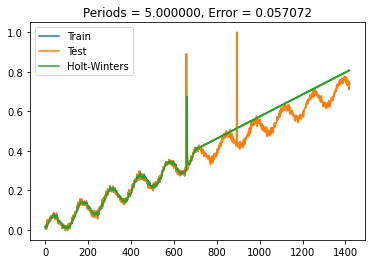


  4%|▍         | 8/198 [00:01<00:28,  6.64it/s]

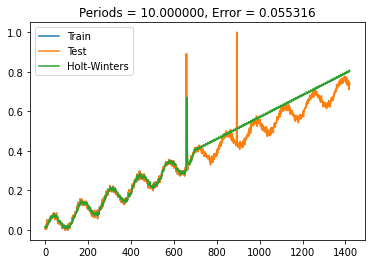


 11%|█         | 22/198 [00:03<00:30,  5.84it/s]

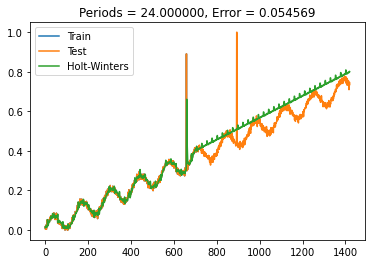


 12%|█▏        | 23/198 [00:03<00:36,  4.74it/s]

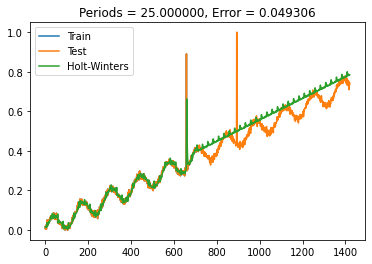


 24%|██▎       | 47/198 [00:10<00:39,  3.82it/s]

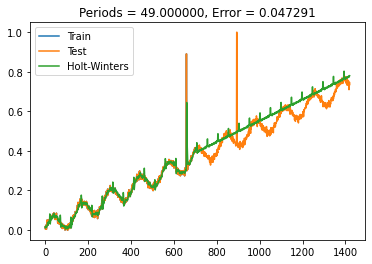


 24%|██▍       | 48/198 [00:10<00:47,  3.13it/s]

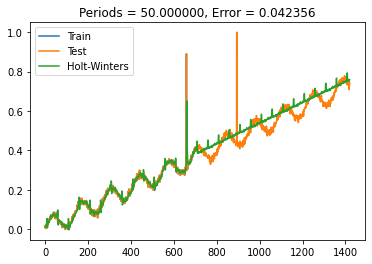


 65%|██████▌   | 129/198 [00:33<00:19,  3.47it/s]

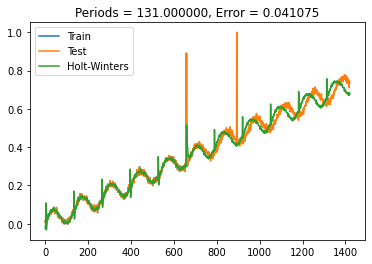


 66%|██████▌   | 130/198 [00:34<00:22,  2.99it/s]

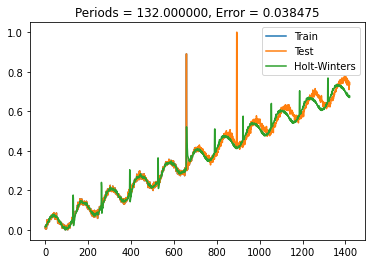


 66%|██████▌   | 131/198 [00:34<00:24,  2.71it/s]

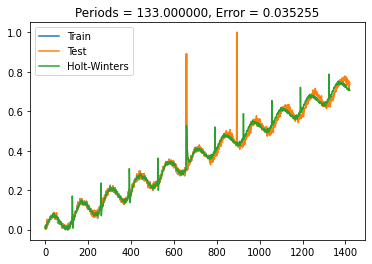


 67%|██████▋   | 133/198 [00:35<00:23,  2.71it/s]

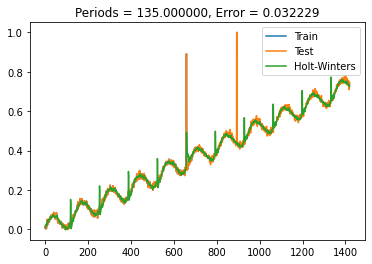


100%|██████████| 198/198 [00:53<00:00,  3.68it/s]


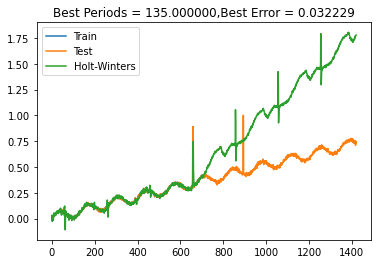

 52%|█████▏    | 52/100 [37:17<38:09, 47.71s/it]




Errors:

Mean Absolute Error: 0.012
Mean Squared Error: 0.428
Root Mean Squared Error: 0.032
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.22
Mean forecast error: 0.426
Normalised mean squared error: 0.023
Theil_u_statistic: 0.177



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  26360.700612  ...    0.890179  0.429673
659 2014-12-20 18:00:00  26360.700612  ...    0.890179  0.492560
893 2014-12-30 12:00:00  29626.623067  ...    1.000000  0.431951
894 2014-12-30 13:00:00  29626.623067  ...    1.000000  0.433660

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_9
Mean:[1922.21675139]
StandardDeviation: 1465.7790845493764
Min: -2.131705, Max: 3.915113
           

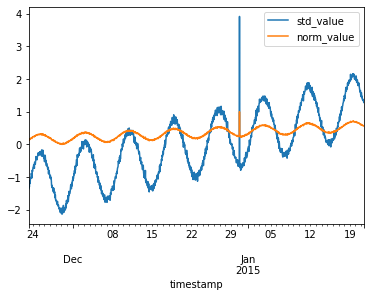


  0%|          | 0/198 [00:00<?, ?it/s]

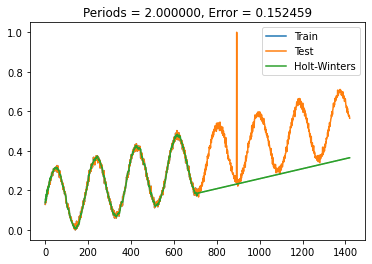


  1%|          | 1/198 [00:00<00:47,  4.18it/s]

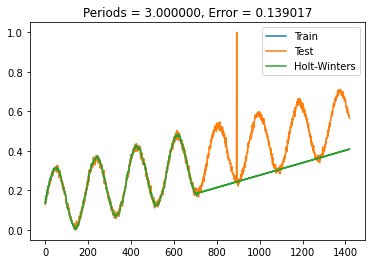


  7%|▋         | 13/198 [00:01<00:21,  8.44it/s]

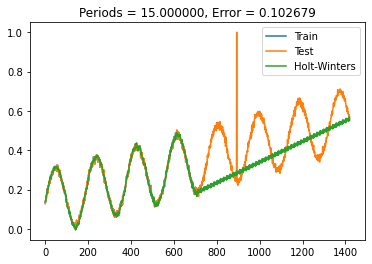


  7%|▋         | 14/198 [00:01<00:29,  6.17it/s]

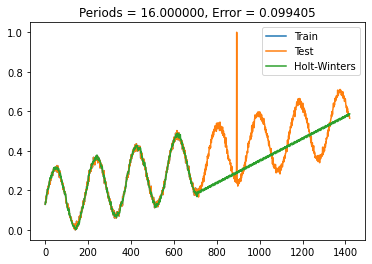


 12%|█▏        | 23/198 [00:03<00:25,  6.81it/s]

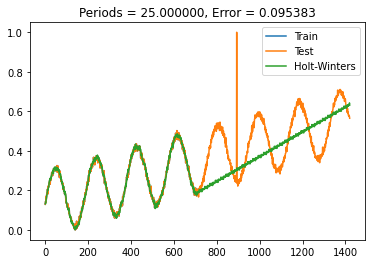


 43%|████▎     | 85/198 [00:12<00:27,  4.07it/s]

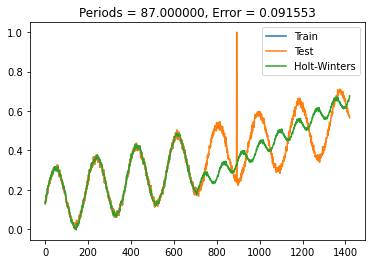


 94%|█████████▍| 186/198 [00:40<00:03,  3.34it/s]

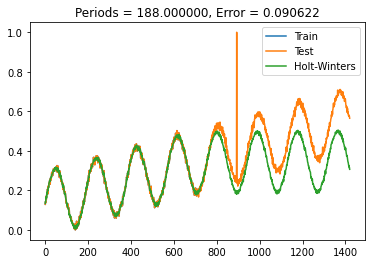


 94%|█████████▍| 187/198 [00:41<00:03,  2.79it/s]

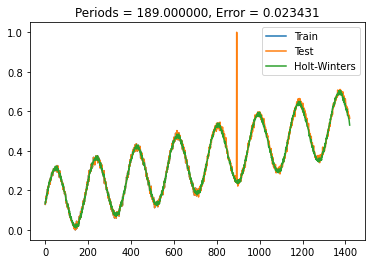


100%|██████████| 198/198 [00:45<00:00,  4.39it/s]


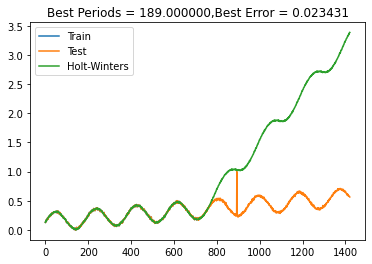

 53%|█████▎    | 53/100 [38:03<36:54, 47.12s/it]




Errors:

Mean Absolute Error: 0.01
Mean Squared Error: 0.389
Root Mean Squared Error: 0.023
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 3.913
Mean forecast error: 0.386
Normalised mean squared error: 0.02
Theil_u_statistic: 0.156



 END Errors

              timestamp        value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  7660.907073  ...         1.0  0.239667

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_11
Mean:[1613.76110655]
StandardDeviation: 1381.9189330538325
Min: -2.100161, Max: 3.767044
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   142.349854           0  -1.064759    0.176473
2014

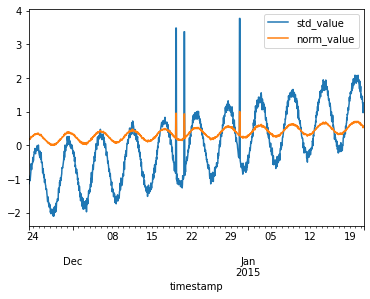


  0%|          | 0/198 [00:00<?, ?it/s]

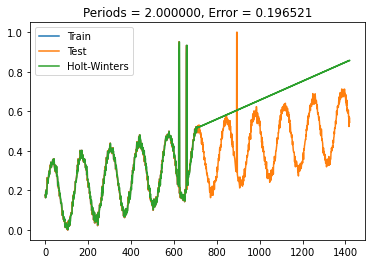


  2%|▏         | 3/198 [00:00<00:35,  5.57it/s]

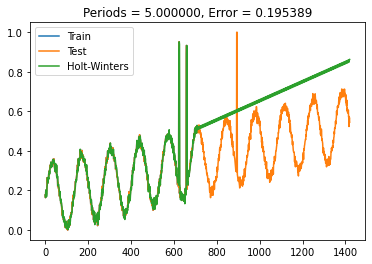


  3%|▎         | 5/198 [00:00<00:34,  5.62it/s]

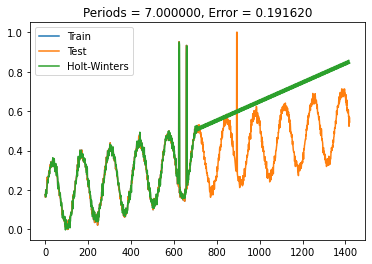


  6%|▌         | 12/198 [00:01<00:23,  7.79it/s]

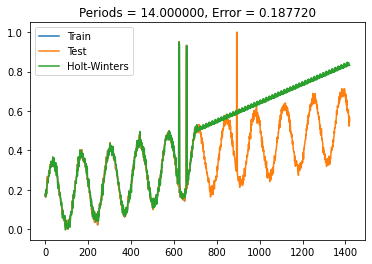


  7%|▋         | 14/198 [00:02<00:30,  6.04it/s]

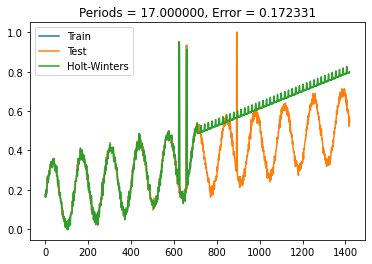


 37%|███▋      | 73/198 [00:09<00:20,  6.09it/s]

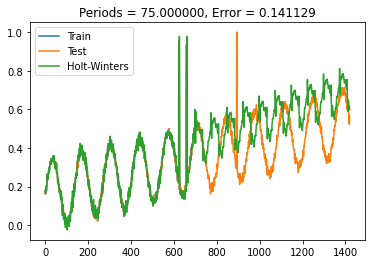


 42%|████▏     | 83/198 [00:11<00:15,  7.54it/s]

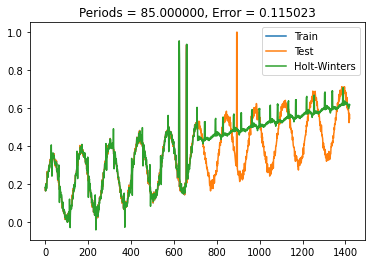


 67%|██████▋   | 132/198 [00:20<00:13,  5.07it/s]

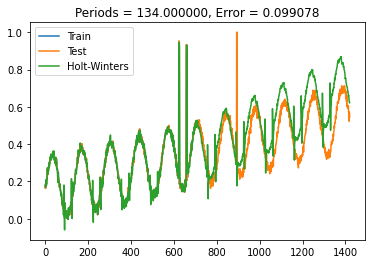


 67%|██████▋   | 133/198 [00:20<00:15,  4.14it/s]

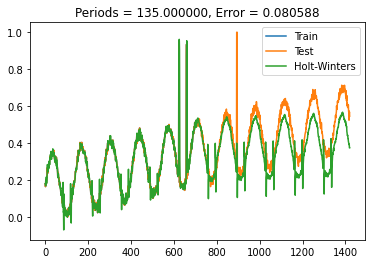


100%|██████████| 198/198 [00:33<00:00,  5.93it/s]


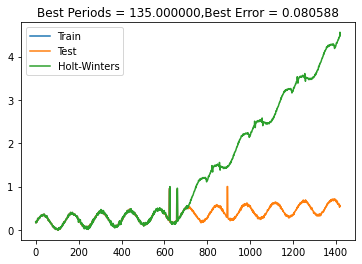

 54%|█████▍    | 54/100 [38:37<33:06, 43.18s/it]




Errors:

Mean Absolute Error: 0.049
Mean Squared Error: 0.396
Root Mean Squared Error: 0.081
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 19.844
Mean forecast error: 0.353
Normalised mean squared error: 0.223
Theil_u_statistic: 0.576



 END Errors

               timestamp        value  ...  norm_value   hw_pred
623  2014-12-19 06:00:00  6424.119302  ...    0.951234  0.260114
658  2014-12-20 17:00:00  6273.705277  ...    0.932683  0.265472
893  2014-12-30 12:00:00  6819.510433  ...    1.000000  0.398582
894  2014-12-30 13:00:00  6819.510433  ...    1.000000  0.316552
895  2014-12-30 14:00:00  6819.510433  ...    1.000000  0.294836
1301 2015-01-16 12:00:00  1768.785686  ...    0.377069  0.122873
1336 2015-01-17 23:00:00  2037.767109  ...    0.410244  0.159073

[7 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 2
Neg:False Negative:4 |True Negative: 1410
Total Positives(Anomalies):9 | T

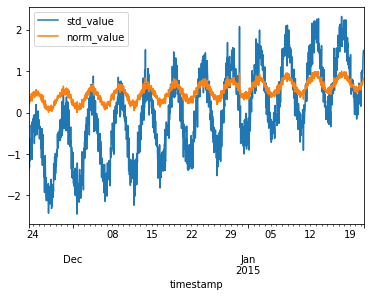


 58%|█████▊    | 114/198 [00:18<00:12,  6.73it/s]

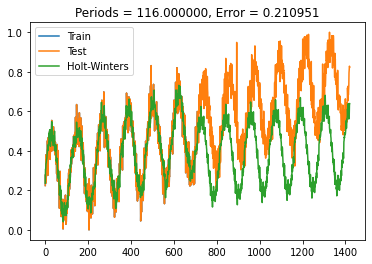


 59%|█████▊    | 116/198 [00:18<00:17,  4.67it/s]

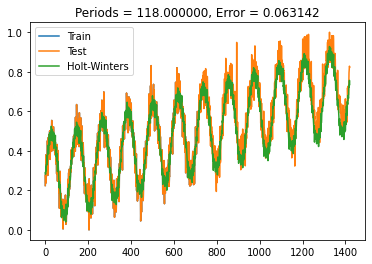


100%|██████████| 198/198 [00:41<00:00,  4.83it/s]


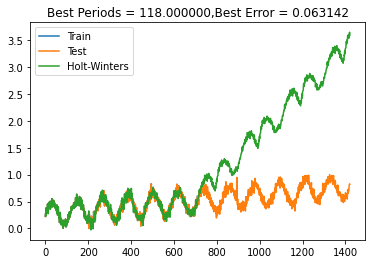

 55%|█████▌    | 55/100 [39:19<32:01, 42.70s/it]




Errors:

Mean Absolute Error: 0.049
Mean Squared Error: 0.555
Root Mean Squared Error: 0.063
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 11.89
Mean forecast error: 0.535
Normalised mean squared error: 0.091
Theil_u_statistic: 0.212



 END Errors

              timestamp        value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  4586.546664  ...    0.948671  0.490281

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_30
Mean:[5950.41735397]
StandardDeviation: 3552.9811324380257
Min: -1.901443, Max: 2.638754
                            value  is_anomaly  std_value  norm_value
timestamp                                                           
2014-11-23 07:00:00   -180.280563           0  -1.725508    0.038750

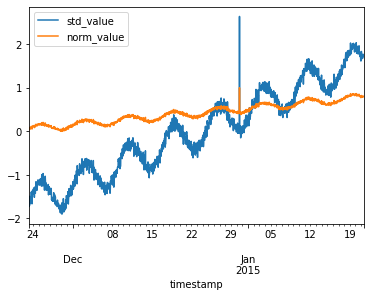


  0%|          | 0/198 [00:00<?, ?it/s]

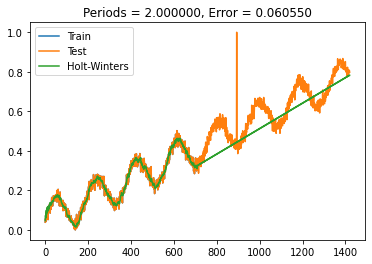


  1%|          | 1/198 [00:00<00:48,  4.08it/s]

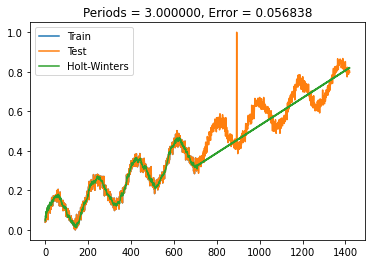


 93%|█████████▎| 185/198 [00:36<00:04,  3.00it/s]

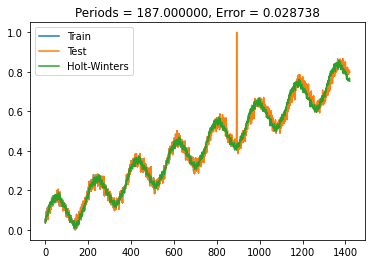


100%|██████████| 198/198 [00:40<00:00,  4.85it/s]


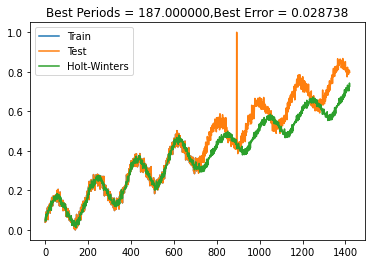

 56%|█████▌    | 56/100 [40:00<31:01, 42.30s/it]




Errors:

Mean Absolute Error: 0.019
Mean Squared Error: 0.473
Root Mean Squared Error: 0.029
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 6.594
Mean forecast error: 0.474
Normalised mean squared error: 0.017
Theil_u_statistic: 0.128



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  15325.861692  ...         1.0  0.418154

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_92
Mean:[2949.87547467]
StandardDeviation: 1884.5765437388068
Min: -2.180257, Max: 2.270360
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   409.526881           0  -1.347968    0.187005


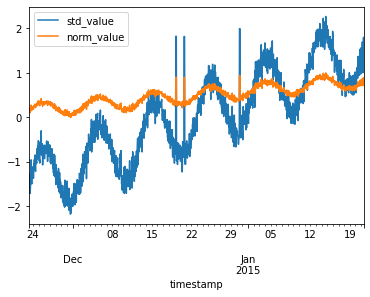


  0%|          | 0/198 [00:00<?, ?it/s]

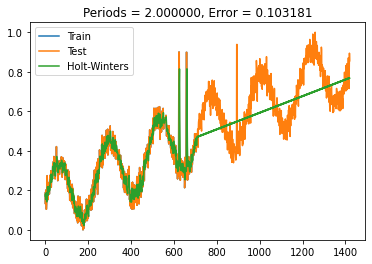


  1%|          | 2/198 [00:00<00:41,  4.74it/s]

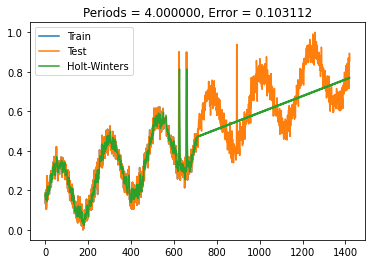


  2%|▏         | 3/198 [00:00<00:48,  4.03it/s]

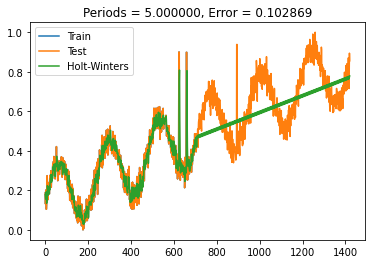


  4%|▎         | 7/198 [00:01<00:30,  6.26it/s]

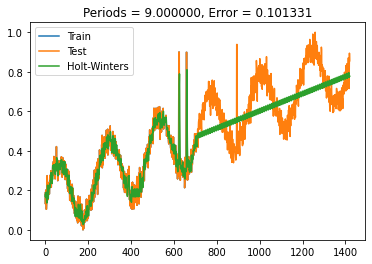


  6%|▌         | 11/198 [00:01<00:26,  6.94it/s]

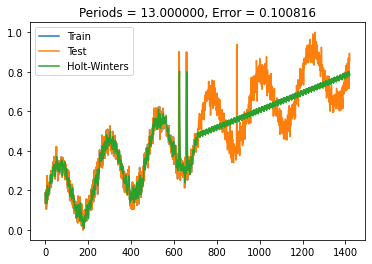


 12%|█▏        | 24/198 [00:03<00:29,  5.82it/s]

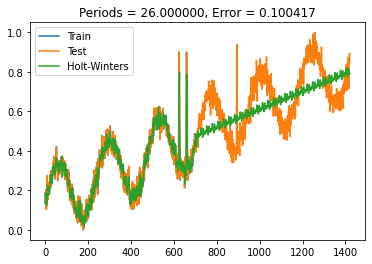


 14%|█▍        | 28/198 [00:04<00:31,  5.36it/s]

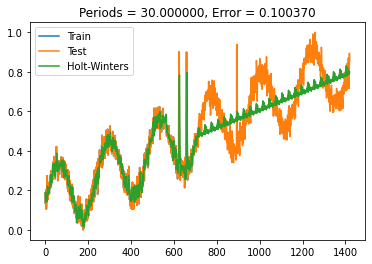


 29%|██▉       | 57/198 [00:11<00:38,  3.71it/s]

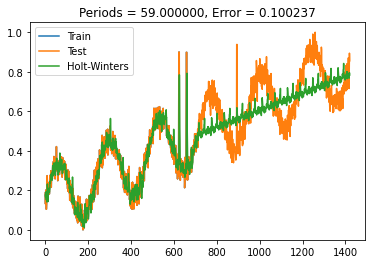


100%|██████████| 198/198 [00:52<00:00,  3.79it/s]


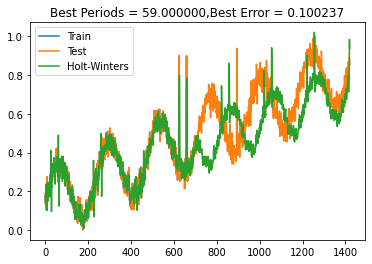

 57%|█████▋    | 57/100 [40:53<32:32, 45.42s/it]




Errors:

Mean Absolute Error: 0.074
Mean Squared Error: 0.539
Root Mean Squared Error: 0.1
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 16.584
Mean forecast error: 0.517
Normalised mean squared error: 0.199
Theil_u_statistic: 0.36



 END Errors

               timestamp        value  ...  norm_value   hw_pred
623  2014-12-19 06:00:00  6387.282481  ...    0.899701  0.353478
624  2014-12-19 07:00:00  6387.282481  ...    0.899701  0.618247
658  2014-12-20 17:00:00  6376.335757  ...    0.898396  0.365478
659  2014-12-20 18:00:00  6376.335757  ...    0.898396  0.605616
765  2014-12-25 04:00:00  5114.065148  ...    0.747902  0.493647
772  2014-12-25 11:00:00  4960.162499  ...    0.729553  0.477671
788  2014-12-26 03:00:00  5169.173022  ...    0.754472  0.502026
893  2014-12-30 12:00:00  6708.892535  ...    0.938045  0.552274
894  2014-12-30 13:00:00  6708.892535  ...    0.938045  0.618044
895  2014-12-30 14:00:00  6708.892535  ...    0.938045  0.601042
985  

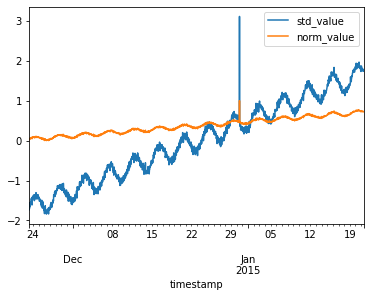


  0%|          | 0/198 [00:00<?, ?it/s]

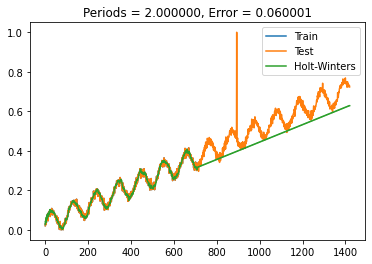


  1%|          | 1/198 [00:00<00:48,  4.09it/s]

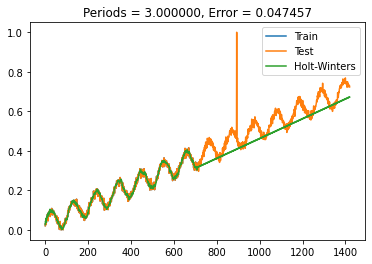


  5%|▌         | 10/198 [00:01<00:23,  8.02it/s]

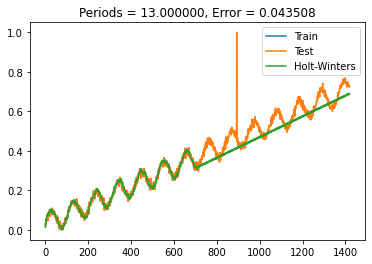


  7%|▋         | 14/198 [00:01<00:23,  7.99it/s]

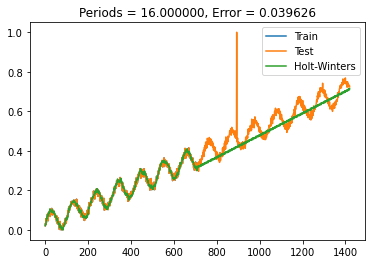


 15%|█▌        | 30/198 [00:04<00:23,  7.04it/s]

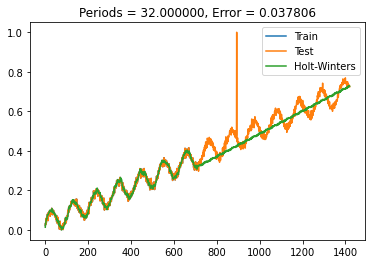


 52%|█████▏    | 102/198 [00:18<00:24,  3.95it/s]

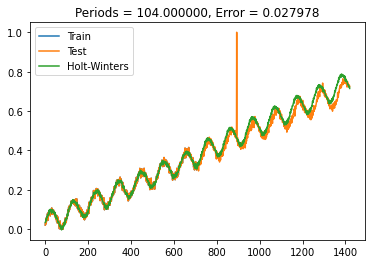


 52%|█████▏    | 103/198 [00:18<00:26,  3.60it/s]

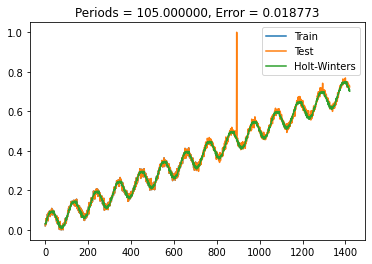


100%|██████████| 198/198 [00:47<00:00,  4.13it/s]


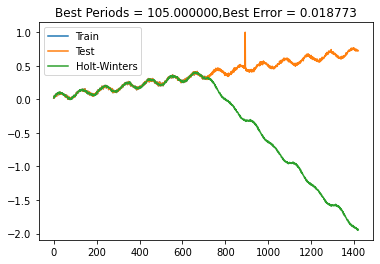

 58%|█████▊    | 58/100 [41:41<32:25, 46.33s/it]




Errors:

Mean Absolute Error: 0.01
Mean Squared Error: 0.423
Root Mean Squared Error: 0.019
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 4.808
Mean forecast error: 0.421
Normalised mean squared error: 0.009
Theil_u_statistic: 0.105



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  26151.794914  ...         1.0  0.451753

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_75
Mean:[556.16829858]
StandardDeviation: 1032.2504319860586
Min: -2.055898, Max: 2.720477
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   -93.812494           0  -0.629674    0.298600
20

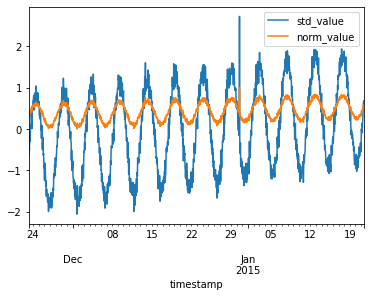


 49%|████▉     | 98/198 [00:16<00:22,  4.43it/s]

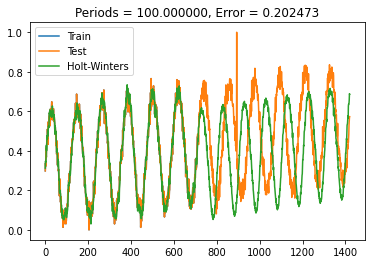


 59%|█████▊    | 116/198 [00:20<00:16,  4.87it/s]

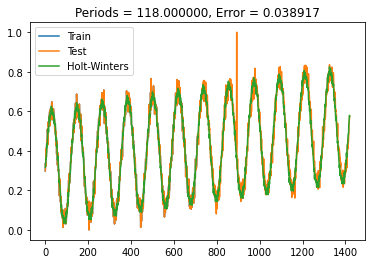


100%|██████████| 198/198 [00:43<00:00,  4.59it/s]


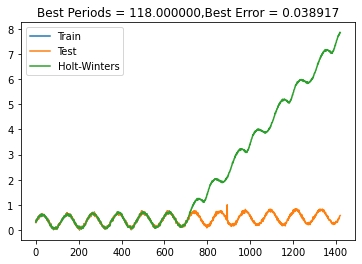

 59%|█████▉    | 59/100 [42:25<31:06, 45.53s/it]




Errors:

Mean Absolute Error: 0.028
Mean Squared Error: 0.479
Root Mean Squared Error: 0.039
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 9.133
Mean forecast error: 0.476
Normalised mean squared error: 0.035
Theil_u_statistic: 0.171



 END Errors

              timestamp        value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  3364.381794  ...         1.0  0.352628

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_27
Mean:[2841.95772542]
StandardDeviation: 1929.9041477073604
Min: -2.218414, Max: 5.229278
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00  -165.822369           0  -1.558513    0.088605
20

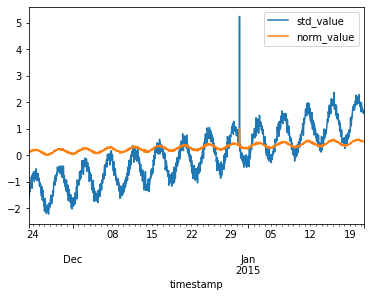


  0%|          | 0/198 [00:00<?, ?it/s]

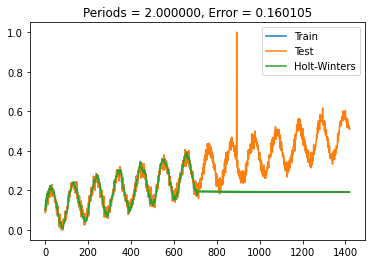


  1%|          | 1/198 [00:00<00:46,  4.20it/s]

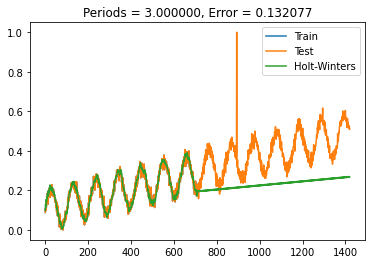


  5%|▌         | 10/198 [00:01<00:23,  8.17it/s]

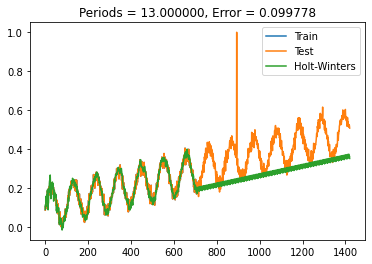


  7%|▋         | 14/198 [00:01<00:22,  8.31it/s]

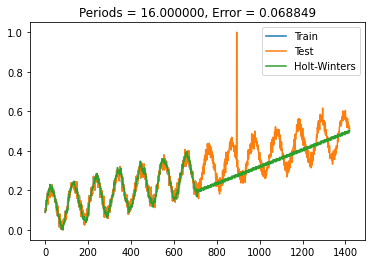


  8%|▊         | 16/198 [00:02<00:28,  6.41it/s]

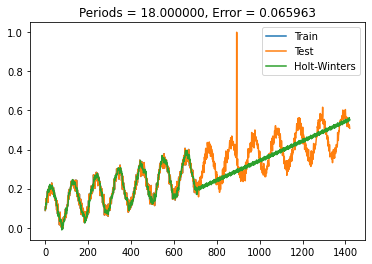


 29%|██▉       | 57/198 [00:08<00:27,  5.19it/s]

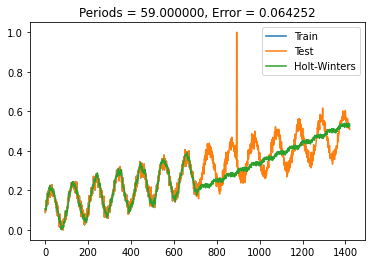


 52%|█████▏    | 103/198 [00:17<00:16,  5.71it/s]

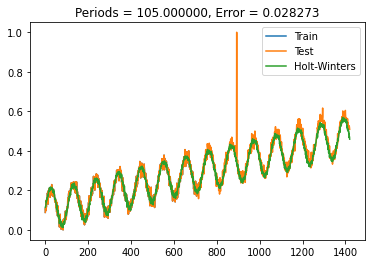


100%|██████████| 198/198 [00:45<00:00,  4.40it/s]


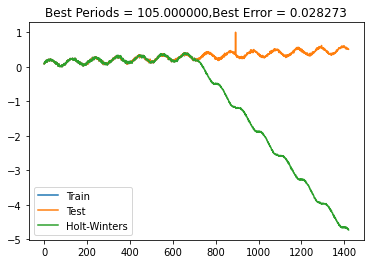

 60%|██████    | 60/100 [43:10<30:22, 45.56s/it]




Errors:

Mean Absolute Error: 0.018
Mean Squared Error: 0.327
Root Mean Squared Error: 0.028
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.924
Mean forecast error: 0.319
Normalised mean squared error: 0.044
Theil_u_statistic: 0.271



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  12933.963939  ...         1.0  0.331529

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_78
Mean:[691.8747402]
StandardDeviation: 1044.7586740467866
Min: -2.070495, Max: 2.249834
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00  -112.413242           0  -0.769831    0.301057
20

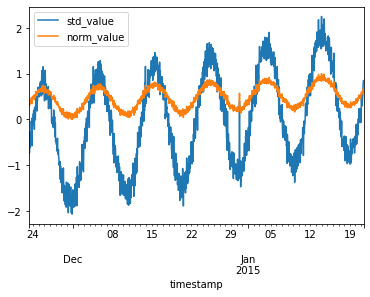


 26%|██▋       | 52/198 [00:06<00:23,  6.09it/s]

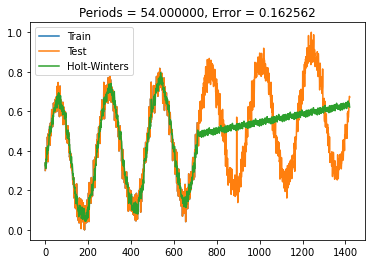


100%|██████████| 198/198 [00:45<00:00,  4.38it/s]


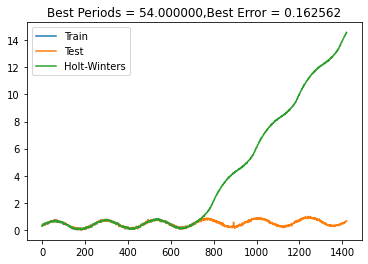

 61%|██████    | 61/100 [43:56<29:39, 45.62s/it]




Errors:

Mean Absolute Error: 0.12
Mean Squared Error: 0.532
Root Mean Squared Error: 0.163
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 26.78
Mean forecast error: 0.51
Normalised mean squared error: 0.493
Theil_u_statistic: 0.598



 END Errors

               timestamp        value  ...  norm_value   hw_pred
738  2014-12-24 01:00:00  1884.192117  ...    0.743400  0.471376
742  2014-12-24 05:00:00  2007.915196  ...    0.770811  0.480959
743  2014-12-24 06:00:00  1925.911155  ...    0.752643  0.494192
746  2014-12-24 09:00:00  2058.789479  ...    0.782082  0.476200
748  2014-12-24 11:00:00  2241.018134  ...    0.822454  0.480688
...                  ...          ...  ...         ...       ...
1269 2015-01-15 04:00:00  2598.226812  ...    0.901593  0.581736
1270 2015-01-15 05:00:00  2462.146964  ...    0.871445  0.603694
1271 2015-01-15 06:00:00  2384.207697  ...    0.854177  0.602891
1272 2015-01-15 07:00:00  2540.877259  ...    0.888887  0.616469
1274 

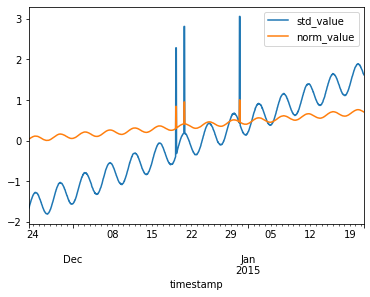


  0%|          | 0/198 [00:00<?, ?it/s]

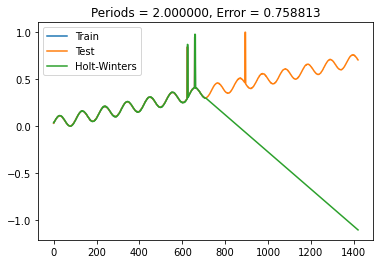


  1%|          | 1/198 [00:00<00:48,  4.07it/s]

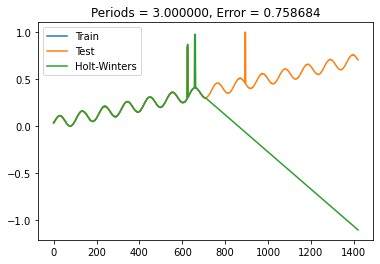


  1%|          | 2/198 [00:00<00:48,  4.08it/s]

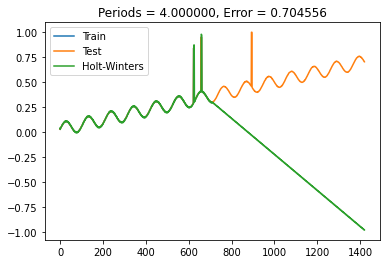


  2%|▏         | 3/198 [00:00<00:48,  4.03it/s]

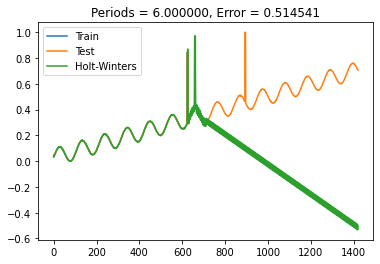


  3%|▎         | 5/198 [00:01<00:43,  4.43it/s]

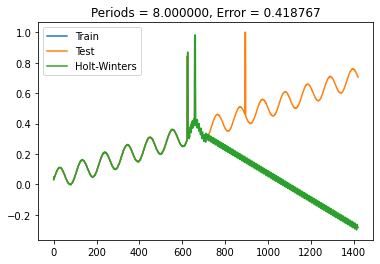


  7%|▋         | 13/198 [00:02<00:23,  8.04it/s]

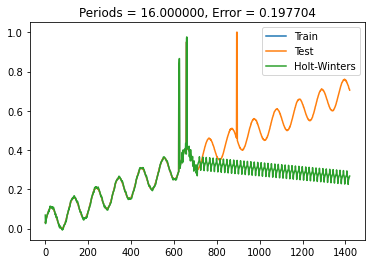


 15%|█▌        | 30/198 [00:03<00:16,  9.89it/s]

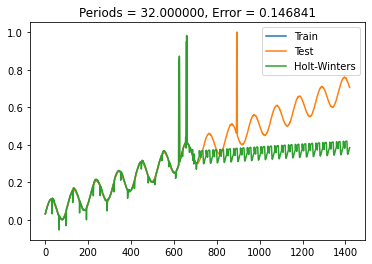


 16%|█▌        | 32/198 [00:04<00:20,  8.19it/s]

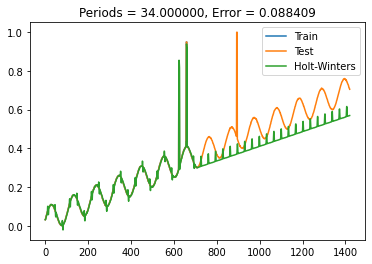


 18%|█▊        | 35/198 [00:04<00:25,  6.38it/s]

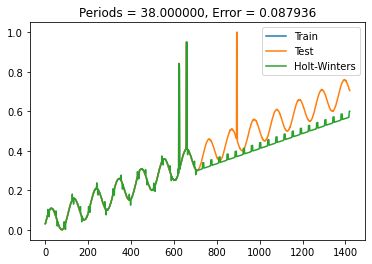


 23%|██▎       | 45/198 [00:05<00:16,  9.10it/s]

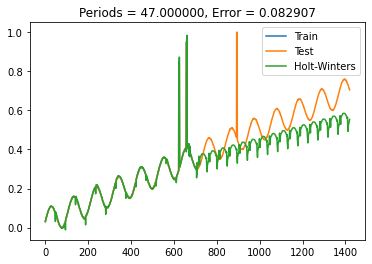


 27%|██▋       | 53/198 [00:07<00:26,  5.52it/s]

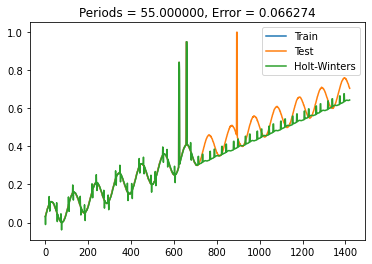


100%|██████████| 198/198 [00:35<00:00,  5.63it/s]


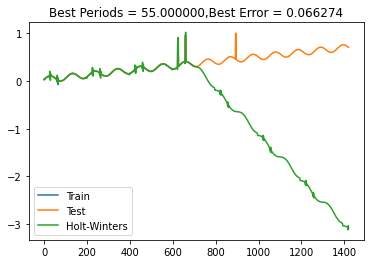

 62%|██████▏   | 62/100 [44:32<27:01, 42.66s/it]




Errors:

Mean Absolute Error: 0.036
Mean Squared Error: 0.425
Root Mean Squared Error: 0.066
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 9.446
Mean forecast error: 0.385
Normalised mean squared error: 0.104
Theil_u_statistic: 0.404



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  17152.953898  ...    0.841128  0.333681
658 2014-12-20 17:00:00  19441.549373  ...    0.949397  0.453547
893 2014-12-30 12:00:00  20511.199658  ...    1.000000  0.391749
894 2014-12-30 13:00:00  20511.199658  ...    1.000000  0.392031
895 2014-12-30 14:00:00  20511.199658  ...    1.000000  0.393588

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_93
Mea

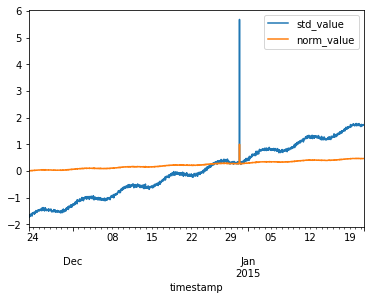


  0%|          | 0/198 [00:00<?, ?it/s]

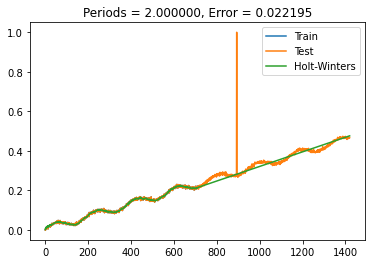


 73%|███████▎  | 144/198 [00:34<00:16,  3.31it/s]

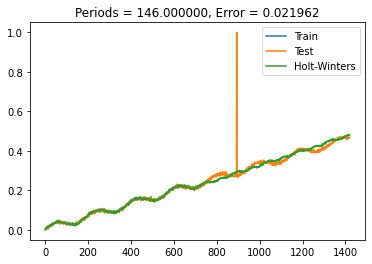


 90%|█████████ | 179/198 [00:45<00:06,  3.15it/s]

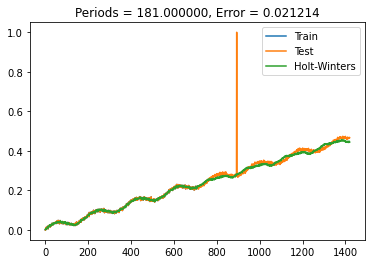


 93%|█████████▎| 184/198 [00:47<00:04,  2.97it/s]

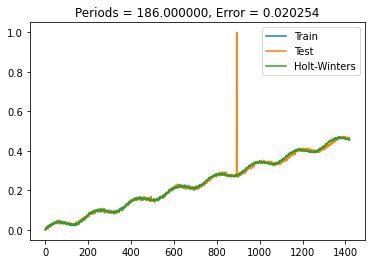


 95%|█████████▍| 188/198 [00:48<00:03,  2.83it/s]

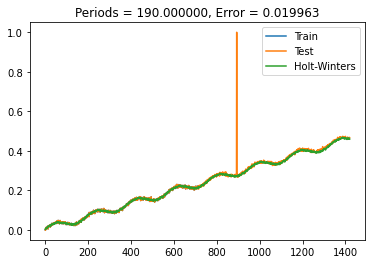


100%|██████████| 198/198 [00:52<00:00,  3.77it/s]


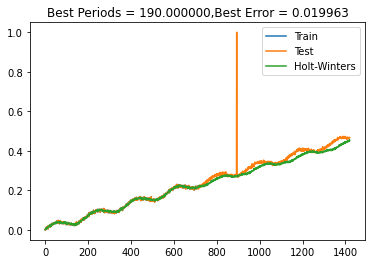

 63%|██████▎   | 63/100 [45:25<28:13, 45.76s/it]




Errors:

Mean Absolute Error: 0.004
Mean Squared Error: 0.27
Root Mean Squared Error: 0.02
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 3.136
Mean forecast error: 0.267
Normalised mean squared error: 0.022
Theil_u_statistic: 0.277



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  78542.938225  ...         1.0  0.269077

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_99
Mean:[1899.80611625]
StandardDeviation: 1455.9747881970354
Min: -2.312383, Max: 3.802306
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00  -242.270446           0  -1.471232    0.137562
20

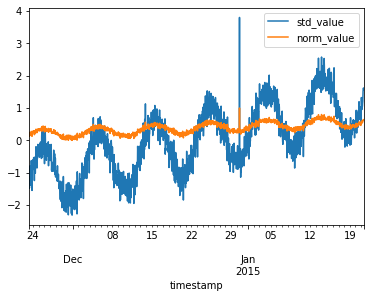


 31%|███▏      | 62/198 [00:08<00:29,  4.65it/s]

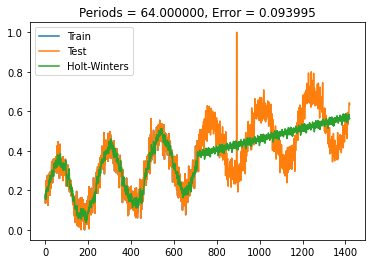


100%|██████████| 198/198 [00:44<00:00,  4.41it/s]


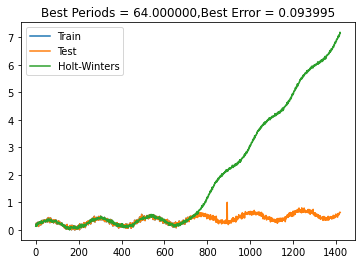

 64%|██████▍   | 64/100 [46:10<27:24, 45.67s/it]




Errors:

Mean Absolute Error: 0.073
Mean Squared Error: 0.412
Root Mean Squared Error: 0.094
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 20.992
Mean forecast error: 0.398
Normalised mean squared error: 0.33
Theil_u_statistic: 0.574



 END Errors

               timestamp        value  ...  norm_value   hw_pred
756  2014-12-24 19:00:00  4129.137401  ...    0.628576  0.377926
893  2014-12-30 12:00:00  7435.867212  ...    1.000000  0.423653
1228 2015-01-13 11:00:00  5601.770784  ...    0.793987  0.510667
1241 2015-01-14 00:00:00  5653.464353  ...    0.799794  0.518004
1252 2015-01-14 11:00:00  5588.713921  ...    0.792521  0.518258

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 4
Neg:False Negative:0 |True Negative: 1416
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 0.2, Recall: 1.0, F1: 0.33333333333333337
synthetic_94
Mean:[3183.865171

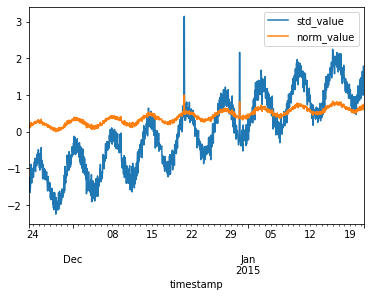


 18%|█▊        | 35/198 [00:03<00:17,  9.19it/s]

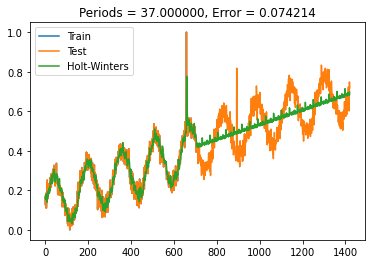


 23%|██▎       | 45/198 [00:05<00:30,  4.95it/s]

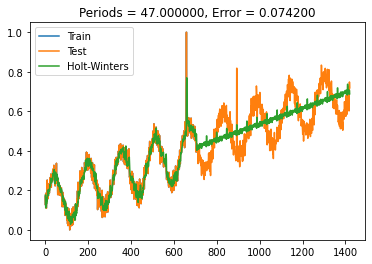


 25%|██▍       | 49/198 [00:06<00:35,  4.16it/s]

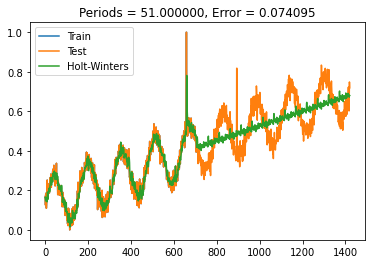


 77%|███████▋  | 152/198 [00:27<00:13,  3.40it/s]

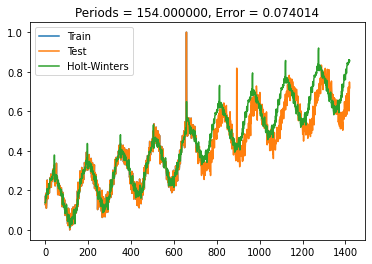


 77%|███████▋  | 153/198 [00:28<00:15,  2.91it/s]

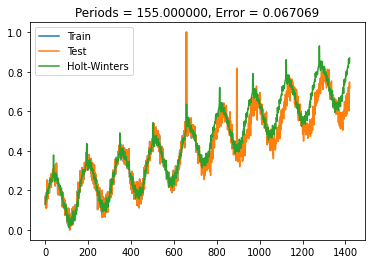


 78%|███████▊  | 154/198 [00:28<00:16,  2.64it/s]

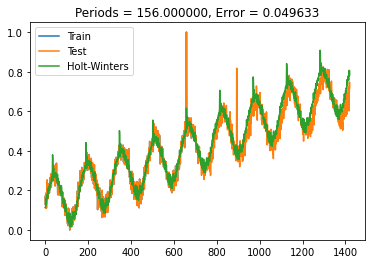


 79%|███████▉  | 156/198 [00:29<00:15,  2.69it/s]

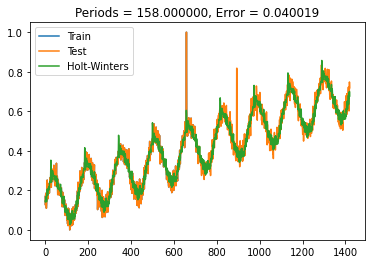


100%|██████████| 198/198 [00:43<00:00,  4.57it/s]


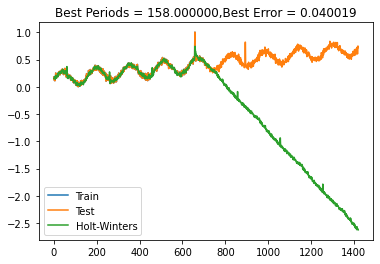

 65%|██████▌   | 65/100 [46:54<26:19, 45.12s/it]




Errors:

Mean Absolute Error: 0.027
Mean Squared Error: 0.456
Root Mean Squared Error: 0.04
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.441
Mean forecast error: 0.453
Normalised mean squared error: 0.047
Theil_u_statistic: 0.193



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  9641.220814  ...    1.000000  0.604918
659 2014-12-20 18:00:00  9641.220814  ...    1.000000  0.586442
893 2014-12-30 12:00:00  7622.747082  ...    0.817816  0.418134
894 2014-12-30 13:00:00  7622.747082  ...    0.817816  0.369606

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_7
Mean:[2534.13140448]
StandardDeviation: 1760.471141156909
Min: -1.871038, Max: 5.056955
                 

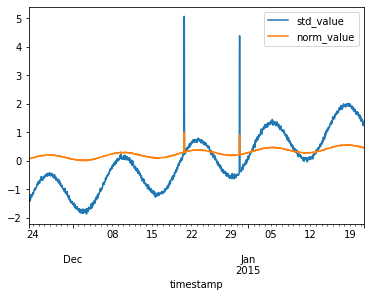


  0%|          | 0/198 [00:00<?, ?it/s]

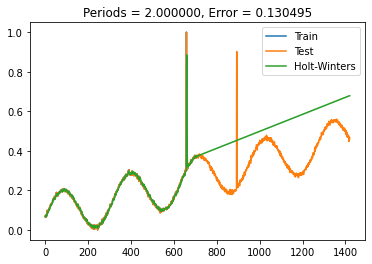


  1%|          | 1/198 [00:00<00:49,  3.96it/s]

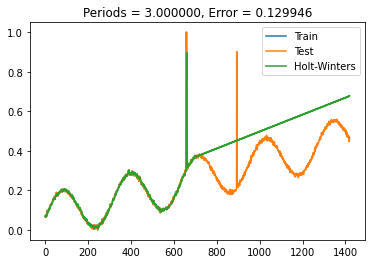


  2%|▏         | 3/198 [00:00<00:40,  4.77it/s]

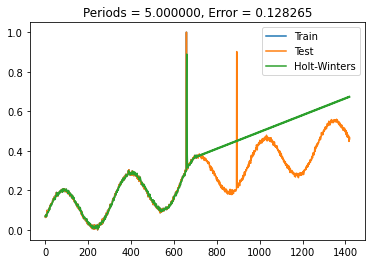


  4%|▍         | 8/198 [00:01<00:27,  6.93it/s]

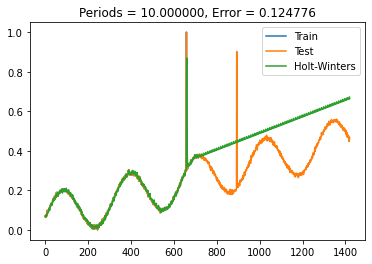


  7%|▋         | 14/198 [00:02<00:24,  7.47it/s]

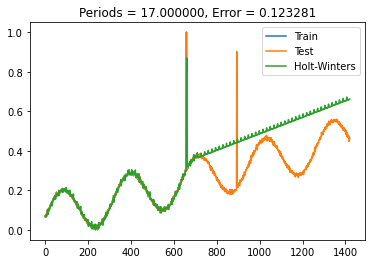


 12%|█▏        | 23/198 [00:03<00:31,  5.62it/s]

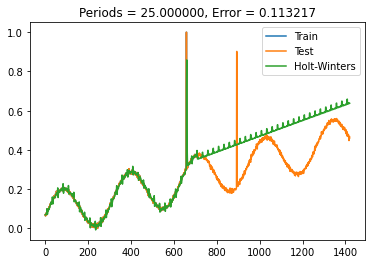


 20%|█▉        | 39/198 [00:07<00:42,  3.75it/s]

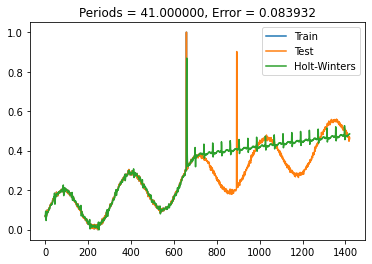


 36%|███▌      | 71/198 [00:13<00:19,  6.68it/s]

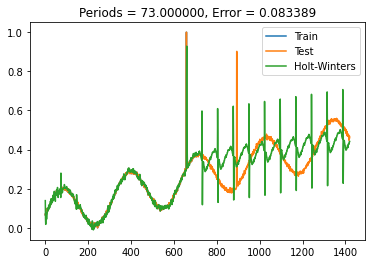


 51%|█████     | 101/198 [00:17<00:09, 10.10it/s]

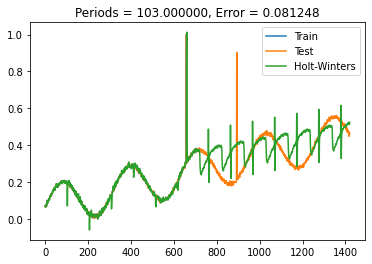


100%|██████████| 198/198 [00:36<00:00,  5.37it/s]


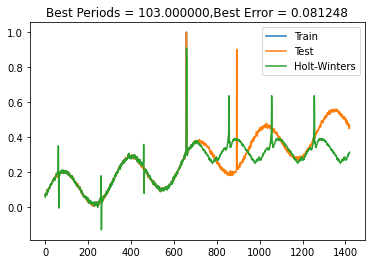

 66%|██████▌   | 66/100 [47:32<24:16, 42.82s/it]




Errors:

Mean Absolute Error: 0.046
Mean Squared Error: 0.306
Root Mean Squared Error: 0.081
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 17.301
Mean forecast error: 0.322
Normalised mean squared error: 0.317
Theil_u_statistic: 0.825



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  11436.755332  ...    1.000000  0.307319
893 2014-12-30 12:00:00  10240.079234  ...    0.901884  0.405899
894 2014-12-30 13:00:00  10240.079234  ...    0.901884  0.408444

[3 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:3 | False Positive: 0
Neg:False Negative:1 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 0.75, F1: 0.8571428571428571
synthetic_51
Mean:[9558.24933317]
StandardDeviation: 5634.500669729333
Min: -1.784094, Max: 5.482078
                            value  is_anomaly  std_value  

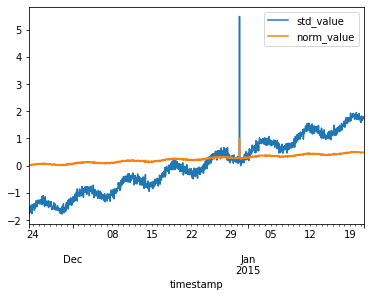


  0%|          | 0/198 [00:00<?, ?it/s]

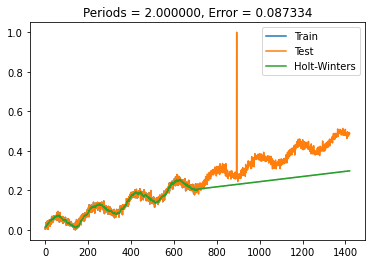


  1%|          | 1/198 [00:00<01:04,  3.06it/s]

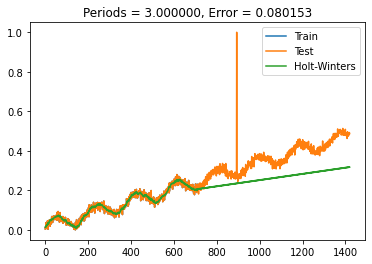


  6%|▌         | 11/198 [00:01<00:23,  7.93it/s]

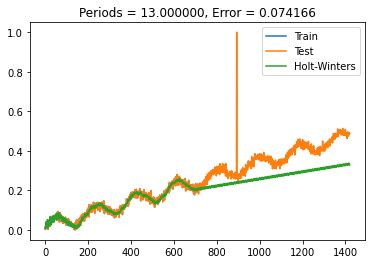


  6%|▌         | 12/198 [00:01<00:30,  6.09it/s]

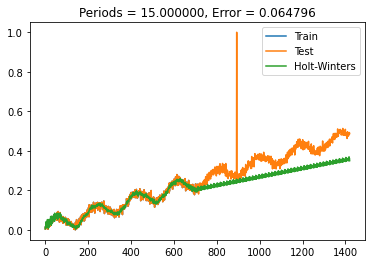


 10%|█         | 20/198 [00:02<00:20,  8.79it/s]

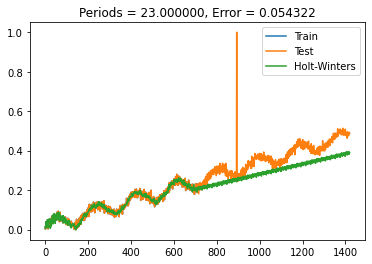


 14%|█▍        | 28/198 [00:03<00:17,  9.67it/s]

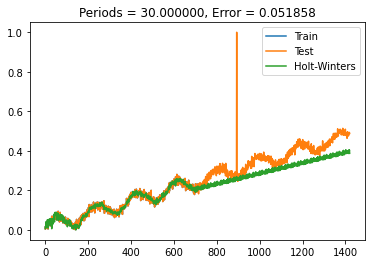


 15%|█▌        | 30/198 [00:03<00:21,  7.97it/s]

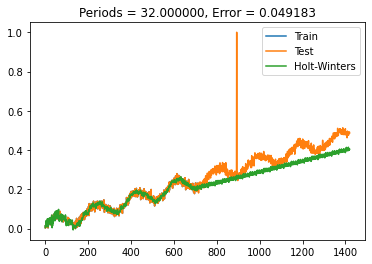


 17%|█▋        | 33/198 [00:04<00:23,  7.14it/s]

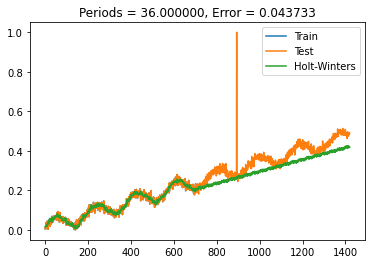


 18%|█▊        | 35/198 [00:04<00:24,  6.55it/s]

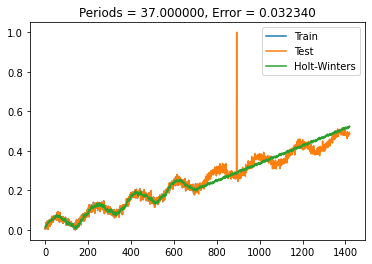


 20%|██        | 40/198 [00:05<00:28,  5.52it/s]

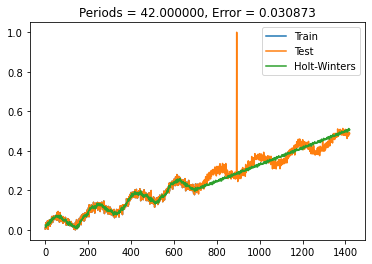


 71%|███████   | 140/198 [00:29<00:16,  3.42it/s]

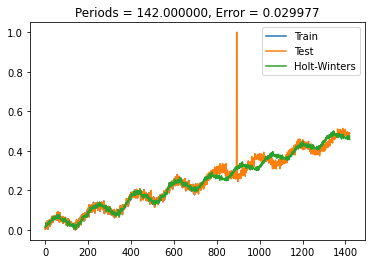


 92%|█████████▏| 182/198 [00:42<00:04,  3.23it/s]

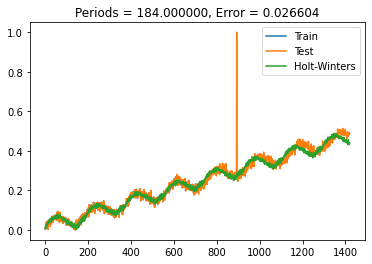


 92%|█████████▏| 183/198 [00:43<00:05,  2.77it/s]

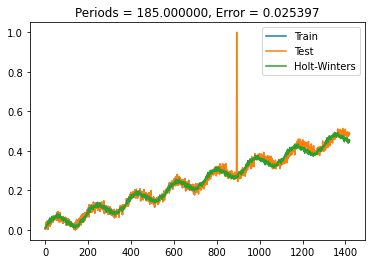


 93%|█████████▎| 185/198 [00:44<00:04,  2.69it/s]

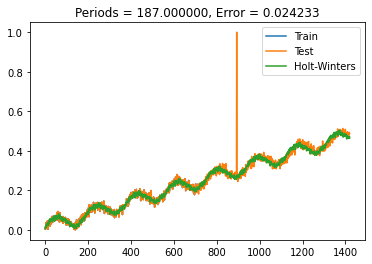


100%|██████████| 198/198 [00:48<00:00,  4.11it/s]


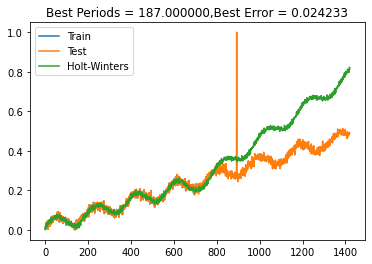

 67%|██████▋   | 67/100 [48:21<24:32, 44.62s/it]




Errors:

Mean Absolute Error: 0.012
Mean Squared Error: 0.281
Root Mean Squared Error: 0.024
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.63
Mean forecast error: 0.281
Normalised mean squared error: 0.031
Theil_u_statistic: 0.307



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  40447.022399  ...         1.0  0.265556

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_77
Mean:[26401.05495432]
StandardDeviation: 16295.078569701926
Min: -1.617448, Max: 5.363630
                            value  is_anomaly  std_value  norm_value
timestamp                                                           
2014-11-23 07:00:00    252.227264           0  -1.604707    0.0018

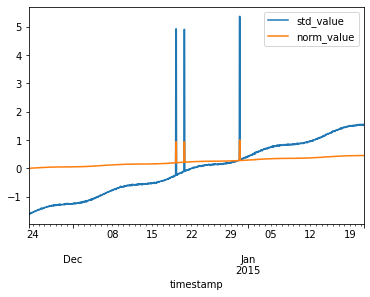


  0%|          | 0/198 [00:00<?, ?it/s]

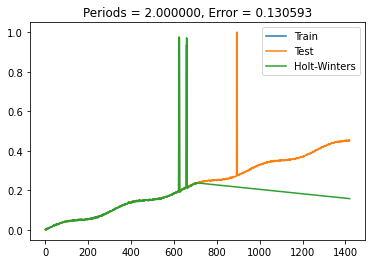


  1%|          | 1/198 [00:00<00:46,  4.24it/s]

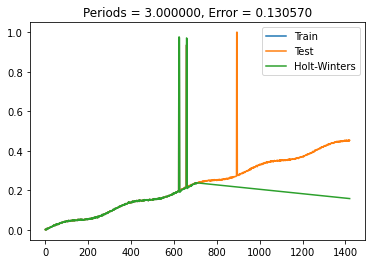


  1%|          | 2/198 [00:00<00:47,  4.16it/s]

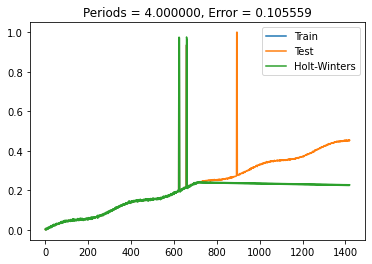


  3%|▎         | 5/198 [00:00<00:32,  5.89it/s]

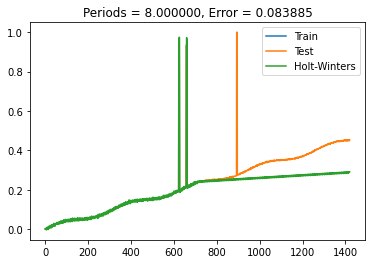


  6%|▌         | 11/198 [00:01<00:24,  7.63it/s]

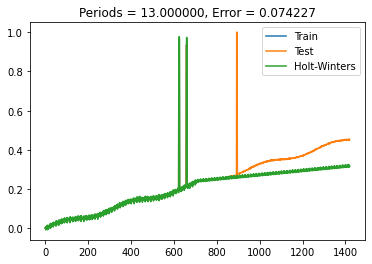


  7%|▋         | 14/198 [00:02<00:24,  7.43it/s]

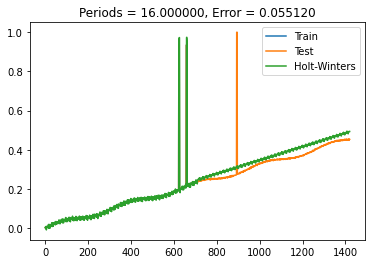


 11%|█         | 22/198 [00:03<00:19,  9.04it/s]

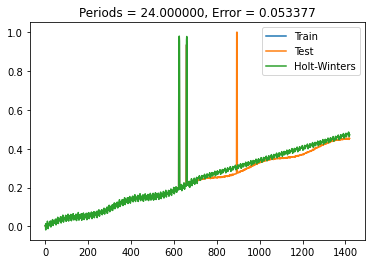


 15%|█▌        | 30/198 [00:04<00:18,  8.88it/s]

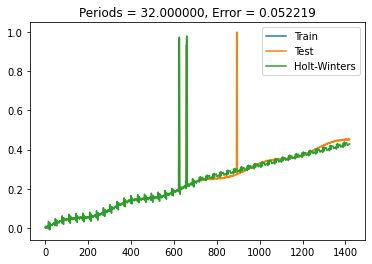


 38%|███▊      | 75/198 [00:09<00:17,  6.87it/s]

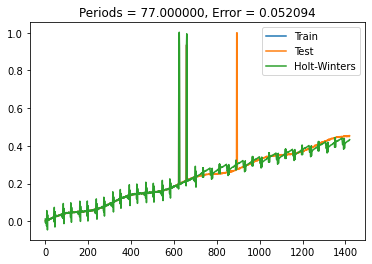


100%|██████████| 198/198 [00:33<00:00,  5.89it/s]


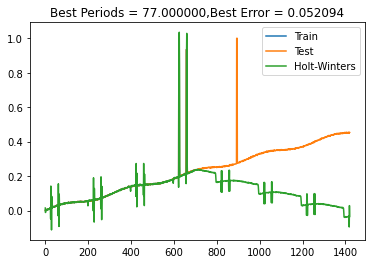

 68%|██████▊   | 68/100 [48:55<22:06, 41.47s/it]




Errors:

Mean Absolute Error: 0.016
Mean Squared Error: 0.272
Root Mean Squared Error: 0.052
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.231
Mean forecast error: 0.268
Normalised mean squared error: 0.132
Theil_u_statistic: 0.713



 END Errors

              timestamp          value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  106623.213170  ...    0.936895  0.251448
658 2014-12-20 17:00:00  106317.137007  ...    0.934205  0.266351
893 2014-12-30 12:00:00  113801.826347  ...    1.000000  0.300720
894 2014-12-30 13:00:00  113801.826347  ...    1.000000  0.302565
895 2014-12-30 14:00:00  113801.826347  ...    1.000000  0.303705

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic

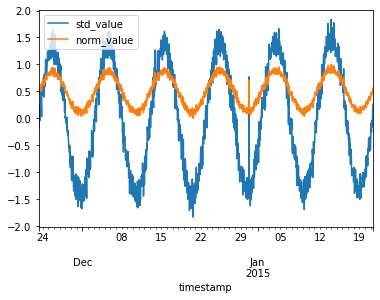


 47%|████▋     | 93/198 [00:15<00:24,  4.25it/s]

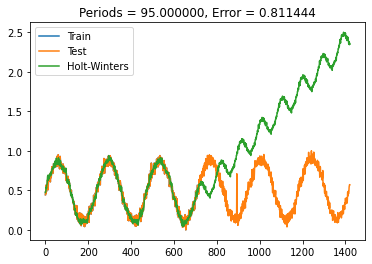


 67%|██████▋   | 133/198 [00:26<00:17,  3.74it/s]

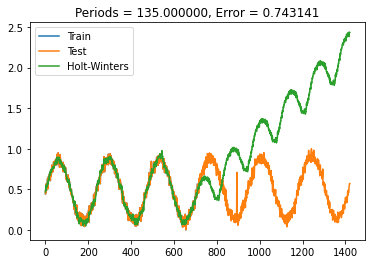


 68%|██████▊   | 134/198 [00:26<00:20,  3.10it/s]

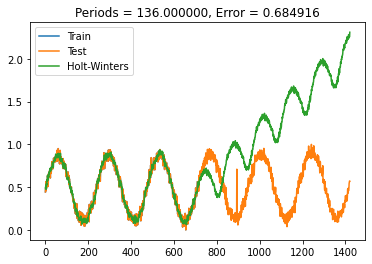


 68%|██████▊   | 135/198 [00:26<00:22,  2.80it/s]

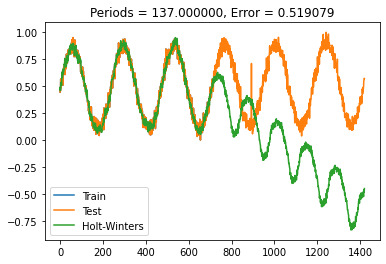


 69%|██████▊   | 136/198 [00:27<00:23,  2.69it/s]

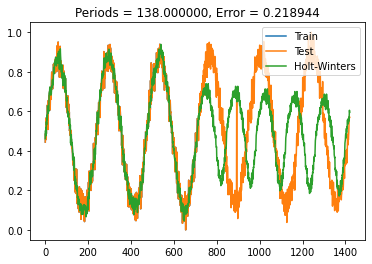


100%|██████████| 198/198 [00:46<00:00,  4.30it/s]


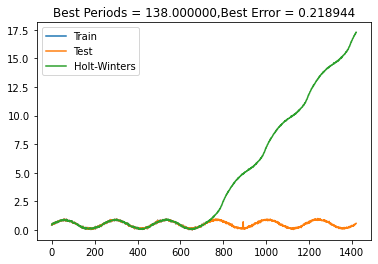

 69%|██████▉   | 69/100 [49:41<22:13, 43.02s/it]




Errors:

Mean Absolute Error: 0.143
Mean Squared Error: 0.569
Root Mean Squared Error: 0.219
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 33.155
Mean forecast error: 0.537
Normalised mean squared error: 0.645
Theil_u_statistic: 0.716



 END Errors

               timestamp        value  ...  norm_value   hw_pred
756  2014-12-24 19:00:00  1738.957072  ...    0.941640  0.661250
765  2014-12-25 04:00:00  1766.859143  ...    0.949208  0.670335
772  2014-12-25 11:00:00  1657.199798  ...    0.919464  0.605527
773  2014-12-25 12:00:00  1727.755613  ...    0.938602  0.607318
774  2014-12-25 13:00:00  1500.233901  ...    0.876890  0.613253
...                  ...          ...  ...         ...       ...
1269 2015-01-15 04:00:00  1510.257151  ...    0.879609  0.535576
1270 2015-01-15 05:00:00  1392.027846  ...    0.847541  0.529668
1271 2015-01-15 06:00:00  1322.180704  ...    0.828596  0.551653
1272 2015-01-15 07:00:00  1447.938029  ...    0.862706  0.570028
12

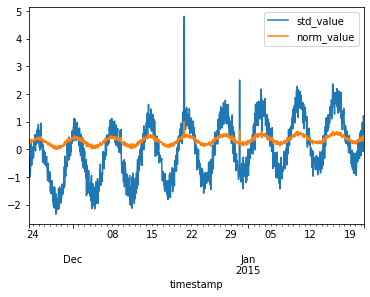


 19%|█▊        | 37/198 [00:03<00:17,  9.34it/s]

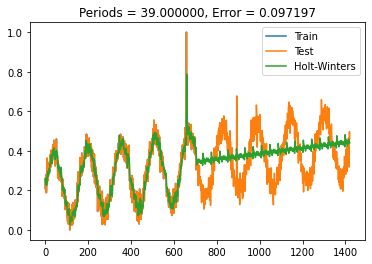


 22%|██▏       | 43/198 [00:04<00:22,  6.86it/s]

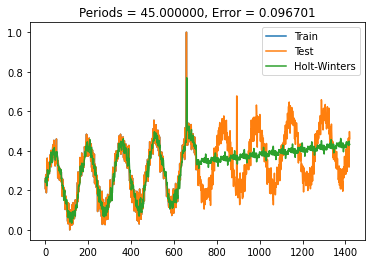


 22%|██▏       | 44/198 [00:05<00:32,  4.70it/s]

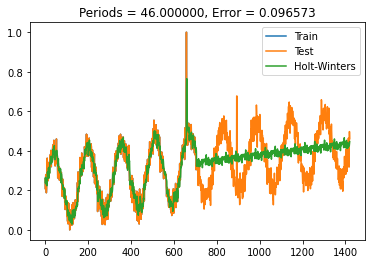


 23%|██▎       | 46/198 [00:05<00:34,  4.44it/s]

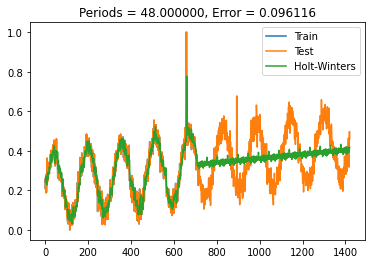


 26%|██▌       | 51/198 [00:06<00:30,  4.88it/s]

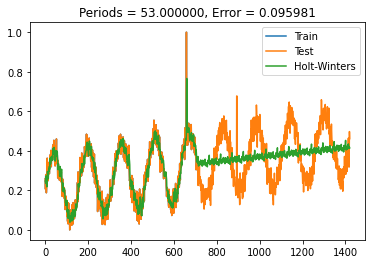


 77%|███████▋  | 152/198 [00:25<00:13,  3.43it/s]

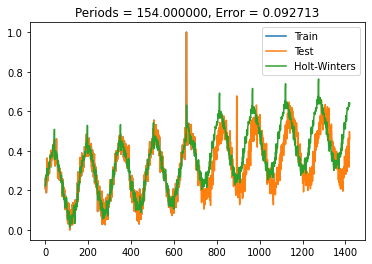


 77%|███████▋  | 153/198 [00:25<00:15,  2.96it/s]

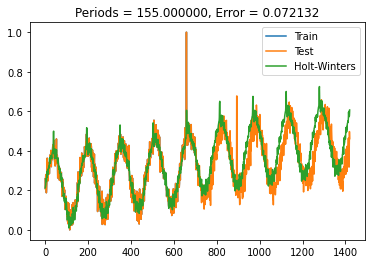


 78%|███████▊  | 154/198 [00:26<00:16,  2.67it/s]

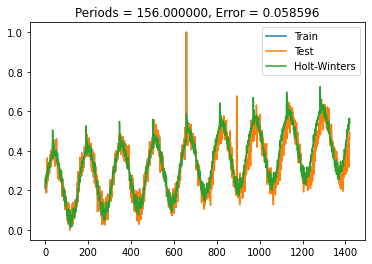


 79%|███████▉  | 157/198 [00:26<00:10,  3.93it/s]

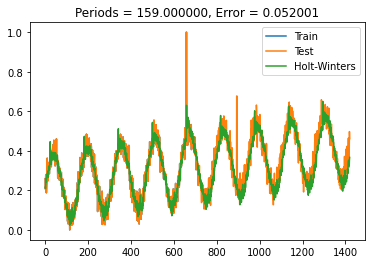


100%|██████████| 198/198 [00:40<00:00,  4.90it/s]


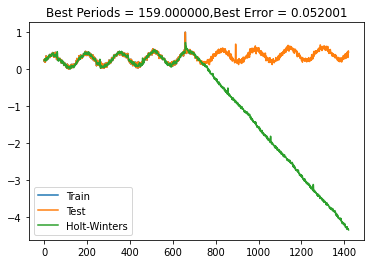

 70%|███████   | 70/100 [50:22<21:11, 42.39s/it]




Errors:

Mean Absolute Error: 0.037
Mean Squared Error: 0.356
Root Mean Squared Error: 0.052
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 13.843
Mean forecast error: 0.344
Normalised mean squared error: 0.138
Theil_u_statistic: 0.425



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  6519.797396  ...    1.000000  0.576212
659 2014-12-20 18:00:00  6519.797396  ...    1.000000  0.630486
893 2014-12-30 12:00:00  3853.824702  ...    0.677513  0.225886
894 2014-12-30 13:00:00  3853.824702  ...    0.677513  0.206187

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_53
Mean:[5334.90187195]
StandardDeviation: 3432.132309065392
Min: -1.923329, Max: 4.886633
              

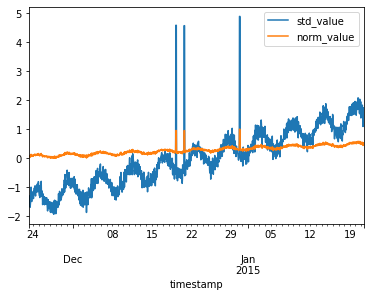


  0%|          | 0/198 [00:00<?, ?it/s]

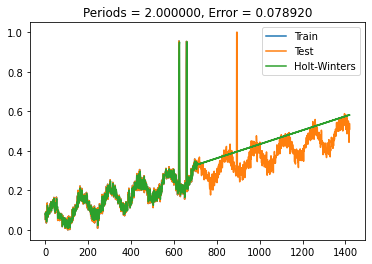


  2%|▏         | 3/198 [00:00<00:35,  5.46it/s]

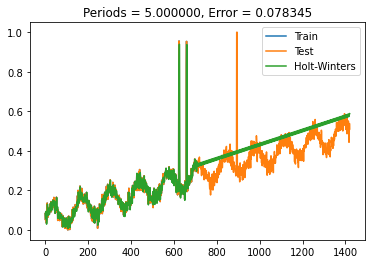


  3%|▎         | 5/198 [00:00<00:36,  5.22it/s]

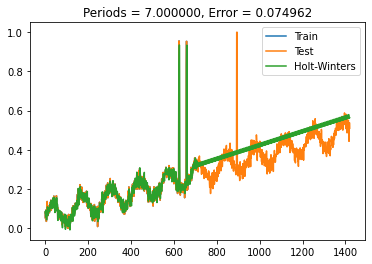


  6%|▌         | 12/198 [00:01<00:23,  7.83it/s]

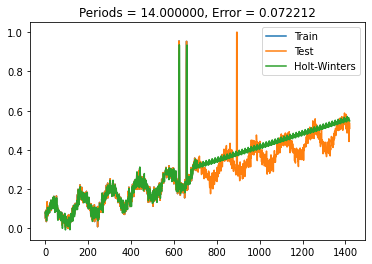


  8%|▊         | 15/198 [00:02<00:26,  6.78it/s]

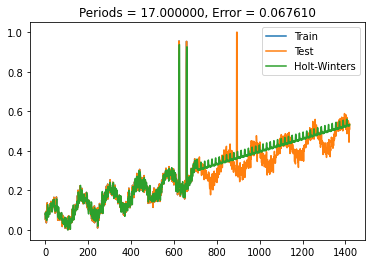


 13%|█▎        | 26/198 [00:04<00:25,  6.63it/s]

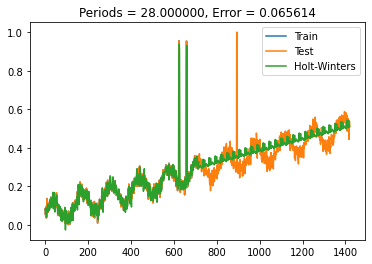


 20%|██        | 40/198 [00:06<00:32,  4.80it/s]

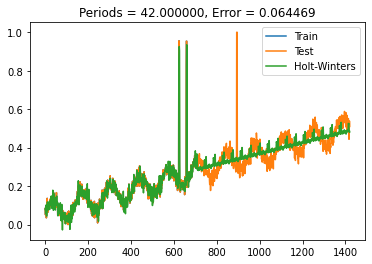


 25%|██▍       | 49/198 [00:09<00:35,  4.17it/s]

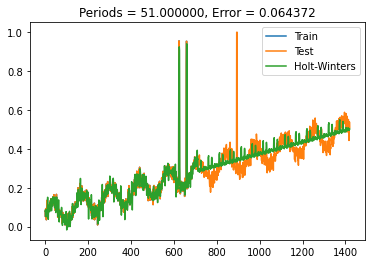


 68%|██████▊   | 134/198 [00:30<00:13,  4.78it/s]

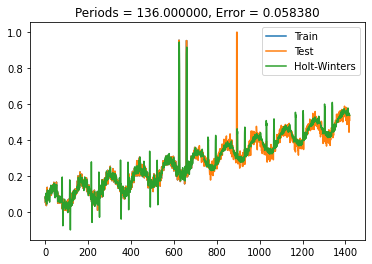


100%|██████████| 198/198 [00:44<00:00,  4.40it/s]


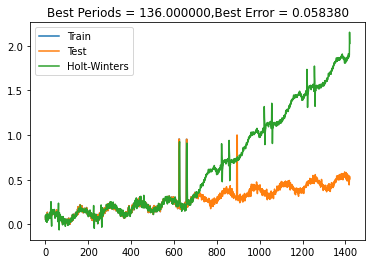

 71%|███████   | 71/100 [51:08<20:56, 43.33s/it]




Errors:

Mean Absolute Error: 0.029
Mean Squared Error: 0.318
Root Mean Squared Error: 0.058
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.869
Mean forecast error: 0.323
Normalised mean squared error: 0.158
Theil_u_statistic: 0.568



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  21057.786852  ...    0.955132  0.364191
658 2014-12-20 17:00:00  21012.156506  ...    0.953180  0.360205
893 2014-12-30 12:00:00  22106.473333  ...    1.000000  0.300950
894 2014-12-30 13:00:00  22106.473333  ...    1.000000  0.302987
895 2014-12-30 14:00:00  22106.473333  ...    1.000000  0.462223

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_81
Me

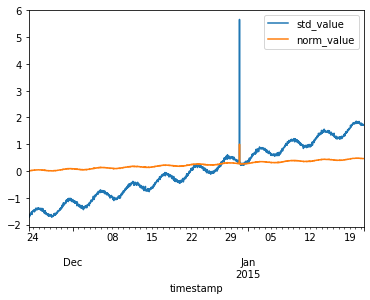


  0%|          | 0/198 [00:00<?, ?it/s]

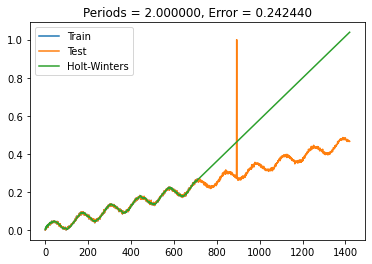


  2%|▏         | 3/198 [00:00<00:37,  5.26it/s]

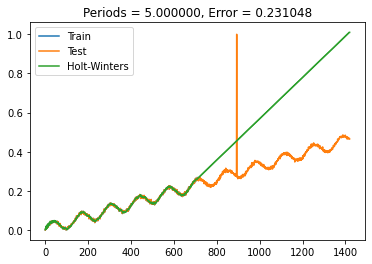


  2%|▏         | 4/198 [00:00<00:44,  4.37it/s]

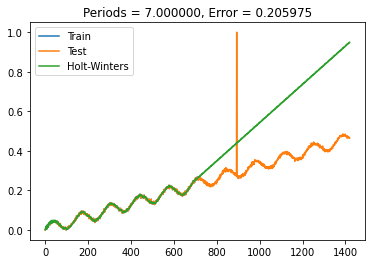


  4%|▍         | 8/198 [00:01<00:30,  6.24it/s]

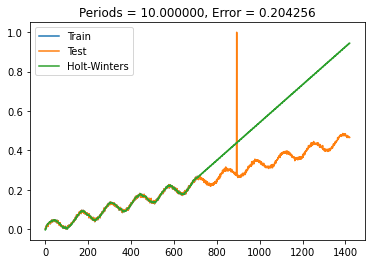


  5%|▌         | 10/198 [00:01<00:32,  5.72it/s]

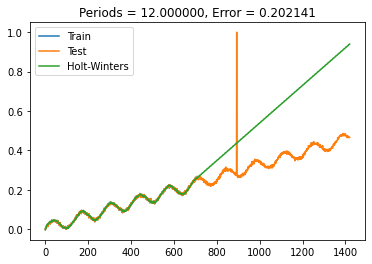


  9%|▊         | 17/198 [00:02<00:23,  7.64it/s]

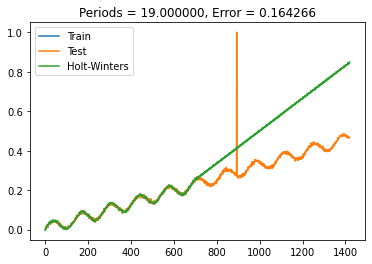


  9%|▉         | 18/198 [00:02<00:30,  5.97it/s]

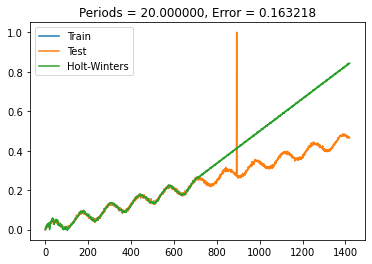


 44%|████▍     | 87/198 [00:16<00:28,  3.88it/s]

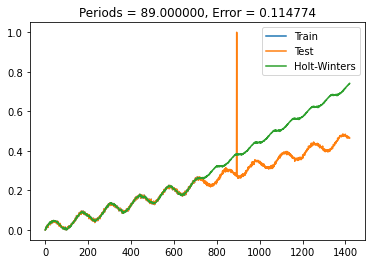


 44%|████▍     | 88/198 [00:16<00:32,  3.37it/s]

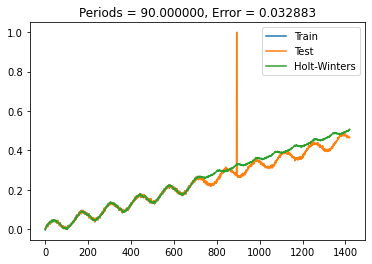


 47%|████▋     | 94/198 [00:18<00:25,  4.15it/s]

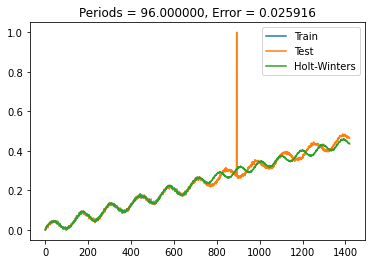


 67%|██████▋   | 132/198 [00:28<00:20,  3.15it/s]

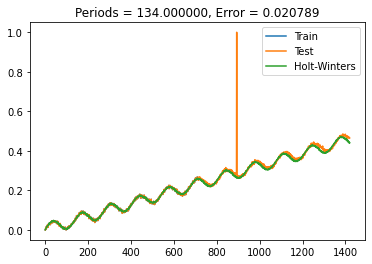


 67%|██████▋   | 133/198 [00:28<00:23,  2.75it/s]

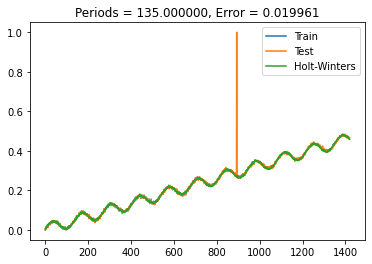


100%|██████████| 198/198 [00:47<00:00,  4.20it/s]


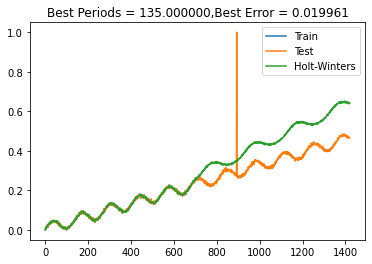

 72%|███████▏  | 72/100 [51:55<20:49, 44.62s/it]




Errors:

Mean Absolute Error: 0.004
Mean Squared Error: 0.27
Root Mean Squared Error: 0.02
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 3.898
Mean forecast error: 0.268
Normalised mean squared error: 0.022
Theil_u_statistic: 0.276



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  49410.638667  ...         1.0  0.269614

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_8
Mean:[68.70829352]
StandardDeviation: 984.0900525155871
Min: -1.601978, Max: 1.611892
                          value  is_anomaly  std_value  norm_value
timestamp                                                         
2014-11-23 07:00:00  102.389668           0   0.034226    0.509107
2014-11-2

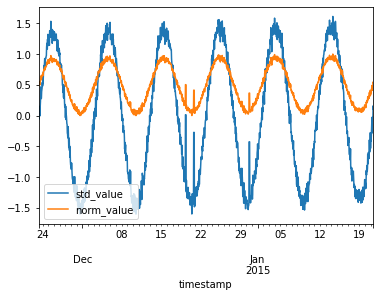


 14%|█▍        | 28/198 [00:02<00:18,  9.15it/s]

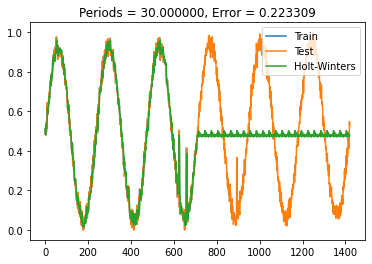


100%|██████████| 198/198 [00:35<00:00,  5.52it/s]


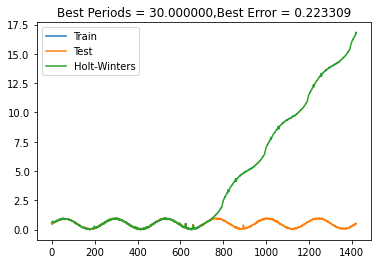

 73%|███████▎  | 73/100 [52:32<18:59, 42.19s/it]




Errors:

Mean Absolute Error: 0.154
Mean Squared Error: 0.588
Root Mean Squared Error: 0.223
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 38.787
Mean forecast error: 0.532
Normalised mean squared error: 0.515
Theil_u_statistic: 0.714



 END Errors

               timestamp       value  ...  norm_value   hw_pred
623  2014-12-19 06:00:00   81.907262  ...    0.502631  0.178950
658  2014-12-20 17:00:00 -200.412605  ...    0.413366  0.068904
730  2014-12-23 17:00:00  825.180641  ...    0.737640  0.480715
731  2014-12-23 18:00:00  796.109003  ...    0.728448  0.469496
732  2014-12-23 19:00:00  803.003998  ...    0.730629  0.475705
...                  ...         ...  ...         ...       ...
1278 2015-01-15 13:00:00  993.556313  ...    0.790878  0.474208
1279 2015-01-15 14:00:00  935.087334  ...    0.772391  0.474865
1280 2015-01-15 15:00:00  823.776134  ...    0.737196  0.478667
1281 2015-01-15 16:00:00  832.838221  ...    0.740062  0.485917
1283 2015-01-

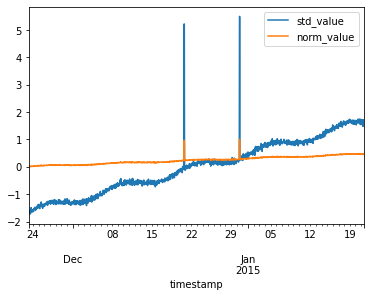


  0%|          | 0/198 [00:00<?, ?it/s]

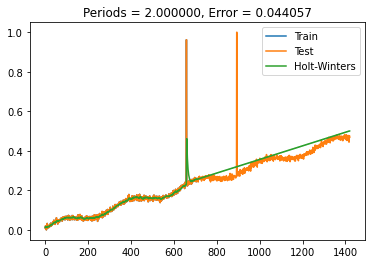


  2%|▏         | 3/198 [00:00<00:40,  4.87it/s]

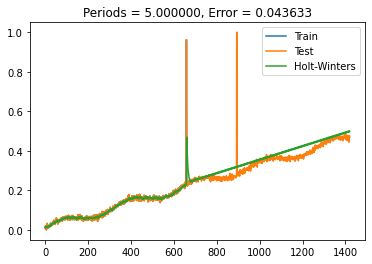


  4%|▍         | 8/198 [00:01<00:26,  7.17it/s]

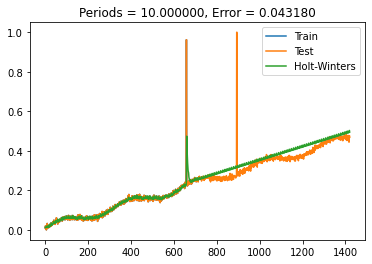


 11%|█         | 22/198 [00:03<00:29,  5.89it/s]

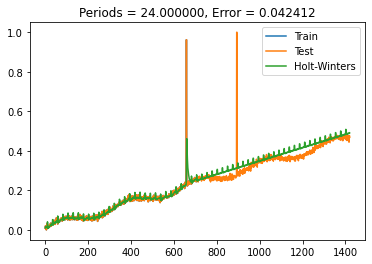


 12%|█▏        | 23/198 [00:03<00:37,  4.73it/s]

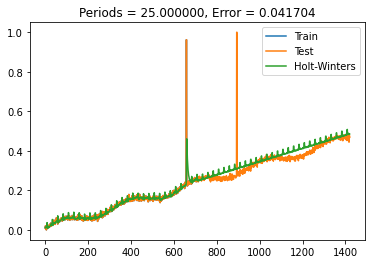


 23%|██▎       | 46/198 [00:08<00:42,  3.59it/s]

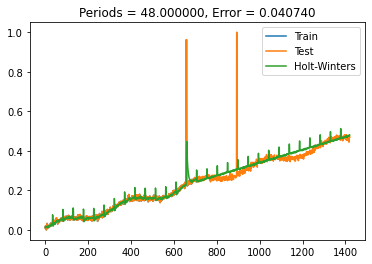


 24%|██▍       | 48/198 [00:09<00:39,  3.85it/s]

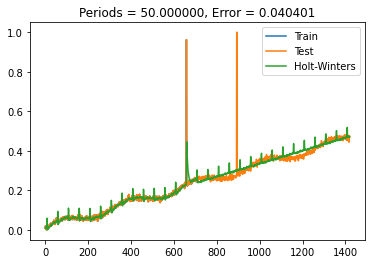


 79%|███████▉  | 156/198 [00:39<00:10,  3.93it/s]

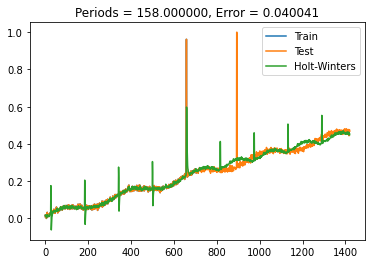


100%|██████████| 198/198 [00:50<00:00,  3.89it/s]


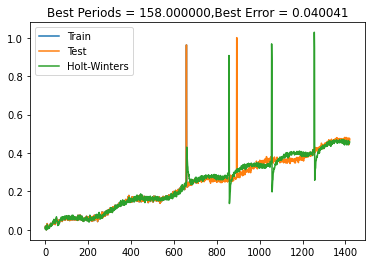

 74%|███████▍  | 74/100 [53:23<19:29, 44.98s/it]




Errors:

Mean Absolute Error: 0.015
Mean Squared Error: 0.277
Root Mean Squared Error: 0.04
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.432
Mean forecast error: 0.276
Normalised mean squared error: 0.084
Theil_u_statistic: 0.524



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  61998.921404  ...    0.961854  0.378822
659 2014-12-20 18:00:00  61998.921404  ...    0.961854  0.597791
893 2014-12-30 12:00:00  64477.228828  ...    1.000000  0.322987
894 2014-12-30 13:00:00  64477.228828  ...    1.000000  0.312457

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_97
Mean:[7896.72122045]
StandardDeviation: 4822.2235615304935
Min: -1.856412, Max: 5.539767
         

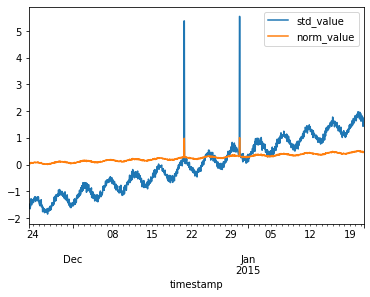


  0%|          | 0/198 [00:00<?, ?it/s]

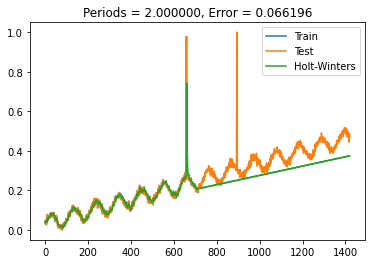


  1%|          | 2/198 [00:00<00:42,  4.59it/s]

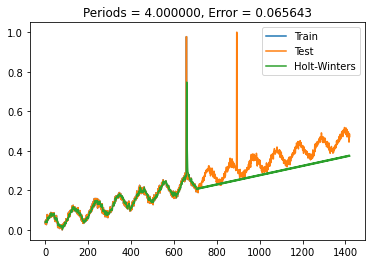


  4%|▎         | 7/198 [00:01<00:27,  6.85it/s]

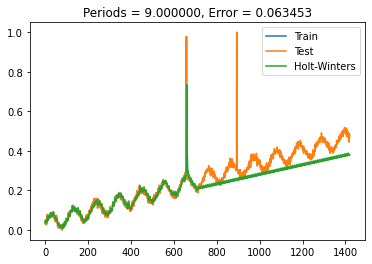


 19%|█▊        | 37/198 [00:06<00:39,  4.12it/s]

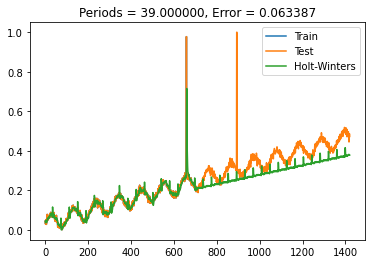


 20%|█▉        | 39/198 [00:07<00:46,  3.43it/s]

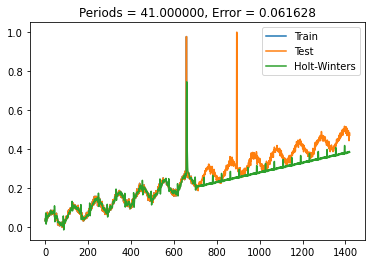


 23%|██▎       | 45/198 [00:09<00:43,  3.53it/s]

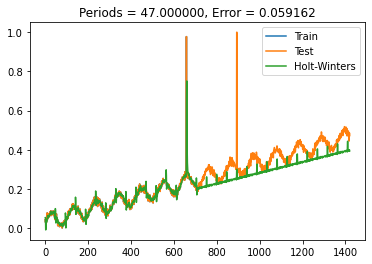


 36%|███▌      | 71/198 [00:16<00:28,  4.47it/s]

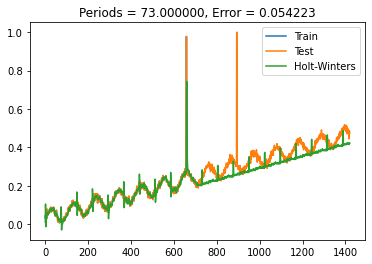


 44%|████▍     | 88/198 [00:21<00:31,  3.53it/s]

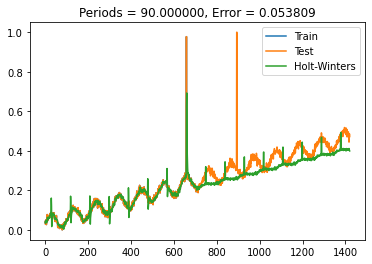


 46%|████▋     | 92/198 [00:22<00:29,  3.64it/s]

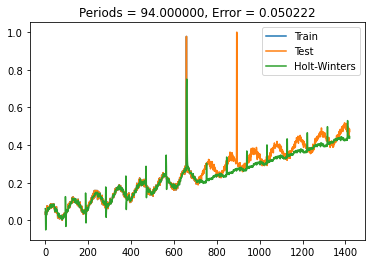


 51%|█████     | 101/198 [00:25<00:28,  3.39it/s]

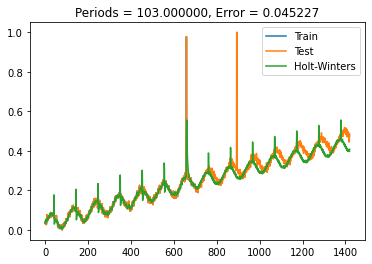


 52%|█████▏    | 102/198 [00:25<00:32,  2.96it/s]

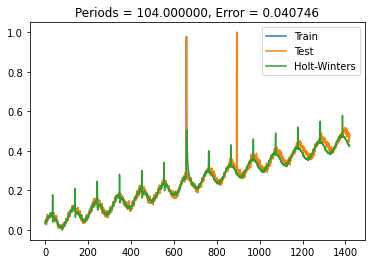


 52%|█████▏    | 103/198 [00:26<00:37,  2.53it/s]

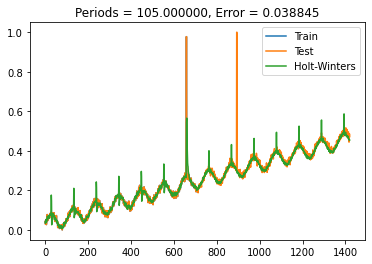


100%|██████████| 198/198 [00:52<00:00,  3.77it/s]


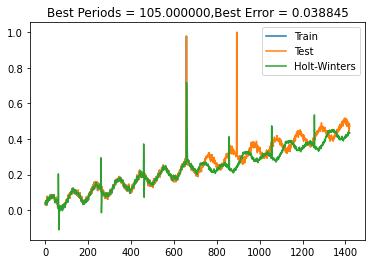

 75%|███████▌  | 75/100 [54:16<19:45, 47.41s/it]




Errors:

Mean Absolute Error: 0.014
Mean Squared Error: 0.285
Root Mean Squared Error: 0.039
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 7.243
Mean forecast error: 0.28
Normalised mean squared error: 0.082
Theil_u_statistic: 0.487



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  33807.477332  ...    0.977479  0.369752
659 2014-12-20 18:00:00  33807.477332  ...    0.977479  0.544010
893 2014-12-30 12:00:00  34610.718324  ...    1.000000  0.298874
894 2014-12-30 13:00:00  34610.718324  ...    1.000000  0.299300

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_12
Mean:[70.36666111]
StandardDeviation: 994.1234251454138
Min: -1.797100, Max: 1.696277
             

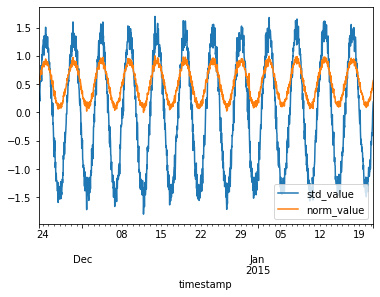


 49%|████▉     | 98/198 [00:16<00:22,  4.38it/s]

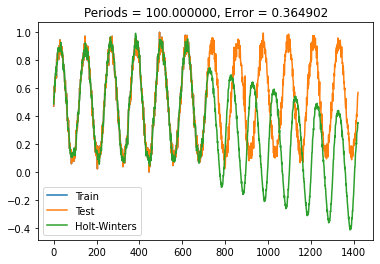


 50%|█████     | 99/198 [00:16<00:30,  3.28it/s]

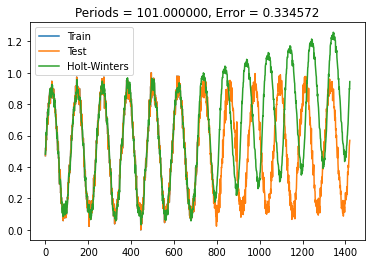


 58%|█████▊    | 115/198 [00:20<00:17,  4.78it/s]

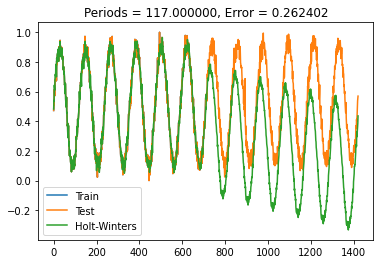


 59%|█████▊    | 116/198 [00:20<00:19,  4.12it/s]

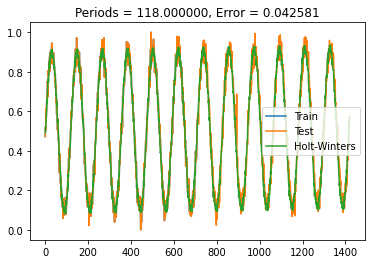


100%|██████████| 198/198 [00:43<00:00,  4.54it/s]


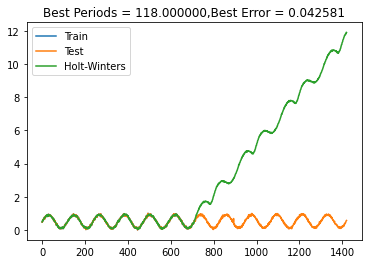

 76%|███████▌  | 76/100 [55:01<18:34, 46.45s/it]




Errors:

Mean Absolute Error: 0.033
Mean Squared Error: 0.589
Root Mean Squared Error: 0.043
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.142
Mean forecast error: 0.584
Normalised mean squared error: 0.022
Theil_u_statistic: 0.124



 END Errors

              timestamp       value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  670.885798  ...    0.687349  0.369561

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_74
Mean:[10261.45618138]
StandardDeviation: 6043.947087191449
Min: -1.711077, Max: 2.911748
                            value  is_anomaly  std_value  norm_value
timestamp                                                           
2014-11-23 07:00:00    192.310834           0  -1.665988    0.009754


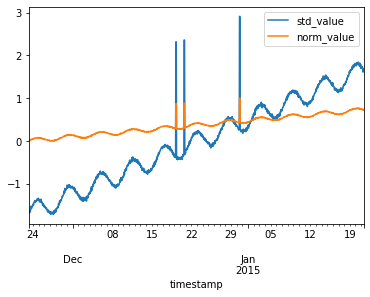


  0%|          | 0/198 [00:00<?, ?it/s]

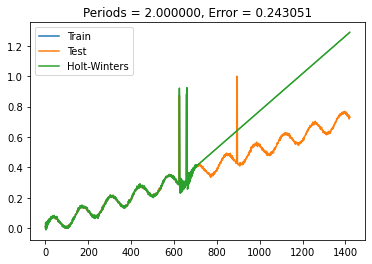


  1%|          | 1/198 [00:00<00:47,  4.12it/s]

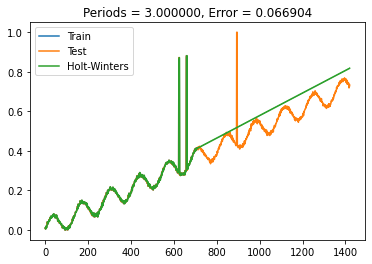


  8%|▊         | 15/198 [00:01<00:19,  9.20it/s]

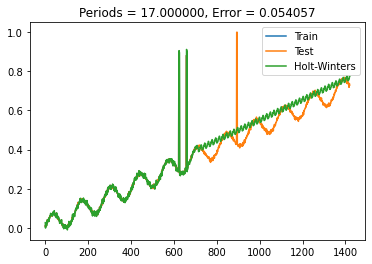


 10%|▉         | 19/198 [00:02<00:21,  8.38it/s]

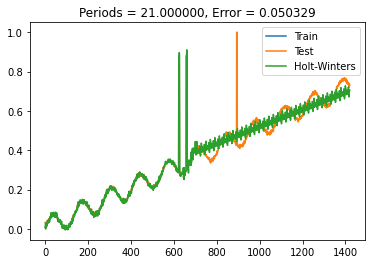


 55%|█████▌    | 109/198 [00:14<00:14,  6.03it/s]

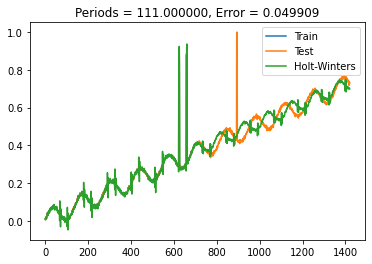


100%|██████████| 198/198 [00:32<00:00,  6.07it/s]


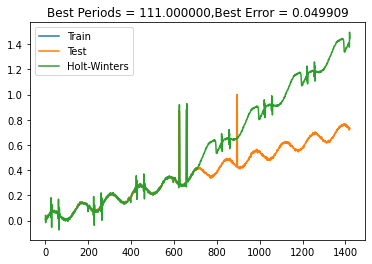

 77%|███████▋  | 77/100 [55:34<16:16, 42.47s/it]




Errors:

Mean Absolute Error: 0.025
Mean Squared Error: 0.429
Root Mean Squared Error: 0.05
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 21.092
Mean forecast error: 0.431
Normalised mean squared error: 0.053
Theil_u_statistic: 0.27



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  24266.394717  ...    0.871385  0.352071
658 2014-12-20 17:00:00  24524.230578  ...    0.880613  0.370453
893 2014-12-30 12:00:00  27859.906793  ...    1.000000  0.444477
894 2014-12-30 13:00:00  27859.906793  ...    1.000000  0.447933
895 2014-12-30 14:00:00  27859.906793  ...    1.000000  0.456604

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_34
Mean

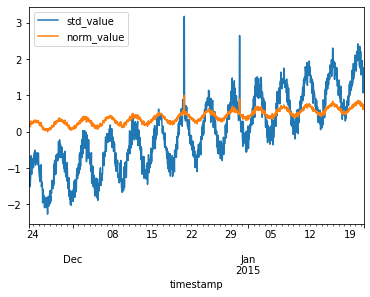


 18%|█▊        | 36/198 [00:03<00:16,  9.75it/s]

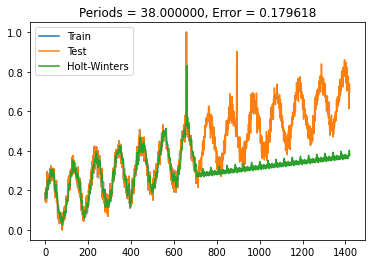


 22%|██▏       | 44/198 [00:04<00:17,  8.94it/s]

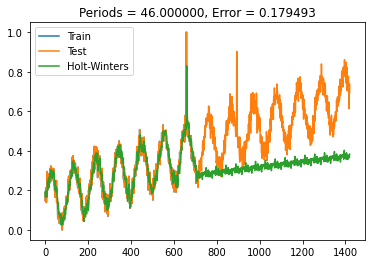


 49%|████▉     | 98/198 [00:12<00:17,  5.75it/s]

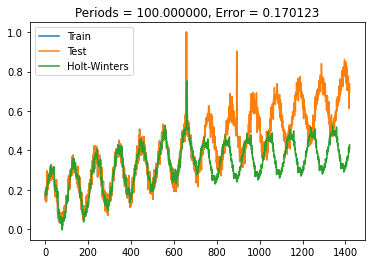


 50%|█████     | 99/198 [00:12<00:25,  3.92it/s]

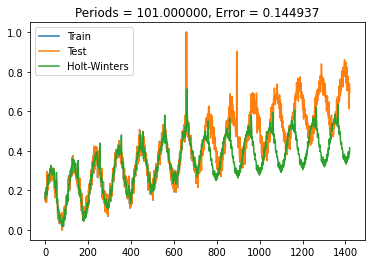


 51%|█████     | 100/198 [00:13<00:31,  3.15it/s]

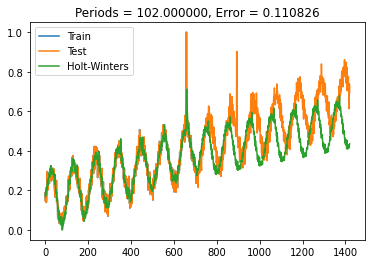


 51%|█████     | 101/198 [00:13<00:36,  2.64it/s]

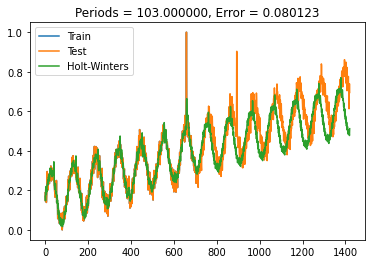


 52%|█████▏    | 102/198 [00:14<00:38,  2.50it/s]

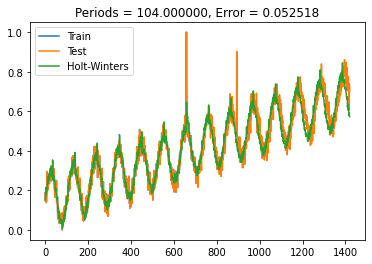


100%|██████████| 198/198 [00:42<00:00,  4.70it/s]


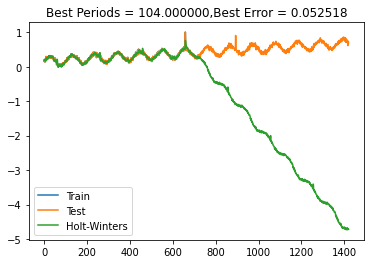

 78%|███████▊  | 78/100 [56:17<15:35, 42.53s/it]




Errors:

Mean Absolute Error: 0.038
Mean Squared Error: 0.456
Root Mean Squared Error: 0.053
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.588
Mean forecast error: 0.451
Normalised mean squared error: 0.082
Theil_u_statistic: 0.256



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  9088.466267  ...    1.000000  0.590708
659 2014-12-20 18:00:00  9088.466267  ...    1.000000  0.645845
893 2014-12-30 12:00:00  8056.499950  ...    0.903188  0.447086
894 2014-12-30 13:00:00  8056.499950  ...    0.903188  0.425436

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_23
Mean:[4471.66922612]
StandardDeviation: 2925.3916703264767
Min: -1.809898, Max: 5.219308
             

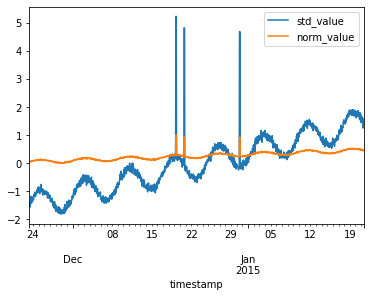


  0%|          | 0/198 [00:00<?, ?it/s]

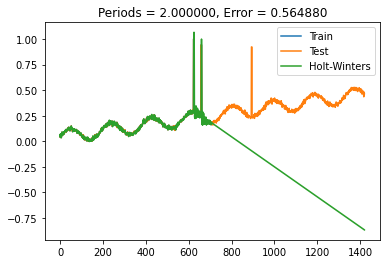


  1%|          | 1/198 [00:00<00:49,  4.02it/s]

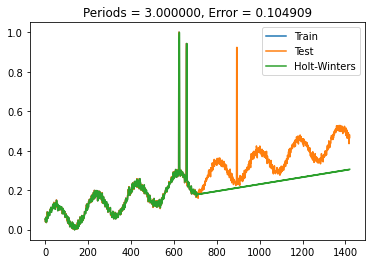


  1%|          | 2/198 [00:00<00:48,  4.02it/s]

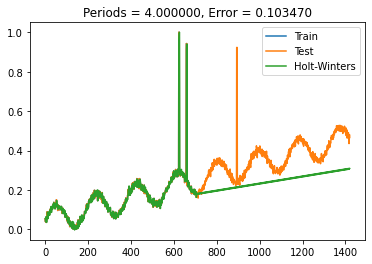


  3%|▎         | 6/198 [00:01<00:30,  6.36it/s]

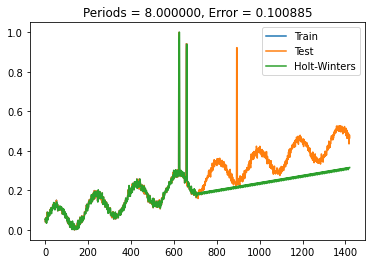


  4%|▎         | 7/198 [00:01<00:35,  5.38it/s]

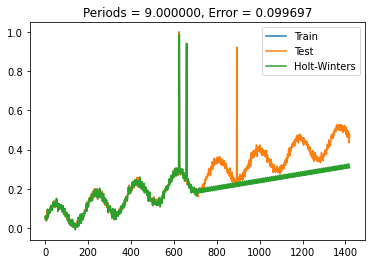


  5%|▍         | 9/198 [00:01<00:33,  5.57it/s]

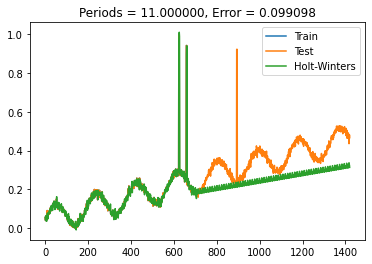


  7%|▋         | 13/198 [00:02<00:29,  6.28it/s]

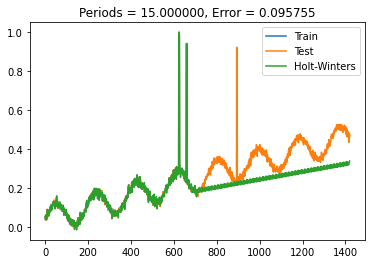


 11%|█         | 22/198 [00:03<00:20,  8.65it/s]

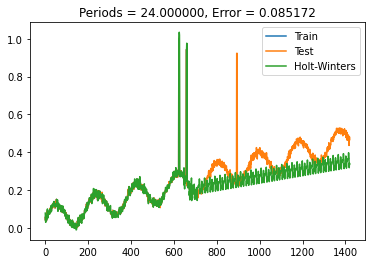


 19%|█▊        | 37/198 [00:05<00:20,  7.71it/s]

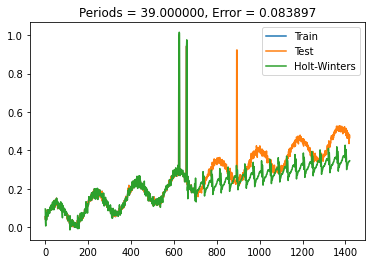


 52%|█████▏    | 102/198 [00:13<00:18,  5.10it/s]

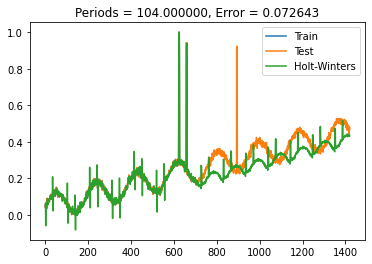


 94%|█████████▍| 186/198 [00:32<00:02,  4.56it/s]

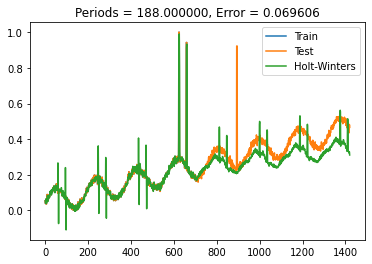


 95%|█████████▌| 189/198 [00:33<00:02,  3.92it/s]

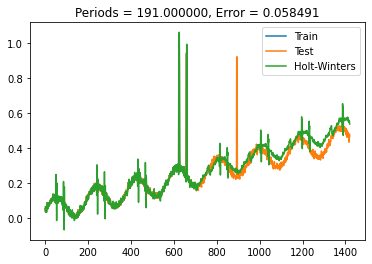


100%|██████████| 198/198 [00:35<00:00,  5.61it/s]


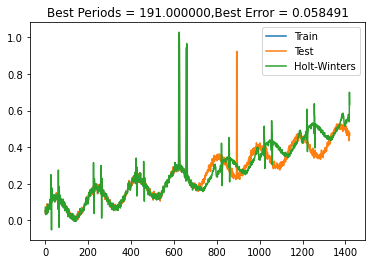

 79%|███████▉  | 79/100 [56:52<14:10, 40.51s/it]




Errors:

Mean Absolute Error: 0.031
Mean Squared Error: 0.294
Root Mean Squared Error: 0.058
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 14.612
Mean forecast error: 0.314
Normalised mean squared error: 0.169
Theil_u_statistic: 0.633



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  19740.188389  ...    1.000000  0.387204
658 2014-12-20 17:00:00  18553.830928  ...    0.942307  0.349157
893 2014-12-30 12:00:00  18153.623148  ...    0.922844  0.273641
894 2014-12-30 13:00:00  18153.623148  ...    0.922844  0.279834
895 2014-12-30 14:00:00  18153.623148  ...    0.922844  0.269496

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_6
Mea

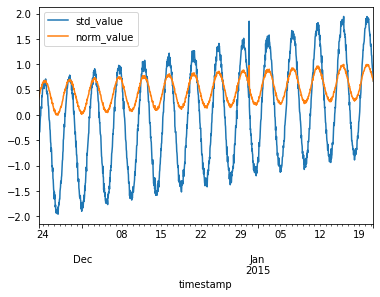


  0%|          | 0/198 [00:00<?, ?it/s]

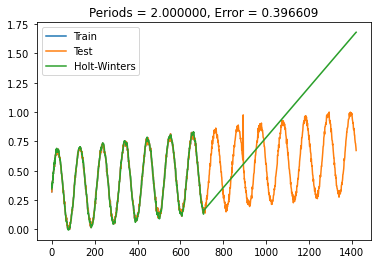


  2%|▏         | 3/198 [00:00<00:38,  5.09it/s]

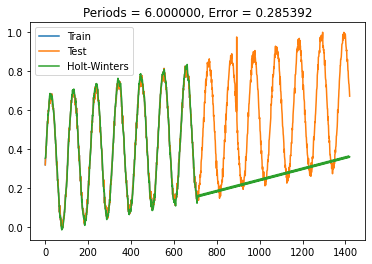


  7%|▋         | 13/198 [00:01<00:22,  8.34it/s]

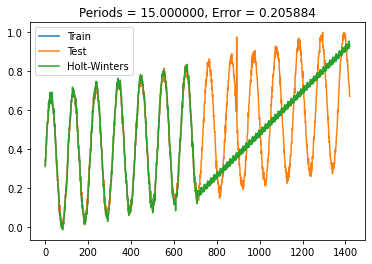


 13%|█▎        | 25/198 [00:03<00:19,  8.91it/s]

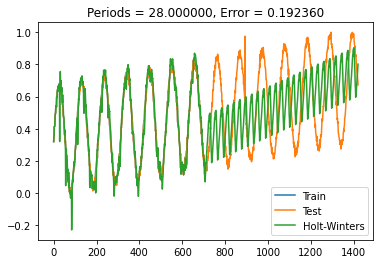


 52%|█████▏    | 103/198 [00:15<00:20,  4.68it/s]

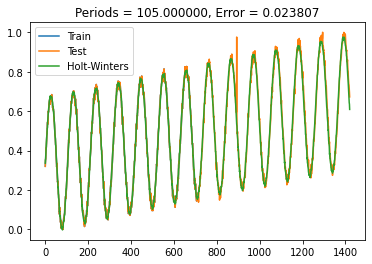


100%|██████████| 198/198 [00:40<00:00,  4.92it/s]


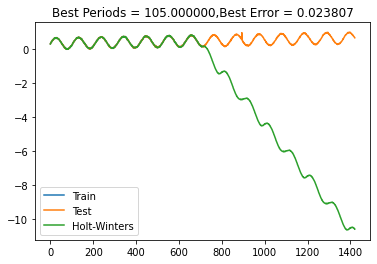

 80%|████████  | 80/100 [57:33<13:31, 40.58s/it]




Errors:

Mean Absolute Error: 0.017
Mean Squared Error: 0.563
Root Mean Squared Error: 0.024
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 5.84
Mean forecast error: 0.561
Normalised mean squared error: 0.009
Theil_u_statistic: 0.075



 END Errors

              timestamp        value  ...  norm_value  hw_pred
893 2014-12-30 12:00:00  2694.949687  ...    0.975731  0.53197

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_36
Mean:[634.29688051]
StandardDeviation: 1095.0765844791893
Min: -2.281384, Max: 2.504105
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00  -225.252406           0  -0.784922    0.312708
2014-1

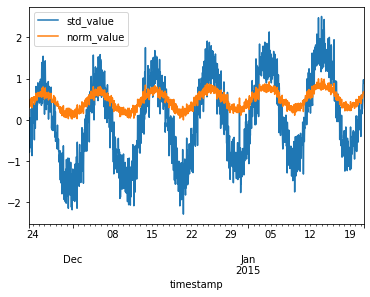


 46%|████▋     | 92/198 [00:14<00:23,  4.61it/s]

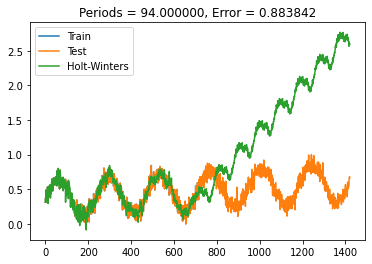


 47%|████▋     | 93/198 [00:15<00:24,  4.35it/s]

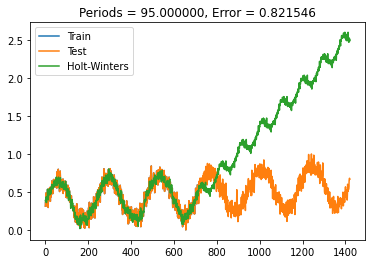


 47%|████▋     | 94/198 [00:15<00:26,  3.88it/s]

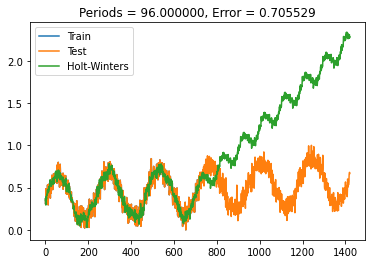


 54%|█████▍    | 107/198 [00:19<00:25,  3.53it/s]

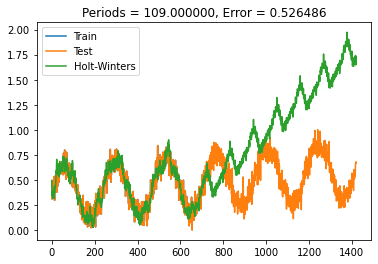


 55%|█████▍    | 108/198 [00:19<00:24,  3.62it/s]

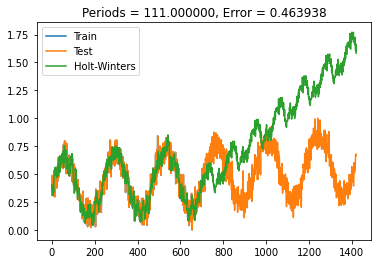


 66%|██████▌   | 131/198 [00:23<00:19,  3.46it/s]

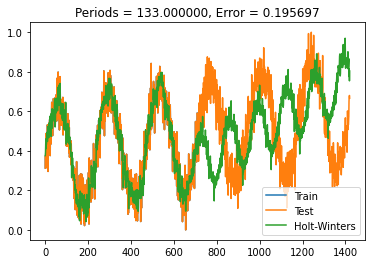


100%|██████████| 198/198 [00:44<00:00,  4.49it/s]


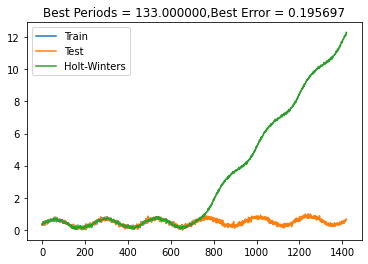

 81%|████████  | 81/100 [58:18<13:14, 41.79s/it]




Errors:

Mean Absolute Error: 0.138
Mean Squared Error: 0.521
Root Mean Squared Error: 0.196
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 30.725
Mean forecast error: 0.522
Normalised mean squared error: 0.876
Theil_u_statistic: 0.72



 END Errors

               timestamp        value  ...  norm_value   hw_pred
722  2014-12-23 09:00:00  1716.770665  ...    0.683290  0.425533
736  2014-12-23 23:00:00  1886.792811  ...    0.715734  0.422436
738  2014-12-24 01:00:00  2042.008989  ...    0.745352  0.434292
739  2014-12-24 02:00:00  1817.482800  ...    0.702508  0.446112
742  2014-12-24 05:00:00  2181.248509  ...    0.771922  0.454647
...                  ...          ...  ...         ...       ...
1211 2015-01-12 18:00:00  2496.912899  ...    0.832158  0.540576
1216 2015-01-12 23:00:00  2621.080887  ...    0.855852  0.548250
1221 2015-01-13 04:00:00  2909.067745  ...    0.910807  0.556493
1224 2015-01-13 07:00:00  2524.805529  ...    0.837481  0.564849
122

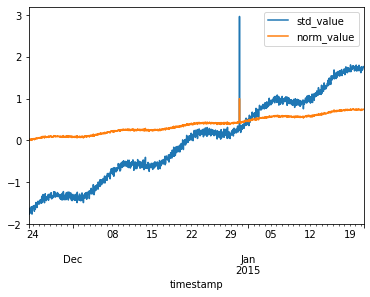


  0%|          | 0/198 [00:00<?, ?it/s]

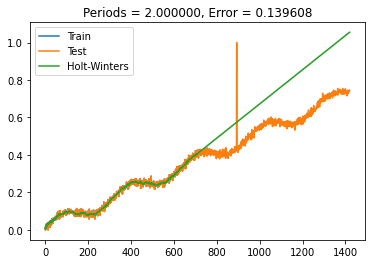


  1%|          | 1/198 [00:00<00:47,  4.13it/s]

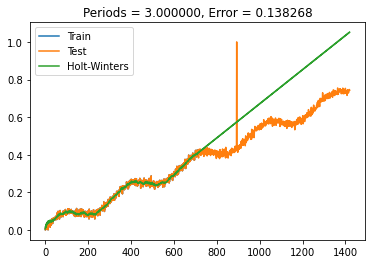


  1%|          | 2/198 [00:00<00:48,  4.08it/s]

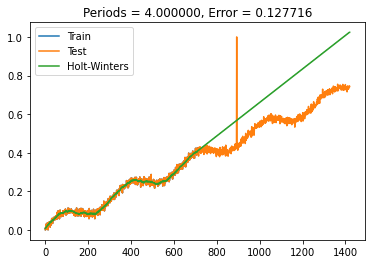


  2%|▏         | 3/198 [00:00<00:48,  4.01it/s]

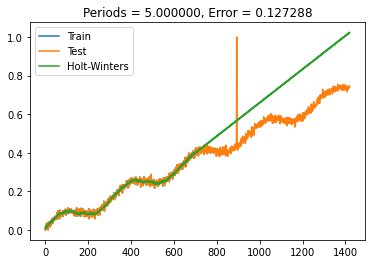


  2%|▏         | 4/198 [00:01<00:49,  3.94it/s]

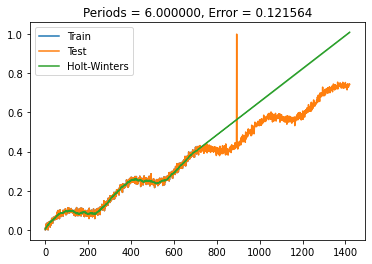


  9%|▊         | 17/198 [00:02<00:21,  8.52it/s]

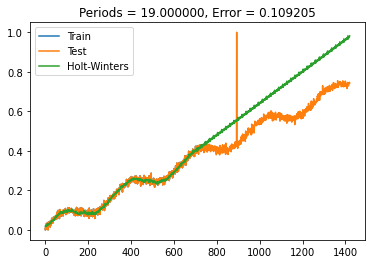


 19%|█▉        | 38/198 [00:05<00:25,  6.38it/s]

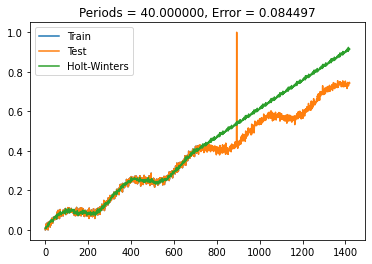


 27%|██▋       | 53/198 [00:08<00:29,  4.89it/s]

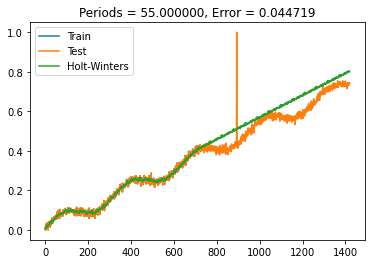


 30%|██▉       | 59/198 [00:09<00:29,  4.71it/s]

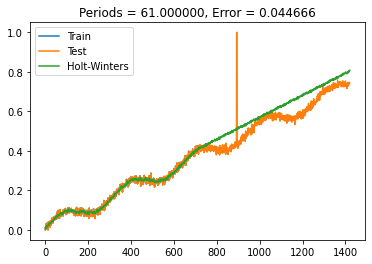


 38%|███▊      | 75/198 [00:13<00:32,  3.83it/s]

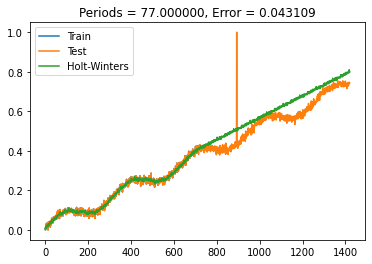


 76%|███████▋  | 151/198 [00:36<00:15,  3.07it/s]

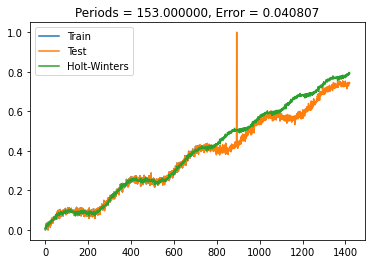


 77%|███████▋  | 152/198 [00:37<00:16,  2.73it/s]

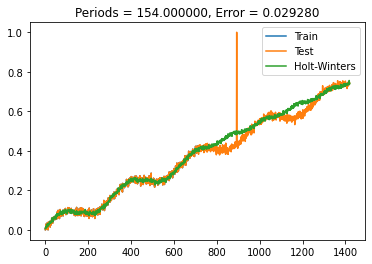


 78%|███████▊  | 154/198 [00:38<00:16,  2.65it/s]

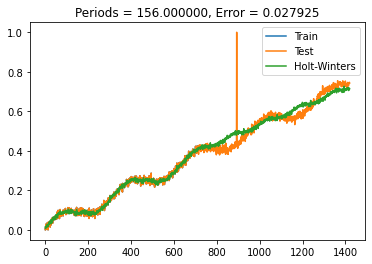


 99%|█████████▉| 197/198 [00:52<00:00,  3.09it/s]

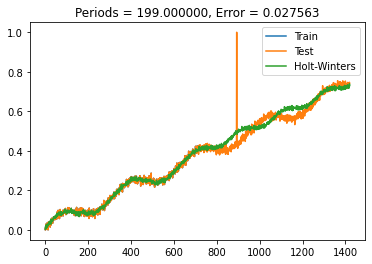


100%|██████████| 198/198 [00:53<00:00,  3.73it/s]


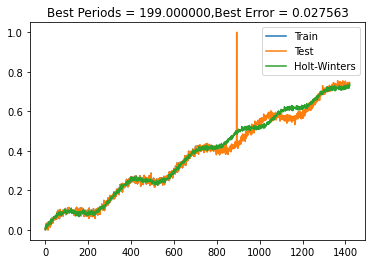

 82%|████████▏ | 82/100 [59:11<13:36, 45.34s/it]




Errors:

Mean Absolute Error: 0.018
Mean Squared Error: 0.429
Root Mean Squared Error: 0.028
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 5.862
Mean forecast error: 0.435
Normalised mean squared error: 0.017
Theil_u_statistic: 0.148



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  38073.212658  ...         1.0  0.492172

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_68
Mean:[554.17712739]
StandardDeviation: 1030.2968726487368
Min: -1.887090, Max: 2.816559
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   103.067447           0  -0.437844    0.308111
2

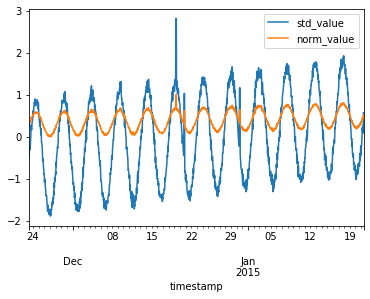


 15%|█▍        | 29/198 [00:02<00:18,  9.30it/s]

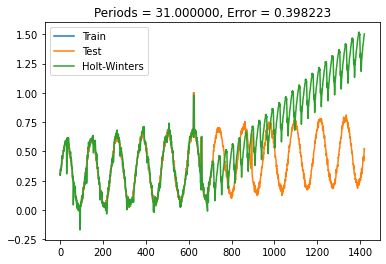


 34%|███▍      | 67/198 [00:07<00:21,  5.99it/s]

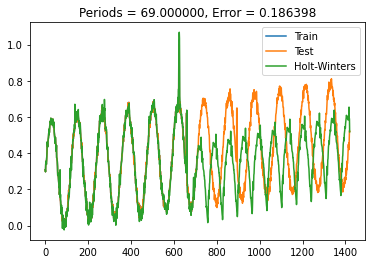


 58%|█████▊    | 114/198 [00:15<00:23,  3.60it/s]

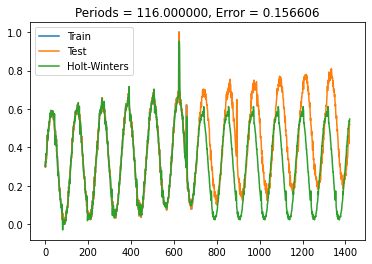


 58%|█████▊    | 115/198 [00:16<00:27,  3.04it/s]

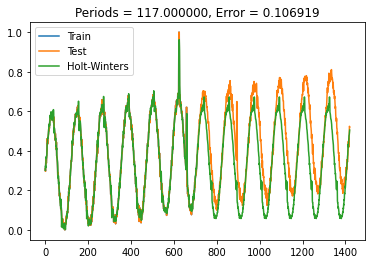


 59%|█████▊    | 116/198 [00:16<00:29,  2.74it/s]

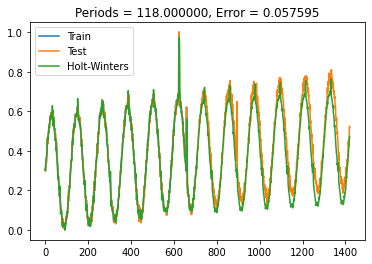


100%|██████████| 198/198 [00:33<00:00,  5.92it/s]


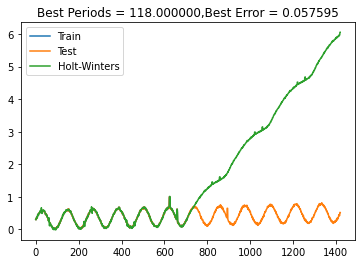

 83%|████████▎ | 83/100 [59:45<11:52, 41.92s/it]




Errors:

Mean Absolute Error: 0.04
Mean Squared Error: 0.454
Root Mean Squared Error: 0.058
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 14.123
Mean forecast error: 0.423
Normalised mean squared error: 0.073
Theil_u_statistic: 0.3



 END Errors

              timestamp        value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  3456.069516  ...    1.000000  0.725522
658 2014-12-20 17:00:00  1614.961443  ...    0.620089  0.344904
893 2014-12-30 12:00:00  1755.033417  ...    0.648993  0.265177
894 2014-12-30 13:00:00  1755.033417  ...    0.648993  0.308086
895 2014-12-30 14:00:00  1755.033417  ...    0.648993  0.290710

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_84
Mean:[28683

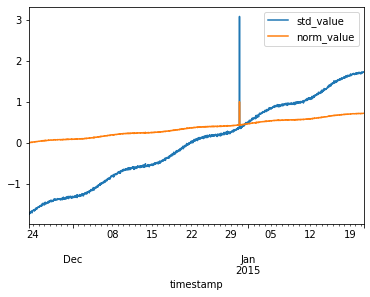


  0%|          | 0/198 [00:00<?, ?it/s]

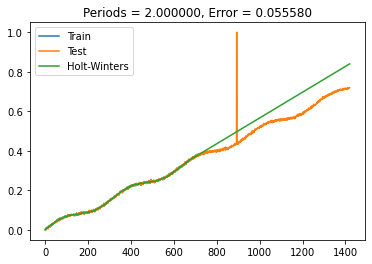


  1%|          | 1/198 [00:00<00:48,  4.05it/s]

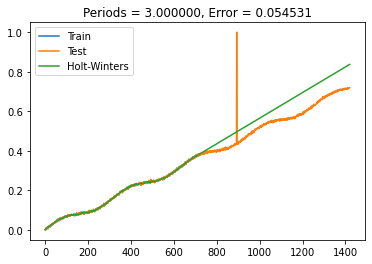


  1%|          | 2/198 [00:00<00:48,  4.03it/s]

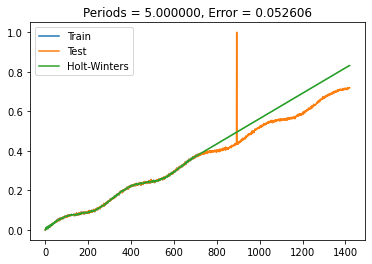


  2%|▏         | 4/198 [00:00<00:43,  4.45it/s]

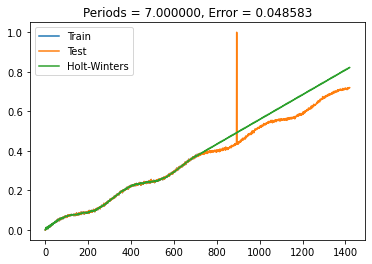


  9%|▊         | 17/198 [00:02<00:19,  9.42it/s]

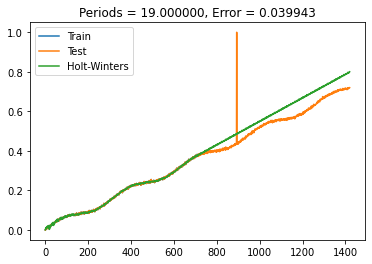


 20%|█▉        | 39/198 [00:05<00:31,  4.98it/s]

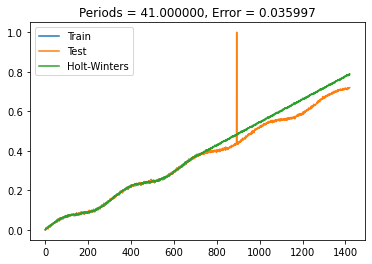


 20%|██        | 40/198 [00:06<00:38,  4.09it/s]

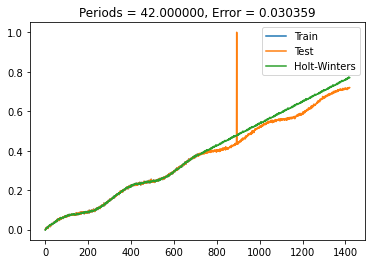


 21%|██        | 41/198 [00:06<00:41,  3.79it/s]

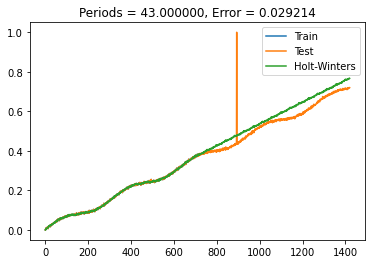


 29%|██▉       | 58/198 [00:10<00:30,  4.63it/s]

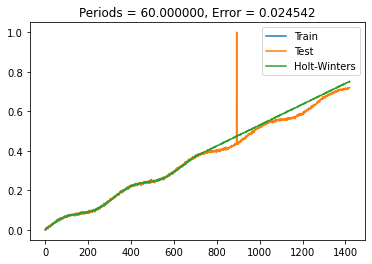


 36%|███▋      | 72/198 [00:13<00:25,  5.00it/s]

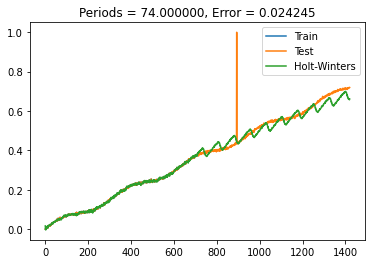


 44%|████▍     | 87/198 [00:15<00:16,  6.58it/s]

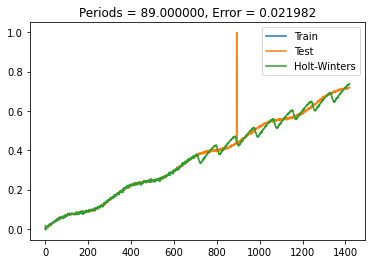


100%|██████████| 198/198 [00:37<00:00,  5.32it/s]


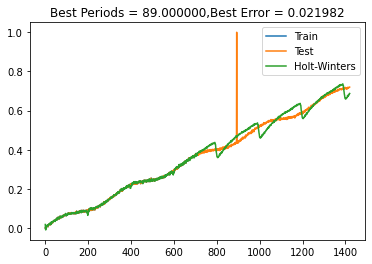

 84%|████████▍ | 84/100 [1:00:23<10:50, 40.68s/it]




Errors:

Mean Absolute Error: 0.012
Mean Squared Error: 0.416
Root Mean Squared Error: 0.022
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 4.317
Mean forecast error: 0.413
Normalised mean squared error: 0.011
Theil_u_statistic: 0.128



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  79681.565493  ...         1.0  0.447457

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_80
Mean:[1607.22220047]
StandardDeviation: 1324.6766959578288
Min: -2.314719, Max: 3.133628
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   256.096341           0  -1.019967    0.237641


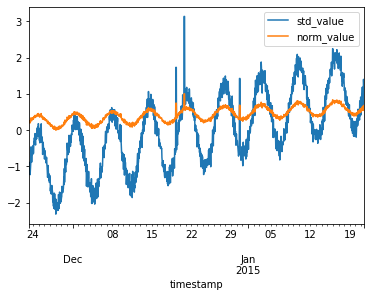


  0%|          | 0/198 [00:00<?, ?it/s]

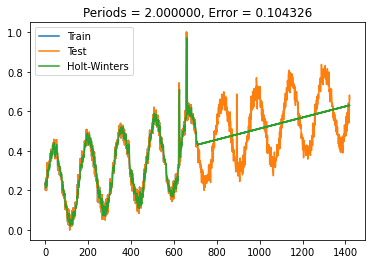


  1%|          | 1/198 [00:00<00:51,  3.86it/s]

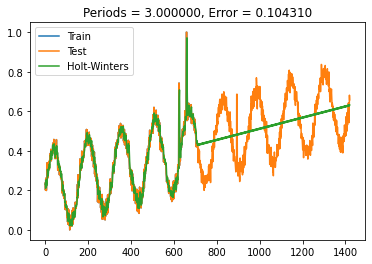


  2%|▏         | 4/198 [00:00<00:35,  5.52it/s]

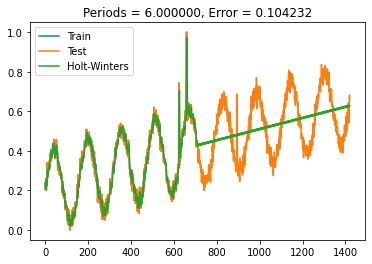


  3%|▎         | 5/198 [00:00<00:39,  4.94it/s]

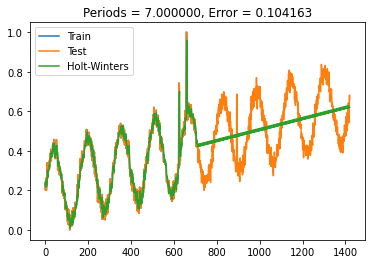


  5%|▌         | 10/198 [00:01<00:25,  7.26it/s]

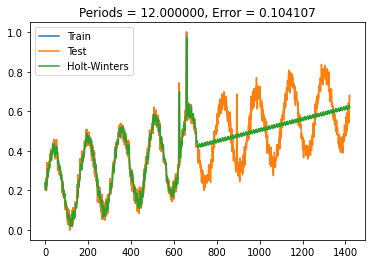


  8%|▊         | 15/198 [00:02<00:26,  6.92it/s]

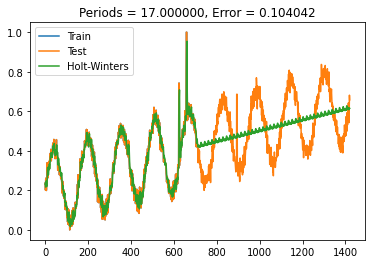


 12%|█▏        | 23/198 [00:03<00:28,  6.21it/s]

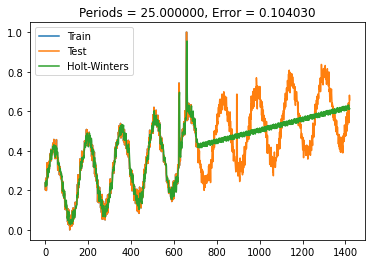


 77%|███████▋  | 153/198 [00:38<00:11,  3.77it/s]

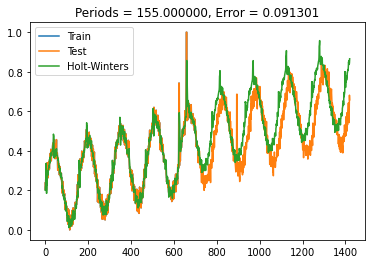


 78%|███████▊  | 154/198 [00:38<00:14,  3.14it/s]

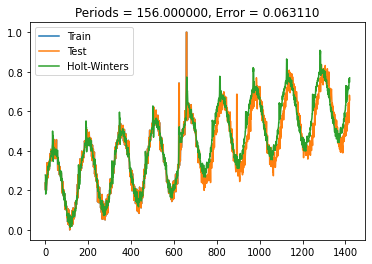


 78%|███████▊  | 155/198 [00:39<00:14,  3.05it/s]

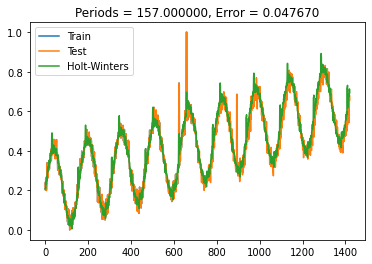


 79%|███████▉  | 156/198 [00:39<00:15,  2.75it/s]

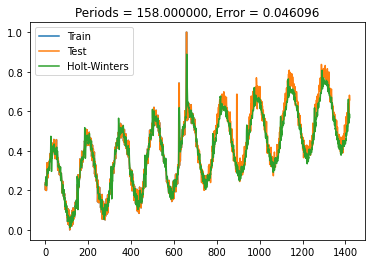


100%|██████████| 198/198 [00:52<00:00,  3.79it/s]


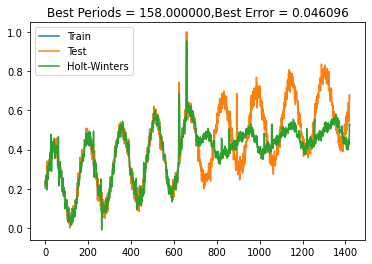

 85%|████████▌ | 85/100 [1:01:16<11:04, 44.33s/it]




Errors:

Mean Absolute Error: 0.032
Mean Squared Error: 0.463
Root Mean Squared Error: 0.046
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 9.253
Mean forecast error: 0.446
Normalised mean squared error: 0.063
Theil_u_statistic: 0.223



 END Errors

              timestamp        value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  3897.820150  ...    0.742224  0.425034
658 2014-12-20 17:00:00  5758.265973  ...    1.000000  0.670337
893 2014-12-30 12:00:00  3493.343719  ...    0.686181  0.331206
894 2014-12-30 13:00:00  3493.343719  ...    0.686181  0.287315
895 2014-12-30 14:00:00  3493.343719  ...    0.686181  0.305607

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_76
Mean:[775

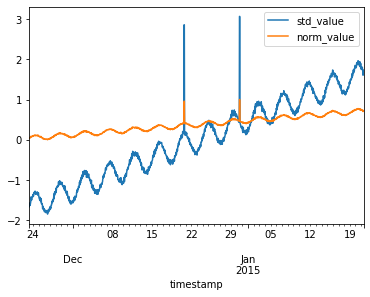


  0%|          | 0/198 [00:00<?, ?it/s]

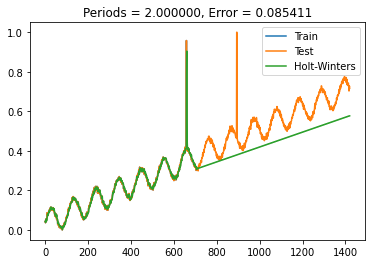


  1%|          | 2/198 [00:00<00:39,  4.93it/s]

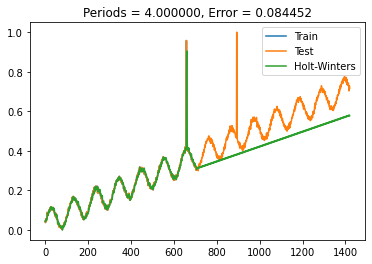


  4%|▎         | 7/198 [00:01<00:26,  7.34it/s]

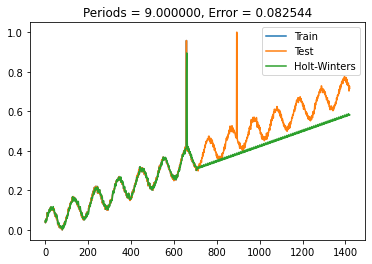


  6%|▌         | 11/198 [00:01<00:26,  7.07it/s]

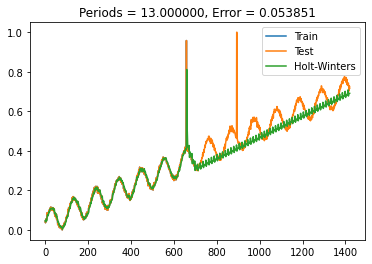


 51%|█████     | 100/198 [00:23<00:25,  3.92it/s]

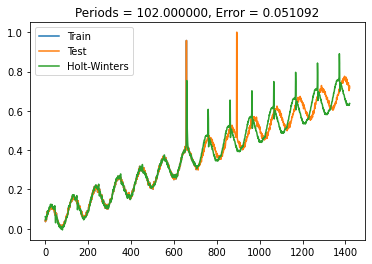


 52%|█████▏    | 102/198 [00:24<00:25,  3.84it/s]

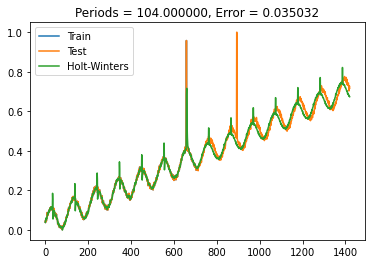


100%|██████████| 198/198 [00:47<00:00,  4.16it/s]


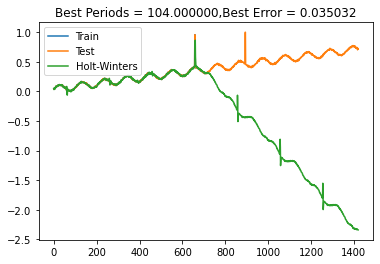

 86%|████████▌ | 86/100 [1:02:04<10:36, 45.47s/it]




Errors:

Mean Absolute Error: 0.017
Mean Squared Error: 0.428
Root Mean Squared Error: 0.035
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 5.571
Mean forecast error: 0.423
Normalised mean squared error: 0.03
Theil_u_statistic: 0.194



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  20933.121675  ...    0.957746  0.490165
659 2014-12-20 18:00:00  20933.121675  ...    0.957746  0.683734
893 2014-12-30 12:00:00  21890.413264  ...    1.000000  0.433325
894 2014-12-30 13:00:00  21890.413264  ...    1.000000  0.427973

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_57
Mean:[1594.30294232]
StandardDeviation: 1417.0786351196837
Min: -2.474116, Max: 3.287753
          

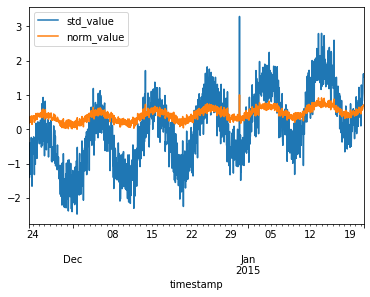


 30%|██▉       | 59/198 [00:08<00:28,  4.94it/s]

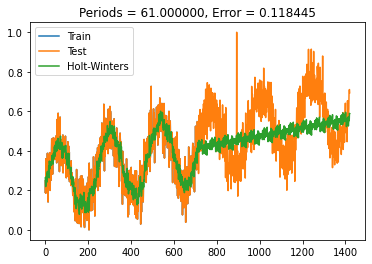


 34%|███▍      | 68/198 [00:10<00:25,  5.04it/s]

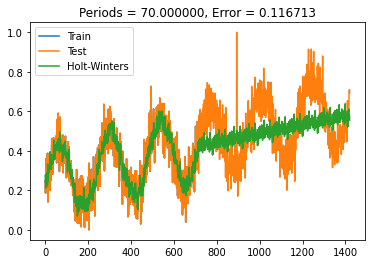


100%|██████████| 198/198 [00:42<00:00,  4.64it/s]


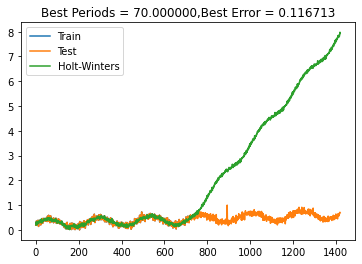

 87%|████████▋ | 87/100 [1:02:47<09:42, 44.79s/it]




Errors:

Mean Absolute Error: 0.092
Mean Squared Error: 0.463
Root Mean Squared Error: 0.117
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 23.423
Mean forecast error: 0.436
Normalised mean squared error: 0.452
Theil_u_statistic: 0.578



 END Errors

               timestamp        value  ...  norm_value   hw_pred
494  2014-12-13 21:00:00  4018.350733  ...    0.726277  0.449814
748  2014-12-24 11:00:00  3896.859516  ...    0.711397  0.453299
749  2014-12-24 12:00:00  3901.256874  ...    0.711936  0.438500
756  2014-12-24 19:00:00  4170.870280  ...    0.744956  0.432835
757  2014-12-24 20:00:00  3605.603903  ...    0.675726  0.408525
765  2014-12-25 04:00:00  4079.591326  ...    0.733777  0.450742
766  2014-12-25 05:00:00  3485.535076  ...    0.661021  0.393873
767  2014-12-25 06:00:00  3855.908940  ...    0.706382  0.449350
772  2014-12-25 11:00:00  3663.722286  ...    0.682844  0.424808
773  2014-12-25 12:00:00  3941.318712  ...    0.716842  0.408663
77

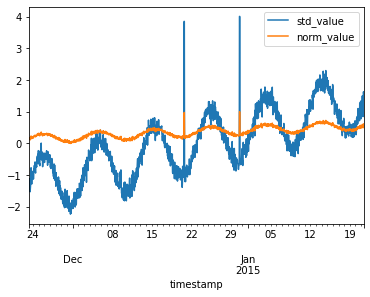


  0%|          | 0/198 [00:00<?, ?it/s]

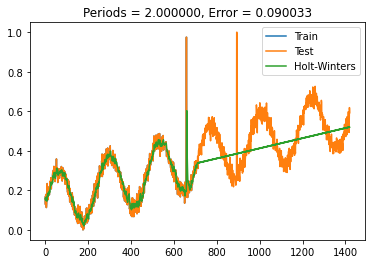


  1%|          | 2/198 [00:00<00:40,  4.82it/s]

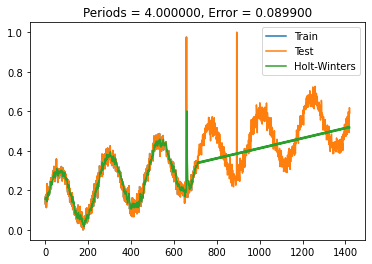


  4%|▎         | 7/198 [00:01<00:25,  7.53it/s]

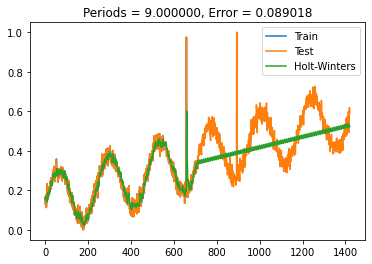


  6%|▌         | 11/198 [00:01<00:26,  6.93it/s]

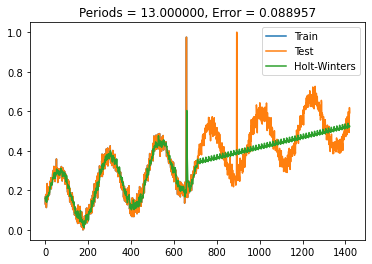


 12%|█▏        | 24/198 [00:03<00:21,  8.19it/s]

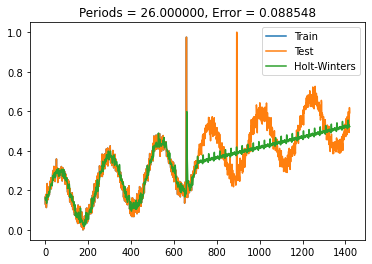


 20%|█▉        | 39/198 [00:05<00:28,  5.54it/s]

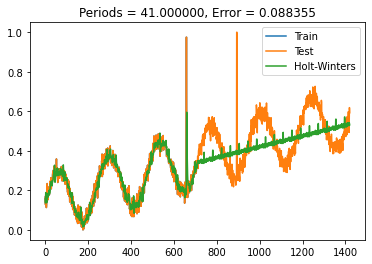


 29%|██▉       | 57/198 [00:10<00:35,  3.97it/s]

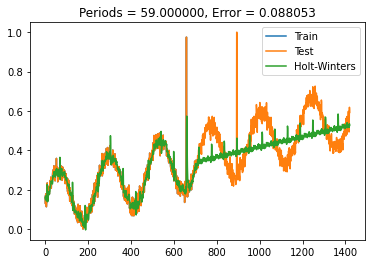


 43%|████▎     | 85/198 [00:17<00:31,  3.54it/s]

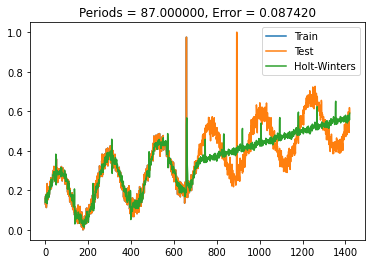


 59%|█████▊    | 116/198 [00:26<00:23,  3.55it/s]

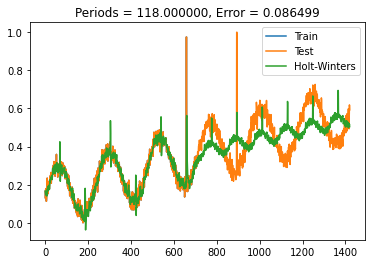


100%|██████████| 198/198 [00:50<00:00,  3.88it/s]


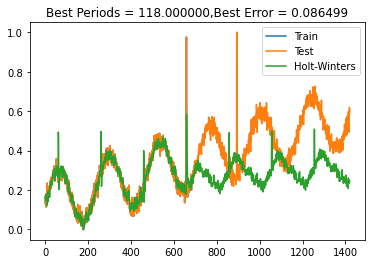

 88%|████████▊ | 88/100 [1:03:39<09:21, 46.82s/it]




Errors:

Mean Absolute Error: 0.062
Mean Squared Error: 0.392
Root Mean Squared Error: 0.086
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 19.614
Mean forecast error: 0.379
Normalised mean squared error: 0.291
Theil_u_statistic: 0.582



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  7972.116495  ...    0.974788  0.330737
659 2014-12-20 18:00:00  7972.116495  ...    0.974788  0.547203
893 2014-12-30 12:00:00  8210.758177  ...    1.000000  0.442718
894 2014-12-30 13:00:00  8210.758177  ...    1.000000  0.578887

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_48
Mean:[4525.11236834]
StandardDeviation: 2816.8293082109117
Min: -2.160249, Max: 2.920773
             

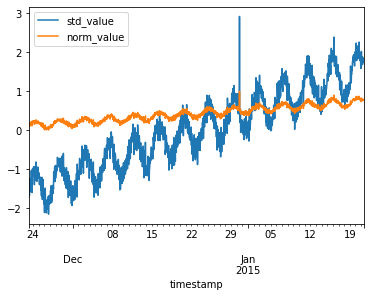


  0%|          | 0/198 [00:00<?, ?it/s]

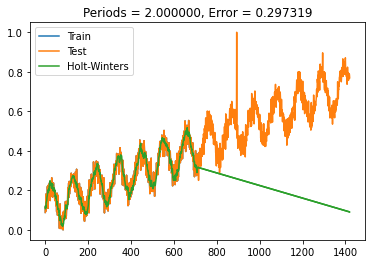


  1%|          | 1/198 [00:00<00:52,  3.77it/s]

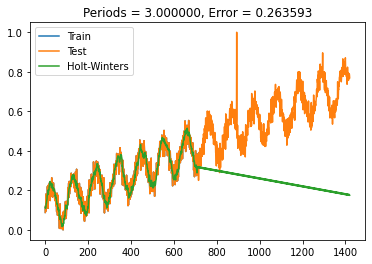


  7%|▋         | 13/198 [00:01<00:21,  8.77it/s]

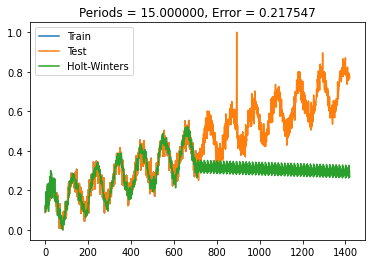


 11%|█         | 21/198 [00:02<00:18,  9.34it/s]

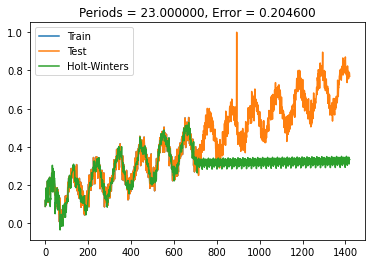


 14%|█▍        | 28/198 [00:03<00:22,  7.63it/s]

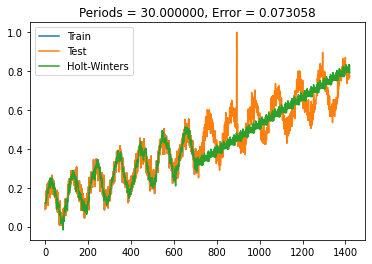


 31%|███▏      | 62/198 [00:09<00:24,  5.52it/s]

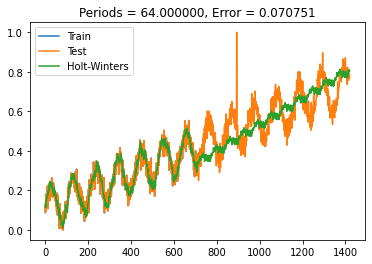


 52%|█████▏    | 102/198 [00:16<00:20,  4.65it/s]

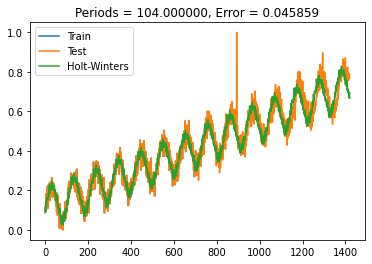


 52%|█████▏    | 103/198 [00:17<00:27,  3.47it/s]

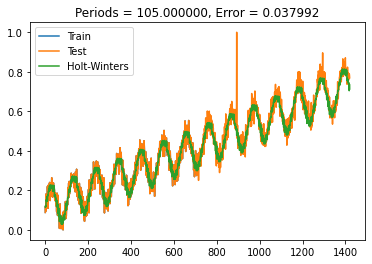


100%|██████████| 198/198 [00:42<00:00,  4.61it/s]


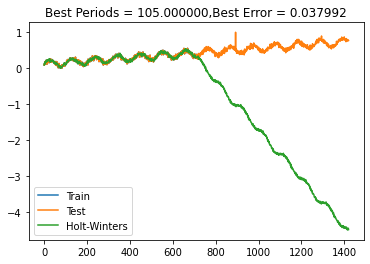

 89%|████████▉ | 89/100 [1:04:22<08:24, 45.85s/it]




Errors:

Mean Absolute Error: 0.029
Mean Squared Error: 0.469
Root Mean Squared Error: 0.038
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.971
Mean forecast error: 0.461
Normalised mean squared error: 0.037
Theil_u_statistic: 0.176



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  12752.431789  ...         1.0  0.478392

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_35
Mean:[11410.89978947]
StandardDeviation: 7069.718249966845
Min: -1.657583, Max: 5.200080
                            value  is_anomaly  std_value  norm_value
timestamp                                                           
2014-11-23 07:00:00    458.901115           0  -1.549142    0.0158

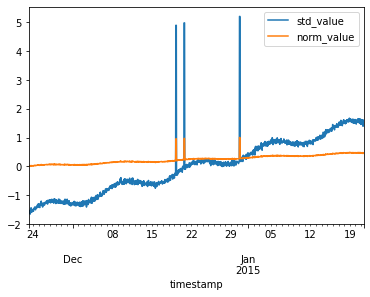


  0%|          | 0/198 [00:00<?, ?it/s]

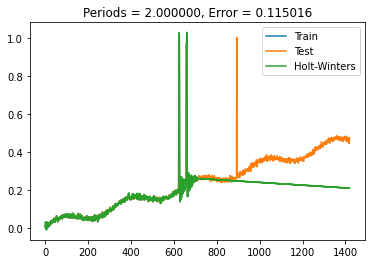


  1%|          | 1/198 [00:00<00:47,  4.13it/s]

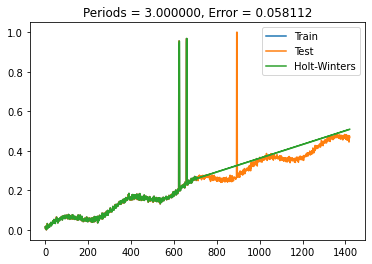


  2%|▏         | 3/198 [00:00<00:42,  4.56it/s]

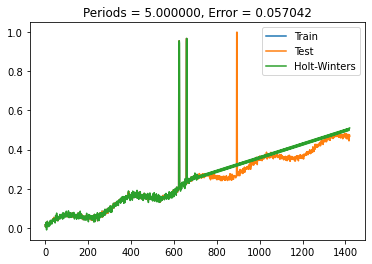


  5%|▍         | 9/198 [00:01<00:26,  7.15it/s]

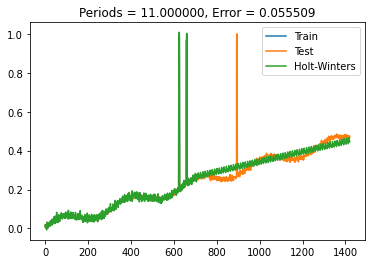


 10%|▉         | 19/198 [00:02<00:20,  8.54it/s]

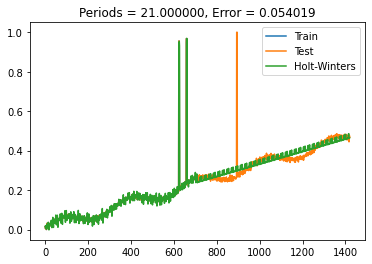


100%|██████████| 198/198 [00:34<00:00,  5.78it/s]


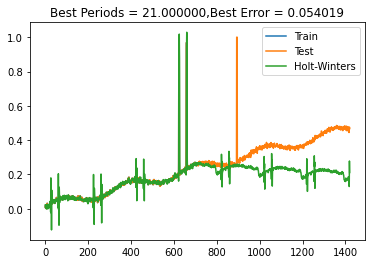

 90%|█████████ | 90/100 [1:04:57<07:05, 42.53s/it]




Errors:

Mean Absolute Error: 0.019
Mean Squared Error: 0.282
Root Mean Squared Error: 0.054
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 10.371
Mean forecast error: 0.282
Normalised mean squared error: 0.137
Theil_u_statistic: 0.678



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  45998.101187  ...    0.955119  0.218934
658 2014-12-20 17:00:00  46597.041510  ...    0.967473  0.257112
893 2014-12-30 12:00:00  48173.999054  ...    1.000000  0.296222
894 2014-12-30 13:00:00  48173.999054  ...    1.000000  0.297877
895 2014-12-30 14:00:00  48173.999054  ...    1.000000  0.298542

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_60
Me

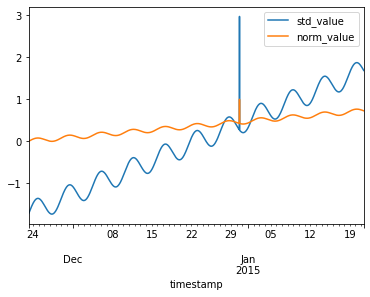


  0%|          | 0/198 [00:00<?, ?it/s]

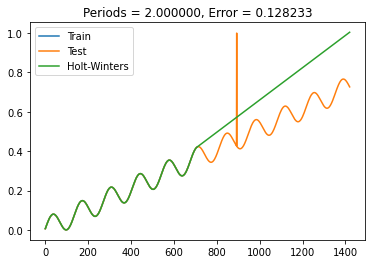


 20%|█▉        | 39/198 [00:04<00:18,  8.53it/s]

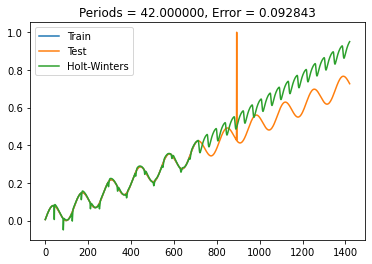


 22%|██▏       | 43/198 [00:05<00:18,  8.34it/s]

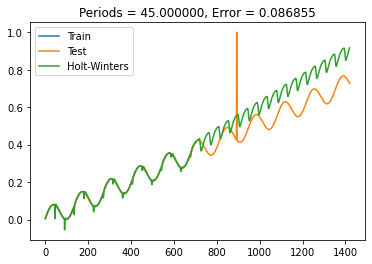


 27%|██▋       | 54/198 [00:06<00:14,  9.90it/s]

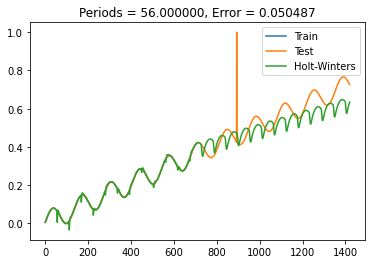


 29%|██▉       | 58/198 [00:07<00:15,  8.92it/s]

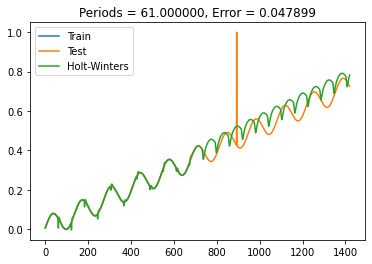


 41%|████      | 81/198 [00:09<00:11, 10.32it/s]

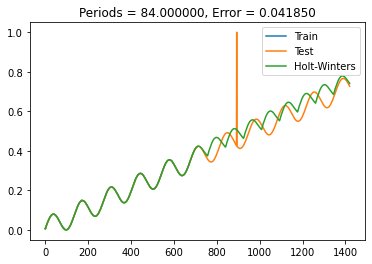


 47%|████▋     | 94/198 [00:11<00:16,  6.31it/s]

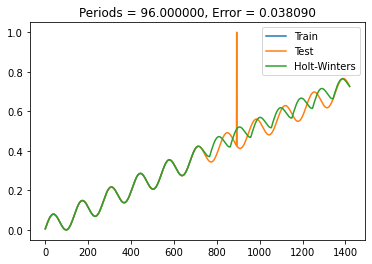


100%|██████████| 198/198 [00:32<00:00,  6.11it/s]


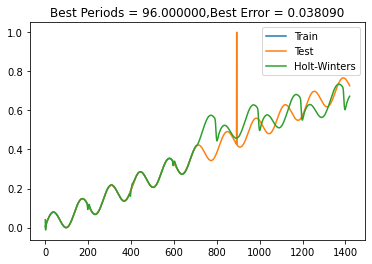

 91%|█████████ | 91/100 [1:05:30<05:56, 39.65s/it]




Errors:

Mean Absolute Error: 0.021
Mean Squared Error: 0.425
Root Mean Squared Error: 0.038
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 5.112
Mean forecast error: 0.437
Normalised mean squared error: 0.032
Theil_u_statistic: 0.205



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  24918.563513  ...         1.0  0.509946

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_21
Mean:[7282.32798645]
StandardDeviation: 4298.843109460126
Min: -1.722423, Max: 5.445587
                            value  is_anomaly  std_value  norm_value
timestamp                                                           
2014-11-23 07:00:00   -122.097268           0  -1.722423    0.00000

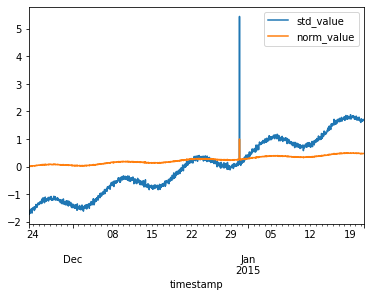


  0%|          | 0/198 [00:00<?, ?it/s]

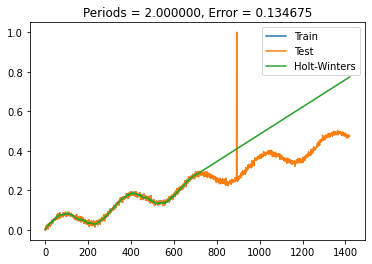


  1%|          | 1/198 [00:00<00:47,  4.15it/s]

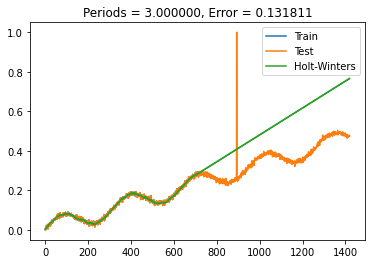


  1%|          | 2/198 [00:00<00:47,  4.11it/s]

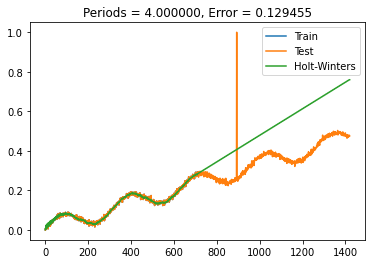


  2%|▏         | 3/198 [00:00<00:47,  4.11it/s]

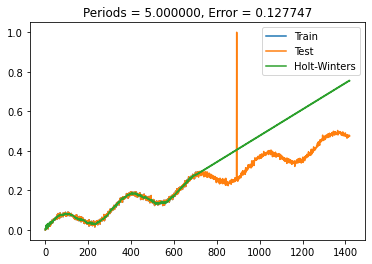


  2%|▏         | 4/198 [00:00<00:46,  4.13it/s]

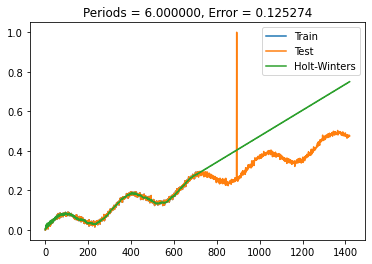


  3%|▎         | 5/198 [00:01<00:46,  4.11it/s]

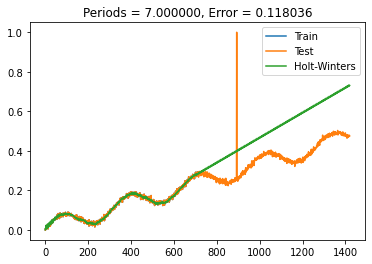


  8%|▊         | 16/198 [00:02<00:20,  8.79it/s]

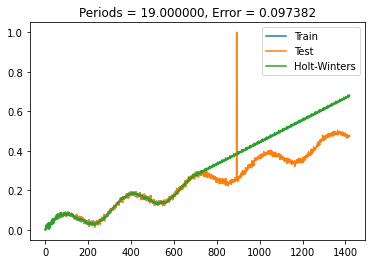


 19%|█▉        | 38/198 [00:05<00:24,  6.48it/s]

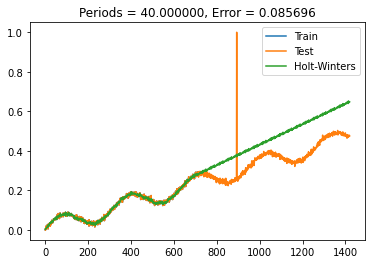


 21%|██        | 42/198 [00:06<00:31,  4.93it/s]

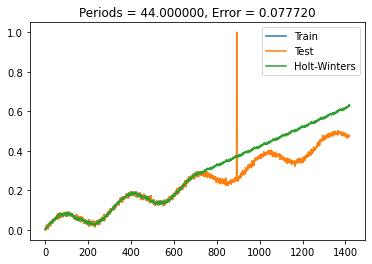


 30%|██▉       | 59/198 [00:09<00:28,  4.88it/s]

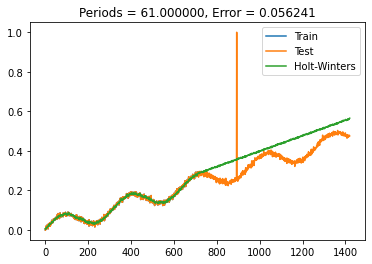


 38%|███▊      | 75/198 [00:13<00:31,  3.91it/s]

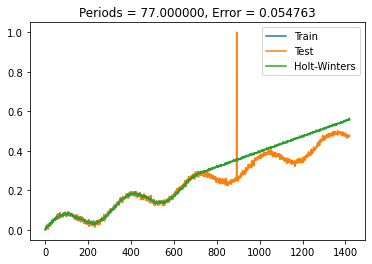


 77%|███████▋  | 153/198 [00:37<00:14,  3.20it/s]

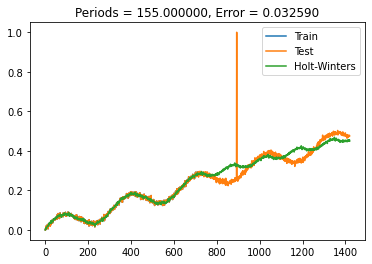


100%|██████████| 198/198 [00:52<00:00,  3.80it/s]


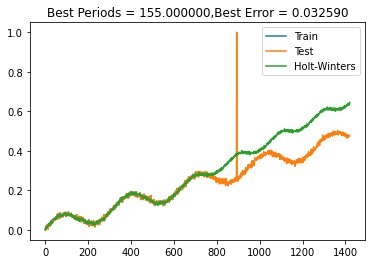

 92%|█████████▏| 92/100 [1:06:23<05:48, 43.53s/it]




Errors:

Mean Absolute Error: 0.018
Mean Squared Error: 0.278
Root Mean Squared Error: 0.033
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.237
Mean forecast error: 0.281
Normalised mean squared error: 0.055
Theil_u_statistic: 0.417



 END Errors

              timestamp         value  ...  norm_value   hw_pred
893 2014-12-30 12:00:00  30692.054083  ...         1.0  0.333778

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_25
Mean:[3211.79842602]
StandardDeviation: 2136.444375138502
Min: -2.072741, Max: 4.771106
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   321.426887           0  -1.352889    0.105182
2

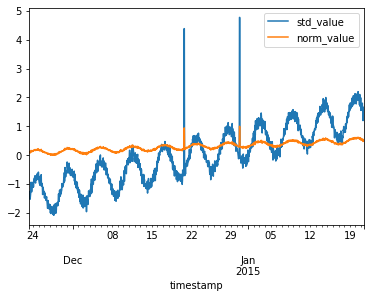


  0%|          | 0/198 [00:00<?, ?it/s]

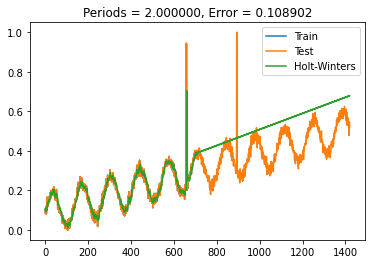


  1%|          | 1/198 [00:00<00:48,  4.07it/s]

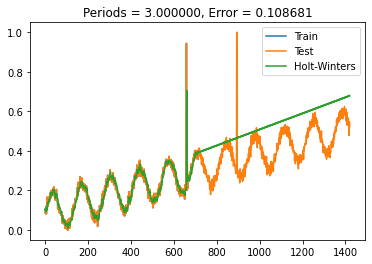


  2%|▏         | 3/198 [00:00<00:41,  4.74it/s]

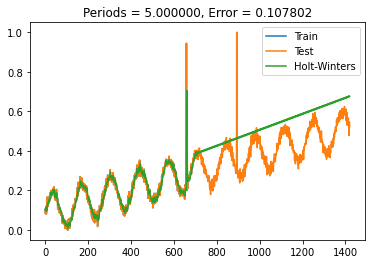


  2%|▏         | 4/198 [00:00<00:44,  4.40it/s]

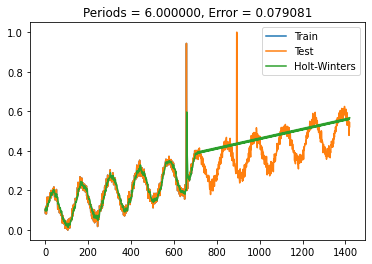


 46%|████▌     | 91/198 [00:21<00:31,  3.44it/s]

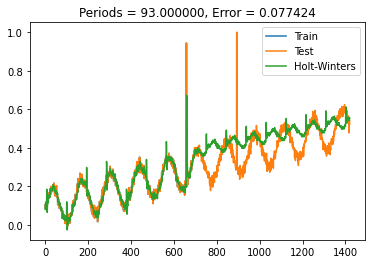


 55%|█████▌    | 109/198 [00:26<00:25,  3.44it/s]

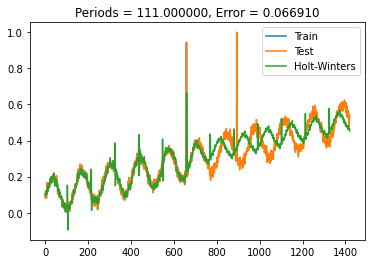


 66%|██████▌   | 130/198 [00:33<00:19,  3.41it/s]

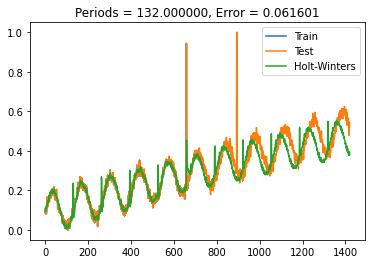


 66%|██████▌   | 131/198 [00:33<00:22,  2.94it/s]

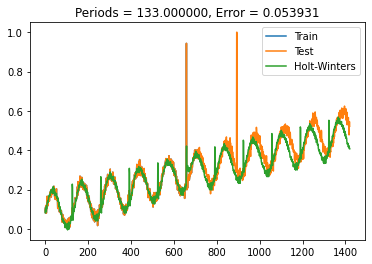


 67%|██████▋   | 132/198 [00:34<00:24,  2.67it/s]

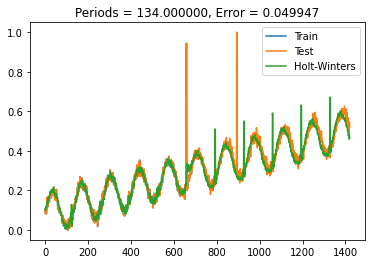


 67%|██████▋   | 133/198 [00:34<00:25,  2.52it/s]

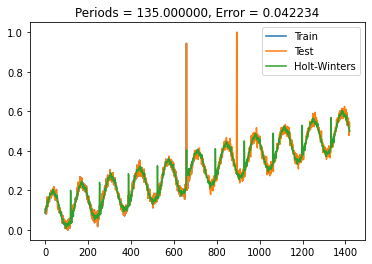


100%|██████████| 198/198 [00:52<00:00,  3.74it/s]


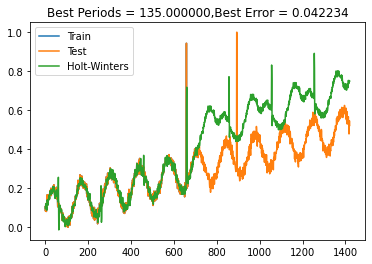

 93%|█████████▎| 93/100 [1:07:16<05:25, 46.49s/it]




Errors:

Mean Absolute Error: 0.018
Mean Squared Error: 0.336
Root Mean Squared Error: 0.042
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 8.445
Mean forecast error: 0.334
Normalised mean squared error: 0.083
Theil_u_statistic: 0.376



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  12575.790049  ...    0.943288  0.366255
659 2014-12-20 18:00:00  12575.790049  ...    0.943288  0.404268
893 2014-12-30 12:00:00  13405.000517  ...    1.000000  0.283583
894 2014-12-30 13:00:00  13405.000517  ...    1.000000  0.285637

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_18
Mean:[2596.44612012]
StandardDeviation: 1785.539102305528
Min: -2.153317, Max: 2.274279
          

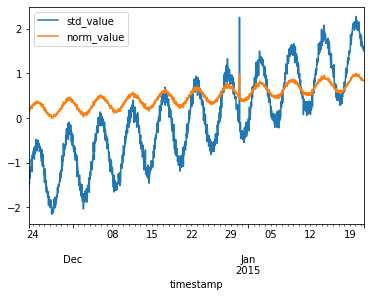


  9%|▉         | 18/198 [00:01<00:20,  8.79it/s]

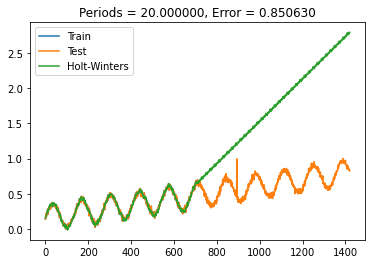


 30%|███       | 60/198 [00:08<00:23,  5.81it/s]

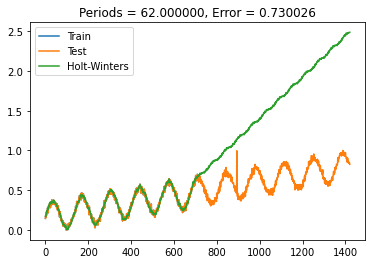


 33%|███▎      | 66/198 [00:09<00:24,  5.46it/s]

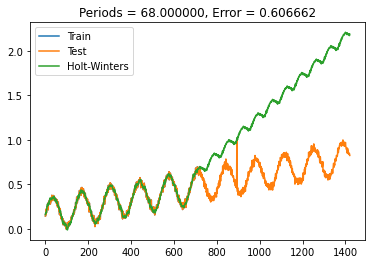


 34%|███▍      | 67/198 [00:10<00:28,  4.59it/s]

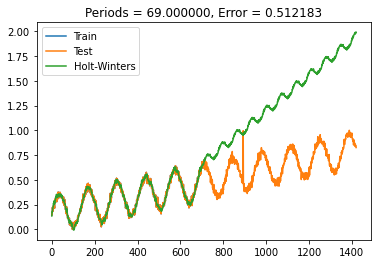


 37%|███▋      | 73/198 [00:11<00:28,  4.41it/s]

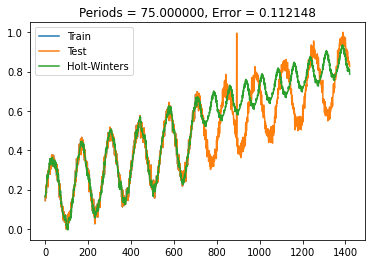


 67%|██████▋   | 133/198 [00:24<00:13,  4.91it/s]

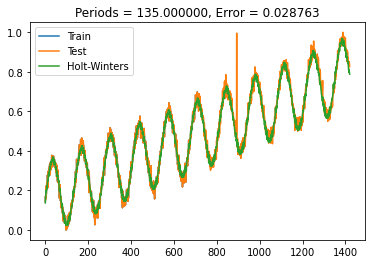


100%|██████████| 198/198 [00:44<00:00,  4.43it/s]


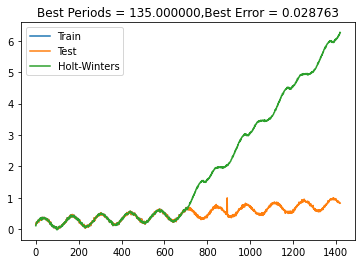

 94%|█████████▍| 94/100 [1:08:01<04:36, 46.10s/it]




Errors:

Mean Absolute Error: 0.02
Mean Squared Error: 0.536
Root Mean Squared Error: 0.029
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 6.009
Mean forecast error: 0.53
Normalised mean squared error: 0.016
Theil_u_statistic: 0.101



 END Errors

              timestamp        value  ...  norm_value  hw_pred
893 2014-12-30 12:00:00  6622.489879  ...    0.995602  0.44188

[1 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 0
Neg:False Negative:0 |True Negative: 1420
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_32
Mean:[3878.76947764]
StandardDeviation: 2453.2917686501196
Min: -2.073035, Max: 2.426199
                           value  is_anomaly  std_value  norm_value
timestamp                                                          
2014-11-23 07:00:00   410.760396           0  -1.413615    0.146563
2014-1

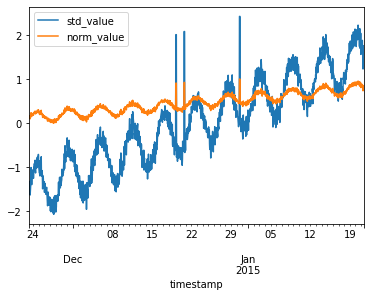


  0%|          | 0/198 [00:00<?, ?it/s]

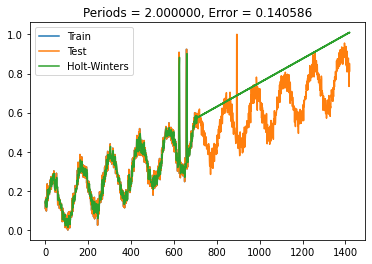


  2%|▏         | 4/198 [00:00<00:30,  6.26it/s]

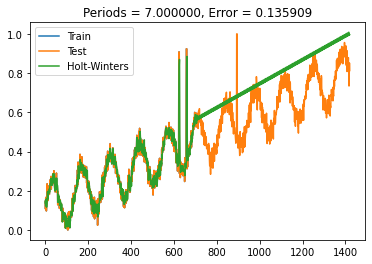


  5%|▌         | 10/198 [00:01<00:22,  8.21it/s]

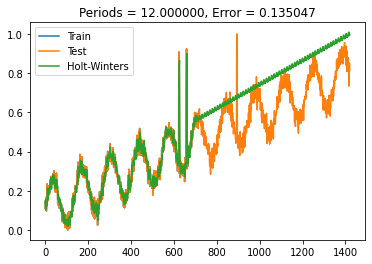


  6%|▌         | 12/198 [00:01<00:28,  6.62it/s]

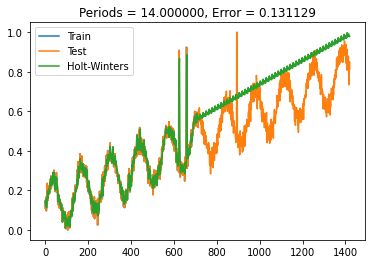


  8%|▊         | 15/198 [00:02<00:28,  6.35it/s]

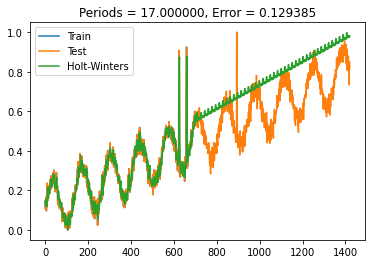


 10%|▉         | 19/198 [00:03<00:29,  6.08it/s]

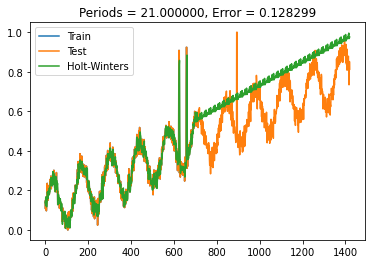


 13%|█▎        | 26/198 [00:04<00:28,  6.13it/s]

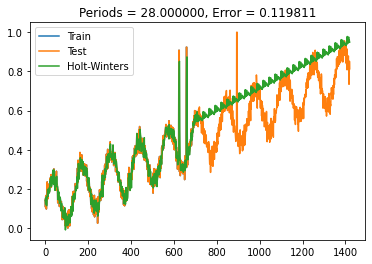


 20%|██        | 40/198 [00:06<00:33,  4.72it/s]

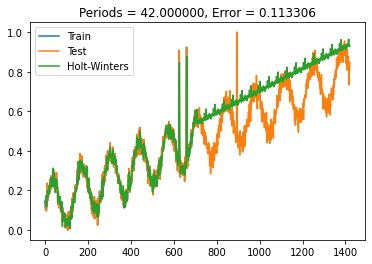


 24%|██▎       | 47/198 [00:08<00:38,  3.90it/s]

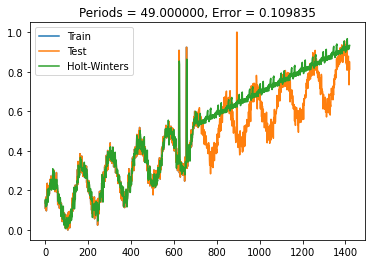


 41%|████▏     | 82/198 [00:18<00:33,  3.51it/s]

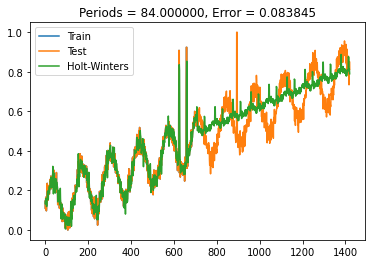


 66%|██████▌   | 131/198 [00:32<00:19,  3.51it/s]

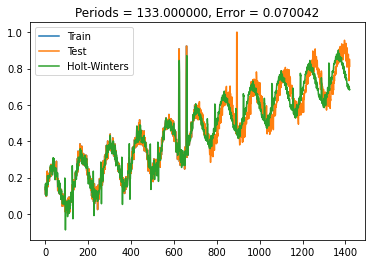


 67%|██████▋   | 132/198 [00:32<00:21,  3.00it/s]

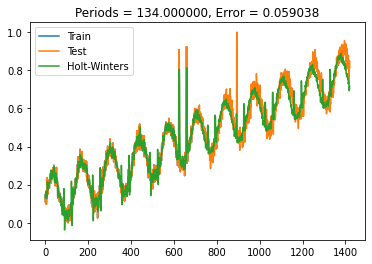


 67%|██████▋   | 133/198 [00:33<00:24,  2.69it/s]

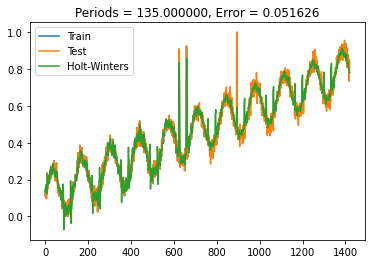


100%|██████████| 198/198 [00:51<00:00,  3.84it/s]


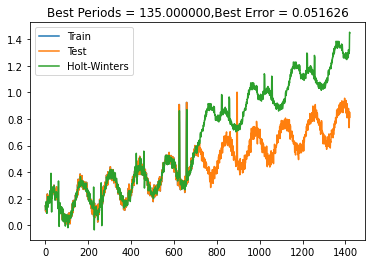

 95%|█████████▌| 95/100 [1:08:53<03:59, 47.90s/it]




Errors:

Mean Absolute Error: 0.032
Mean Squared Error: 0.512
Root Mean Squared Error: 0.052
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 12.674
Mean forecast error: 0.514
Normalised mean squared error: 0.054
Theil_u_statistic: 0.196



 END Errors

              timestamp        value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  8812.542813  ...    0.907736  0.418058
658 2014-12-20 17:00:00  8987.656808  ...    0.923601  0.459515
893 2014-12-30 12:00:00  9830.944052  ...    1.000000  0.571574
894 2014-12-30 13:00:00  9830.944052  ...    1.000000  0.572928
895 2014-12-30 14:00:00  9830.944052  ...    1.000000  0.594457

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_54
Mean:[14

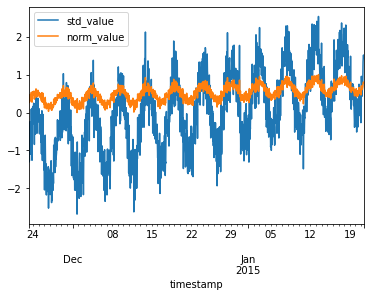


 20%|█▉        | 39/198 [00:04<00:23,  6.86it/s]

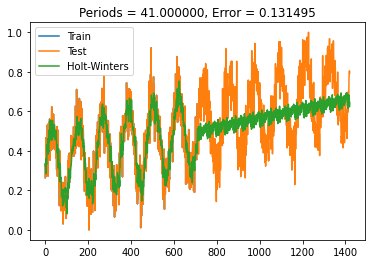


 25%|██▌       | 50/198 [00:06<00:21,  6.86it/s]

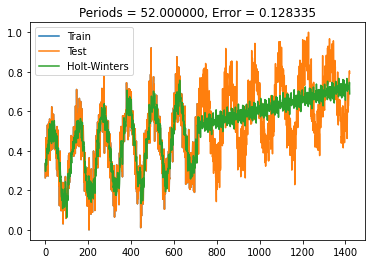


 58%|█████▊    | 115/198 [00:20<00:19,  4.16it/s]

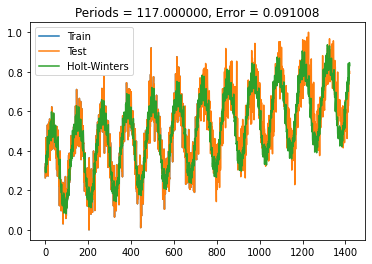


100%|██████████| 198/198 [00:44<00:00,  4.48it/s]


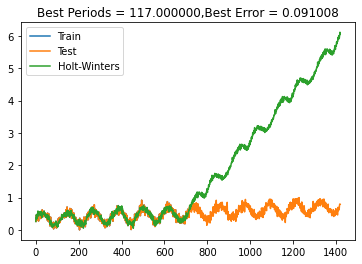

 96%|█████████▌| 96/100 [1:09:38<03:07, 46.94s/it]




Errors:

Mean Absolute Error: 0.071
Mean Squared Error: 0.549
Root Mean Squared Error: 0.091
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.756
Mean forecast error: 0.536
Normalised mean squared error: 0.224
Theil_u_statistic: 0.309



 END Errors

               timestamp        value  ...  norm_value   hw_pred
893  2014-12-30 12:00:00  3827.431380  ...    0.853358  0.435309
1130 2015-01-09 09:00:00  2689.271174  ...    0.692326  0.427824
1228 2015-01-13 11:00:00  4863.886194  ...    1.000000  0.686709
1241 2015-01-14 00:00:00  3910.213264  ...    0.865070  0.561226
1252 2015-01-14 11:00:00  3073.866620  ...    0.746740  0.478258
1364 2015-01-19 03:00:00  3441.121150  ...    0.798701  0.489538

[6 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:1 | False Positive: 5
Neg:False Negative:0 |True Negative: 1415
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 0.1666

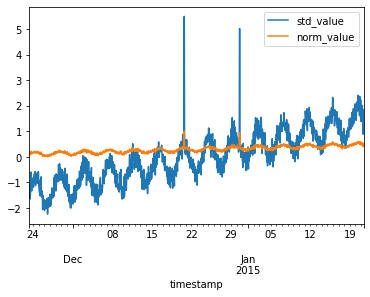


  0%|          | 0/198 [00:00<?, ?it/s]

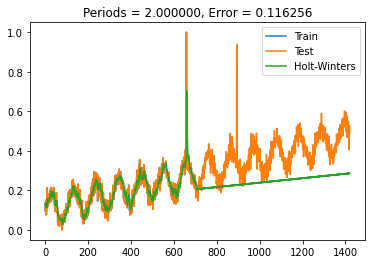


  1%|          | 2/198 [00:00<00:40,  4.88it/s]

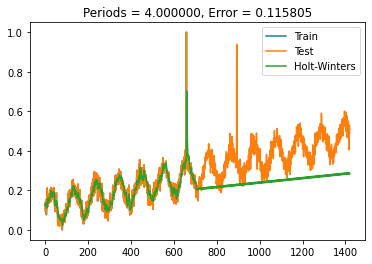


  4%|▎         | 7/198 [00:01<00:26,  7.25it/s]

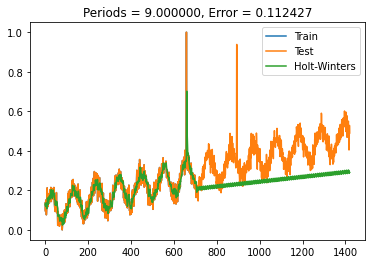


 12%|█▏        | 24/198 [00:03<00:27,  6.39it/s]

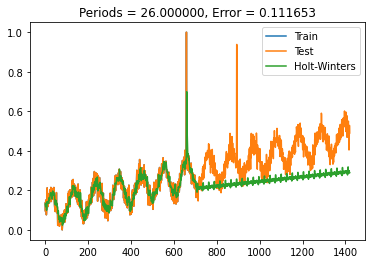


 15%|█▍        | 29/198 [00:04<00:33,  4.98it/s]

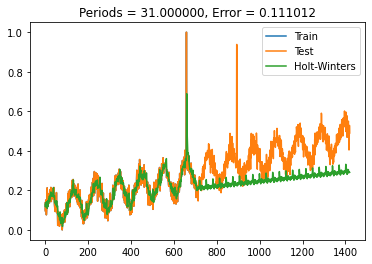


 20%|█▉        | 39/198 [00:06<00:31,  5.06it/s]

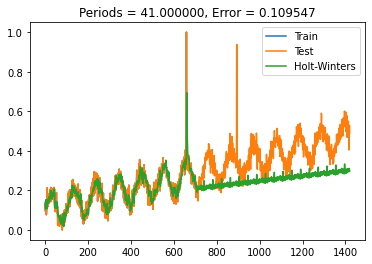


 32%|███▏      | 63/198 [00:12<00:37,  3.56it/s]

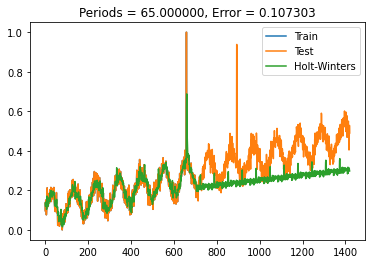


 44%|████▍     | 88/198 [00:19<00:30,  3.59it/s]

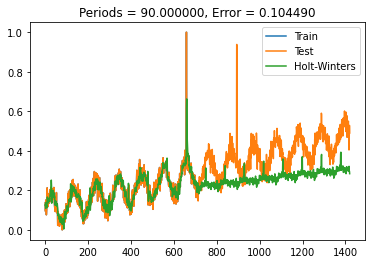


 50%|█████     | 99/198 [00:23<00:28,  3.51it/s]

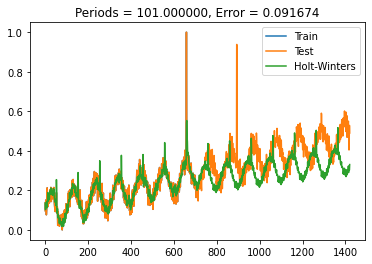


 51%|█████     | 100/198 [00:23<00:32,  3.01it/s]

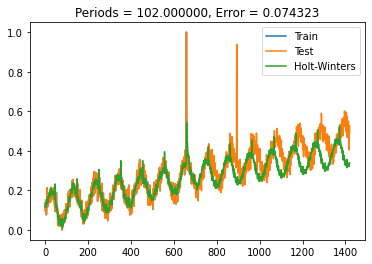


 51%|█████     | 101/198 [00:24<00:36,  2.68it/s]

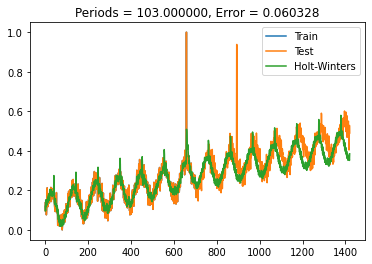


 52%|█████▏    | 102/198 [00:24<00:40,  2.38it/s]

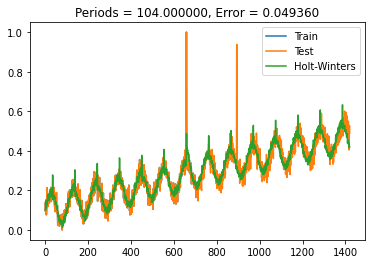


100%|██████████| 198/198 [00:52<00:00,  3.80it/s]


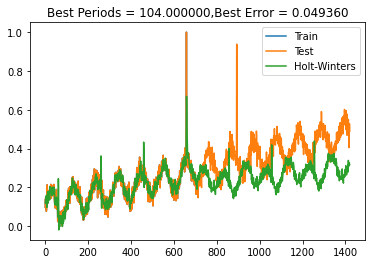

 97%|█████████▋| 97/100 [1:10:31<02:25, 48.66s/it]




Errors:

Mean Absolute Error: 0.032
Mean Squared Error: 0.317
Root Mean Squared Error: 0.049
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 12.677
Mean forecast error: 0.316
Normalised mean squared error: 0.145
Theil_u_statistic: 0.492



 END Errors

              timestamp         value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  16488.904916  ...    1.000000  0.441151
659 2014-12-20 18:00:00  16488.904916  ...    1.000000  0.487597
893 2014-12-30 12:00:00  15354.072990  ...    0.937966  0.321298
894 2014-12-30 13:00:00  15354.072990  ...    0.937966  0.303583

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_59
Mean:[3513.97147256]
StandardDeviation: 2396.965434411419
Min: -2.222367, Max: 5.300077
         

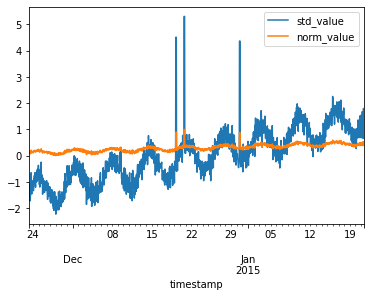


  0%|          | 0/198 [00:00<?, ?it/s]

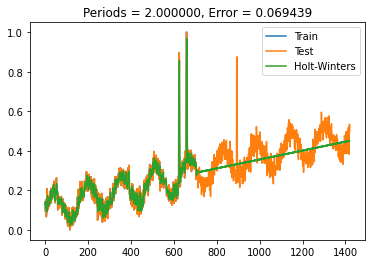


  1%|          | 1/198 [00:00<00:49,  4.01it/s]

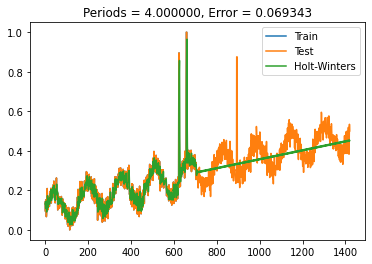


  2%|▏         | 3/198 [00:00<00:44,  4.41it/s]

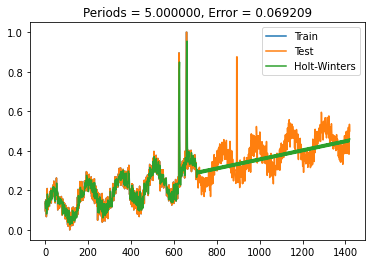


  4%|▎         | 7/198 [00:01<00:28,  6.72it/s]

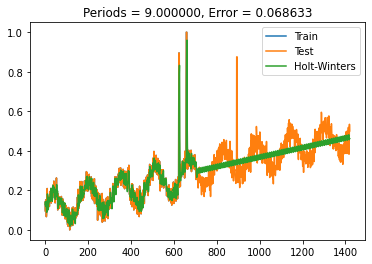


  7%|▋         | 13/198 [00:01<00:23,  8.03it/s]

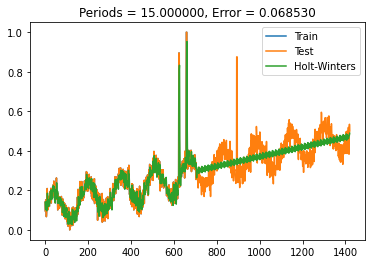


 20%|█▉        | 39/198 [00:06<00:31,  5.00it/s]

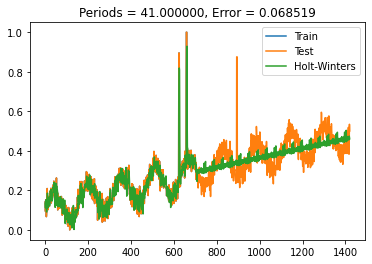


 22%|██▏       | 43/198 [00:07<00:36,  4.19it/s]

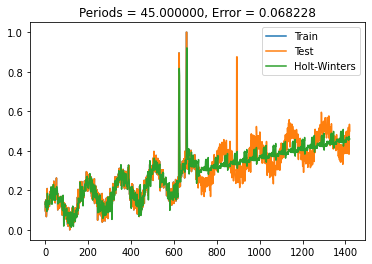


 23%|██▎       | 45/198 [00:08<00:41,  3.71it/s]

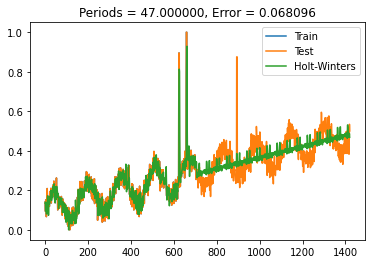


 77%|███████▋  | 153/198 [00:38<00:12,  3.69it/s]

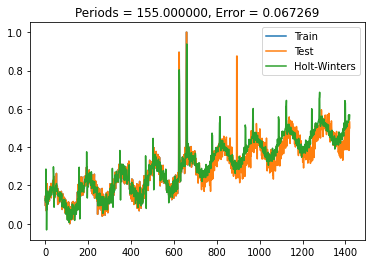


 78%|███████▊  | 155/198 [00:38<00:13,  3.18it/s]

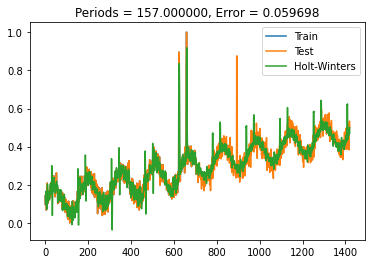


100%|██████████| 198/198 [00:51<00:00,  3.86it/s]


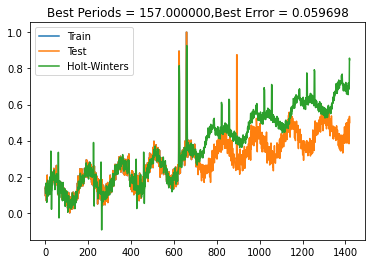

 98%|█████████▊| 98/100 [1:11:23<01:39, 49.61s/it]




Errors:

Mean Absolute Error: 0.036
Mean Squared Error: 0.324
Root Mean Squared Error: 0.06
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.087
Mean forecast error: 0.325
Normalised mean squared error: 0.202
Theil_u_statistic: 0.567



 END Errors

              timestamp         value  ...  norm_value   hw_pred
623 2014-12-19 06:00:00  14321.055903  ...    0.894792  0.414062
658 2014-12-20 17:00:00  16218.073649  ...    1.000000  0.482794
893 2014-12-30 12:00:00  13972.268474  ...    0.875448  0.302800
894 2014-12-30 13:00:00  13972.268474  ...    0.875448  0.286522
895 2014-12-30 14:00:00  13972.268474  ...    0.875448  0.281539

[5 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:5 | False Positive: 0
Neg:False Negative:4 |True Negative: 1412
Total Positives(Anomalies):9 | Total Negatives(Regulars): 1412
This Runs Stats: Precision: 1.0, Recall: 0.5555555555555556, F1: 0.7142857142857143
synthetic_40
Mea

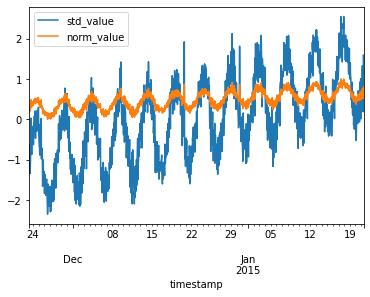


 22%|██▏       | 43/198 [00:04<00:15,  9.90it/s]

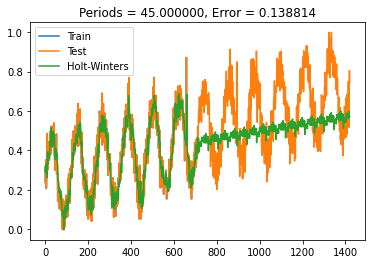


 58%|█████▊    | 115/198 [00:15<00:19,  4.22it/s]

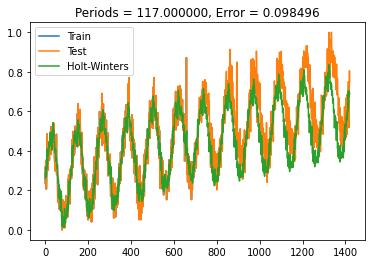


 59%|█████▊    | 116/198 [00:15<00:24,  3.32it/s]

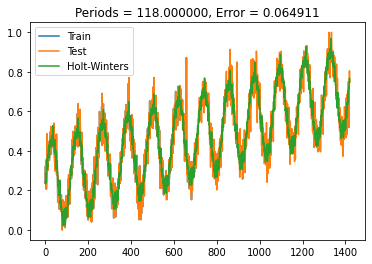


100%|██████████| 198/198 [00:40<00:00,  4.87it/s]


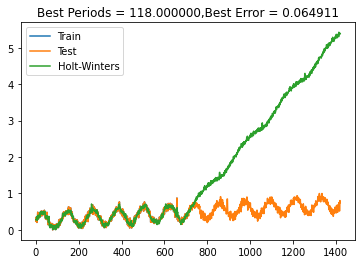

 99%|█████████▉| 99/100 [1:12:04<00:47, 47.08s/it]




Errors:

Mean Absolute Error: 0.05
Mean Squared Error: 0.521
Root Mean Squared Error: 0.065
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 13.324
Mean forecast error: 0.522
Normalised mean squared error: 0.101
Theil_u_statistic: 0.239



 END Errors

              timestamp        value  ...  norm_value   hw_pred
658 2014-12-20 17:00:00  4205.406804  ...    0.871508  0.452288
659 2014-12-20 18:00:00  4205.406804  ...    0.871508  0.421620
893 2014-12-30 12:00:00  4055.339210  ...    0.849034  0.464486
894 2014-12-30 13:00:00  4055.339210  ...    0.849034  0.534155

[4 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:4 | False Positive: 0
Neg:False Negative:0 |True Negative: 1417
Total Positives(Anomalies):4 | Total Negatives(Regulars): 1417
This Runs Stats: Precision: 1.0, Recall: 1.0, F1: 1.0
synthetic_24
Mean:[281.56155803]
StandardDeviation: 1014.9961114750965
Min: -2.091231, Max: 2.411893
               

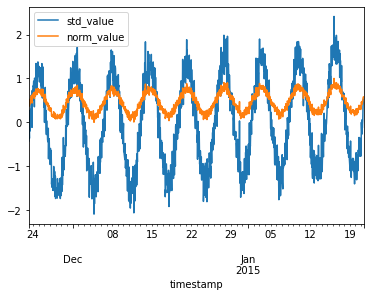


 31%|███▏      | 62/198 [00:08<00:27,  4.90it/s]

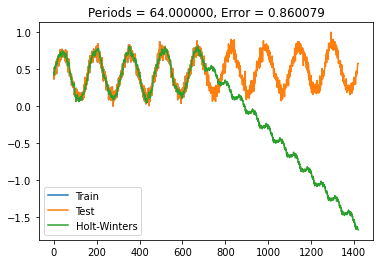


 32%|███▏      | 63/198 [00:08<00:34,  3.88it/s]

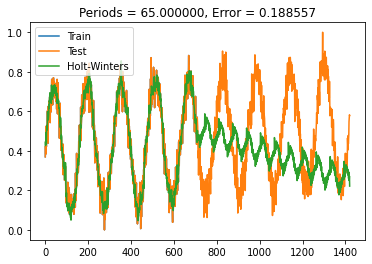


 39%|███▉      | 77/198 [00:11<00:26,  4.53it/s]

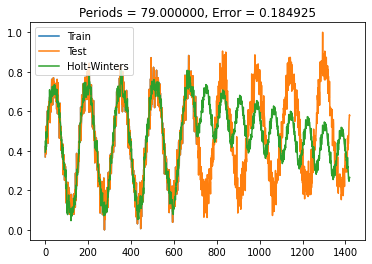


 79%|███████▉  | 156/198 [00:31<00:08,  4.74it/s]

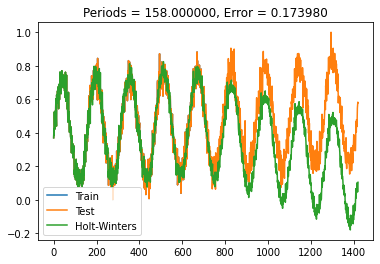


 79%|███████▉  | 157/198 [00:31<00:09,  4.28it/s]

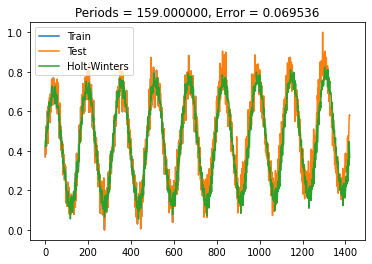


100%|██████████| 198/198 [00:43<00:00,  4.52it/s]


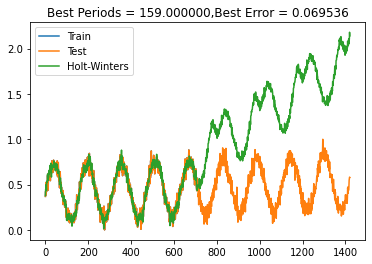

100%|██████████| 100/100 [1:12:48<00:00, 43.69s/it]




Errors:

Mean Absolute Error: 0.054
Mean Squared Error: 0.515
Root Mean Squared Error: 0.07
Mean absolute percentage error: inf
Scaled Mean absolute percentage error: 15.628
Mean forecast error: 0.5
Normalised mean squared error: 0.098
Theil_u_statistic: 0.27



 END Errors

               timestamp        value  ...  norm_value   hw_pred
935  2015-01-01 06:00:00   269.307243  ...    0.461715  0.206636
1252 2015-01-14 11:00:00   490.866461  ...    0.510189  0.255732
1294 2015-01-16 05:00:00  2729.623203  ...    1.000000  0.740160

[3 rows x 6 columns]
Holt Winters Confusion Matrix:
Classes
Positive 	|	 Negative
Pos:True Positive:0 | False Positive: 3
Neg:False Negative:1 |True Negative: 1417
Total Positives(Anomalies):1 | Total Negatives(Regulars): 1420
This Runs Stats: Precision: 0.0, Recall: 0.0, F1: 0


In [34]:
#GO THRU Below LOOP one line at a time, the output is much much worse than expected.
hw_f1_plot = []
hw_precision_plot = []
hw_recall_plot = []

for index,file in enumerate(tqdm(all_csv)):
    # print(file)
    fname = file.split("/")[6].split(".")[0]
    print(fname)

    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    

    # prepare data for standardization
    values = df_indexed.copy()
    values = values.drop(columns=['is_anomaly'],axis=1)
    
    # train the standardization
    scaler2 = StandardScaler()
    scaler2 = scaler2.fit(values)
    print(f'Mean:{scaler2.mean_}')
    print(f'StandardDeviation: {sqrt(scaler2.var_)}')

    # standardize the dataset
    standardaized = scaler2.transform(values)
    df['std_value'] = standardaized
    df_indexed['std_value'] = standardaized

    # prepare data for normalization
    values = np.array(df['std_value'])
    values = values.reshape((len(values), 1))

    # train the normalization
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(values)
    print('Min: %f, Max: %f' % (scaler.data_min_, scaler.data_max_))

    # normalize the dataset and print the first 5 rows
    normalized = scaler.transform(values)
    df['norm_value'] = normalized
    df_indexed['norm_value'] = normalized
    print(df_indexed)

    #plot std and norm value
    df.plot.line(x='timestamp',y=['std_value','norm_value'])
    plt.show()

    #Create the test and train split
    X = df.norm_value
    size = int(len(X)*0.5)
    train, test = X[0:size], X[0:len(X)]

    best_RMSE=1
    best_hw = None
    best_periods=0
    best_pred = []

    for s in tqdm(range(2,200)):
        model = ExponentialSmoothing(train, trend='add',seasonal_periods=s,seasonal='add')
        hw_model = model.fit(optimized=True, use_boxcox=False, remove_bias=True)
        pred = hw_model.predict(start=test.index[0], end=test.index[-1])
        rmse = np.sqrt(mean_squared_error(test,pred))
        if rmse < best_RMSE:
            best_RMSE = rmse
            best_periods = s
            best_hw=hw_model
            best_pred=pred
            plt.plot(train.index, train, label='Train')
            plt.plot(test.index, test, label='Test')
            plt.plot(pred.index, pred, label='Holt-Winters')
            plt.legend(loc='best')
            plt.title("Periods = %f, Error = %f" % (s, rmse))
            plt.show()
    
    plt.plot(train.index, train, label='Train')
    plt.plot(test.index, test, label='Test')
    plt.plot(pred.index, pred, label='Holt-Winters')
    plt.legend(loc='best')
    plt.title("Best Periods = %f,Best Error = %f" % (best_periods, best_RMSE))
    plt.show() 

    model_eval(test,best_pred)

    df['hw_pred'] = best_pred

    threshold = 0.25
    
    hw_outliers = df[df.norm_value > df.hw_pred + threshold]
    print(hw_outliers)

    hw_not_outliers = df.merge(hw_outliers, how = 'outer' ,indicator=True).loc[lambda x : x['_merge']=='left_only'] 

    hw_truepositives = hw_outliers[hw_outliers['is_anomaly'] == 1]
    hw_falsepostives = hw_outliers[hw_outliers['is_anomaly'] == 0]

    hw_truenegatives=hw_not_outliers[hw_not_outliers['is_anomaly'] == 0]
    hw_falsenegatives = hw_not_outliers[hw_not_outliers['is_anomaly'] == 1]

    p = len(df[df.is_anomaly == 1])
    n = len(df[df.is_anomaly == 0])

    print("Holt Winters Confusion Matrix:")
    print("Classes")
    print("Positive \t|\t Negative")
    print(f"Pos:True Positive:{len(hw_truepositives)} | False Positive: {len(hw_falsepostives)}")
    print(f"Neg:False Negative:{len(hw_falsenegatives)} |True Negative: {len(hw_truenegatives)}")
    print(f"Total Positives(Anomalies):{p} | Total Negatives(Regulars): {n}")

    hw_precision,hw_recall,hw_f1 = calc_stats(hw_truepositives,hw_falsepostives, hw_truenegatives, hw_falsenegatives)
    print(f"This Runs Stats: Precision: {hw_precision}, Recall: {hw_recall}, F1: {hw_f1}")
    hw_precision_plot.append(hw_precision)
    hw_recall_plot.append(hw_recall)
    hw_f1_plot.append(hw_f1)
    





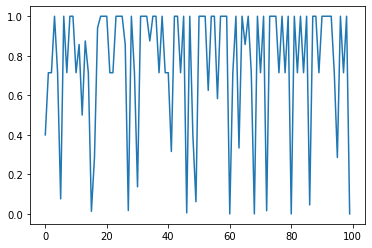

In [35]:
fig = plt.plot(hw_f1_plot)
fig

In [36]:
f1df.loc[0] = [np.mean(hw_f1_plot)]
print(f"Average F1 score over {index} runs is =\n {f1df}")    

NameError: ignored

In [ ]:
precisiondf.loc[0] = [np.mean(hw_precision_plot)]
print(f"Average F1 score over {index} runs is =\n {precisiondf}")    

In [ ]:
recalldf.loc[0] = [np.mean(hw_recall_plot)]
print(f"Average F1 score over {index} runs is =\n {recalldf}")    

In [ ]:
# hw_f1_plot = []
# hw_precision_plot = []
# hw_recall_plot = []

# for index,file in enumerate(tqdm(all_csv)):
#     if index%20 == 0:
#         print(f'Processing index: {index} of {len(all_csv)}')
#     if index > 10:
#         break
#     print("\n\n\n------------------------------------------------------\n\n\n")
#     fname = file.split("/")[5].replace('\\','').split(".")[0]
#     print(fname)

#     df = pd.read_csv(file)
#     df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
#     df_indexed = df.set_index('timestamp')

#     # prepare data for standardization
#     values = df_indexed.copy()
#     values = values.drop(columns=['is_anomaly'],axis=1)
    
#     # train the standardization
#     scaler2 = StandardScaler()
#     scaler2 = scaler2.fit(values)
#     print(f'Mean:{scaler2.mean_}')
#     print(f'StandardDeviation: {sqrt(scaler2.var_)}')

#     # standardize the dataset
#     standardaized = scaler2.transform(values)
#     df['std_value'] = standardaized
#     df_indexed['std_value'] = standardaized

#     # prepare data for normalization
#     values = np.array(df['std_value'])
#     values = values.reshape((len(values), 1))

#     # train the normalization
#     scaler = MinMaxScaler(feature_range=(0, 1))
#     scaler = scaler.fit(values)
#     print('Min: %f, Max: %f' % (scaler.data_min_, scaler.data_max_))

#     # normalize the dataset and print the first 5 rows
#     normalized = scaler.transform(values)
#     df['norm_value'] = normalized
#     df_indexed['norm_value'] = normalized

#     #plot std and norm value
#     df.plot.line(x='timestamp',y=['std_value','norm_value'])

#     #Set the index frequency to monthly
#     df.index.freq = 'MS'

#     #Create the test and train split
#     X = df.norm_value
#     size = int(len(X)*0.5)
#     train, test = X[0:size], X[0:len(X)]

#     best_RMSE=1
#     best_hw = None
#     best_periods=0
#     best_pred = []
#     for s in tqdm(range(2,200)):
#         model = ExponentialSmoothing(train, trend='add',seasonal_periods=s,seasonal='add')
#         hw_model = model.fit(optimized=True, use_boxcox=False, remove_bias=True)
#         pred = hw_model.predict(start=test.index[0], end=test.index[-1])
#         rmse = np.sqrt(mean_squared_error(test,pred))
#         # print(f'periods {s} rmse {rmse}')
#         if rmse < best_RMSE:
#             best_RMSE = rmse
#             best_periods = s
#             best_hw=hw_model
#             best_pred=pred
#             # plt.plot(train.index, train, label='Train')
#             # plt.plot(test.index, test, label='Test')
#             # plt.plot(pred.index, pred, label='Holt-Winters')
#             # plt.legend(loc='best')
#             # plt.title("Periods = %f" % s)
#             # plt.show()

#     plt.plot(train.index, train, label='Train')
#     plt.plot(test.index, test, label='Test')
#     plt.plot(pred.index, pred, label='Holt-Winters')
#     plt.legend(loc='best')
#     plt.title("Best Periods = %f,Best Error = %f" % (best_periods, best_rmse)
#     plt.show()    
#     model_eval(test,best_pred)

#     df['hw_pred'] = pred

#     threshold = 0.25
    
#     hw_outliers = df[df.norm_value > df.hw_pred + threshold]
#     print(hw_outliers)

#     hw_not_outliers = df.merge(hw_outliers, how = 'outer' ,indicator=True).loc[lambda x : x['_merge']=='left_only'] 

#     hw_truepositives = hw_outliers[hw_outliers['is_anomaly'] == 1]
#     hw_falsepostives = hw_outliers[hw_outliers['is_anomaly'] == 0]

#     hw_truenegatives=hw_not_outliers[hw_not_outliers['is_anomaly'] == 0]
#     hw_falsenegatives = hw_not_outliers[hw_not_outliers['is_anomaly'] == 1]

#     # outliers=[]
#     # for i in range(len(test)):
#     #     if(test[i] > best_pred[i] + threshold):
#     #         outliers.append((i,test[i]))
    
#     # not_outliers = [x for x in best_pred if x not in outliers]
#     # print(len(outliers),len(not_outliers),outliers)

#     # p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
#     # print(p)

#     #Checking the number of anomalies in the TS
#     p = len(df[df.is_anomaly == 1])
#     n = len(df[df.is_anomaly == 0])

#     print("Holt Winters Confusion Matrix:")
#     print("Classes")
#     print("Positive \t|\t Negative")
#     print(f"Pos:True Positive:{len(hw_truepositives)} | False Positive: {len(hw_falsepostives)}")
#     print(f"Neg:False Negative:{len(hw_falsenegatives)} |True Negative: {len(hw_truenegatives)}")
#     print(f"Total Positives(Anomalies):{p} | Total Negatives(Regulars): {n}")

#     hw_precision,hw_recall,hw_f1 = calc_stats(hw_truepositives,hw_falsepostives, hw_truenegatives, hw_falsenegatives)
#     print(f"This Runs Stats: Precision: {hw_precision}, Recall: {hw_recall}, F1: {hw_f1}")
#     hw_precision_plot.append(hw_precision)
#     hw_recall_plot.append(hw_recall)
#     hw_f1_plot.append(hw_f1)


# end_time=datetime.now()
# print(f"Stochastic Modelling and Anomaly Analysis of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
# print("Performance:")
# plt.plot(hw_f1_plot)
# plt.show()
# #plt.set_title('F1 Score')
# # plt.plot(hw_recall_plot)
# # plt.show()
# # #plt.set_title('Recall')
# # plt.plot(hw_precision_plot)
# # plt.show()
# #set_title('Precision')
# plt.xlabel="Number of Runs (Time Series)"
# plt.ylabel="f1 score"
# plt.legend("HW")
# f1df = pd.DataFrame(columns=["HW"])
# f1df.loc[0] = [np.mean(hw_f1_plot)]
# print(f"Average F1 score over {index} runs is =\n {f1df}")    


In [ ]:
hw_f1_plot, hw_recall_plot, hw_precision_plot

In [ ]:
print(f"Stochastic Modelling and Anomaly Analysis of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
print("Performance:")
plt.plot(hw_f1_plot)
plt.xlabel="Number of Runs (Time Series)"
plt.ylabel="f1 score"
plt.legend("HW")
plt.show()
f1df = pd.DataFrame(columns=["HW"])
f1df.loc[0] = [np.mean(hw_f1_plot)]
print(f"Average F1 score over {index} runs is =\n {f1df}")   

In [ ]:
plt.plot(test)
plt.plot(best_pred)
plt.show()

In [ ]:
best_periods

In [ ]:
    rmse = np.sqrt(mean_squared_error(test,pred))
    print(rmse)
    if rmse < best_RMSE:
        best_RMSE = rmse
        best_periods = s

In [ ]:
outliers